In [1]:
#py3.8
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import anndata
import scipy
import seaborn as sns
import gseapy

import pickle

In [2]:
import os
print(os.getcwd())

/Users/gaos1/Library/CloudStorage/OneDrive-MemorialSloanKetteringCancerCenter/bioinformatics_working/mye_data


## Loading & Saving

In [4]:
adata = sc.read_h5ad('intermediate/12_anno_v2_DEG.h5ad')

In [ ]:
# after running DEG for each cluster comparing genotypes
adata.write_h5ad('intermediate/12_anno_v2_DEG.h5ad')

## Customized functions

In [31]:
from scipy.sparse import coo_matrix, csr_matrix
from typing import Optional, Union, Mapping  # Special
from typing import Sequence  # ABCs
from typing import Tuple  # Classes

In [32]:
def gsea_dotplot(df: pd.DataFrame,
                 xlab: str,
                 ylab: str,
                 title: str,
                 hue = 'k',
                 log10_pvalue: Optional[bool] = False,
                 fig_size: Optional[tuple] = (6, 3),
                 line_color: Optional[str] = 'skyblue',
                 dot_size: Optional[float] = 100,
                 cmap: Optional[str] = 'viridis',
                 grid_on: Optional[bool] = True,
                 label_fontsize: Optional[float] = 10,
                 tick_fontsize: Optional[float] = 10,
                 colorbar: Optional[bool] = False,
                 savefig: Optional[Union[bool, str]] = False):
    
    
    """
    Make a dotplot to visualize GSEA results

    Visualizes specific pathways and associated parameters (expected output of GSEA)

    Parameters
    ----------
    df
        pandas dataframe containing pathway names, NES values and p-values.
    xlab
        column name in df for NES result (on x-axis)
    ylab
        column name in df for pathway or term (on y-axis)
    hue
        Either a color name or column name in df for coloring the dots (typically FDR q-val)
    log10_pvalue
        Boolean variable indicating whether to log10 hue (pvalue or fdr pvalue) or not. Default: False
    fig_size
        A tuple indicating size of the figure. Default: (12, 6)
    line_color
        Color of the horizontal lines. Default: 'skyblue'
    dot_size
        Size of the dots at the end of the horizontal lines. Default: 100
    cmap
        If hue indicates a continuous variable then choose colormap. Default: viridis
    grid_on
        Boolean indicating if grid lines are required in the plot. Default: True
    label_fontsize
        Size of the x-axis, y-axis and colorbar labels. Default: 16
    tick_fontsize
        Size of the x-axis, y-axis and colorbar tick labels. Default: 16
    colorbar
        Boolean to make a colorbar or not. Default: False
    savefig
        If you want to save figure, provide full path and name of output plot image (include ".png" extension). Default: False

    Returns
    -------
    Returns axes and saves figure
    
      
    Example
    -------
    gsea_dotplot(df,
                 xlab = 'NES',
                 ylab = 'Term',
                 hue = 'FDR q-val',
                 log10_pvalue = False,
                 colorbar = True,
                 tick_fontsize = 16,
                 label_fontsize = 16,
                 savefig = '/Users/sharmar1/Dropbox/msk_workshop/materials_2023_2024_batch1/session-5/gseapy_dotplot.png')
    
    """
    
    # check if hue exists in df
    if hue in df.columns:
        colorby = df[hue].values
        colorbar_label = hue
        if log10_pvalue:
            colorby[colorby == 0] = np.min(colorby[colorby != 0])/2
            colorby = -np.log10(colorby.astype(float))
            colorbar_label = '-log10(' + hue + ')'
    else:
        colorby = hue
        cmap = None
    

    # y-axis
    my_range = np.arange(1,len(df.index)+1)

    # create a figure
    fig = plt.figure(figsize = fig_size)
    ax = fig.add_subplot(1, 1, 1)

    # add horizontal lines
    ax.hlines(y=my_range, xmin=0, xmax=df[xlab], color=line_color)

    # add the circles
    im1 = ax.scatter(df[xlab], my_range, s = dot_size, c = colorby, zorder = max([_.zorder for _ in ax.get_children()]), cmap = cmap)

    # set yticks
    ax.set_yticks(my_range, df[ylab]);

    # aesthetics
    xlim = ax.get_xlim()
    ax.set_xlim([-np.max(np.abs(xlim)), np.max(np.abs(xlim))])
    if grid_on:
        ax.grid(visible = True, linestyle = '--')
    ax.tick_params(axis='both', which='major', labelsize=tick_fontsize)
    ax.set_xlabel('NES', fontsize = label_fontsize)
    ax.set_ylabel('Pathways', fontsize = label_fontsize)
    ax.set_title(title, fontsize=label_fontsize + 2)
    if colorbar:
        cbar = fig.colorbar(im1, shrink = 0.5)
        cbar.set_label(colorbar_label, size = label_fontsize)
        cbar.ax.tick_params(labelsize=tick_fontsize)

    if savefig:
        fig.savefig(savefig, bbox_inches = 'tight', format='pdf', dpi = 150)

    return fig, ax

## Formating

In [14]:
adata.obs['genotype'].cat.reorder_categories(['WT', 'RII', 'PD1', '2KO', '3KO'], inplace=True)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1846/3200692064.py:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['genotype'].cat.reorder_categories(['WT', 'RII', 'PD1', '2KO', '3KO'], inplace=True)


In [15]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['cell_subtype_v2'].unique(), reverse=True)

# Define a color palette for them using "Set2" palette
colors = sns.color_palette("tab10", n_colors=len(categories_order))
palette_dict_subtype_v2 = dict(zip(categories_order, colors))

## Exploration (all APC)

#### mito

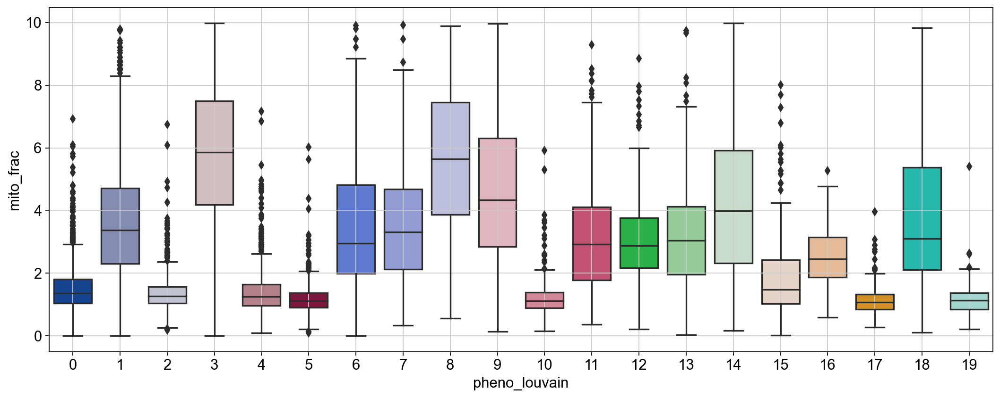

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = adata.obs[['mito_frac', 'pheno_louvain']]

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.boxplot(x = "pheno_louvain", y = "mito_frac", data = df_temp, ax = ax, 
            palette = sc.pl.palettes.zeileis_28)
ax.grid('on')

#### dotplot

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


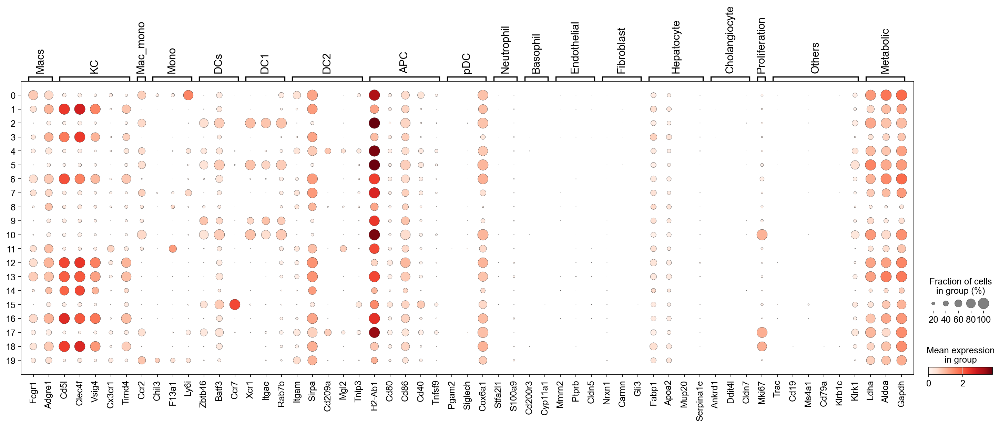

In [ ]:
var_names = {'Macs': ['Fcgr1', 'Adgre1'],
                'KC': ['Cd5l','Clec4f', 'Vsig4', 'Cx3cr1', 'Timd4'],
                'Mac_mono': ['Ccr2'],
                'Mono': ['Chil3', 'F13a1', 'Ly6i'],
                'DCs':['Zbtb46', 'Batf3', 'Ccr7'],
                'DC1':['Xcr1', 'Itgae', 'Rab7b'],
                'DC2':['Itgam', 'Sirpa', 'Cd209a', 'Mgl2', 'Tnip3'],
                'APC':['H2-Ab1','Cd80','Cd86', 'Cd40', 'Tnfsf9'],
                'pDC':['Pgam2', 'Siglech', 'Cox6a1'],
                'Neutrophil':['Stfa2l1', 'S100a9'],
                'Basophil':['Cd200r3', 'Cyp11a1'],
                'Endothelial': ['Mmrn2', 'Ptprb', 'Cldn5'],
                'Fibroblast': ['Nrxn1', 'Carmn', 'Gli3'],
                'Hepatocyte': ['Fabp1', 'Apoa2', 'Mup20', 'Serpina1e'],
                'Cholangiocyte':['Ankrd1', 'Ddit4l', 'Cldn7'],
                'Proliferation': ['Mki67'],
                'Others':['Trac', 'Cd19','Ms4a1','Cd79a','Klrb1c','Klrk1'],
                'Metabolic': ['Ldha', 'Aldoa', 'Gapdh']
               }
ac = sc.pl.dotplot(adata, var_names, groupby = 'pheno_louvain', log=True, layer = 'norm_counts', 
                   show = True, save = 'dotplot_mito10.pdf')

In [ ]:
var_names_2 = {'Macs': ['Fcgr1', 'Adgre1'],
                'KC': ['Cd5l','Clec4f', 'Vsig4', 'Timd4'],
                'Mono': ['Ccr2','Ly6i','Chil3', 'F13a1', 'Cx3cr1'],
                'DCs':['Zbtb46', 'Batf3', 'Ccr7'],
                'DC1':['Xcr1', 'Itgae', 'Rab7b'],
                'DC2':['Itgam', 'Sirpa', 'Cd209a', 'Mgl2', 'Tnip3'],
                'APC':['H2-Ab1','Cd80','Cd86', 'Cd40', 'Tnfsf9'],
               }

In [ ]:
adata

AnnData object with n_obs × n_vars = 7399 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno', 'cell_subtype_v2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'

In [ ]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=300, frameon=True, vector_friendly=True, 
                     fontsize=10,  color_map=None, format='pdf', 
                     facecolor=None, transparent=False, ipython_format='png2x') #figsize=[6,6],

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


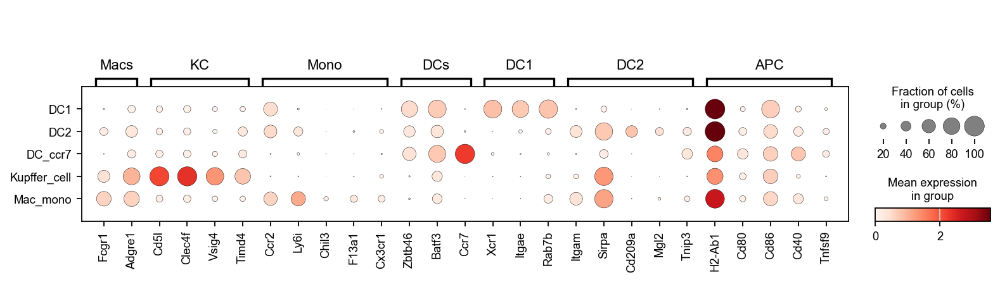

In [ ]:
ac = sc.pl.dotplot(adata, var_names_2, groupby = 'cell_subtype_v2', log=True, layer = 'norm_counts', 
                   show = True, save = 'dotplot_annotated.pdf')

In [ ]:
adata.obs.columns

Index(['hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac',
       'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno',
       'cell_subtype_v2'],
      dtype='object')

In [ ]:
def iteratively_plot_dotplot(adata, genes, groupby1, groupby2):
    unique_values = adata.obs[groupby2].unique()
    
    # Initialize placeholders for global min and max of non-zero expressions
    global_non_zero_min, global_non_zero_max = float('inf'), float('-inf')
    
    for value in unique_values:
        subset = adata[adata.obs[groupby2] == value]
        for gene in genes:
            if gene in subset.var_names:
                gene_expr = subset[:, gene].X
                # Convert sparse matrix to dense if necessary
                if scipy.sparse.issparse(gene_expr):
                    gene_expr = gene_expr.toarray()
                gene_expr_non_zero = gene_expr[gene_expr > 0]
                if gene_expr_non_zero.size > 0:  # Ensure there are non-zero elements
                    local_min, local_max = np.min(gene_expr_non_zero), np.max(gene_expr_non_zero)
                    global_non_zero_min, global_non_zero_max = min(global_non_zero_min, local_min), max(global_non_zero_max, local_max)
    
    # Plot each subset with Scanpy's dotplot, ensuring consistent scale across non-zero expressions
    for value in unique_values:
        print(f"Plotting {groupby2} = {value}")
        subset = adata[adata.obs[groupby2] == value].copy()
        sc.pl.dotplot(subset, var_names=genes, groupby=groupby1,
                      vmin=global_non_zero_min, vmax=global_non_zero_max, show=False)
        plt.show()

Plotting genotype = WT


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


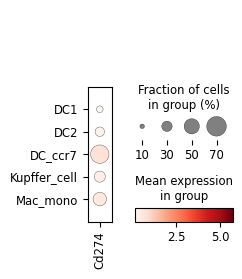

Plotting genotype = RII


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


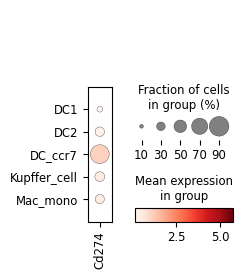

Plotting genotype = PD1


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


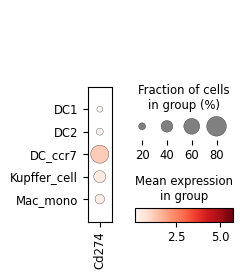

Plotting genotype = 2KO


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


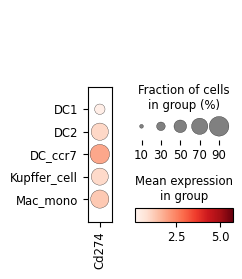

Plotting genotype = 3KO


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


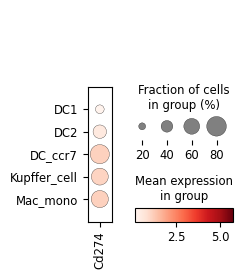

In [ ]:
# Example usage
#genes_to_plot = ['H2-Ab1','Cd80','Cd86', 'Cd40', 'Tnfsf9', 'Cd274']  # Replace with actual gene names
genes_to_plot = ['Cd274']  # Replace with actual gene names
iteratively_plot_dotplot(adata, genes=genes_to_plot, groupby1='cell_subtype_v2', groupby2='genotype')

#### UMAP and gene

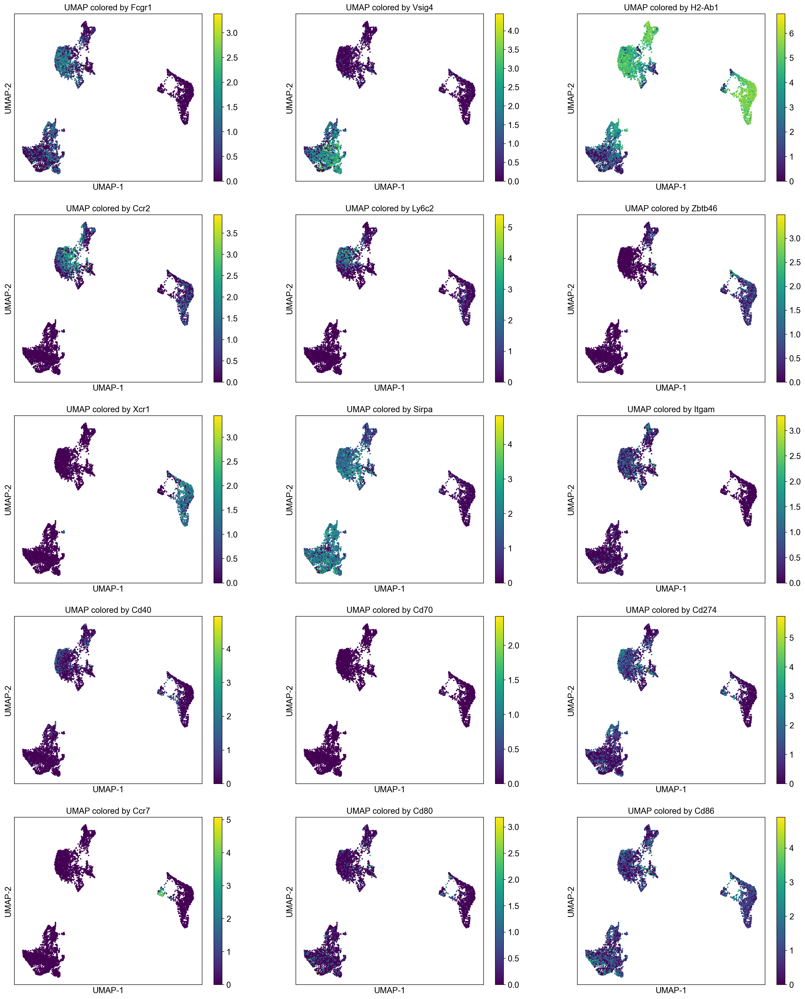

In [ ]:
genes = ['Fcgr1', 'Vsig4', 'H2-Ab1', 'Ccr2', 'Ly6c2', 'Zbtb46', 'Xcr1', 'Sirpa', 'Itgam', 'Cd40', 'Cd70', 'Cd274', 'Ccr7', 'Cd80', 'Cd86']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1

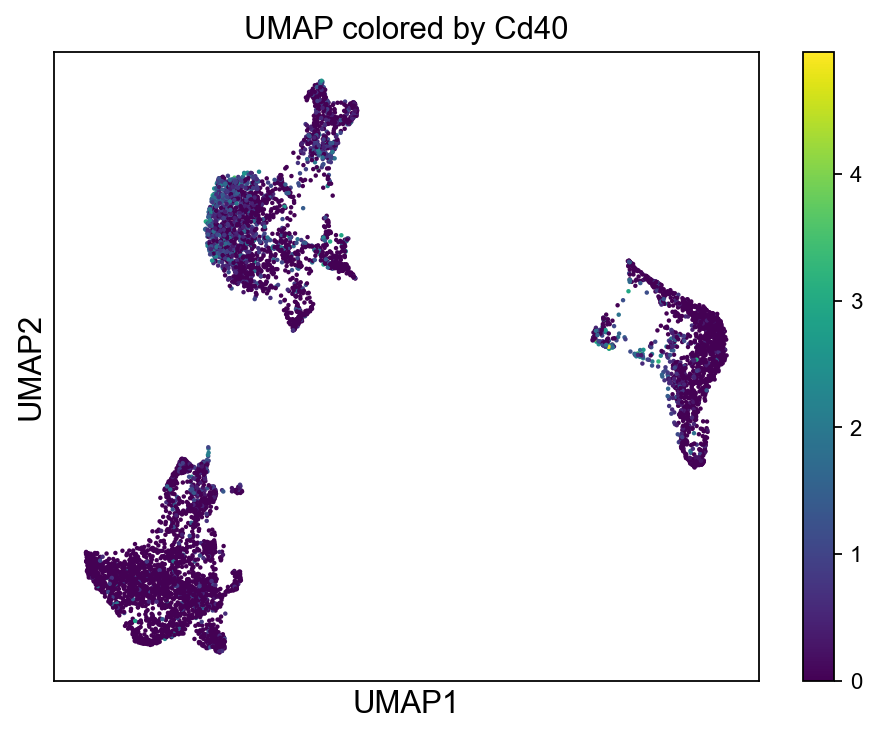

In [ ]:
genes = ['Cd40']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 1, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP1', fontsize = 14)
    ax.set_ylabel('UMAP2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1

In [ ]:
fig = ax.get_figure()
fig.savefig('UMAP_CD40.pdf', format='pdf', dpi=300)

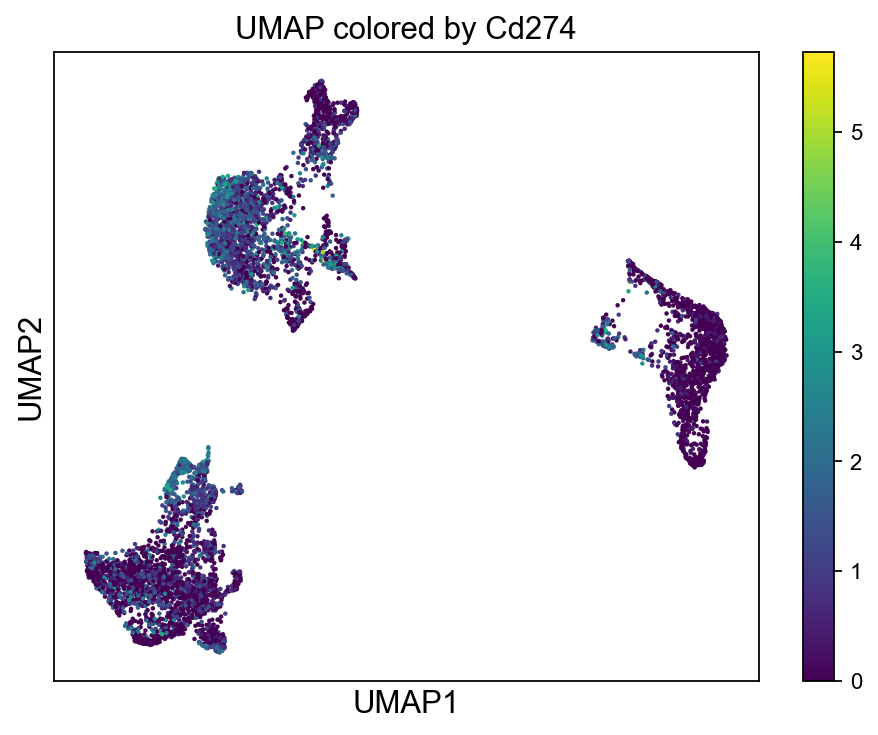

In [ ]:
genes = ['Cd274']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 1, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP1', fontsize = 14)
    ax.set_ylabel('UMAP2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1

In [ ]:
fig = ax.get_figure()
fig.savefig('UMAP_CD274.pdf', format='pdf', dpi=300)

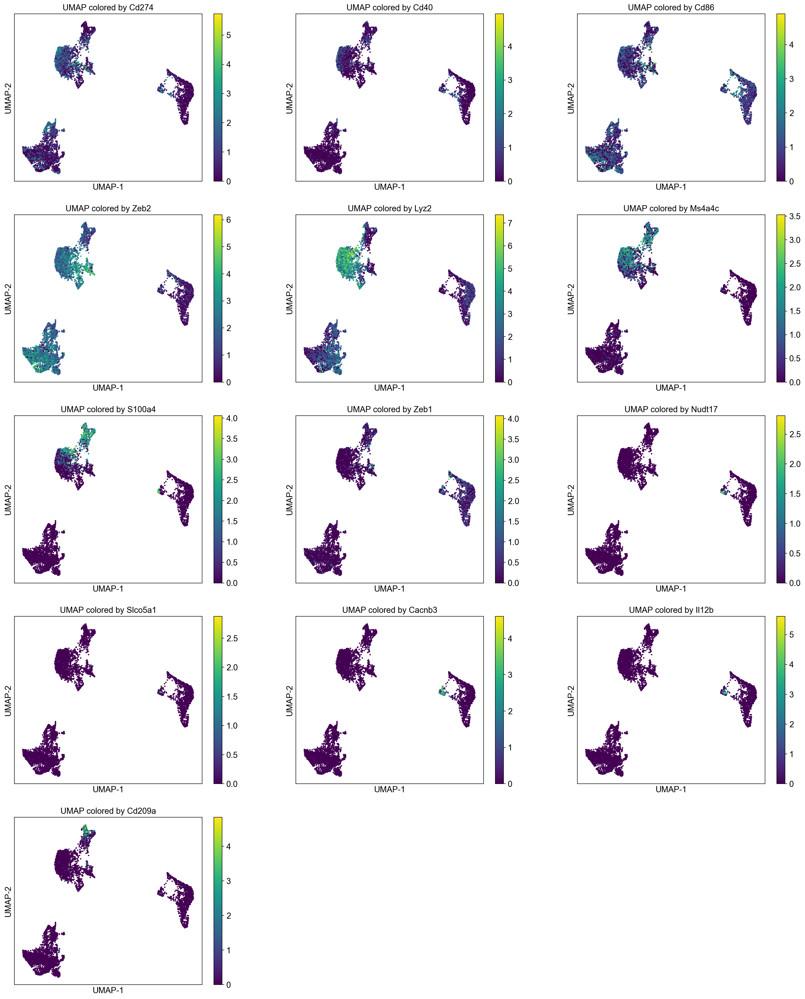

In [ ]:
genes = [ 'Cd274','Cd40', 'Cd86', 'Zeb2', 'Lyz2', 'Ms4a4c','S100a4','Zeb1', 'Nudt17', 'Slco5a1', 'Cacnb3', 'Il12b', 'Cd209a']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1

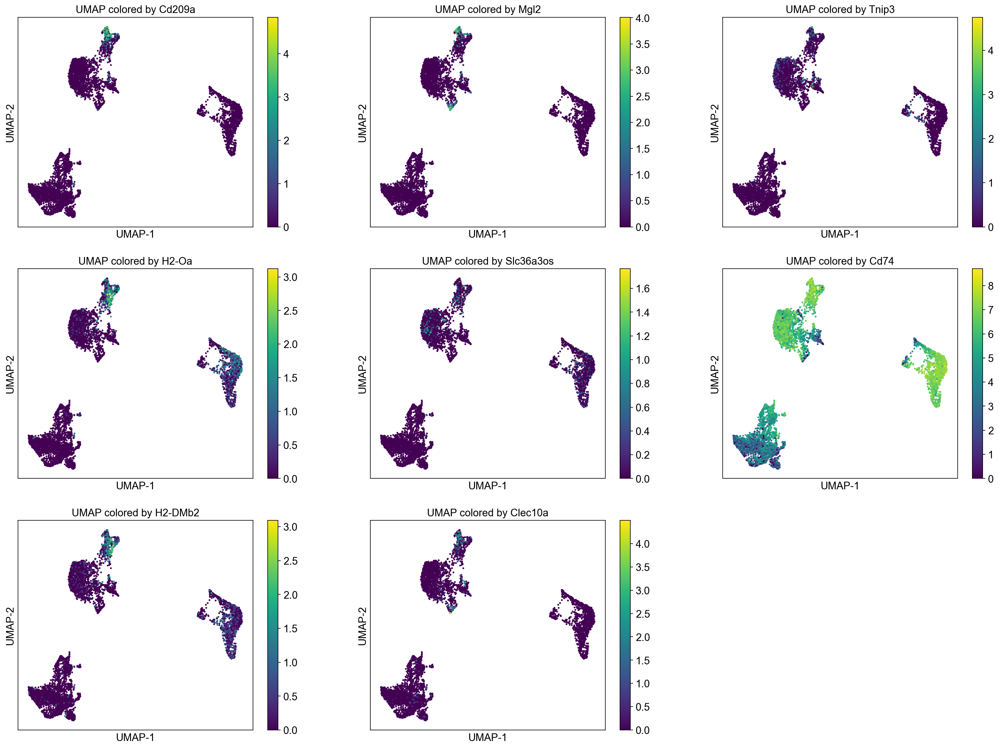

In [ ]:
genes = ['Cd209a', 'Mgl2', 'Tnip3', 'H2-Oa', 'Slc36a3os', 'Cd74', 'H2-DMb2', 'Clec10a']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1

#### palette_dict

In [ ]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['pheno_louvain'].unique())

# Define a color palette for them using "Set2" palette
colors = sns.color_palette("Set2", n_colors=len(categories_order))
palette_dict_pheno = dict(zip(categories_order, colors))

In [ ]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['cell_subtype_v1'].unique(), reverse=True)

# Define a color palette for them using "Set2" palette
colors = sns.color_palette("tab10", n_colors=len(categories_order))
palette_dict_subtype = dict(zip(categories_order, colors))

In [ ]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['cell_subtype_v2'].unique(), reverse=True)

# Define a color palette for them using "Set2" palette
colors = sns.color_palette("tab10", n_colors=len(categories_order))
palette_dict_subtype_v2 = dict(zip(categories_order, colors))

In [ ]:
# Define the keys
keys = ['WT', 'RII', 'PD1', '2KO', '3KO']
# Define the hex colors
hex_colors = ['#CACACA', '#7CAE00', '#1F78B4', '#F8766D', '#C77CFF']

# Create the color palette dictionary
palette_dict_geno = dict(zip(keys, hex_colors))



#### UMAP by pheno

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


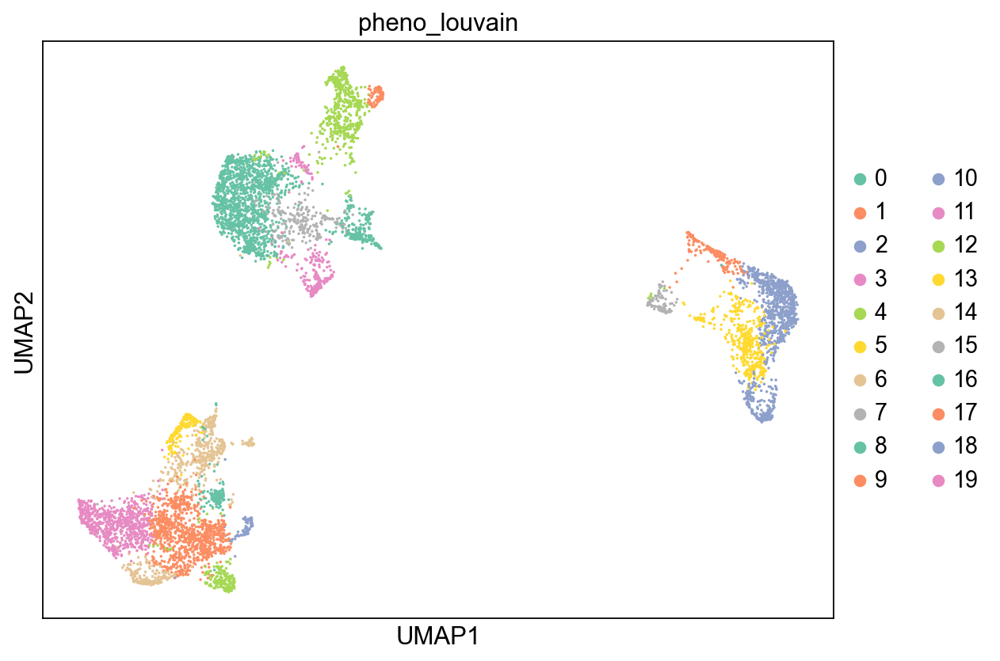

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['pheno_louvain'], s = 10, palette = palette_dict_pheno)

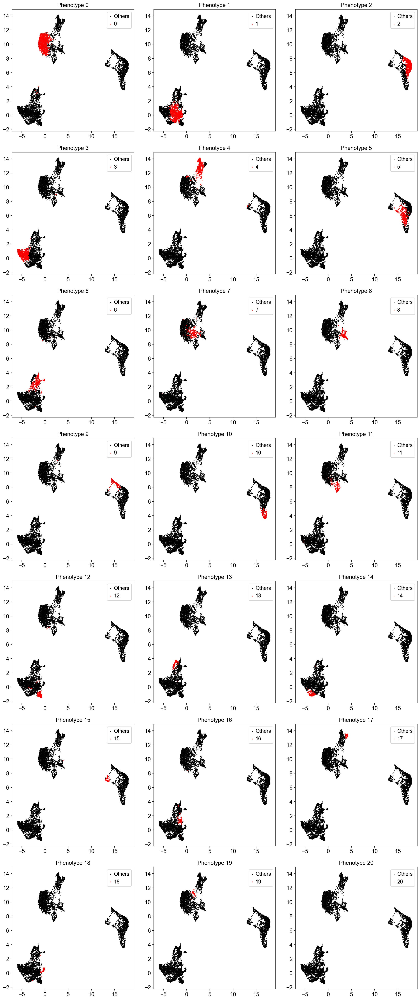

In [ ]:
fig, axs = plt.subplots(7, 3, figsize=(15,35))  # Adjust this according to your needs
axs = axs.ravel()  # flatten the axes for easy indexing

for i in range(21):  # for i from 0 to 20
    cells = np.isin(adata.obs['pheno_louvain'], [i])
    axs[i].scatter(adata.obsm['X_umap'][~cells, 0], adata.obsm['X_umap'][~cells, 1], s=1, c='k', label='Others')
    axs[i].scatter(adata.obsm['X_umap'][cells, 0], adata.obsm['X_umap'][cells, 1], s=1, c='r', label=f'{i}')
    axs[i].set_title(f'Phenotype {i}')
    axs[i].legend()
    axs[i].grid(False)

plt.tight_layout()
plt.show()

#### UMAP by geno

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


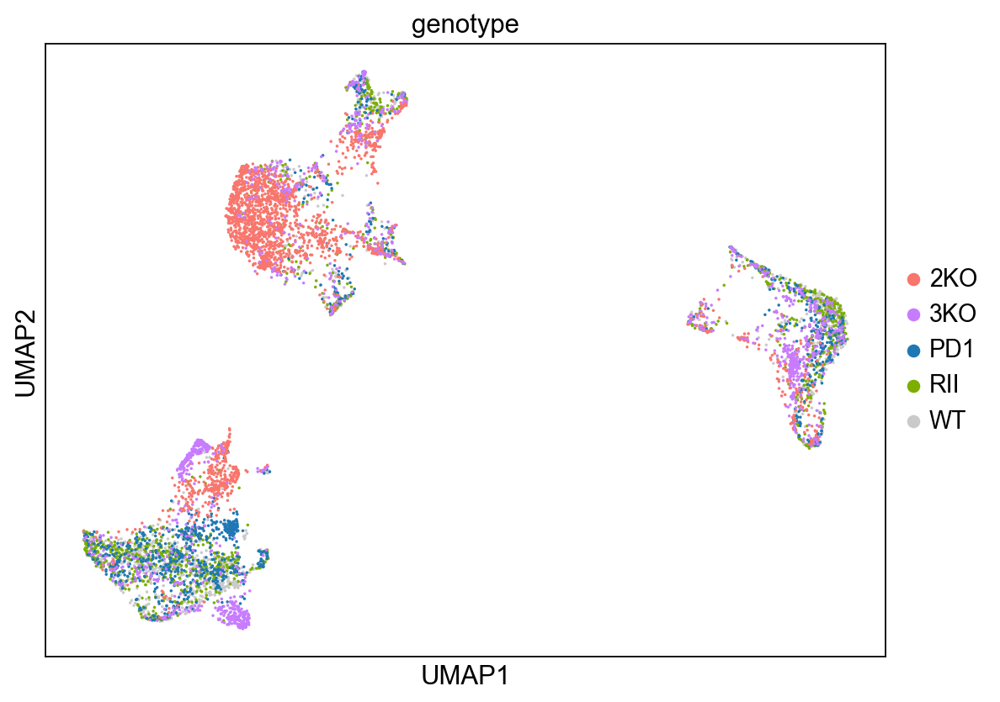

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['genotype'], s = 10, palette = palette_dict_geno)

#### UMAP pheno by mouse

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

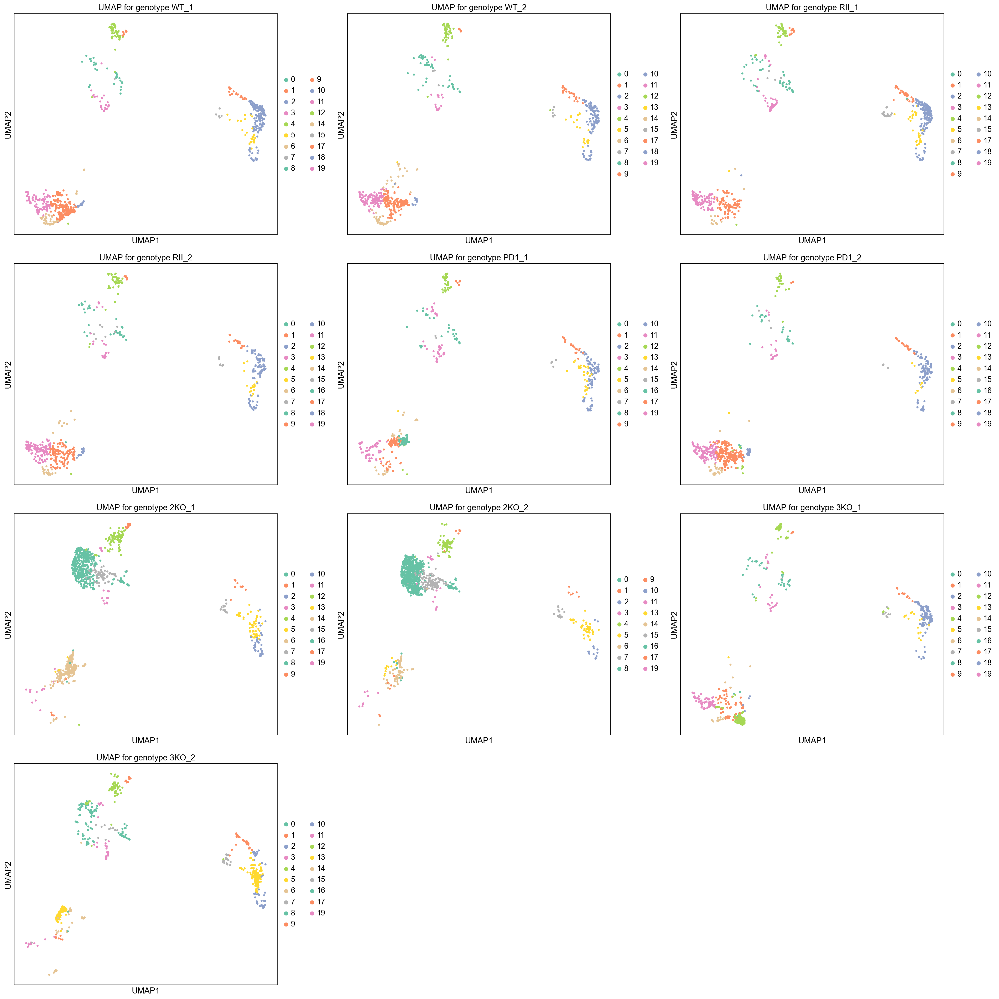

In [ ]:
unique_sample = adata.obs['hash'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, hash in enumerate(unique_sample):
    adata_subset = adata[adata.obs['hash'] == hash]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='pheno_louvain', s=50, palette=palette_dict_pheno,
               title=f'UMAP for genotype {hash}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_sample):
    for i in range(len(unique_sample), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()


#### UMAP pheno by geno

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

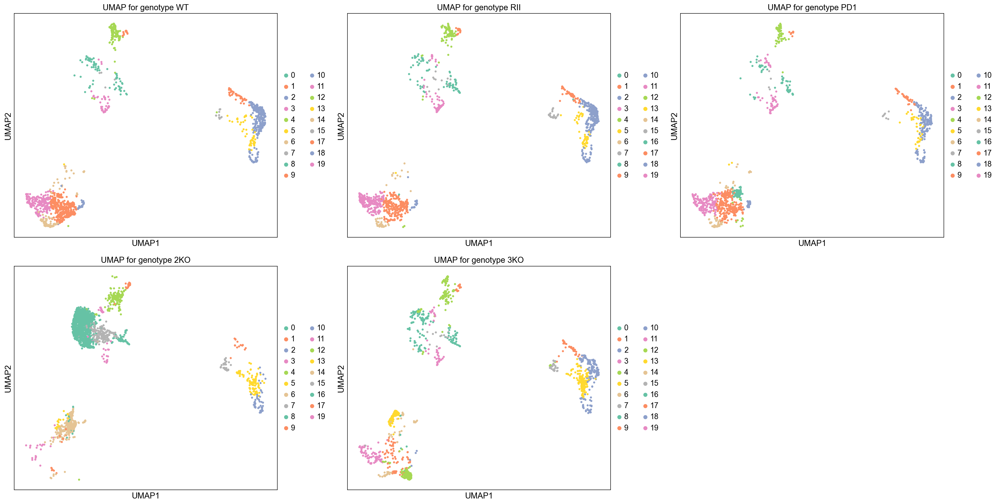

In [ ]:
unique_genotype = adata.obs['genotype'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, genotype in enumerate(unique_genotype):
    adata_subset = adata[adata.obs['genotype'] == genotype]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='pheno_louvain', s=50, palette=palette_dict_pheno,
               title=f'UMAP for genotype {genotype}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_genotype):
    for i in range(len(unique_genotype), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()


#### UMAP by anno

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


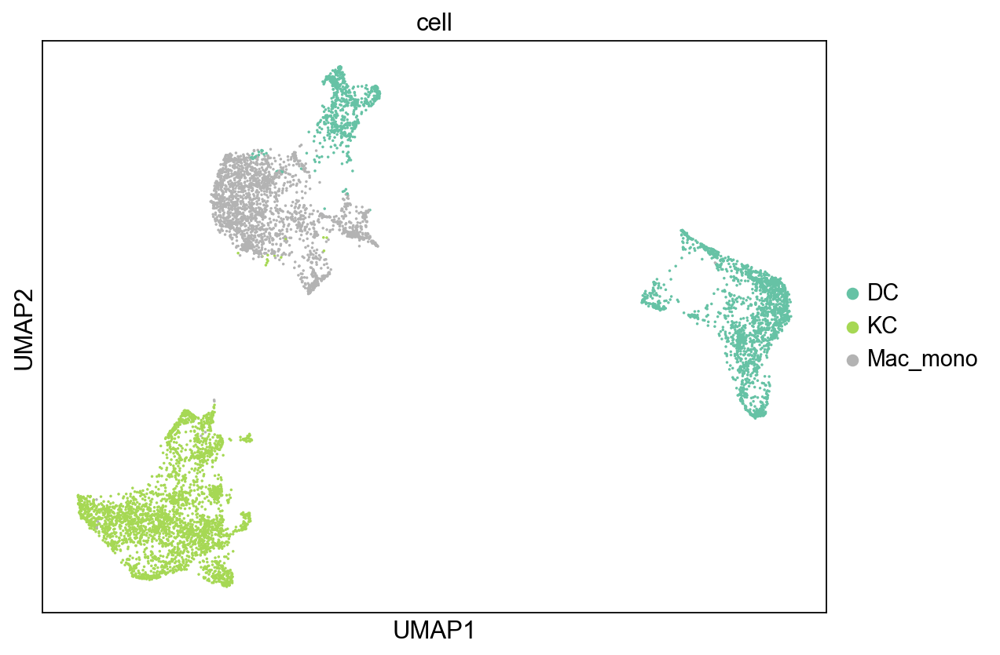

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['cell'], s = 10, palette = 'Set2')

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


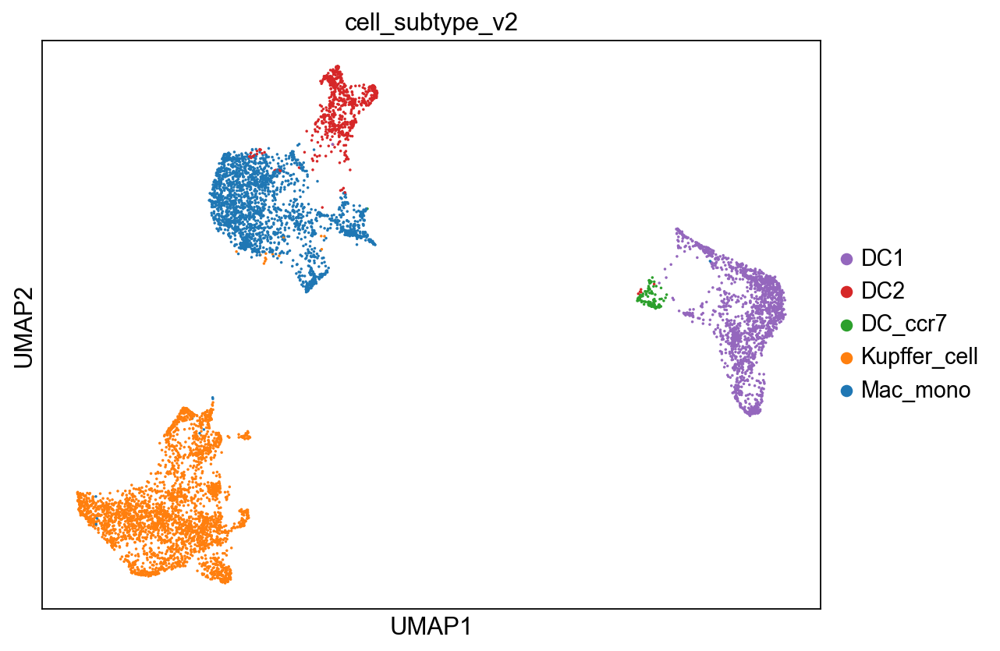

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['cell_subtype_v2'], s = 10, palette = palette_dict_subtype_v2, save = 'mye_UMAP.pdf')


In [ ]:
# Get the current figure and save it
fig = ax.get_figure()
fig.savefig('UMAP.pdf', format='pdf', dpi=300)
# Save the plot as a PDF with a DPI of 300
#fig = ax.get_figure()
#fig.savefig('figures/macs_GSEA_dotplot.pdf', dpi=300, format='pdf')

NameError: name 'ax' is not defined

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


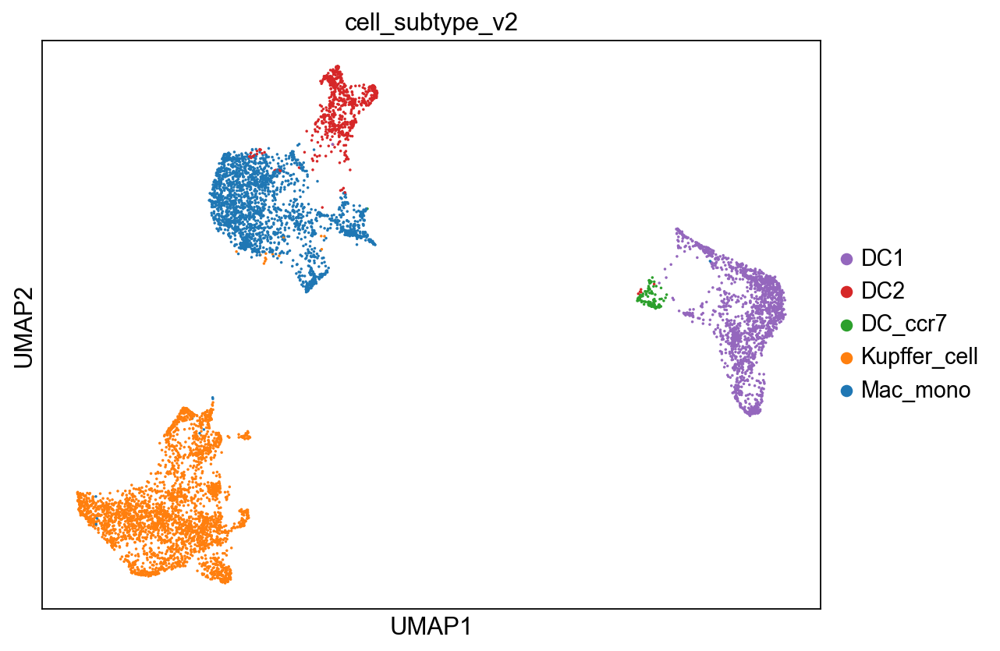

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['cell_subtype_v2'], s = 10, palette = palette_dict_subtype_v2)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


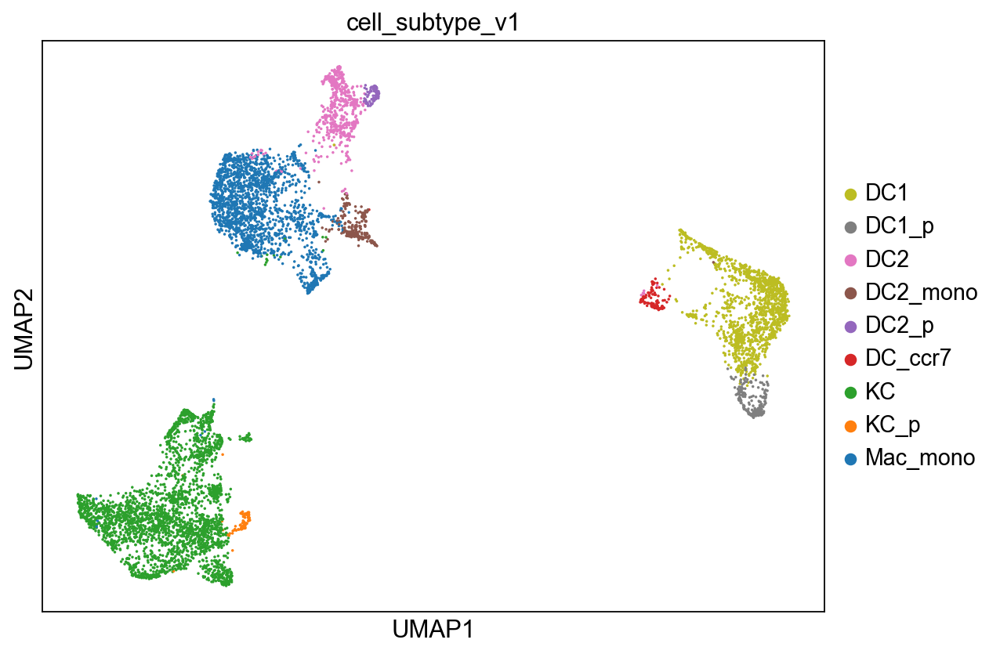

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['cell_subtype_v1'], s = 10, palette = palette_dict_subtype)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


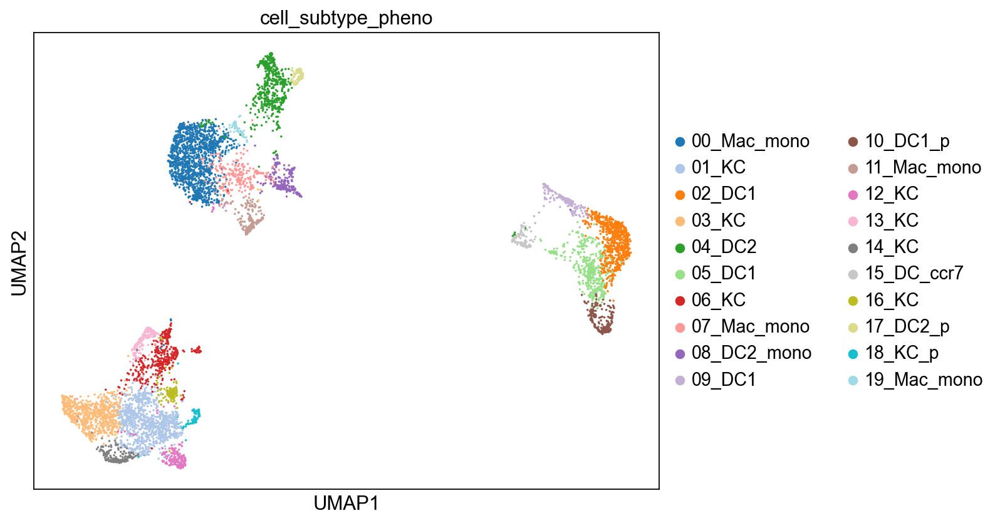

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = ['cell_subtype_pheno'], s = 10, palette = 'tab20')

#### UMAP anno by geno

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

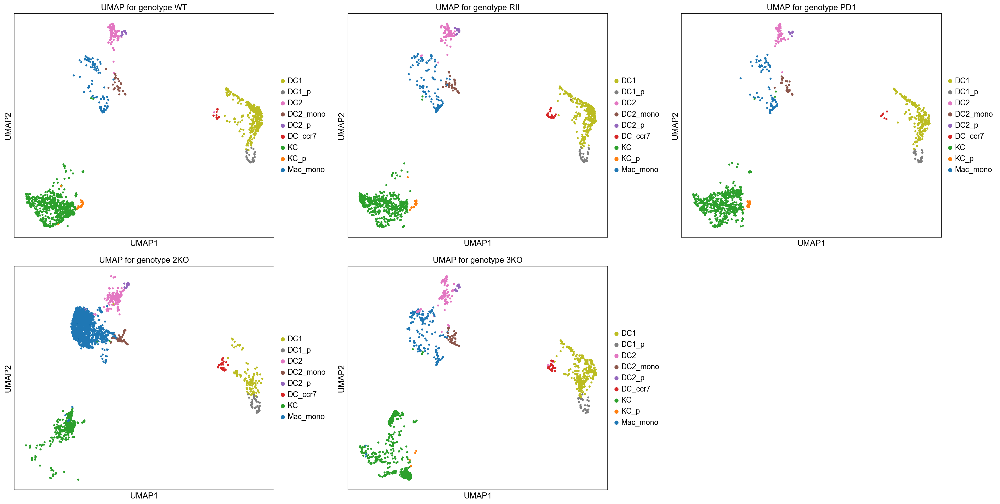

In [ ]:
unique_genotype = adata.obs['genotype'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, genotype in enumerate(unique_genotype):
    adata_subset = adata[adata.obs['genotype'] == genotype]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='cell_subtype_v1', s=50, palette=palette_dict_subtype,
               title=f'UMAP for genotype {genotype}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_genotype):
    for i in range(len(unique_genotype), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

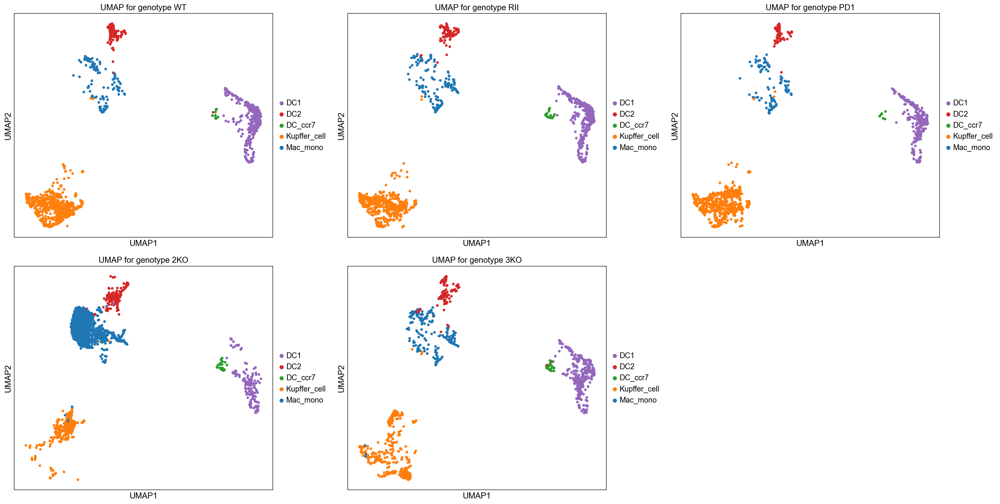

In [ ]:
unique_genotype = adata.obs['genotype'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, genotype in enumerate(unique_genotype):
    adata_subset = adata[adata.obs['genotype'] == genotype]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='cell_subtype_v2', s=80, palette=palette_dict_subtype_v2,
               title=f'UMAP for genotype {genotype}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_genotype):
    for i in range(len(unique_genotype), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

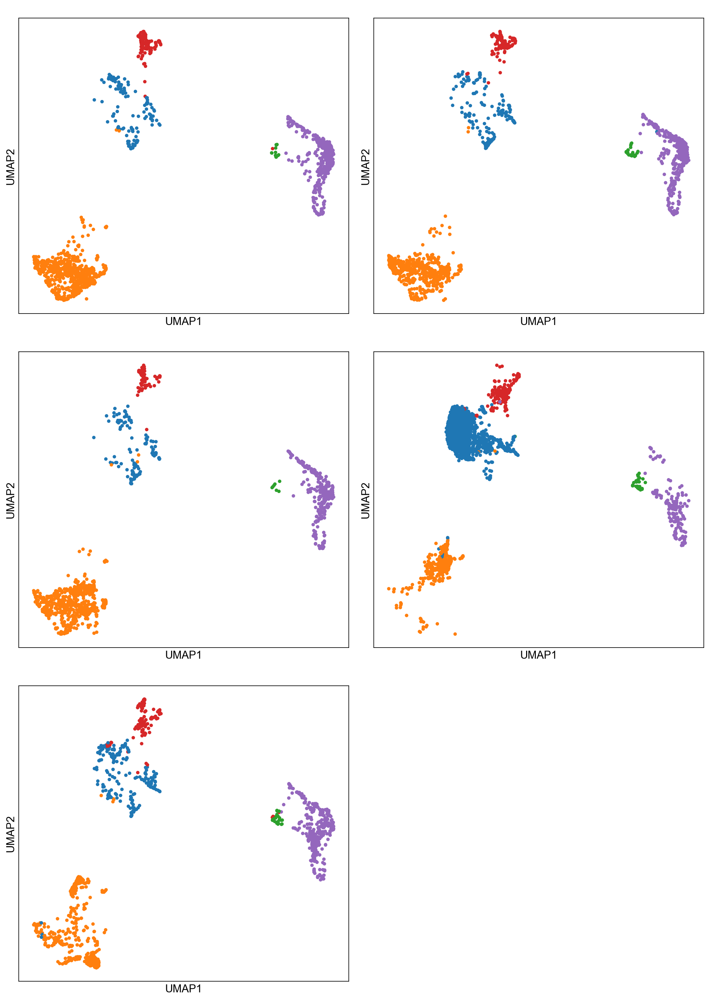

In [ ]:
unique_genotype = adata.obs['genotype'].unique()

nrows = 4
ncols = 2
fig, axs = plt.subplots(nrows, ncols, figsize=(6.5*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, genotype in enumerate(unique_genotype):
    adata_subset = adata[adata.obs['genotype'] == genotype]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='cell_subtype_v2', s=80, palette=palette_dict_subtype_v2,
               title=f' ', ax=axs[i], legend_loc='none', show=False)

# Remove unused subplots
if len(axs) > len(unique_genotype):
    for i in range(len(unique_genotype), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()



#### bar plot

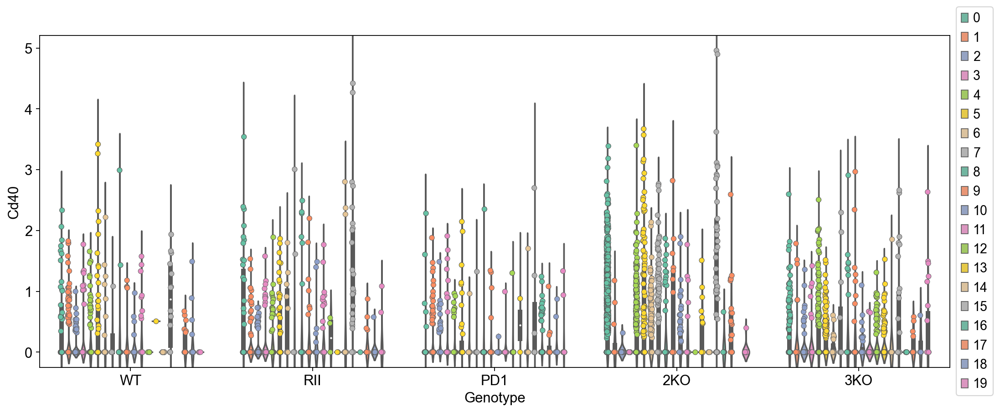

In [ ]:
# pheno_louvain
query = 'Cd40'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['pheno_louvain'], 
                        'Genotype': adata.obs['genotype'], 
                        query: adata.X[:, adata.var_names.get_loc(query)]}, index = adata.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO', '3KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_pheno, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_pheno, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

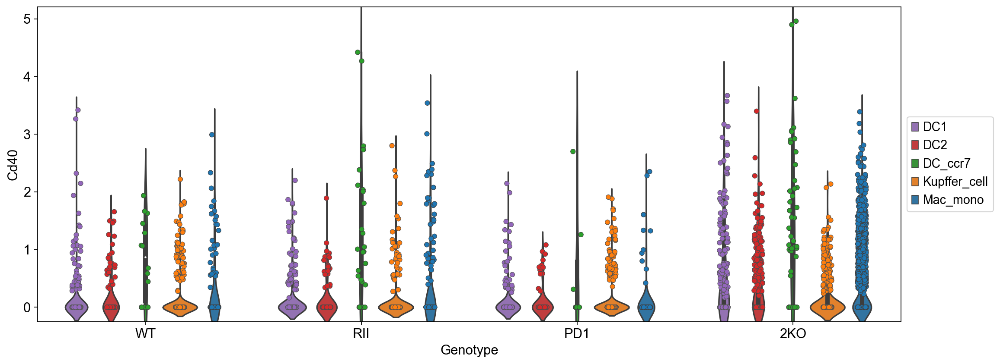

In [ ]:
# cell_subtype_v1
query = 'Cd40'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['cell_subtype_v2'], 
                        'Genotype': adata.obs['genotype'], 
                        query: adata.X[:, adata.var_names.get_loc(query)]}, index = adata.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_subtype_v2, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_subtype_v2, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

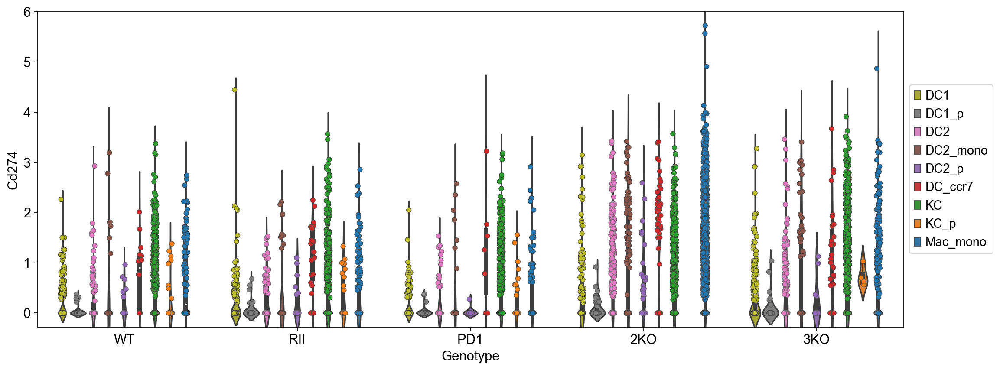

In [ ]:
# cell_subtype_v1
query = 'Cd274'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['cell_subtype_v1'], 
                        'Genotype': adata.obs['genotype'], 
                        query: adata.X[:, adata.var_names.get_loc(query)]}, index = adata.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO', '3KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_subtype, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_subtype, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

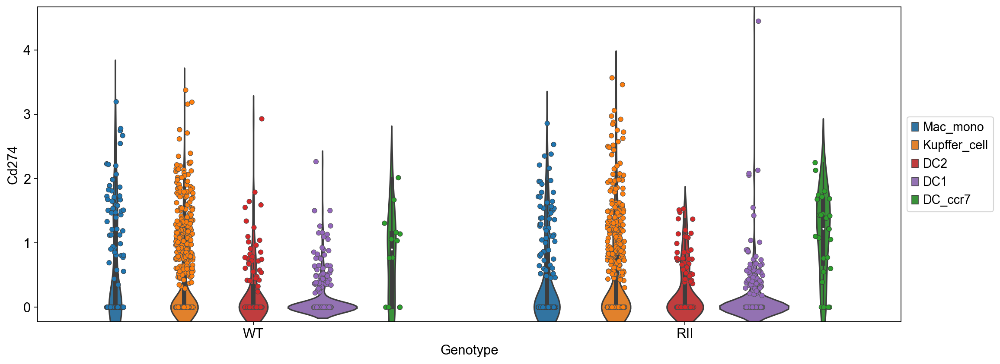

In [ ]:
# cell_subtype_v1
query = 'Cd274'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['cell_subtype_v2'], 
                        'Genotype': adata.obs['genotype'], 
                        query: adata.X[:, adata.var_names.get_loc(query)]}, index = adata.obs.index)
sample_order = ['WT', 'RII']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_subtype_v2, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_subtype_v2, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

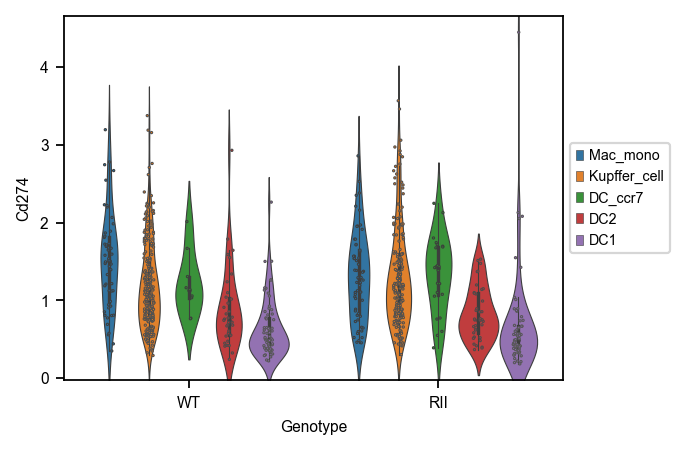

In [ ]:
# Your initial settings and DataFrame preparation
sc.set_figure_params(scanpy=True, fontsize=7)
query = 'Cd274'
df_temp = pd.DataFrame({'Cluster': adata.obs['cell_subtype_v2'], 
                        'Genotype': adata.obs['genotype'], 
                        query: adata.X[:, adata.var_names.get_loc(query)]}, index = adata.obs.index)

# Filter to include only rows/cells with non-zero expression for the query gene
df_expressed = df_temp[df_temp[query] > 0]

# Your specified order for categories
sample_order = ['WT', 'RII']

# Plotting
fig = plt.figure(figsize=(4, 3))
ax = fig.add_subplot(1, 1, 1)

# Violin plot for cells with non-zero expression
sns.violinplot(x="Genotype", y=query, hue="Cluster", data=df_expressed, ax=ax, 
               palette=palette_dict_subtype_v2, order=sample_order, linewidth=0.5)

# Adding a swarm plot on top for the same subset of cells
sns.stripplot(x="Genotype", y=query, hue="Cluster", data=df_expressed, ax=ax, 
              palette=palette_dict_subtype_v2, order=sample_order, dodge=True, size=1, edgecolor="gray", linewidth=0.5, legend=False)

ax.grid(False)

# Adjust legend
ax.get_legend().remove()  # Remove the automatic legend
# Manually add the legend back if needed
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig("figures/CD274_RII_WT.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()

##### customized plot gene expression

In [ ]:
def plot_gene_expression(adata, gene, groupby, groupby2, save=False, plot_legend=True, 
                         groupby_order=None, groupby2_order=None, figuresize=(4, 3), 
                         palette=None, filter_expr=True):
    """
    Plots non-zero gene expression across groups, further categorized by a secondary grouping variable,
    with an option to filter or not filter genes based on expression > 0.
    
    Parameters:
    - adata: An AnnData object.
    - gene: The gene to plot.
    - groupby: The primary grouping variable from adata.obs.
    - groupby2: The secondary grouping variable from adata.obs.
    - save: If False, display the plot. If a string, save the plot to the specified path.
    - plot_legend: If True, display the legend.
    - groupby_order: Order of the primary groups for plotting. If None, use sorted unique values.
    - groupby2_order: Order of the secondary groups for plotting. If None, use sorted unique values.
    - figuresize: Size of the figure.
    - palette: Color palette for the plot. If None, use a default palette.
    - filter_expr: If True, filter out genes with zero expression. If False, include all genes.
    """
    sc.set_figure_params(scanpy=True, fontsize=7)
    
    # Filter adata based on groupby2_order if provided
    if groupby2_order is not None:
        adata_filtered = adata[adata.obs[groupby2].isin(groupby2_order)].copy()
    else:
        adata_filtered = adata
        groupby2_order = sorted(adata_filtered.obs[groupby2].unique())

    if groupby_order is None:
        groupby_order = sorted(adata_filtered.obs[groupby].unique())

    # Extracting gene expression
    gene_expression = adata_filtered[:, adata_filtered.var_names.get_loc(gene)].X
    if scipy.sparse.issparse(gene_expression):
        gene_expression = gene_expression.toarray().flatten()
    else:
        gene_expression = gene_expression.flatten()

    # Create DataFrame
    df = pd.DataFrame({groupby: adata_filtered.obs[groupby], 
                       groupby2: adata_filtered.obs[groupby2], 
                       gene: gene_expression})

    # Optionally filter for non-zero expressions
    if filter_expr:
        df_expressed = df[df[gene] > 0]
    else:
        df_expressed = df

    # Palette adjustment based on actual categories in filtered data
    if palette is None:
        unique_categories = len(groupby2_order)
        palette = sns.color_palette('husl', n_colors=unique_categories)

    # Plotting
    fig, ax = plt.subplots(figsize=figuresize)
    sns.violinplot(x=groupby, y=gene, hue=groupby2, data=df_expressed, ax=ax,
                   palette=palette, order=groupby_order, hue_order=groupby2_order, linewidth=0.5)
    sns.stripplot(x=groupby, y=gene, hue=groupby2, data=df_expressed, ax=ax,
                  palette=palette, order=groupby_order, hue_order=groupby2_order, dodge=True, size=1, edgecolor="gray", linewidth=0.5, legend=False)

    ax.grid(False)

    # Handling the legend
    if plot_legend:
        ax.legend(title=groupby2, loc='center left', bbox_to_anchor=(1, 0.5))
    else:
        ax.get_legend().remove()

    # Save the plot
    if save:
        plt.savefig(save, dpi=150, format='pdf', bbox_inches='tight')

    plt.show()

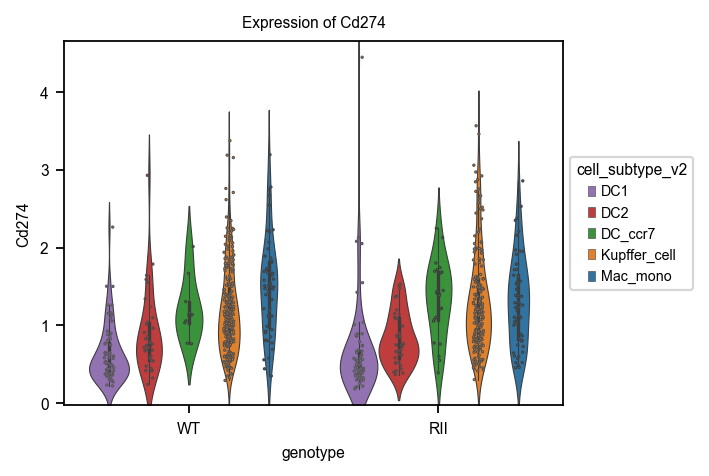

In [ ]:
plot_gene_expression(adata, gene='Cd274', groupby='genotype', groupby_order=['WT', 'RII'], 
                     groupby2='cell_subtype_v2', palette=palette_dict_subtype_v2)

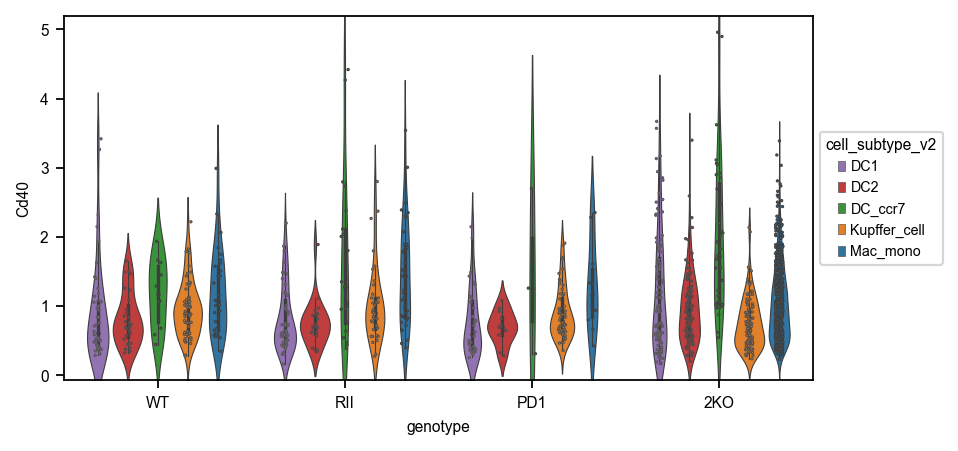

In [ ]:
plot_gene_expression(adata, gene='Cd40', groupby='genotype', groupby_order=['WT', 'RII','PD1', '2KO'], figuresize=(6, 3),
                     groupby2='cell_subtype_v2', palette=palette_dict_subtype_v2)

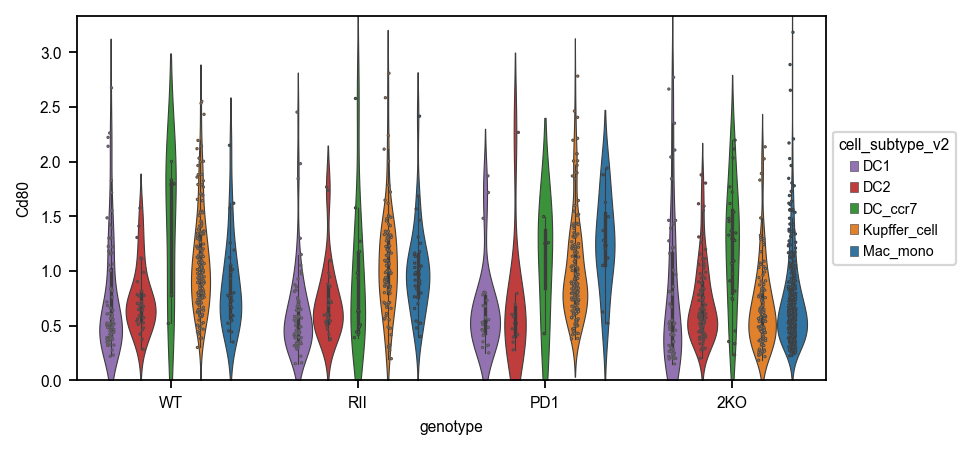

In [ ]:
plot_gene_expression(adata, gene='Cd80', groupby='genotype', groupby_order=['WT', 'RII','PD1', '2KO'], figuresize=(6, 3),
                     groupby2='cell_subtype_v2', palette=palette_dict_subtype_v2)

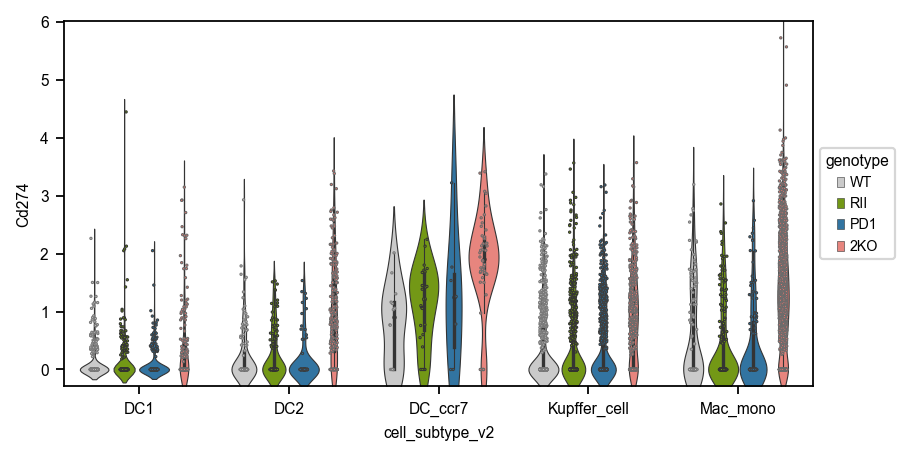

In [ ]:
plot_gene_expression(adata, gene='Cd274', groupby='cell_subtype_v2', figuresize=(6, 3),
                     groupby2='genotype', groupby2_order=['WT', 'RII', 'PD1', '2KO'], palette=palette_dict_geno, filter_expr=False)

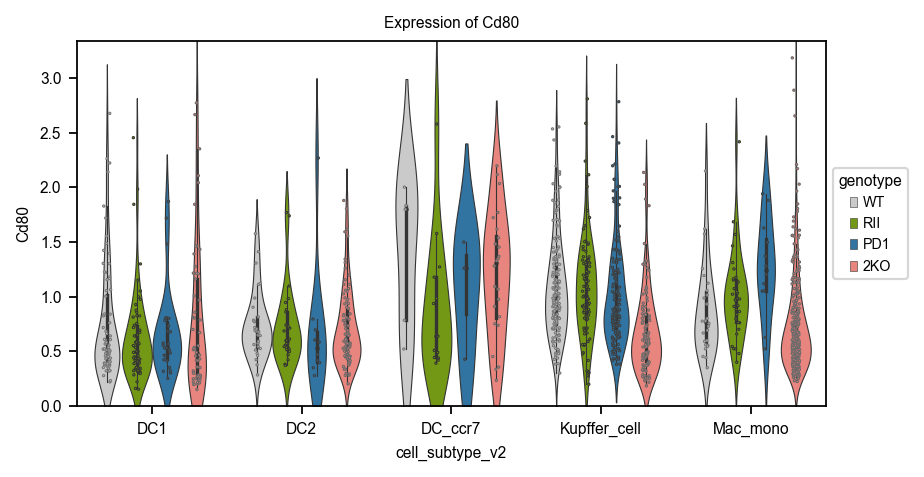

In [ ]:
plot_gene_expression(adata, gene='Cd80', groupby='cell_subtype_v2', figuresize=(6, 3),
                     groupby2='genotype', groupby2_order=['WT', 'RII', 'PD1', '2KO'], palette=palette_dict_geno)

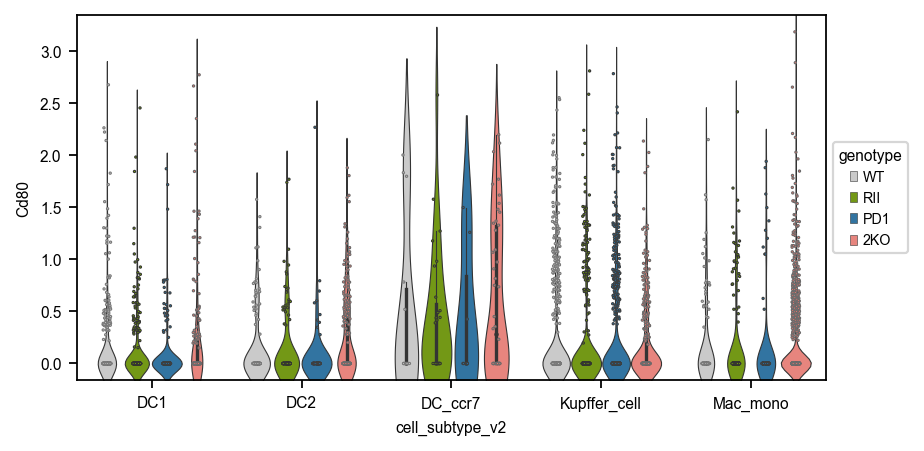

In [ ]:
plot_gene_expression(adata, gene='Cd80', groupby='cell_subtype_v2', figuresize=(6, 3),
                     groupby2='genotype', groupby2_order=['WT', 'RII', 'PD1', '2KO'], palette=palette_dict_geno, filter_expr=False)

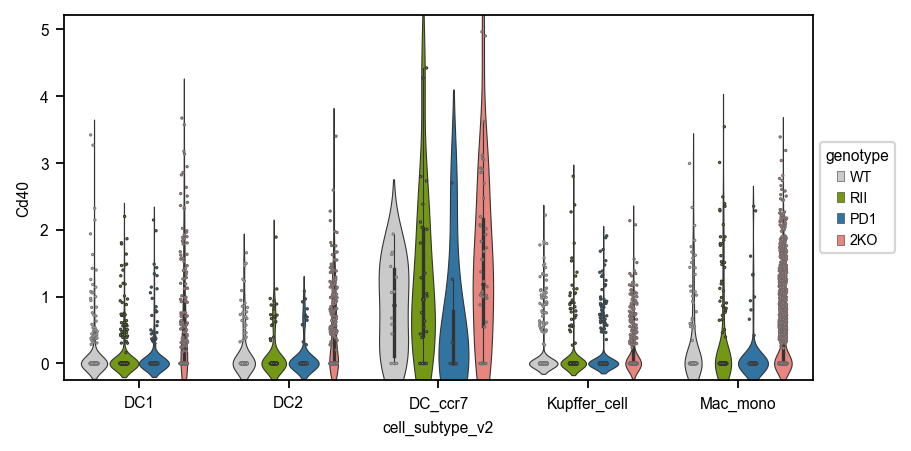

In [ ]:
plot_gene_expression(adata, gene='Cd40', groupby='cell_subtype_v2', figuresize=(6, 3),
                     groupby2='genotype', groupby2_order=['WT', 'RII', 'PD1', '2KO'], 
                     palette=palette_dict_geno, filter_expr=False, save='figures/CD40_expression_4_genotypes.pdf')

## Export

### dotplot

In [90]:
var_names_2 = {'Mac': ['Fcgr1', 'Adgre1'],
                'KC': ['Cd5l','Clec4f', 'Vsig4', 'Timd4'],
                'Mono': ['Ccr2','Ly6c2','Chil3', 'F13a1', 'Cx3cr1'],
                'DC':['Zbtb46', 'Batf3', 'Ccr7'],
                'DC1':['Xcr1', 'Itgae', 'Rab7b'],
                'DC2':['Itgam', 'Sirpa', 'Cd209a', 'Mgl2', 'Tnip3'],
               }

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


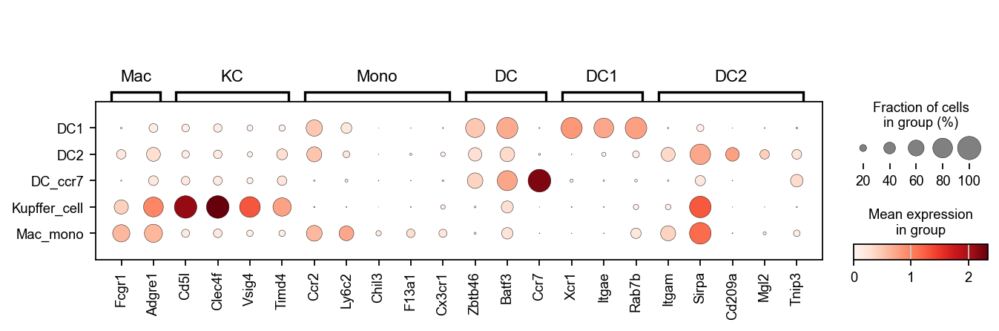

In [128]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=300, frameon=True, vector_friendly=True, 
                     fontsize=10,  color_map=None, format='pdf', 
                     facecolor=None, transparent=False, ipython_format='png2x') #figsize=[6,6],
ac = sc.pl.dotplot(adata, var_names_2, groupby = 'cell_subtype_v2', log=True, layer = 'norm_counts', 
                   show = True, save = 'dotplot_annotated.pdf')

### UMAP

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_util

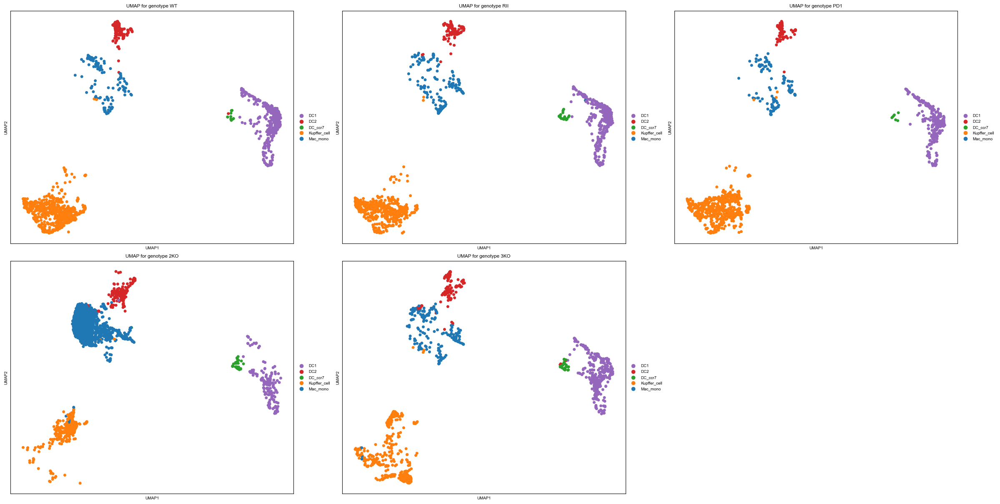

In [76]:
unique_genotype = adata.obs['genotype'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, genotype in enumerate(unique_genotype):
    adata_subset = adata[adata.obs['genotype'] == genotype]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='cell_subtype_v2', s=100, palette=palette_dict_subtype_v2,
               title=f'UMAP for genotype {genotype}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_genotype):
    for i in range(len(unique_genotype), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
fig.savefig('figures/UMAP_geno_by_anno.pdf', format='pdf', dpi=300, bbox_inches = 'tight')
plt.show()

# DEG & GSEA (exploratory)
explore DEGs and top pathways in 2KO compared to other genotypes, in each cell type

## DEG all APC

In [ ]:
adata = sc.read_h5ad('intermediate/12_anno_v2_DEG.h5ad')

In [8]:
adata

AnnData object with n_obs × n_vars = 7399 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno', 'cell_subtype_v2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: '2KO_wilcoxon', 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'

In [5]:
sc.tl.rank_genes_groups(adata, groupby = 'genotype', groups=['2KO'], reference='rest', method='wilcoxon', key_added='2KO_wilcoxon')

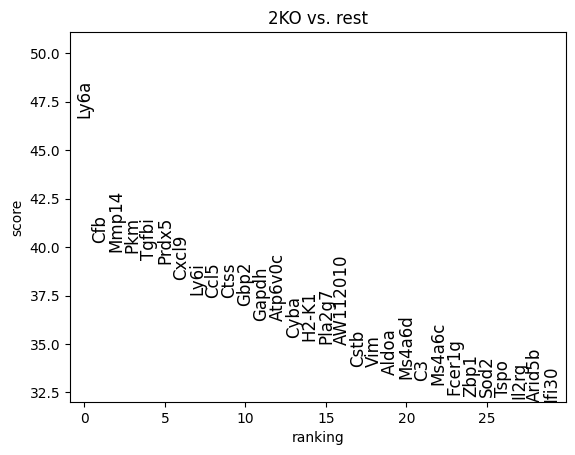

In [6]:
sc.pl.rank_genes_groups(adata, key='2KO_wilcoxon', n_genes=30, fontsize=12)

In [107]:
# Extract DEG results for '2KO' group
genes = adata.uns['2KO_wilcoxon']['names']['2KO']
logfoldchanges = adata.uns['2KO_wilcoxon']['logfoldchanges']['2KO']
pvals = adata.uns['2KO_wilcoxon']['pvals']['2KO']
pvals_adj = adata.uns['2KO_wilcoxon']['pvals_adj']['2KO']

# Create a DataFrame
DEG_2KO_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
})

# Display the DataFrame
DEG_2KO_df.head()

,genes,logfoldchanges,pvals,pvals_adj
0,Ly6a,3.370976,0.0,0.0
1,Cfb,3.353957,0.0,0.0
2,Mmp14,3.648811,0.0,0.0
3,Pkm,1.789646,0.0,0.0
4,Tgfbi,2.598263,0.0,0.0


In [108]:
groups = ['2KO']
de_results = {}
for group in groups:
    genes = adata.uns['2KO_wilcoxon']['names'][group]
    logfoldchanges = adata.uns['2KO_wilcoxon']['logfoldchanges'][group]
    pvals = adata.uns['2KO_wilcoxon']['pvals'][group]
    pvals_adj = adata.uns['2KO_wilcoxon']['pvals_adj'][group]
    de_results[group] = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
    })

# Now, de_results['condition_A'] contains the DEGs for condition_A
de_results['2KO'].head()

,genes,logfoldchanges,pvals,pvals_adj
0,Ly6a,3.370976,0.0,0.0
1,Cfb,3.353957,0.0,0.0
2,Mmp14,3.648811,0.0,0.0
3,Pkm,1.789646,0.0,0.0
4,Tgfbi,2.598263,0.0,0.0


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


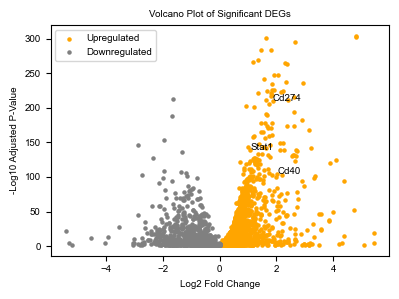

In [109]:
df_DEG = pd.DataFrame({
    'logfoldchanges':DEG_2KO_df['logfoldchanges'],
    'pvals_adj': DEG_2KO_df['pvals_adj']
})

df_DEG.index = de_results['2KO']['genes']

# Extract logfoldchanges and adjusted p-values
logfoldchanges = df_DEG['logfoldchanges']
pvals_adj = df_DEG['pvals_adj']

# Calculate the negative logarithm for adjusted p-values
neg_log_pvals_adj = -np.log10(pvals_adj)

# Filter for significant genes (e.g., pvals_adj < 0.05)
significant_mask = (pvals_adj < 0.05)
significant_logfoldchanges = logfoldchanges[significant_mask]
significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

# Separate upregulated and downregulated genes
upregulated = significant_logfoldchanges > 0
downregulated = significant_logfoldchanges < 0

# Set global font settings
plt.rcParams['font.size'] = 7
plt.rcParams['font.family'] = 'Arial'

# Set up the figure and axis with the new figure size
fig, ax = plt.subplots(figsize=(4, 3))

# Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
# Scatter plot the genes based on their regulation direction
ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='orange', s=5, label='Upregulated')
ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='grey', s=5, label='Downregulated')

# Titles, labels, and other customizations with updated fontsize and font
ax.set_title("Volcano Plot of Significant DEGs", fontsize=7)
ax.set_xlabel("Log2 Fold Change", fontsize=7)
ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
ax.tick_params(axis='both', which='major', labelsize=7)
ax.grid(False)
ax.legend(loc='upper left', fontsize=7)

'''genes_to_label = significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 2) & 
     (significant_neg_log_pvals_adj > 150)) |
    (np.abs(significant_logfoldchanges) > 4)
].index.tolist()  # Convert the index to a list'''

# Add your genes of interest
genes_of_interest = ["Cd40", "Cd274", 'Stat1']
#genes_to_label = genes_to_label + genes_of_interest
genes_to_label = genes_of_interest

# Annotate specific genes with updated fontsize
for gene in genes_to_label:
    if gene in significant_logfoldchanges and gene in significant_neg_log_pvals_adj:
        x = significant_logfoldchanges[gene]
        y = significant_neg_log_pvals_adj[gene]
        ax.annotate(gene, (x, y), fontsize=7, arrowprops=None)


# Display the plot
plt.tight_layout()
plt.savefig("figures/all_apc_2KO_DEG_volcano.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()


### prepare gsea_df

In [110]:
input_df = DEG_2KO_df
# check that there are no NaN in log fold change:
np.sum(np.isnan(input_df['logfoldchanges']))

0

In [111]:
df_gsea = input_df[['genes', 'logfoldchanges', 'pvals_adj']]
# we change the 0 in pvals_adj to the minimum non-zero value
non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
# then multiply by the sign of the log fold change to get the 'score'
df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
# sort
df_gsea = df_gsea.sort_values(by='score', ascending=False)
df_gsea

,genes,logfoldchanges,pvals_adj,pvals_adj_updated,-log10(pvals_adj),score
0,Ly6a,3.370976,0.000000e+00,3.468238e-305,304.459891,304.459891
1,Cfb,3.353957,0.000000e+00,3.468238e-305,304.459891,304.459891
2,Mmp14,3.648811,0.000000e+00,3.468238e-305,304.459891,304.459891
3,Pkm,1.789646,0.000000e+00,3.468238e-305,304.459891,304.459891
4,Tgfbi,2.598263,0.000000e+00,3.468238e-305,304.459891,304.459891
...,...,...,...,...,...,...
15750,Myo9a,-1.320231,2.325405e-137,2.325405e-137,136.633501,-136.633501
15751,Clec4f,-2.893803,3.498217e-147,3.498217e-147,146.456153,-146.456153
15752,Cd81,-1.954404,1.587829e-154,1.587829e-154,153.799196,-153.799196
15753,Slc9a9,-1.699088,1.579773e-188,1.579773e-188,187.801405,-187.801405


In [112]:
prerank_input = df_gsea.set_index('genes')['score'].to_frame()
prerank_input

,score
genes,
Ly6a,304.459891
Cfb,304.459891
Mmp14,304.459891
Pkm,304.459891
Tgfbi,304.459891
...,...
Myo9a,-136.633501
Clec4f,-146.456153
Cd81,-153.799196


### read in database

In [13]:
df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
df_set_hm

,1,2,3,4,5,6,7,8,9,10,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN
HALLMARK_APICAL_SURFACE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Adam10,Adipor2,Afap1l2,Akap7,App,Atp6v0a4,Atp8b1,B4galt1,Brca1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APOPTOSIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Add1,Aifm3,Ank,Anxa1,App,Atf3,Avpr1a,Bax,Bcap31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_BILE_ACID_METABOLISM,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abca2,Abca3,Abca4,Abca5,Abca6,Abca8b,Abca9,Abcd1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_CHOLESTEROL_HOMEOSTASIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca2,Acat2,Acss2,Actg1,Adh4,Alcam,Aldoc,Antxr2,Anxa5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
del df_set_hm[1]
df_set_hm.head()

,2,3,4,5,6,7,8,9,10,11,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,Adcy6,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,Bcl10,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,Ank,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,Jag1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,Adam15,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN


In [15]:
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [17]:
path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [26]:
path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

### run GSEA

In [113]:
pre_res_hm = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_hm,
                     threads=1,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 20:53:34,736 [WARNING] Duplicated values found in preranked stats: 51.55% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 20:53:34,740 [INFO] Parsing data files for GSEA.............................
2024-02-26 20:53:34,755 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 20:53:34,757 [INFO] 0050 gene_sets used for further statistical testing.....
2024-02-26 20:53:34,759 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 20:54:05,882 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 20:54:05,883 [INFO] Congratulations. GSEApy runs successfully................



In [114]:
pre_res_cp = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_cp,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_cp', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 20:54:05,923 [WARNING] Duplicated values found in preranked stats: 51.55% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 20:54:05,924 [INFO] Parsing data files for GSEA.............................
2024-02-26 20:54:05,960 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 20:54:05,962 [INFO] 1628 gene_sets used for further statistical testing.....


2024-02-26 20:54:05,964 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 20:58:08,652 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 20:58:08,653 [INFO] Congratulations. GSEApy runs successfully................



In [115]:
pre_res_bioc = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_bioc,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_bioc', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 20:58:09,009 [WARNING] Duplicated values found in preranked stats: 51.55% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 20:58:09,010 [INFO] Parsing data files for GSEA.............................
2024-02-26 20:58:09,016 [INFO] 0006 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 20:58:09,017 [INFO] 0246 gene_sets used for further statistical testing.....


2024-02-26 20:58:09,018 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 20:58:44,138 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 20:58:44,139 [INFO] Congratulations. GSEApy runs successfully................



In [20]:
pre_res_hm.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_APICAL_SURFACE,0.932869,1.367013,0.002265,0.014511,0.015,3/39,1.24%,Il2rg;Plaur;App
1,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.870495,1.358629,0.0,0.00919,0.019,82/181,5.31%,Cfb;Cxcl9;Ccl5;Zbp1;Sod2;Arid5b;Ifi30;Cd274;B2...
2,prerank,HALLMARK_HYPOXIA,0.848506,1.336754,0.0,0.020315,0.061,48/184,7.97%,Tgfbi;Prdx5;Aldoa;Mif;Tpi1;Sdc4;Plac8;Pgk1;Slc...
3,prerank,HALLMARK_COMPLEMENT,0.841785,1.326399,0.0,0.022734,0.089,38/181,4.23%,Cfb;Mmp14;Ccl5;Ctss;Pla2g7;C3;Fcer1g;Cebpb;Msr...
4,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.58733,-1.316836,0.04,0.269388,0.16975,10/120,2.98%,Camk1d;Thrb;Ptprj;Btg2;Selenop;Prkn;Gprc5c;Cd2...
5,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.842696,1.313346,0.0,0.036374,0.173,51/176,5.31%,Mmp14;Cxcl9;Ccl5;Cybb;Sema4d;Irf1;Cd40;Plaur;E...
6,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.856857,1.302896,0.01056,0.043533,0.237,46/88,8.84%,Ifi30;B2m;Isg15;Ifitm2;Psme2;Irf1;Psmb8;Tap1;G...
7,prerank,HALLMARK_MTORC1_SIGNALING,0.837646,1.302807,0.0,0.037452,0.238,54/192,7.25%,Aldoa;Ifi30;Tpi1;Pnp;Nupr1;Ctsc;Pgk1;Slc2a1;Na...
8,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.830284,1.298954,0.001011,0.039059,0.274,90/193,10.94%,Atp6v0c;Cox8a;Cox5b;Sdhb;Ldha;Alas1;Cox6b1;Mpc...
9,prerank,HALLMARK_CHOLESTEROL_HOMEOSTASIS,0.849605,1.288591,0.02623,0.049015,0.364,15/70,6.89%,Cxcl16;Lgals3;Plaur;S100a11;Anxa5;Fabp5;Nfil3;...


In [21]:
pre_res_cp.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_COLLAGEN_CHAIN_TRIMERIZATION,-0.900861,-1.608984,0.0,0.291906,0.208,2/32,6.52%,Col23a1;Col27a1
1,prerank,WP_GPCRS_CLASS_B_SECRETIN_LIKE,-0.972396,-1.568501,0.0,0.37987,0.465,2/17,0.37%,Adgre5;Adgrl3
2,prerank,REACTOME_NCAM1_INTERACTIONS,-0.980751,-1.558959,0.004386,0.308614,0.531,1/14,1.94%,St8sia4
3,prerank,REACTOME_RND2_GTPASE_CYCLE,-0.828748,-1.552269,0.01626,0.260946,0.574,7/41,3.50%,Fnbp1;Pkp4;Rbm39;Arhgap5;Pik3r1;Lrrc1;Tfrc
4,prerank,WP_RETINOL_METABOLISM,-0.888655,-1.521763,0.013889,0.356577,0.749,7/33,5.64%,Sult1a1;Cd36;Rxra;Lpl;Scarb1;Adh1;Dhrs3
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,REACTOME_BBSOME_MEDIATED_CARGO_TARGETING_TO_CI...,-0.314936,-0.468595,1.0,1.0,1.0,2/11,11.64%,Bbs9;Smo
1624,prerank,REACTOME_TRANSCRIPTIONAL_REGULATION_BY_MECP2,0.370837,0.467593,0.993958,0.997335,1.0,2/5,16.45%,Mecp2;Sin3a
1625,prerank,REACTOME_FGFR2_LIGAND_BINDING_AND_ACTIVATION,-0.318961,-0.431295,0.992424,1.0,1.0,7/7,100.00%,Fgf1;Fgf23;Fgf9;Fgf7;Fgf20;Fgfbp3;Fgf2
1626,prerank,REACTOME_FGFR2C_LIGAND_BINDING_AND_ACTIVATION,-0.318921,-0.423738,1.0,1.0,1.0,5/5,100.00%,Fgf1;Fgf23;Fgf9;Fgf20;Fgf2


In [31]:
pre_res_bioc.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.992467,1.375178,0.0,0.006788,0.006,1/22,0.61%,F10
1,prerank,BIOCARTA_ERYTH_PATHWAY,-0.890553,-1.308588,0.140271,1.0,0.969,2/11,0.55%,Igf1;Flt3
2,prerank,BIOCARTA_AMAN_PATHWAY,-0.91838,-1.293609,0.131579,1.0,0.983,3/8,1.94%,Man2b1;St3gal4;St8sia4
3,prerank,BIOCARTA_RECK_PATHWAY,0.976038,1.293189,0.020718,1.0,0.765,1/8,0.02%,Mmp14
4,prerank,BIOCARTA_ACE2_PATHWAY,0.979169,1.287311,0.006693,0.972038,0.83,1/9,2.09%,Agtrap
...,...,...,...,...,...,...,...,...,...,...
241,prerank,BIOCARTA_EIF4_PATHWAY,0.417109,0.571426,0.979899,0.994169,1.0,2/20,4.80%,Eif4ebp1;Mapk3
242,prerank,BIOCARTA_MEF2D_PATHWAY,0.41367,0.558856,0.98057,0.993363,1.0,5/15,16.24%,Capns1;Calm3;Calm1;Ep300;Mef2d
243,prerank,BIOCARTA_ERBB3_PATHWAY,0.432951,0.548124,0.977749,0.991595,1.0,1/6,16.09%,Nrg1
244,prerank,BIOCARTA_CTCF_PATHWAY,0.394155,0.545566,0.981752,0.987085,1.0,2/23,5.15%,Tgfbr1;Mdm2


In [116]:
df_bioc = pre_res_bioc.res2d[pre_res_bioc.res2d['FDR q-val'] <= 0.9]
ordered_df_bioc = df_bioc.sort_values(by='NES')
ordered_df_bioc

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.992467,1.375178,0.0,0.006788,0.006,1/22,0.61%,F10


In [117]:
df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.2]
ordered_df_cp = df_cp.sort_values(by='NES')
ordered_df_cp

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
86,prerank,REACTOME_ER_PHAGOSOME_PATHWAY,0.947229,1.308216,0.007151,0.196444,0.997,12/23,2.88%,H2-K1;B2m;H2-Q7;H2-Q4;H2-T22;Tapbp;Tap1;Vamp8;...
84,prerank,REACTOME_DEGRADATION_OF_AXIN,0.885605,1.308698,0.010251,0.196529,0.997,32/52,7.23%,Psmb10;Psme2;Psmb8;Psmb6;Psmb3;Psmb2;Ubb;Psmd8...
83,prerank,REACTOME_DEGRADATION_OF_DVL,0.886569,1.310084,0.009112,0.188306,0.995,33/53,7.23%,Psmb10;Psme2;Psmb8;Psmb6;Psmb3;Psmb2;Ubb;Psmd8...
82,prerank,REACTOME_ACTIVATION_OF_NF_KAPPAB_IN_B_CELLS,0.882407,1.310749,0.009009,0.187148,0.995,42/61,8.68%,Psmb10;Psme2;Psmb8;Psmb6;Nfkbia;Malt1;Psmb3;Ps...
81,prerank,REACTOME_NUCLEAR_EVENTS_MEDIATED_BY_NFE2L2,0.889618,1.31134,0.010181,0.186988,0.995,35/52,7.23%,Psmb10;Psme2;Psmb8;Psmb6;Nfe2l2;Psmb3;Prdx1;Ps...
79,prerank,REACTOME_CELLULAR_RESPONSE_TO_HYPOXIA,0.875132,1.311601,0.009879,0.18983,0.995,37/67,7.23%,Psmb10;Psme2;Psmb8;Psmb6;Elob;Psmb3;Psmb2;Hif1...
78,prerank,REACTOME_UBIQUITIN_MEDIATED_DEGRADATION_OF_PHO...,0.887654,1.311759,0.01934,0.19305,0.994,32/49,7.23%,Psmb10;Psme2;Psmb8;Psmb6;Psmb3;Psmb2;Ubb;Psmd8...
76,prerank,REACTOME_ANTIGEN_PRESENTATION_FOLDING_ASSEMBLY...,0.934229,1.312598,0.007059,0.190654,0.991,11/30,2.88%,H2-K1;B2m;H2-Q7;H2-Q4;H2-T22;Tapbp;Tap1;H2-Q6;...
75,prerank,REACTOME_REGULATION_OF_RAS_BY_GAPS,0.873441,1.312692,0.010965,0.194803,0.991,34/64,7.23%,Psmb10;Psme2;Psmb8;Psmb6;Rasa4;Psmb3;Psmb2;Ubb...
74,prerank,REACTOME_UCH_PROTEINASES,0.863679,1.313531,0.009709,0.193243,0.989,34/77,8.00%,Psmb10;Psme2;Psmb8;Psmb6;Psmb3;Psmb2;Ubb;Psmd8...


In [120]:
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il']
mask2 = ordered_df_cp['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_cp_filtered = ordered_df_cp[mask2]
ordered_df_cp_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
86,prerank,REACTOME_ER_PHAGOSOME_PATHWAY,0.947229,1.308216,0.007151,0.196444,0.997,12/23,2.88%,H2-K1;B2m;H2-Q7;H2-Q4;H2-T22;Tapbp;Tap1;Vamp8;...
76,prerank,REACTOME_ANTIGEN_PRESENTATION_FOLDING_ASSEMBLY...,0.934229,1.312598,0.007059,0.190654,0.991,11/30,2.88%,H2-K1;B2m;H2-Q7;H2-Q4;H2-T22;Tapbp;Tap1;H2-Q6;...
73,prerank,REACTOME_C_TYPE_LECTIN_RECEPTORS_CLRS,0.852082,1.314269,0.005365,0.191967,0.989,55/107,8.79%,Fcer1g;Psmb10;Psme2;Psmb8;Clec4e;Psmb6;Pycard;...
71,prerank,REACTOME_SIGNALING_BY_INTERLEUKINS,0.837218,1.31736,0.0,0.174794,0.981,87/232,9.35%,Il2rg;N4bp1;Psmb10;Psme2;Socs3;Psmb8;Psmb6;Il4...
70,prerank,REACTOME_CLEC7A_DECTIN_1_SIGNALING,0.864156,1.317425,0.004329,0.179691,0.979,51/89,8.79%,Psmb10;Psme2;Psmb8;Psmb6;Pycard;Nfkbia;Malt1;P...
66,prerank,WP_TYROBP_CAUSAL_NETWORK_IN_MICROGLIA,0.893304,1.31889,0.001134,0.191737,0.975,19/56,3.89%,C3;Capg;Cxcl16;Tnfrsf1b;Itgb2;Npc2;Tyrobp;Pyca...
57,prerank,REACTOME_ANTIGEN_PROCESSING_CROSS_PRESENTATION,0.876699,1.330221,0.005325,0.151232,0.867,51/78,7.23%,Cyba;H2-K1;B2m;H2-Q7;Cybb;Psmb10;Psme2;H2-Q4;F...
53,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.983397,1.332821,0.0,0.155303,0.822,3/15,1.58%,H2-Eb1;H2-Aa;H2-Ab1
49,prerank,REACTOME_DAP12_INTERACTIONS,0.909901,1.335251,0.001133,0.166569,0.795,14/49,2.36%,H2-K1;B2m;H2-Q7;H2-Q4;Sirpb1c;H2-T22;Tyrobp;H2...
45,prerank,REACTOME_INTERLEUKIN_1_FAMILY_SIGNALING,0.868971,1.33908,0.0,0.15769,0.73,59/110,8.92%,N4bp1;Psmb10;Psme2;Psmb8;Psmb6;Il1rn;Gsdmd;Nfk...


In [118]:
df_hm = pre_res_hm.res2d[pre_res_hm.res2d['FDR q-val'] <= 0.1]
ordered_df_hm = df_hm.sort_values(by='NES')
ordered_df_hm

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
14,prerank,HALLMARK_GLYCOLYSIS,0.807881,1.2675,0.009156,0.060463,0.578,29/186,7.34%,Pkm;Tgfbi;Aldoa;Mif;Tpi1;Pgam1;Pgk1;Slc16a3;Ld...
13,prerank,HALLMARK_TNFA_SIGNALING_VIA_NFKB,0.814789,1.267564,0.008105,0.065114,0.578,69/189,8.53%,Ccl5;Sod2;Cebpb;Sdc4;Socs3;Dram1;Irf1;Plaur;Bt...
12,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.815579,1.267948,0.010215,0.070137,0.574,51/179,6.46%,Cxcl9;Ccl5;Ctss;Il2rg;B2m;Capg;Fcgr2b;Psmb10;S...
11,prerank,HALLMARK_UV_RESPONSE_UP,0.821237,1.277684,0.009317,0.057429,0.476,32/141,5.78%,Mmp14;Aldoa;Sod2;Grina;Irf1;Btg1;Tap1;Alas1;Nf...
10,prerank,HALLMARK_IL6_JAK_STAT3_SIGNALING,0.844467,1.282138,0.02063,0.054368,0.424,36/80,7.34%,Cxcl9;Il2rg;Stat1;Socs3;Ptpn1;Irf1;Tnfrsf1b;Cc...
9,prerank,HALLMARK_CHOLESTEROL_HOMEOSTASIS,0.849605,1.288591,0.02623,0.049015,0.364,15/70,6.89%,Cxcl16;Lgals3;Plaur;S100a11;Anxa5;Fabp5;Nfil3;...
8,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.830284,1.298954,0.001011,0.039059,0.274,90/193,10.94%,Atp6v0c;Cox8a;Cox5b;Sdhb;Ldha;Alas1;Cox6b1;Mpc...
7,prerank,HALLMARK_MTORC1_SIGNALING,0.837646,1.302807,0.0,0.037452,0.238,54/192,7.25%,Aldoa;Ifi30;Tpi1;Pnp;Nupr1;Ctsc;Pgk1;Slc2a1;Na...
6,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.856857,1.302896,0.01056,0.043533,0.237,46/88,8.84%,Ifi30;B2m;Isg15;Ifitm2;Psme2;Irf1;Psmb8;Tap1;G...
5,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.842696,1.313346,0.0,0.036374,0.173,51/176,5.31%,Mmp14;Cxcl9;Ccl5;Cybb;Sema4d;Irf1;Cd40;Plaur;E...


In [24]:
pre_res_hm.res2d[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
1,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.870495,1.358629,0.0,0.00919,0.019,82/181,5.31%,Cfb;Cxcl9;Ccl5;Zbp1;Sod2;Arid5b;Ifi30;Cd274;B2...
5,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.842696,1.313346,0.0,0.036374,0.173,51/176,5.31%,Mmp14;Cxcl9;Ccl5;Cybb;Sema4d;Irf1;Cd40;Plaur;E...
12,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.815579,1.267948,0.010215,0.070137,0.574,51/179,6.46%,Cxcl9;Ccl5;Ctss;Il2rg;B2m;Capg;Fcgr2b;Psmb10;S...


In [25]:
pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
32,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.880934,1.357221,0.001072,0.118255,0.369,49/91,9.35%,Psmb10;Psme2;Cd40;Psmb8;Tnfrsf1b;Psmb6;Psmb3;P...
35,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.942366,1.351965,0.003555,0.104025,0.469,5/29,3.21%,Il2rg;Cd40;Tnfrsf1b;Il4ra;Tnfrsf1a
105,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.844911,1.296046,0.008439,0.245561,0.999,20/108,2.65%,H2-K1;C3;B2m;H2-Q7;Ifitm2;Fcgr2b;Fcgr4;H2-Q4;L...
124,prerank,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,0.807502,1.283777,0.0,0.31843,1.0,132/392,10.99%,Il2rg;Isg15;N4bp1;Psmb10;Psme2;Socs3;Ptpn1;Cd4...
180,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.959302,1.255869,0.033693,0.465336,1.0,4/9,2.01%,Fcgr2b;Cd40;Itgb2;Icam1
197,prerank,BIOCARTA_ASBCELL_PATHWAY,0.941764,1.248527,0.059585,0.514463,1.0,2/10,4.37%,Cd40;Fas
246,prerank,BIOCARTA_CD40_PATHWAY,0.908695,1.22656,0.095415,0.625017,1.0,10/14,8.79%,Cd40;Nfkbia;Tnfaip3;Traf3;Ikbkb;Map3k1;Dusp1;R...
247,prerank,REACTOME_ADAPTIVE_IMMUNE_SYSTEM,0.776784,1.225908,0.0,0.629369,1.0,162/652,9.79%,Ctss;Cyba;H2-K1;C3;Ifi30;Cd274;B2m;H2-Q7;Ifitm...
253,prerank,WP_IL_6_SIGNALING_PATHWAY,0.802373,1.222985,0.069075,0.649211,1.0,26/96,8.96%,Cebpb;Stat1;Socs3;Fgr;Cd40;Eif4ebp1;Mapkapk2;H...
276,prerank,BIOCARTA_BBCELL_PATHWAY,0.956378,1.215738,0.092827,0.667634,1.0,2/6,4.37%,Cd40;Fas


In [37]:
pre_res_bioc.res2d[pre_res_bioc.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
12,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.959302,1.255869,0.033693,1.0,0.988,4/9,2.01%,Fcgr2b;Cd40;Itgb2;Icam1
15,prerank,BIOCARTA_ASBCELL_PATHWAY,0.941764,1.248527,0.059585,1.0,0.995,2/10,4.37%,Cd40;Fas
25,prerank,BIOCARTA_CD40_PATHWAY,0.908695,1.22656,0.095415,1.0,1.0,10/14,8.79%,Cd40;Nfkbia;Tnfaip3;Traf3;Ikbkb;Map3k1;Dusp1;R...
29,prerank,BIOCARTA_BBCELL_PATHWAY,0.956378,1.215738,0.092827,1.0,1.0,2/6,4.37%,Cd40;Fas
79,prerank,BIOCARTA_TH1TH2_PATHWAY,0.794866,1.093969,0.373464,1.0,1.0,4/18,7.29%,Cd40;Il4ra;Ifngr2;Il12rb1


#### plot top pathways

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

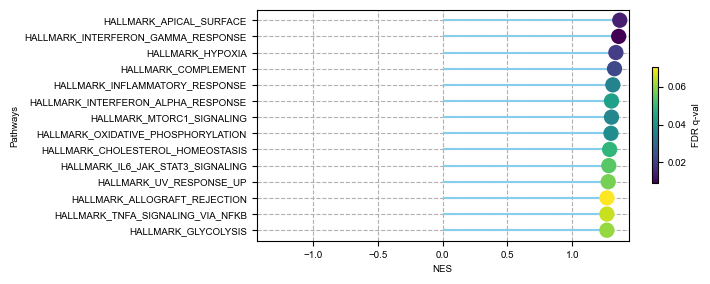

In [121]:
gsea_dotplot(ordered_df_hm, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/all_apc_top_pathway_hm.pdf') #


(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

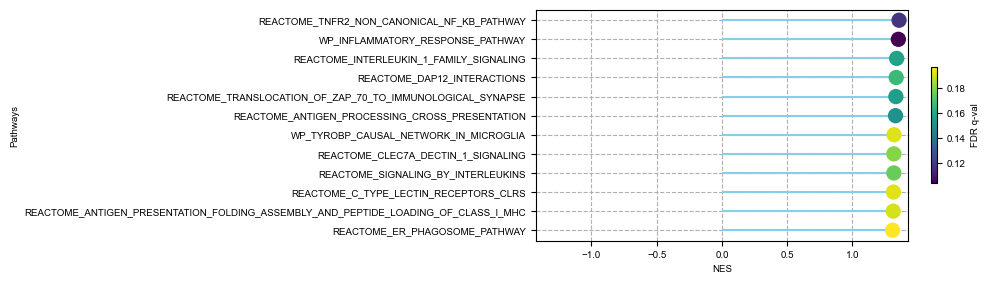

In [123]:
gsea_dotplot(ordered_df_cp_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/all_apc_2KO_top_pathway_cp_filtered.pdf'
             ) #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

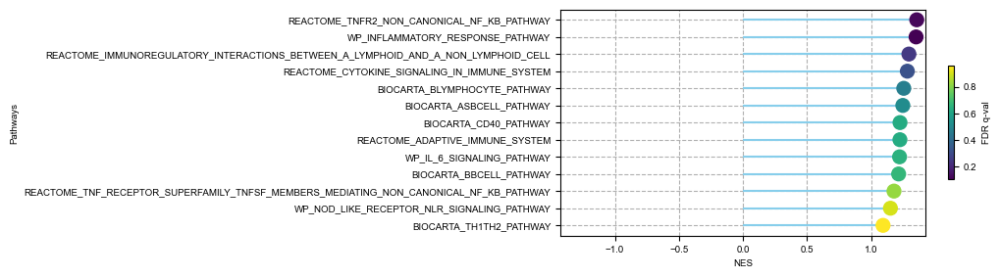

In [44]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7 
             ) #

#### enrichment score

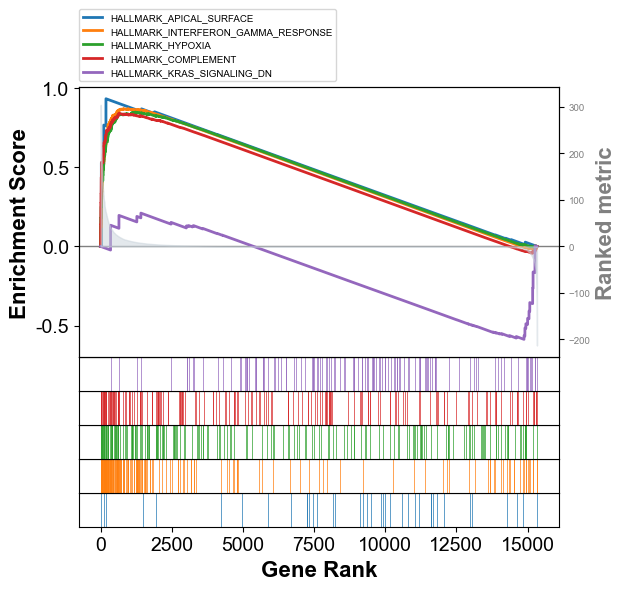

In [45]:
axs = pre_res_hm.plot(terms=pre_res_hm.res2d.Term[0:5],                   
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )

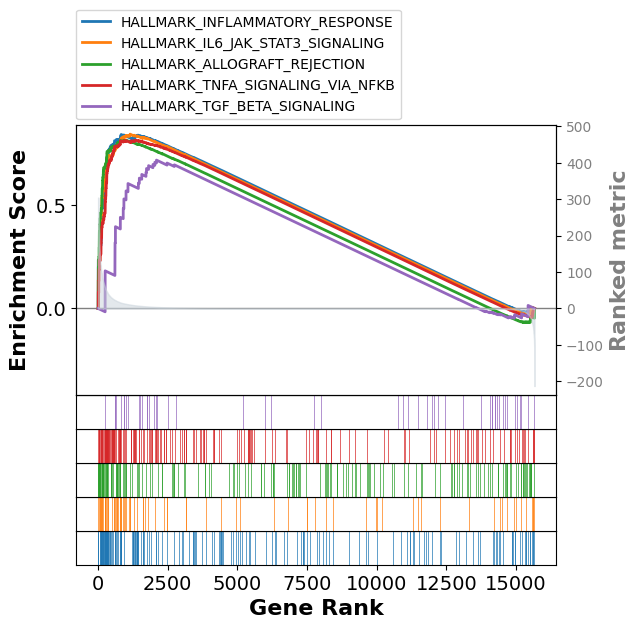

In [39]:
terms = pre_res.res2d.Term
IFN_indices = terms[pre_res.res2d['Lead_genes'].str.contains('Ifn')].index.tolist()
#print(cd40_indices)
axs = pre_res.plot(terms=terms[IFN_indices])

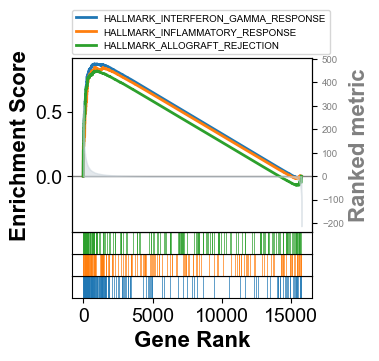

In [124]:
terms = pre_res_hm.res2d.Term
indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
plt.savefig('figures/all_apc_2KO_gsea_plot_cd40_hm.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

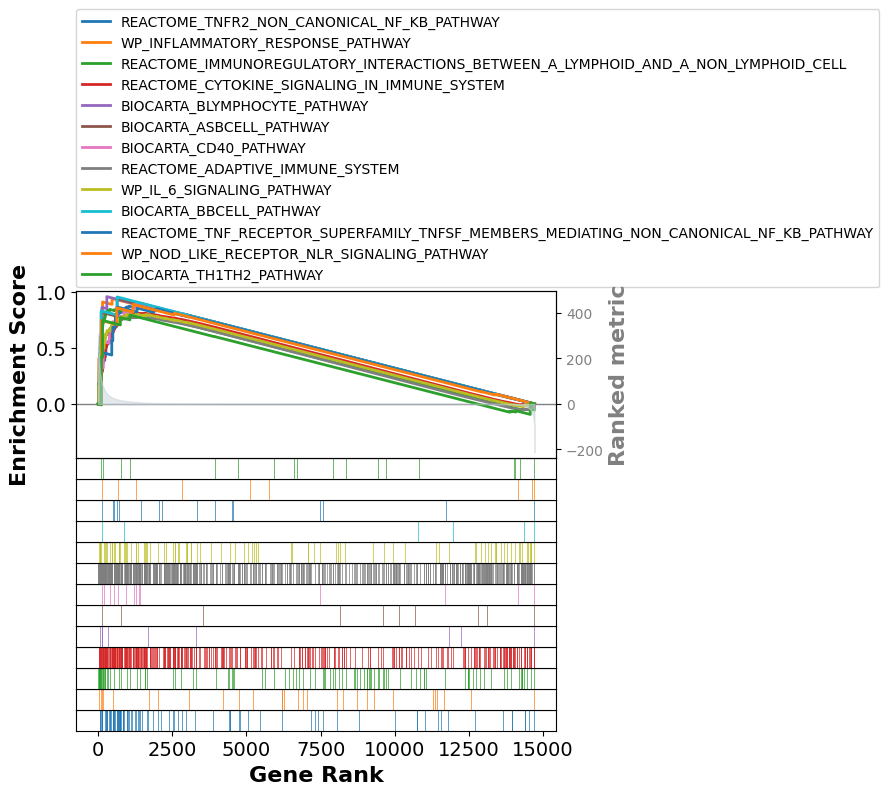

In [67]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

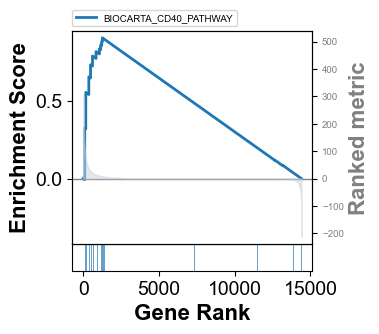

In [125]:
terms = pre_res_bioc.res2d.Term
indices = terms[pre_res_bioc.res2d['Term'].str.contains('CD40')].index.tolist()
#print(cd40_indices)
plt.rcParams.update({'font.size': 7})

axs = pre_res_bioc.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
plt.savefig('figures/all_apc_2KO_gsea_plot_cd40.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

## DEG kupffer

In [41]:
adata_kup= sc.read_h5ad('intermediate/12_anno_v1_KC.h5ad')

In [42]:
adata_kup

AnnData object with n_obs × n_vars = 2877 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cell_colors', 'cell_subtype_pheno_colors', 'cell_subtype_v1_colors', 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'

In [57]:
adata_kup.obs['cell_subtype_v1'].unique()

['KC', 'KC_p']
Categories (2, object): ['KC', 'KC_p']

In [44]:
sc.tl.rank_genes_groups(adata_kup, groupby = 'genotype', groups=['2KO'], reference='rest', method='wilcoxon', key_added='2KO_wilcoxon')

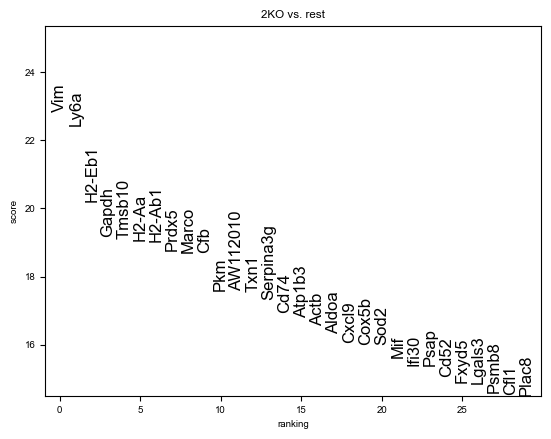

In [45]:
sc.pl.rank_genes_groups(adata_kup, key='2KO_wilcoxon', n_genes=30, fontsize=12)

In [46]:
pval_threshold = 0.05

# Open an Excel writer
with pd.ExcelWriter('DEG/rank_genes_groups_Kupffer_2KO_rest.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_kup.uns['2KO_wilcoxon']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_kup.uns['2KO_wilcoxon'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [60]:
# Extract DEG results for '2KO' group
genes = adata_kup.uns['2KO_wilcoxon']['names']['2KO']
logfoldchanges = adata_kup.uns['2KO_wilcoxon']['logfoldchanges']['2KO']
pvals = adata_kup.uns['2KO_wilcoxon']['pvals']['2KO']
pvals_adj = adata_kup.uns['2KO_wilcoxon']['pvals_adj']['2KO']

# Create a DataFrame
DEG_2KO_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
})

# Display the DataFrame
DEG_2KO_df.head()

,genes,logfoldchanges,pvals,pvals_adj
0,Vim,2.836193,1.602780e-115,2.525180e-111
1,Ly6a,3.153807,2.753885e-111,2.169373e-107
2,H2-Eb1,2.609909,1.409558e-90,5.551896e-87
3,Gapdh,1.675941,7.559700e-82,2.382062e-78
4,Tmsb10,2.283545,1.903526e-81,4.998342e-78


In [61]:
groups = ['2KO']
de_results = {}
for group in groups:
    genes = adata_kup.uns['2KO_wilcoxon']['names'][group]
    logfoldchanges = adata_kup.uns['2KO_wilcoxon']['logfoldchanges'][group]
    pvals = adata_kup.uns['2KO_wilcoxon']['pvals'][group]
    pvals_adj = adata_kup.uns['2KO_wilcoxon']['pvals_adj'][group]
    de_results[group] = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
    })

# Now, de_results['condition_A'] contains the DEGs for condition_A
de_results['2KO'].head()

,genes,logfoldchanges,pvals,pvals_adj
0,Vim,2.836193,1.602780e-115,2.525180e-111
1,Ly6a,3.153807,2.753885e-111,2.169373e-107
2,H2-Eb1,2.609909,1.409558e-90,5.551896e-87
3,Gapdh,1.675941,7.559700e-82,2.382062e-78
4,Tmsb10,2.283545,1.903526e-81,4.998342e-78


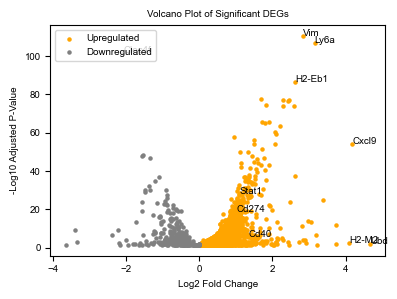

In [105]:
df_DEG = pd.DataFrame({
    'logfoldchanges':DEG_2KO_df['logfoldchanges'],
    'pvals_adj': DEG_2KO_df['pvals_adj']
})

df_DEG.index = de_results['2KO']['genes']

# Extract logfoldchanges and adjusted p-values
logfoldchanges = df_DEG['logfoldchanges']
pvals_adj = df_DEG['pvals_adj']

# Calculate the negative logarithm for adjusted p-values
neg_log_pvals_adj = -np.log10(pvals_adj)

# Filter for significant genes (e.g., pvals_adj < 0.05)
significant_mask = (pvals_adj < 0.05)
significant_logfoldchanges = logfoldchanges[significant_mask]
significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

# Separate upregulated and downregulated genes
upregulated = significant_logfoldchanges > 0
downregulated = significant_logfoldchanges < 0

# Set global font settings
plt.rcParams['font.size'] = 7
plt.rcParams['font.family'] = 'Arial'

# Set up the figure and axis with the new figure size
fig, ax = plt.subplots(figsize=(4, 3))

# Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
# Scatter plot the genes based on their regulation direction
ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='orange', s=5, label='Upregulated')
ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='grey', s=5, label='Downregulated')

# Titles, labels, and other customizations with updated fontsize and font
ax.set_title("Volcano Plot of Significant DEGs", fontsize=7)
ax.set_xlabel("Log2 Fold Change", fontsize=7)
ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
ax.tick_params(axis='both', which='major', labelsize=7)
ax.grid(False)
ax.legend(loc='upper left', fontsize=7)

genes_to_label = significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 2) & 
     (significant_neg_log_pvals_adj > 80)) |
    (np.abs(significant_logfoldchanges) > 4)
].index.tolist()  # Convert the index to a list'''

# Add your genes of interest
genes_of_interest = ["Cd40", "Cd274", 'Stat1']
genes_to_label = genes_to_label + genes_of_interest
#genes_to_label = genes_of_interest

# Annotate specific genes with updated fontsize
for gene in genes_to_label:
    if gene in significant_logfoldchanges and gene in significant_neg_log_pvals_adj:
        x = significant_logfoldchanges[gene]
        y = significant_neg_log_pvals_adj[gene]
        ax.annotate(gene, (x, y), fontsize=7, arrowprops=None)


# Display the plot
plt.tight_layout()
plt.savefig("figures/kupffer_2KO_DEG_volcano.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()


In [104]:
print(significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 2) & 
     (significant_neg_log_pvals_adj > 75)) |
    (np.abs(significant_logfoldchanges) > 4)
])

genes
Vim       2.836193
Ly6a      3.153807
H2-Eb1    2.609909
Tmsb10    2.283545
H2-Aa     2.448254
H2-Ab1    2.417290
Cxcl9     4.184569
H2-M2     4.092687
Ubd       4.669001
Clec4f   -2.082422
Name: logfoldchanges, dtype: float32


### prepare gsea_df

In [63]:
input_df = DEG_2KO_df
# check that there are no NaN in log fold change:
np.sum(np.isnan(input_df['logfoldchanges']))

0

In [64]:
df_gsea = input_df[['genes', 'logfoldchanges', 'pvals_adj']]
# we change the 0 in pvals_adj to the minimum non-zero value
non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
# then multiply by the sign of the log fold change to get the 'score'
df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
# sort
df_gsea = df_gsea.sort_values(by='score', ascending=False)
df_gsea

,genes,logfoldchanges,pvals_adj,pvals_adj_updated,-log10(pvals_adj),score
0,Vim,2.836193,2.525180e-111,2.525180e-111,110.597708,110.597708
1,Ly6a,3.153807,2.169373e-107,2.169373e-107,106.663666,106.663666
2,H2-Eb1,2.609909,5.551896e-87,5.551896e-87,86.255559,86.255559
3,Gapdh,1.675941,2.382062e-78,2.382062e-78,77.623047,77.623047
4,Tmsb10,2.283545,4.998342e-78,4.998342e-78,77.301174,77.301174
...,...,...,...,...,...,...
15750,Slc40a1,-1.116732,6.825368e-38,6.825368e-38,37.165874,-37.165874
15751,Malat1,-1.344574,9.973962e-48,9.973962e-48,47.001132,-47.001132
15752,Hpgd,-1.580629,1.657038e-48,1.657038e-48,47.780667,-47.780667
15753,Fcna,-1.556217,4.219173e-49,4.219173e-49,48.374773,-48.374773


In [65]:
prerank_input = df_gsea.set_index('genes')['score'].to_frame()
prerank_input

,score
genes,
Vim,110.597708
Ly6a,106.663666
H2-Eb1,86.255559
Gapdh,77.623047
Tmsb10,77.301174
...,...
Slc40a1,-37.165874
Malat1,-47.001132
Hpgd,-47.780667


### read in database

In [ ]:
df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
df_set_hm

,1,2,3,4,5,6,7,8,9,10,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN
HALLMARK_APICAL_SURFACE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Adam10,Adipor2,Afap1l2,Akap7,App,Atp6v0a4,Atp8b1,B4galt1,Brca1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APOPTOSIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Add1,Aifm3,Ank,Anxa1,App,Atf3,Avpr1a,Bax,Bcap31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_BILE_ACID_METABOLISM,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abca2,Abca3,Abca4,Abca5,Abca6,Abca8b,Abca9,Abcd1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_CHOLESTEROL_HOMEOSTASIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca2,Acat2,Acss2,Actg1,Adh4,Alcam,Aldoc,Antxr2,Anxa5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
del df_set_hm[1]
df_set_hm.head()

,2,3,4,5,6,7,8,9,10,11,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,Adcy6,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,Bcl10,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,Ank,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,Jag1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,Adam15,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN


In [ ]:
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [ ]:
path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [ ]:
path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

### run GSEA

In [66]:
pre_res_hm = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_hm,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 20:18:35,404 [WARNING] Duplicated values found in preranked stats: 53.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 20:18:35,405 [INFO] Parsing data files for GSEA.............................
2024-02-26 20:18:35,412 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 20:18:35,414 [INFO] 0050 gene_sets used for further statistical testing.....


2024-02-26 20:18:35,416 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 20:19:01,220 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 20:19:01,221 [INFO] Congratulations. GSEApy runs successfully................



In [67]:
pre_res_cp = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_cp,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_cp', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 20:19:01,261 [WARNING] Duplicated values found in preranked stats: 53.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 20:19:01,262 [INFO] Parsing data files for GSEA.............................
2024-02-26 20:19:01,293 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 20:19:01,296 [INFO] 1628 gene_sets used for further statistical testing.....


2024-02-26 20:19:01,297 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 20:23:10,134 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 20:23:10,135 [INFO] Congratulations. GSEApy runs successfully................



In [68]:
pre_res_bioc = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_bioc,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_bioc', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 20:23:10,805 [WARNING] Duplicated values found in preranked stats: 53.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 20:23:10,806 [INFO] Parsing data files for GSEA.............................
2024-02-26 20:23:10,815 [INFO] 0006 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 20:23:10,818 [INFO] 0246 gene_sets used for further statistical testing.....


2024-02-26 20:23:10,819 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 20:23:49,319 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 20:23:49,320 [INFO] Congratulations. GSEApy runs successfully................



In [69]:
pre_res_hm.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.798298,-1.997496,0.0,0.0,0.0,10/120,3.07%,Ptprj;Selenop;Thrb;Btg2;Prkn;Camk1d;Cpeb3;Gprc...
1,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.851335,1.355313,0.0,0.003735,0.004,129/193,11.67%,Cox5b;Uqcrq;Cox8a;Cox4i1;Atp5g3;Atp5o;Atp5g1;A...
2,prerank,HALLMARK_MYC_TARGETS_V1,0.814965,1.289482,0.0,0.018206,0.037,111/181,9.77%,Pgk1;Ppia;Psmb3;Psma7;Ldha;Snrpd1;Psma4;Psmb2;...
3,prerank,HALLMARK_MTORC1_SIGNALING,0.809256,1.282215,0.0,0.018051,0.056,71/192,7.91%,Aldoa;Ifi30;Fgl2;Pgk1;Ppia;Tpi1;Atp5g1;Ctsc;Ld...
4,prerank,HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY,0.839084,1.265261,0.005219,0.025209,0.106,19/48,7.90%,Txn1;Sod2;Prdx1;Atox1;Glrx;Mgst1;Gpx4;Prdx2;Pf...
5,prerank,HALLMARK_ADIPOGENESIS,0.786189,1.242027,0.0,0.044442,0.203,57/194,10.31%,Atp1b3;Aldoa;Uqcrq;Cox8a;Ak2;Atp5o;Cox7b;Uqcr1...
6,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.78779,1.239575,0.0,0.040147,0.218,61/181,7.66%,H2-Aa;Cfb;Cd74;Cxcl9;Sod2;Ifi30;Psmb8;H2-DMa;F...
7,prerank,HALLMARK_GLYCOLYSIS,0.780651,1.230689,0.0,0.046682,0.281,44/186,11.64%,Pkm;Txn1;Aldoa;Mif;Pgk1;Pgam1;Ppia;Tpi1;Ldha;T...
8,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.787169,1.220887,0.015369,0.055669,0.371,23/88,5.34%,Cd74;Ifi30;Psmb8;Psme2;Lap3;Psme1;Gbp3;Psmb9;P...
9,prerank,HALLMARK_HYPOXIA,0.7744,1.215108,0.001005,0.060584,0.43,28/184,7.91%,Prdx5;Aldoa;Mif;Plac8;Pgk1;Tgm2;Tpi1;Ldha;Tgfb...


In [70]:
pre_res_cp.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_ASPIRIN_ADME,-0.993644,-1.956497,0.0,0.0,0.0,2/23,0.65%,Alb;Abcc3
1,prerank,REACTOME_COLLAGEN_CHAIN_TRIMERIZATION,-0.893723,-1.866032,0.0,0.003937,0.005,1/32,10.62%,Col11a2
2,prerank,REACTOME_PREDNISONE_ADME,-0.993773,-1.843728,0.0,0.0063,0.011,1/16,0.63%,Alb
3,prerank,REACTOME_ECM_PROTEOGLYCANS,-0.888032,-1.807109,0.0,0.008662,0.017,1/35,0.06%,Itga9
4,prerank,WP_GPCRS_CLASS_B_SECRETIN_LIKE,-0.993672,-1.72853,0.0,0.036537,0.082,3/17,0.45%,Adgre5;Adgre1;Adgrl3
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,BIOCARTA_IGF1_PATHWAY,0.362046,0.516536,0.993514,0.995347,1.0,8/22,24.93%,Ptpn11;Map2k1;Hras;Csnk2a2;Csnk2a1;Shc1;Mapk8;Srf
1624,prerank,BIOCARTA_IL17_PATHWAY,0.369684,0.504563,0.995444,0.995996,1.0,2/10,30.89%,Cd4;Kitl
1625,prerank,BIOCARTA_PPARG_PATHWAY,-0.323264,-0.49522,1.0,0.994463,1.0,1/7,1.76%,Rxra
1626,prerank,REACTOME_BIOTIN_TRANSPORT_AND_METABOLISM,0.352749,0.480837,0.998889,0.997348,1.0,1/11,14.85%,Pdzd11


In [71]:
pre_res_bioc.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_INTRINSIC_PATHWAY,-0.843564,-1.725106,0.0,0.034832,0.016,1/22,5.50%,Pros1
1,prerank,BIOCARTA_CBL_PATHWAY,-0.949927,-1.490759,0.037383,0.659426,0.454,3/11,2.53%,Csf1r;Prkcb;Prkca
2,prerank,BIOCARTA_ERYTH_PATHWAY,-0.890197,-1.441428,0.109244,0.756796,0.622,3/11,7.72%,Igf1;Il6;Tgfb1
3,prerank,BIOCARTA_EXTRINSIC_PATHWAY,-0.880066,-1.408926,0.073171,0.778962,0.75,2/13,12.00%,Pros1;Tfpi
4,prerank,BIOCARTA_ACE2_PATHWAY,0.977074,1.321657,0.004454,0.853142,0.5,1/9,2.30%,Agtrap
...,...,...,...,...,...,...,...,...,...,...
241,prerank,BIOCARTA_CB1R_PATHWAY,0.41993,0.557455,0.980653,0.998147,1.0,1/6,18.10%,Pld3
242,prerank,BIOCARTA_ERK5_PATHWAY,0.400254,0.555814,0.984427,0.993698,1.0,2/12,11.98%,Hras;Akt1
243,prerank,BIOCARTA_IGF1_PATHWAY,0.362046,0.516536,0.993514,0.996684,1.0,8/22,24.93%,Ptpn11;Map2k1;Hras;Csnk2a2;Csnk2a1;Shc1;Mapk8;Srf
244,prerank,BIOCARTA_IL17_PATHWAY,0.369684,0.504563,0.995444,0.993589,1.0,2/10,30.89%,Cd4;Kitl


In [72]:
df_bioc = pre_res_bioc.res2d[pre_res_bioc.res2d['FDR q-val'] <= 0.9]
ordered_df_bioc = df_bioc.sort_values(by='NES')
ordered_df_bioc

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_INTRINSIC_PATHWAY,-0.843564,-1.725106,0.0,0.034832,0.016,1/22,5.50%,Pros1
1,prerank,BIOCARTA_CBL_PATHWAY,-0.949927,-1.490759,0.037383,0.659426,0.454,3/11,2.53%,Csf1r;Prkcb;Prkca
2,prerank,BIOCARTA_ERYTH_PATHWAY,-0.890197,-1.441428,0.109244,0.756796,0.622,3/11,7.72%,Igf1;Il6;Tgfb1
3,prerank,BIOCARTA_EXTRINSIC_PATHWAY,-0.880066,-1.408926,0.073171,0.778962,0.75,2/13,12.00%,Pros1;Tfpi
7,prerank,BIOCARTA_MTA3_PATHWAY,0.909396,1.291417,0.014115,0.894433,0.865,5/19,5.46%,Gapdh;Aldoa;Ctsd;Tuba1b;Mbd3
6,prerank,BIOCARTA_CTL_PATHWAY,0.951285,1.316138,0.008811,0.551376,0.586,4/13,3.92%,Icam1;B2m;H2-K1;Itgb2
4,prerank,BIOCARTA_ACE2_PATHWAY,0.977074,1.321657,0.004454,0.853142,0.5,1/9,2.30%,Agtrap


In [93]:
df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.1]
ordered_df_cp = df_cp.sort_values(by='NES')
ordered_df_cp

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_ASPIRIN_ADME,-0.993644,-1.956497,0.0,0.0,0.0,2/23,0.65%,Alb;Abcc3
1,prerank,REACTOME_COLLAGEN_CHAIN_TRIMERIZATION,-0.893723,-1.866032,0.0,0.003937,0.005,1/32,10.62%,Col11a2
2,prerank,REACTOME_PREDNISONE_ADME,-0.993773,-1.843728,0.0,0.0063,0.011,1/16,0.63%,Alb
3,prerank,REACTOME_ECM_PROTEOGLYCANS,-0.888032,-1.807109,0.0,0.008662,0.017,1/35,0.06%,Itga9
4,prerank,WP_GPCRS_CLASS_B_SECRETIN_LIKE,-0.993672,-1.72853,0.0,0.036537,0.082,3/17,0.45%,Adgre5;Adgre1;Adgrl3
...,...,...,...,...,...,...,...,...,...,...
33,prerank,REACTOME_GLI3_IS_PROCESSED_TO_GLI3R_BY_THE_PRO...,0.908735,1.382621,0.0,0.017775,0.072,39/54,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Psm...
31,prerank,REACTOME_NUCLEAR_EVENTS_MEDIATED_BY_NFE2L2,0.914911,1.388105,0.0,0.015128,0.053,40/52,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Psm...
30,prerank,REACTOME_HEDGEHOG_ON_STATE,0.902126,1.388144,0.0,0.020171,0.053,39/76,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Psm...
29,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.986659,1.388492,0.0,0.029783,0.052,3/15,0.04%,H2-Eb1;H2-Aa;H2-Ab1


In [94]:
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il']
mask2 = ordered_df_cp['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_cp_filtered = ordered_df_cp[mask2]
ordered_df_cp_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
102,prerank,BIOCARTA_CTL_PATHWAY,0.951285,1.316138,0.008811,0.081432,0.979,4/13,3.92%,Icam1;B2m;H2-K1;Itgb2
100,prerank,REACTOME_GENERATION_OF_SECOND_MESSENGER_MOLECULES,0.907916,1.317259,0.005394,0.078702,0.975,3/26,0.04%,H2-Eb1;H2-Aa;H2-Ab1
98,prerank,REACTOME_ANTIGEN_PROCESSING_CROSS_PRESENTATION,0.860298,1.318981,0.0,0.075315,0.972,50/78,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Cyb...
89,prerank,WP_CYTOKINES_AND_INFLAMMATORY_RESPONSE,0.931227,1.332106,0.002137,0.048675,0.859,1/19,0.02%,H2-Eb1
86,prerank,REACTOME_PEPTIDE_LIGAND_BINDING_RECEPTORS,0.859834,1.333071,0.0,0.048523,0.85,9/85,5.45%,Cxcl9;Psap;Ccl5;C3;Hebp1;Cxcl16;Cxcl10;Fpr2;Ccl6
82,prerank,REACTOME_PD_1_SIGNALING,0.941539,1.335379,0.003257,0.046953,0.822,4/19,0.93%,H2-Eb1;H2-Aa;H2-Ab1;Cd274
45,prerank,REACTOME_DOWNSTREAM_TCR_SIGNALING,0.88392,1.373237,0.0,0.013682,0.175,41/88,5.08%,H2-Eb1;H2-Aa;H2-Ab1;Psmb8;Psmb6;Psme2;Psmb3;Ps...
39,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.886688,1.377448,0.0,0.013753,0.119,41/91,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Psm...
29,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.986659,1.388492,0.0,0.029783,0.052,3/15,0.04%,H2-Eb1;H2-Aa;H2-Ab1


In [74]:
df_hm = pre_res_hm.res2d[pre_res_hm.res2d['FDR q-val'] <= 0.1]
ordered_df_hm = df_hm.sort_values(by='NES')
ordered_df_hm

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.798298,-1.997496,0.0,0.0,0.0,10/120,3.07%,Ptprj;Selenop;Thrb;Btg2;Prkn;Camk1d;Cpeb3;Gprc...
9,prerank,HALLMARK_HYPOXIA,0.7744,1.215108,0.001005,0.060584,0.43,28/184,7.91%,Prdx5;Aldoa;Mif;Plac8;Pgk1;Tgm2;Tpi1;Ldha;Tgfb...
8,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.787169,1.220887,0.015369,0.055669,0.371,23/88,5.34%,Cd74;Ifi30;Psmb8;Psme2;Lap3;Psme1;Gbp3;Psmb9;P...
7,prerank,HALLMARK_GLYCOLYSIS,0.780651,1.230689,0.0,0.046682,0.281,44/186,11.64%,Pkm;Txn1;Aldoa;Mif;Pgk1;Pgam1;Ppia;Tpi1;Ldha;T...
6,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.78779,1.239575,0.0,0.040147,0.218,61/181,7.66%,H2-Aa;Cfb;Cd74;Cxcl9;Sod2;Ifi30;Psmb8;H2-DMa;F...
5,prerank,HALLMARK_ADIPOGENESIS,0.786189,1.242027,0.0,0.044442,0.203,57/194,10.31%,Atp1b3;Aldoa;Uqcrq;Cox8a;Ak2;Atp5o;Cox7b;Uqcr1...
4,prerank,HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY,0.839084,1.265261,0.005219,0.025209,0.106,19/48,7.90%,Txn1;Sod2;Prdx1;Atox1;Glrx;Mgst1;Gpx4;Prdx2;Pf...
3,prerank,HALLMARK_MTORC1_SIGNALING,0.809256,1.282215,0.0,0.018051,0.056,71/192,7.91%,Aldoa;Ifi30;Fgl2;Pgk1;Ppia;Tpi1;Atp5g1;Ctsc;Ld...
2,prerank,HALLMARK_MYC_TARGETS_V1,0.814965,1.289482,0.0,0.018206,0.037,111/181,9.77%,Pgk1;Ppia;Psmb3;Psma7;Ldha;Snrpd1;Psma4;Psmb2;...
1,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.851335,1.355313,0.0,0.003735,0.004,129/193,11.67%,Cox5b;Uqcrq;Cox8a;Cox4i1;Atp5g3;Atp5o;Atp5g1;A...


In [75]:
pre_res_hm.res2d[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
6,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.78779,1.239575,0.0,0.040147,0.218,61/181,7.66%,H2-Aa;Cfb;Cd74;Cxcl9;Sod2;Ifi30;Psmb8;H2-DMa;F...
24,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.698371,1.098361,0.179719,0.405593,1.0,47/179,12.63%,H2-Aa;Cd74;Cxcl9;H2-DMa;Eif5a;Psmb10;Stat1;Ccl...
25,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.691268,1.088907,0.199399,0.453866,1.0,39/176,13.13%,Marco;Cxcl9;Mmp14;Ccl5;Tapbp;Nampt;Il15ra;Icam...


In [76]:
pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
39,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.886688,1.377448,0.0,0.013753,0.119,41/91,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Psm...
284,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.802445,1.180616,0.100105,0.61994,1.0,4/29,10.41%,Il2rg;Il4ra;Cd40;Tnfrsf1a
383,prerank,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,0.717454,1.144956,0.012,0.724548,1.0,125/392,14.41%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Ybx1;Psma...
408,prerank,REACTOME_ADAPTIVE_IMMUNE_SYSTEM,0.70983,1.13532,0.0,0.761468,1.0,156/652,12.33%,H2-Eb1;H2-Aa;H2-Ab1;Cd74;Ifi30;Psmb8;H2-DMb1;H...
556,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.807016,1.097109,0.310962,0.827025,1.0,3/9,6.60%,Icam1;Itgb2;Cd40
593,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.698513,1.087878,0.271706,0.843271,1.0,24/108,15.17%,C3;Fcgr4;H2-Q7;Icam1;B2m;H2-K1;Slamf7;H2-T23;H...
657,prerank,BIOCARTA_ASBCELL_PATHWAY,0.773604,1.06724,0.392817,0.90198,1.0,1/10,6.60%,Cd40
803,prerank,BIOCARTA_BBCELL_PATHWAY,0.773621,1.028577,0.476248,0.957022,1.0,1/6,6.60%,Cd40
887,prerank,REACTOME_TNF_RECEPTOR_SUPERFAMILY_TNFSF_MEMBER...,0.709737,1.00362,0.572376,0.985422,1.0,6/16,23.11%,Ltbr;Cd40;Birc3;Birc2;Traf2;Traf3
1091,prerank,BIOCARTA_TH1TH2_PATHWAY,0.656299,0.931877,0.723799,1.0,1.0,4/18,8.96%,Il4ra;Il18;Cd40;Il12rb1


In [77]:
pre_res_bioc.res2d[pre_res_bioc.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
51,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.807016,1.097109,0.310962,1.0,1.0,3/9,6.60%,Icam1;Itgb2;Cd40
62,prerank,BIOCARTA_ASBCELL_PATHWAY,0.773604,1.06724,0.392817,1.0,1.0,1/10,6.60%,Cd40
81,prerank,BIOCARTA_BBCELL_PATHWAY,0.773621,1.028577,0.476248,1.0,1.0,1/6,6.60%,Cd40
121,prerank,BIOCARTA_TH1TH2_PATHWAY,0.656299,0.931877,0.723799,1.0,1.0,4/18,8.96%,Il4ra;Il18;Cd40;Il12rb1
162,prerank,BIOCARTA_CD40_PATHWAY,0.603856,0.84662,0.822813,1.0,1.0,5/14,15.97%,Cd40;Rela;Ikbkb;Map3k1;Nfkbia


#### plot top pathways

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

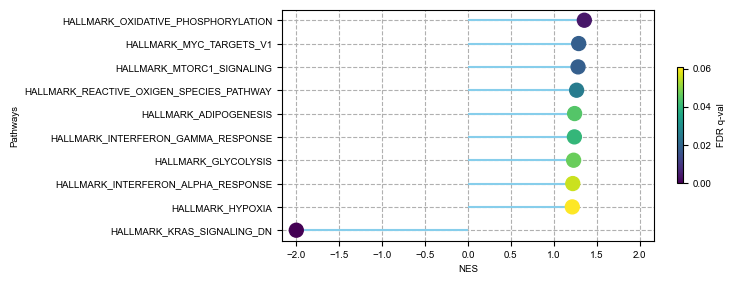

In [82]:
gsea_dotplot(ordered_df_hm, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/kupffer_2KO_top_pathway_hm.pdf') #


(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

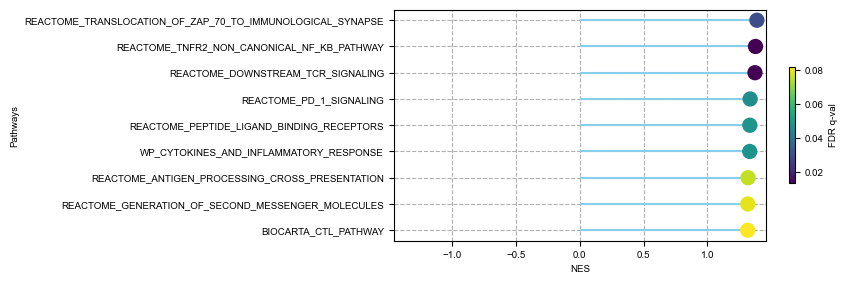

In [97]:
gsea_dotplot(ordered_df_cp_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/kupffer_2KO_top_pathway_cp_filtered.pdf') #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

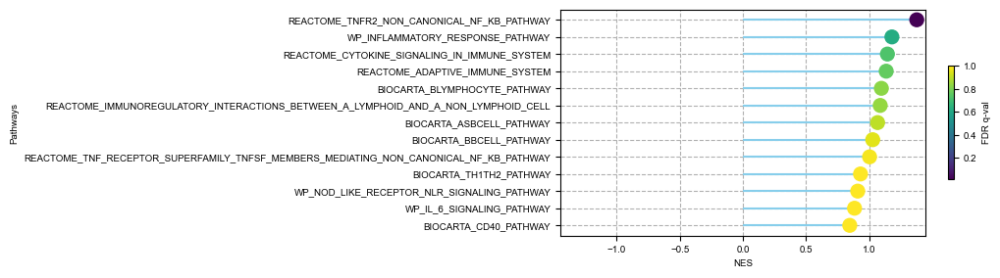

In [84]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7 
             ) #

#### enrichment score

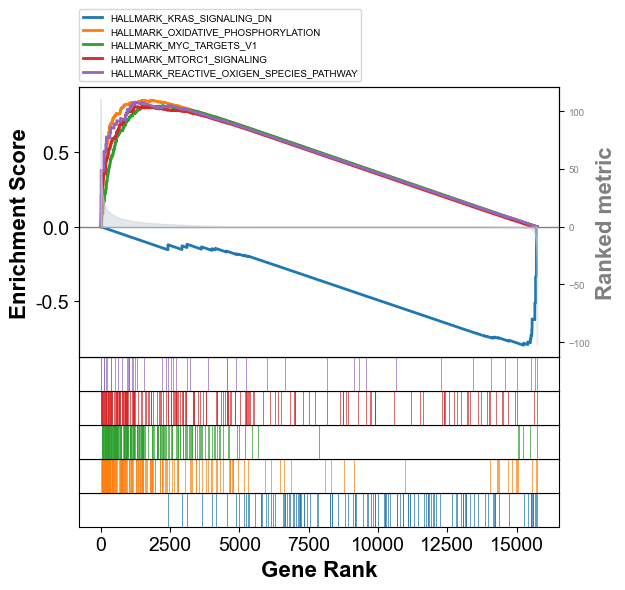

In [85]:
axs = pre_res_hm.plot(terms=pre_res_hm.res2d.Term[0:5],                   
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )

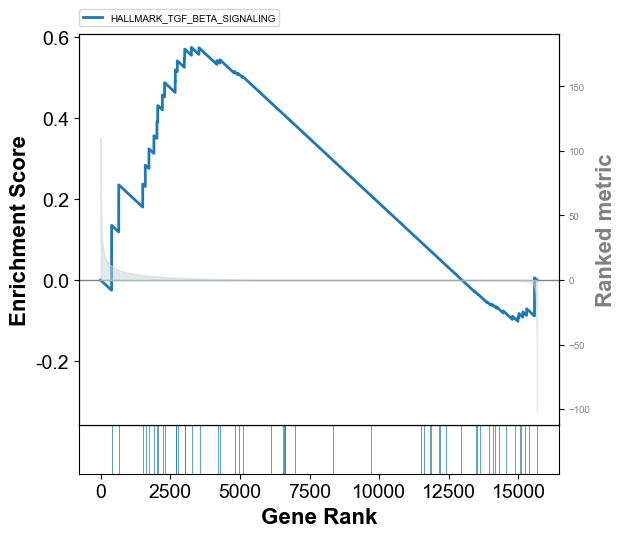

In [86]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Ifn')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

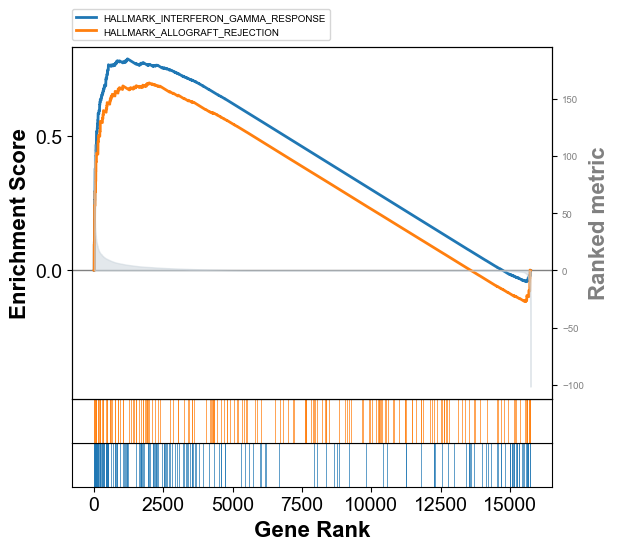

In [88]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

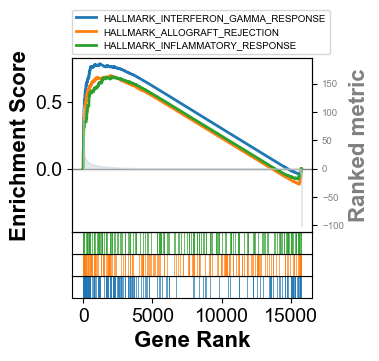

In [87]:
terms = pre_res_hm.res2d.Term
indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
plt.savefig('figures/gsea_plot_cd40_hm.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

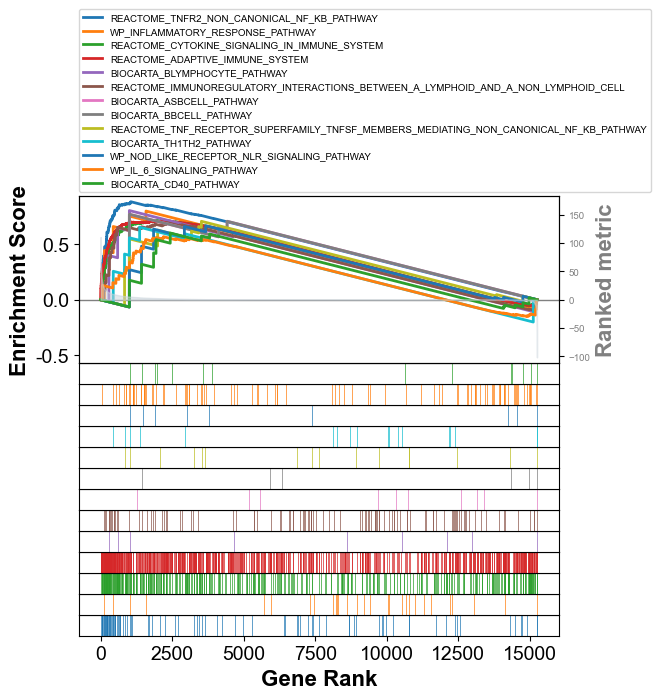

In [89]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

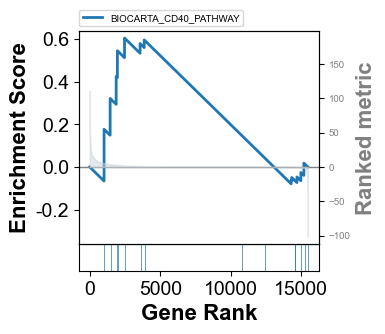

In [90]:
terms = pre_res_bioc.res2d.Term
indices = terms[pre_res_bioc.res2d['Term'].str.contains('CD40')].index.tolist()
#print(cd40_indices)
plt.rcParams.update({'font.size': 7})

axs = pre_res_bioc.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
#plt.savefig('figures/gsea_plot_cd40.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

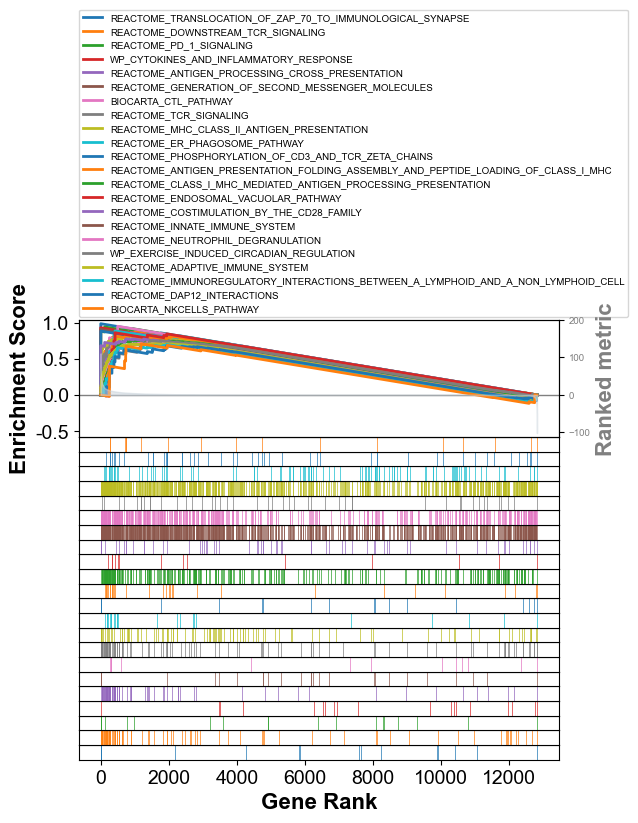

In [91]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

## DEG mac_mono

In [3]:
adata_mm= sc.read_h5ad('intermediate/12_anno_v1_Mac_mono.h5ad')

In [4]:
adata = adata_mm

In [5]:
cell_subtype_mapping_2 = {
    '0': 'Mac_mono',
    '1': 'Kupffer_cell', #
    '2': 'DC1', # low_MHCII
    '3': 'Kupffer_cell', #
    '4': 'DC2', #
    '5': 'DC1', # 
    '6': 'Kupffer_cell', #
    '7': 'Mac_mono', # 
    '8': 'Mac_mono', # 
    '9': 'DC1', # DC1
    '10': 'DC1', #
    '11': 'Mac_mono', #
    '12': 'Kupffer_cell', # DC1 proliferating
    '13': 'Kupffer_cell', #
    '14': 'Kupffer_cell', #
    '15': 'DC_ccr7', # Ccr7
    '16': 'Kupffer_cell', #
    '17': 'DC2', # DC2 proliferating
    '18': 'Kupffer_cell', # proliferating
    '19': 'Mac_mono', # mono
}

# Map the Leiden cluster labels to the annotations using the dictionary
adata.obs['cell_subtype_v2'] = adata.obs['pheno_louvain'].astype('str').map(cell_subtype_mapping_2)

In [6]:
adata_mm

AnnData object with n_obs × n_vars = 2095 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno', 'cell_subtype_v2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cell_colors', 'cell_subtype_pheno_colors', 'cell_subtype_v1_colors', 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_

In [7]:
sc.tl.rank_genes_groups(adata, groupby = 'genotype', groups=['2KO'], reference='rest', method='wilcoxon', key_added='2KO_wilcoxon')

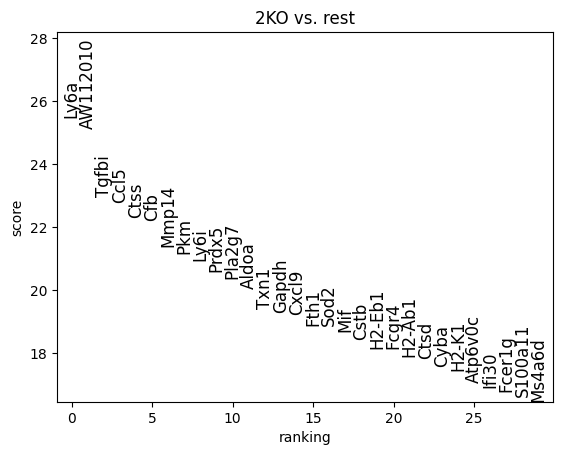

In [8]:
sc.pl.rank_genes_groups(adata, key='2KO_wilcoxon', n_genes=30, fontsize=12)

In [9]:
pval_threshold = 0.05

# Open an Excel writer
with pd.ExcelWriter('DEG/rank_genes_groups_mono_2KO_rest.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata.uns['2KO_wilcoxon']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata.uns['2KO_wilcoxon'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [10]:
# Extract DEG results for '2KO' group
genes = adata.uns['2KO_wilcoxon']['names']['2KO']
logfoldchanges = adata.uns['2KO_wilcoxon']['logfoldchanges']['2KO']
pvals = adata.uns['2KO_wilcoxon']['pvals']['2KO']
pvals_adj = adata.uns['2KO_wilcoxon']['pvals_adj']['2KO']

# Create a DataFrame
DEG_2KO_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
})

# Display the DataFrame
DEG_2KO_df.head()

,genes,logfoldchanges,pvals,pvals_adj
0,Ly6a,3.694901,2.622213e-143,4.131296e-139
1,AW112010,3.416905,3.352726e-139,2.641110e-135
2,Tgfbi,2.369516,6.511445e-117,3.419594e-113
3,Ccl5,4.427077,5.656371e-115,2.227903e-111
4,Ctss,1.886227,4.370017e-110,1.376992e-106


In [11]:
groups = ['2KO']
de_results = {}
for group in groups:
    genes = adata.uns['2KO_wilcoxon']['names'][group]
    logfoldchanges = adata.uns['2KO_wilcoxon']['logfoldchanges'][group]
    pvals = adata.uns['2KO_wilcoxon']['pvals'][group]
    pvals_adj = adata.uns['2KO_wilcoxon']['pvals_adj'][group]
    de_results[group] = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
    })

# Now, de_results['condition_A'] contains the DEGs for condition_A
de_results['2KO'].head()

,genes,logfoldchanges,pvals,pvals_adj
0,Ly6a,3.694901,2.622213e-143,4.131296e-139
1,AW112010,3.416905,3.352726e-139,2.641110e-135
2,Tgfbi,2.369516,6.511445e-117,3.419594e-113
3,Ccl5,4.427077,5.656371e-115,2.227903e-111
4,Ctss,1.886227,4.370017e-110,1.376992e-106


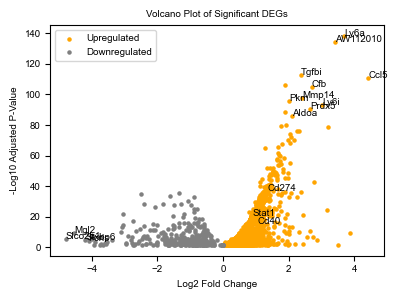

In [12]:
df_DEG = pd.DataFrame({
    'logfoldchanges':DEG_2KO_df['logfoldchanges'],
    'pvals_adj': DEG_2KO_df['pvals_adj']
})

df_DEG.index = de_results['2KO']['genes']

# Extract logfoldchanges and adjusted p-values
logfoldchanges = df_DEG['logfoldchanges']
pvals_adj = df_DEG['pvals_adj']

# Calculate the negative logarithm for adjusted p-values
neg_log_pvals_adj = -np.log10(pvals_adj)

# Filter for significant genes (e.g., pvals_adj < 0.05)
significant_mask = (pvals_adj < 0.05)
significant_logfoldchanges = logfoldchanges[significant_mask]
significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

# Separate upregulated and downregulated genes
upregulated = significant_logfoldchanges > 0
downregulated = significant_logfoldchanges < 0

# Set global font settings
plt.rcParams['font.size'] = 7
plt.rcParams['font.family'] = 'Arial'

# Set up the figure and axis with the new figure size
fig, ax = plt.subplots(figsize=(4, 3))

# Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
# Scatter plot the genes based on their regulation direction
ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='orange', s=5, label='Upregulated')
ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='grey', s=5, label='Downregulated')

# Titles, labels, and other customizations with updated fontsize and font
ax.set_title("Volcano Plot of Significant DEGs", fontsize=7)
ax.set_xlabel("Log2 Fold Change", fontsize=7)
ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
ax.tick_params(axis='both', which='major', labelsize=7)
ax.grid(False)
ax.legend(loc='upper left', fontsize=7)

genes_to_label = significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 2) & 
     (significant_neg_log_pvals_adj > 80)) |
    (np.abs(significant_logfoldchanges) > 4)
].index.tolist()  # Convert the index to a list'''

# Add your genes of interest
genes_of_interest = ["Cd40", "Cd274", 'Stat1']
genes_to_label = genes_to_label + genes_of_interest
#genes_to_label = genes_of_interest

# Annotate specific genes with updated fontsize
for gene in genes_to_label:
    if gene in significant_logfoldchanges and gene in significant_neg_log_pvals_adj:
        x = significant_logfoldchanges[gene]
        y = significant_neg_log_pvals_adj[gene]
        ax.annotate(gene, (x, y), fontsize=7, arrowprops=None)


# Display the plot
plt.tight_layout()
plt.savefig("figures/mono_2KO_DEG_volcano.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()


In [13]:
print(significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 2) & 
     (significant_neg_log_pvals_adj > 75)) |
    (np.abs(significant_logfoldchanges) > 4)
])

genes
Ly6a        3.694901
AW112010    3.416905
Tgfbi       2.369516
Ccl5        4.427077
Cfb         2.695933
Mmp14       2.418464
Pkm         2.019475
Ly6i        3.017855
Prdx5       2.640032
Aldoa       2.113513
Cxcl9       3.184525
Fth1        2.252790
Sod2        2.308103
Fcrls      -4.096897
Stxbp6     -4.191850
Slco2b1    -4.797799
Mgl2       -4.536765
Name: logfoldchanges, dtype: float32


### prepare gsea_df

In [14]:
input_df = DEG_2KO_df
# check that there are no NaN in log fold change:
np.sum(np.isnan(input_df['logfoldchanges']))

0

In [15]:
df_gsea = input_df[['genes', 'logfoldchanges', 'pvals_adj']]
# we change the 0 in pvals_adj to the minimum non-zero value
non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
# then multiply by the sign of the log fold change to get the 'score'
df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
# sort
df_gsea = df_gsea.sort_values(by='score', ascending=False)
df_gsea

,genes,logfoldchanges,pvals_adj,pvals_adj_updated,-log10(pvals_adj),score
0,Ly6a,3.694901,4.131296e-139,4.131296e-139,138.383914,138.383914
1,AW112010,3.416905,2.641110e-135,2.641110e-135,134.578213,134.578213
2,Tgfbi,2.369516,3.419594e-113,3.419594e-113,112.466025,112.466025
3,Ccl5,4.427077,2.227903e-111,2.227903e-111,110.652104,110.652104
4,Ctss,1.886227,1.376992e-106,1.376992e-106,105.861068,105.861068
...,...,...,...,...,...,...
15750,mt-Nd2,-1.081351,9.882182e-31,9.882182e-31,30.005147,-30.005147
15751,mt-Co3,-0.899791,1.373379e-33,1.373379e-33,32.862210,-32.862210
15752,Hdac9,-1.602594,1.824077e-34,1.824077e-34,33.738957,-33.738957
15753,Mrc1,-2.505512,2.239780e-35,2.239780e-35,34.649795,-34.649795


In [16]:
prerank_input = df_gsea.set_index('genes')['score'].to_frame()
prerank_input

,score
genes,
Ly6a,138.383914
AW112010,134.578213
Tgfbi,112.466025
Ccl5,110.652104
Ctss,105.861068
...,...
mt-Nd2,-30.005147
mt-Co3,-32.862210
Hdac9,-33.738957


### read in database

In [17]:
df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
df_set_hm

,1,2,3,4,5,6,7,8,9,10,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN
HALLMARK_APICAL_SURFACE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Adam10,Adipor2,Afap1l2,Akap7,App,Atp6v0a4,Atp8b1,B4galt1,Brca1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APOPTOSIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Add1,Aifm3,Ank,Anxa1,App,Atf3,Avpr1a,Bax,Bcap31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_BILE_ACID_METABOLISM,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abca2,Abca3,Abca4,Abca5,Abca6,Abca8b,Abca9,Abcd1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_CHOLESTEROL_HOMEOSTASIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca2,Acat2,Acss2,Actg1,Adh4,Alcam,Aldoc,Antxr2,Anxa5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
del df_set_hm[1]
df_set_hm.head()

,2,3,4,5,6,7,8,9,10,11,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,Adcy6,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,Bcl10,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,Ank,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,Jag1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,Adam15,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN


In [19]:
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [20]:
path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [21]:
path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

### run GSEA

In [22]:
pre_res_hm = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_hm,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/mac_mono_2KO_gsea', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-04-18 16:00:21,820 [WARNING] Duplicated values found in preranked stats: 62.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-18 16:00:21,821 [INFO] Parsing data files for GSEA.............................
2024-04-18 16:00:21,829 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-18 16:00:21,831 [INFO] 0050 gene_sets used for further statistical testing.....


2024-04-18 16:00:21,833 [INFO] Start to run GSEA...Might take a while..................
2024-04-18 16:01:00,249 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-18 16:01:00,250 [INFO] Congratulations. GSEApy runs successfully................



In [32]:
pre_res_cp = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_cp,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_cp', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-04-18 16:03:46,482 [WARNING] Duplicated values found in preranked stats: 62.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-18 16:03:46,484 [INFO] Parsing data files for GSEA.............................
2024-04-18 16:03:46,521 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-18 16:03:46,523 [INFO] 1628 gene_sets used for further statistical testing.....


2024-04-18 16:03:46,524 [INFO] Start to run GSEA...Might take a while..................
2024-04-18 16:05:59,213 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-18 16:05:59,214 [INFO] Congratulations. GSEApy runs successfully................



In [23]:
pre_res_bioc = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_bioc,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/mac_mono_2KO_gsea_bioc', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-04-18 16:01:00,280 [WARNING] Duplicated values found in preranked stats: 62.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-18 16:01:00,282 [INFO] Parsing data files for GSEA.............................
2024-04-18 16:01:00,287 [INFO] 0006 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-18 16:01:00,289 [INFO] 0246 gene_sets used for further statistical testing.....


2024-04-18 16:01:00,290 [INFO] Start to run GSEA...Might take a while..................
2024-04-18 16:01:23,266 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-18 16:01:23,267 [INFO] Congratulations. GSEApy runs successfully................



In [24]:
pre_res_hm.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.538008,-1.336732,0.0,0.316781,0.085057,9/120,4.40%,Camk1d;Ptprj;Selenop;Zbtb16;Prkn;Slc16a7;Kmt2d...
1,prerank,HALLMARK_UV_RESPONSE_DN,-0.596167,-1.333321,0.0,0.162671,0.087356,19/141,2.92%,Runx1;Dab2;Celf2;Atp2b1;Ptprm;Mapk14;Atxn1;Add...
2,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.882691,1.277523,0.0,0.006374,0.007,85/181,6.43%,Ccl5;Cfb;Cxcl9;Sod2;Ifi30;H2-Aa;Tnfaip2;B2m;Ir...
3,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.873646,1.251859,0.0,0.024587,0.054,41/88,8.04%,Ifi30;B2m;Irf7;Psmb8;Cd74;Isg15;Ifitm2;Psme2;T...
4,prerank,HALLMARK_COMPLEMENT,0.865735,1.250234,0.0,0.018516,0.061,43/181,6.17%,Ccl5;Ctss;Cfb;Mmp14;Pla2g7;Ctsd;Fcer1g;C3;Pfn1...
5,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.858378,1.236552,0.0,0.029596,0.127,106/193,10.34%,Atp6v0c;Ldha;Cox5b;Cox8a;Sdhb;Gpi1;Atp6v1g1;Co...
6,prerank,HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY,0.867879,1.214896,0.021784,0.055367,0.265,21/48,8.75%,Txn1;Sod2;Ftl1;Prdx1;Atox1;Glrx;Gpx4;Lamtor5;P...
7,prerank,HALLMARK_MTORC1_SIGNALING,0.838169,1.207114,0.0,0.062379,0.335,71/192,11.52%,Aldoa;Ifi30;Ldha;Tpi1;Prdx1;Pgk1;Ctsc;Pnp;Itgb...
8,prerank,HALLMARK_CHOLESTEROL_HOMEOSTASIS,0.850039,1.205453,0.019211,0.055028,0.343,18/70,10.90%,S100a11;Cxcl16;Lgals3;Fabp5;Anxa5;Plaur;Fbxo6;...
9,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.827115,1.190789,0.001,0.08173,0.494,58/176,10.72%,Ccl5;Mmp14;Cxcl9;Irf7;Nfkbia;Sema4d;Ly6e;Nampt...


In [33]:
pre_res_cp.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_COLLAGEN_CHAIN_TRIMERIZATION,-0.894613,-1.720411,0.0,0.050446,0.04,2/32,10.54%,Col27a1;Col3a1
1,prerank,REACTOME_XENOBIOTICS,-0.982079,-1.684586,0.0,0.054137,0.079,1/19,1.80%,Ahr
2,prerank,REACTOME_RHOJ_GTPASE_CYCLE,-0.942684,-1.564291,0.009615,0.303086,0.448,6/16,4.88%,Dock8;Arhgap26;Prex1;Ophn1;Trio;Arhgap1
3,prerank,WP_GPCRS_CLASS_B_SECRETIN_LIKE,-0.948203,-1.541093,0.009615,0.327283,0.575,3/17,2.34%,Adgrl3;Adgre5;Adgre1
4,prerank,BIOCARTA_TOB1_PATHWAY,-0.906393,-1.516053,0.052632,0.374284,0.711,5/19,9.39%,Tgfbr2;Tob2;Tgfbr1;Smad3;Smad4
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,WP_STEROID_BIOSYNTHESIS,-0.318494,-0.443499,0.982759,0.998681,1.0,9/9,100.00%,Hsd3b3;Cyp17a1;F13b;Hsd3b1;Hsd3b2;Hsd17b1;Hsd1...
1624,prerank,WP_OSTEOBLAST_SIGNALING,-0.317755,-0.439509,0.972376,0.995607,1.0,7/7,100.00%,Pdgfra;Fgf23;Pdgfrb;Slc17a2;Tnfrsf11b;Pth1r;Co...
1625,prerank,REACTOME_PHASE_0_RAPID_DEPOLARISATION,-0.320274,-0.430809,0.960177,0.994504,1.0,6/6,100.00%,Cacnb2;Cacng7;Cacna2d2;Cacng8;Cacna1c;Cacnb1
1626,prerank,REACTOME_FGFR3_LIGAND_BINDING_AND_ACTIVATION,-0.297371,-0.405998,1.0,1.0,1.0,7/7,100.00%,Fgf9;Fgfr3;Fgf1;Fgf2;Fgf23;Fgf20;Galnt3


In [31]:
pre_res_bioc.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_TOB1_PATHWAY,-0.906393,-1.516053,0.052632,0.437067,0.232,5/19,9.39%,Tgfbr2;Tob2;Tgfbr1;Smad3;Smad4
1,prerank,BIOCARTA_FIBRINOLYSIS_PATHWAY,-0.984975,-1.413676,0.020548,0.863138,0.615,1/11,0.34%,F13a1
2,prerank,BIOCARTA_HES_PATHWAY,-0.947543,-1.409913,0.063291,0.607037,0.634,1/11,0.20%,Rbpj
3,prerank,BIOCARTA_IL17_PATHWAY,-0.946015,-1.378322,0.060241,0.732568,0.811,2/10,5.41%,Cd4;Kitl
4,prerank,BIOCARTA_EPHA4_PATHWAY,-0.974689,-1.374763,0.026455,0.616017,0.83,1/8,0.34%,Lyn
...,...,...,...,...,...,...,...,...,...,...
241,prerank,BIOCARTA_VOBESITY_PATHWAY,-0.420013,-0.589299,0.843902,0.941949,1.0,2/7,2.92%,Lpl;Nr3c1
242,prerank,BIOCARTA_BARRESTIN_PATHWAY,-0.406343,-0.588905,0.940789,0.9212,1.0,1/10,2.62%,Arrb1
243,prerank,BIOCARTA_PARKIN_PATHWAY,0.423282,0.525496,0.983139,1.0,1.0,1/6,11.22%,Sumo1
244,prerank,BIOCARTA_DSP_PATHWAY,0.408405,0.518847,0.992857,0.997436,1.0,4/9,20.67%,Dusp1;Dusp2;Mapk3;Dusp6


In [34]:
df_bioc = pre_res_bioc.res2d[pre_res_bioc.res2d['FDR q-val'] <= 0.9]
ordered_df_bioc = df_bioc.sort_values(by='NES')
ordered_df_bioc

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_TOB1_PATHWAY,-0.906393,-1.516053,0.052632,0.437067,0.232,5/19,9.39%,Tgfbr2;Tob2;Tgfbr1;Smad3;Smad4
1,prerank,BIOCARTA_FIBRINOLYSIS_PATHWAY,-0.984975,-1.413676,0.020548,0.863138,0.615,1/11,0.34%,F13a1
2,prerank,BIOCARTA_HES_PATHWAY,-0.947543,-1.409913,0.063291,0.607037,0.634,1/11,0.20%,Rbpj
3,prerank,BIOCARTA_IL17_PATHWAY,-0.946015,-1.378322,0.060241,0.732568,0.811,2/10,5.41%,Cd4;Kitl
4,prerank,BIOCARTA_EPHA4_PATHWAY,-0.974689,-1.374763,0.026455,0.616017,0.83,1/8,0.34%,Lyn
5,prerank,BIOCARTA_STEM_PATHWAY,-0.951861,-1.333128,0.108974,0.878715,0.941,1/9,4.82%,Cd4
6,prerank,BIOCARTA_TCRA_PATHWAY,-0.951924,-1.331665,0.08427,0.76791,0.944,2/9,4.82%,Ptprc;Cd4
8,prerank,BIOCARTA_SRCRPTP_PATHWAY,-0.885935,-1.30835,0.207407,0.880662,0.969,3/10,6.34%,Prkcb;Prkca;Csk
10,prerank,BIOCARTA_LECTIN_PATHWAY,0.985483,1.266443,0.002404,0.489637,0.525,1/10,0.22%,C3
7,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.980524,1.312722,0.001105,0.037701,0.037,1/22,0.56%,F10


In [35]:
df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.1]
ordered_df_cp = df_cp.sort_values(by='NES')
ordered_df_cp

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_COLLAGEN_CHAIN_TRIMERIZATION,-0.894613,-1.720411,0.0,0.050446,0.04,2/32,10.54%,Col27a1;Col3a1
1,prerank,REACTOME_XENOBIOTICS,-0.982079,-1.684586,0.0,0.054137,0.079,1/19,1.80%,Ahr
48,prerank,REACTOME_COLLAGEN_FORMATION,0.916489,1.300821,0.0,0.058895,0.348,6/68,5.38%,Ctss;Ctsl;Ctsb;Ppib;P4ha1;P4hb
44,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.99239,1.311279,0.0,0.028448,0.179,3/15,0.21%,H2-Eb1;H2-Ab1;H2-Aa
42,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.980524,1.312722,0.001105,0.029039,0.164,1/22,0.56%,F10
41,prerank,REACTOME_PD_1_SIGNALING,0.980913,1.313594,0.0,0.03242,0.157,5/19,1.28%,H2-Eb1;H2-Ab1;H2-Aa;Cd274;Ptpn6
39,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.914399,1.31679,0.0,0.030539,0.128,24/108,4.64%,Fcgr4;H2-K1;C3;B2m;H2-Q7;Ifitm2;Itgb2;Slamf7;I...
38,prerank,REACTOME_METABOLISM_OF_FAT_SOLUBLE_VITAMINS,0.940891,1.320229,0.0,0.027232,0.095,6/44,3.75%,Apoc2;Sdc4;Lrp10;Apoe;Sdc3;Lrp1
35,prerank,REACTOME_COLLAGEN_DEGRADATION,0.950731,1.326854,0.0,0.016858,0.046,5/44,4.80%,Mmp14;Ctsd;Ctsl;Ctsb;Furin
32,prerank,REACTOME_GENERATION_OF_SECOND_MESSENGER_MOLECULES,0.984202,1.332496,0.0,0.014102,0.026,3/26,0.21%,H2-Eb1;H2-Ab1;H2-Aa


In [36]:
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il']
mask2 = ordered_df_cp['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_cp_filtered = ordered_df_cp[mask2]
ordered_df_cp_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
44,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.99239,1.311279,0.0,0.028448,0.179,3/15,0.21%,H2-Eb1;H2-Ab1;H2-Aa
41,prerank,REACTOME_PD_1_SIGNALING,0.980913,1.313594,0.0,0.03242,0.157,5/19,1.28%,H2-Eb1;H2-Ab1;H2-Aa;Cd274;Ptpn6
39,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.914399,1.31679,0.0,0.030539,0.128,24/108,4.64%,Fcgr4;H2-K1;C3;B2m;H2-Q7;Ifitm2;Itgb2;Slamf7;I...
32,prerank,REACTOME_GENERATION_OF_SECOND_MESSENGER_MOLECULES,0.984202,1.332496,0.0,0.014102,0.026,3/26,0.21%,H2-Eb1;H2-Ab1;H2-Aa


In [37]:
df_hm = pre_res_hm.res2d[pre_res_hm.res2d['FDR q-val'] <= 0.1]
ordered_df_hm = df_hm.sort_values(by='NES')
ordered_df_hm

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
12,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.818999,1.181438,0.0,0.079639,0.603,38/179,4.35%,Ccl5;Ctss;Cxcl9;H2-Aa;B2m;Irf7;Capg;Cd74;Il2rg...
11,prerank,HALLMARK_GLYCOLYSIS,0.822231,1.182103,0.004,0.085509,0.593,43/186,10.70%,Tgfbi;Pkm;Aldoa;Txn1;Mif;Ldha;Tpi1;Pgam1;Pgk1;...
10,prerank,HALLMARK_UV_RESPONSE_UP,0.82479,1.190256,0.008,0.07366,0.499,32/141,6.90%,Mmp14;Aldoa;Sod2;Grina;Tap1;Nfkbia;Tmbim6;Hmox...
9,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.827115,1.190789,0.001,0.08173,0.494,58/176,10.72%,Ccl5;Mmp14;Cxcl9;Irf7;Nfkbia;Sema4d;Ly6e;Nampt...
8,prerank,HALLMARK_CHOLESTEROL_HOMEOSTASIS,0.850039,1.205453,0.019211,0.055028,0.343,18/70,10.90%,S100a11;Cxcl16;Lgals3;Fabp5;Anxa5;Plaur;Fbxo6;...
7,prerank,HALLMARK_MTORC1_SIGNALING,0.838169,1.207114,0.0,0.062379,0.335,71/192,11.52%,Aldoa;Ifi30;Ldha;Tpi1;Prdx1;Pgk1;Ctsc;Pnp;Itgb...
6,prerank,HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY,0.867879,1.214896,0.021784,0.055367,0.265,21/48,8.75%,Txn1;Sod2;Ftl1;Prdx1;Atox1;Glrx;Gpx4;Lamtor5;P...
5,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.858378,1.236552,0.0,0.029596,0.127,106/193,10.34%,Atp6v0c;Ldha;Cox5b;Cox8a;Sdhb;Gpi1;Atp6v1g1;Co...
4,prerank,HALLMARK_COMPLEMENT,0.865735,1.250234,0.0,0.018516,0.061,43/181,6.17%,Ccl5;Ctss;Cfb;Mmp14;Pla2g7;Ctsd;Fcer1g;C3;Pfn1...
3,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.873646,1.251859,0.0,0.024587,0.054,41/88,8.04%,Ifi30;B2m;Irf7;Psmb8;Cd74;Isg15;Ifitm2;Psme2;T...


In [ ]:
pre_res_hm.res2d[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
6,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.78779,1.239575,0.0,0.040147,0.218,61/181,7.66%,H2-Aa;Cfb;Cd74;Cxcl9;Sod2;Ifi30;Psmb8;H2-DMa;F...
24,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.698371,1.098361,0.179719,0.405593,1.0,47/179,12.63%,H2-Aa;Cd74;Cxcl9;H2-DMa;Eif5a;Psmb10;Stat1;Ccl...
25,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.691268,1.088907,0.199399,0.453866,1.0,39/176,13.13%,Marco;Cxcl9;Mmp14;Ccl5;Tapbp;Nampt;Il15ra;Icam...


In [ ]:
pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
39,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.886688,1.377448,0.0,0.013753,0.119,41/91,6.93%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Psma7;Psm...
284,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.802445,1.180616,0.100105,0.61994,1.0,4/29,10.41%,Il2rg;Il4ra;Cd40;Tnfrsf1a
383,prerank,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,0.717454,1.144956,0.012,0.724548,1.0,125/392,14.41%,Psmb8;Psmb6;Psme2;Psmb3;Psme1;Psmb10;Ybx1;Psma...
408,prerank,REACTOME_ADAPTIVE_IMMUNE_SYSTEM,0.70983,1.13532,0.0,0.761468,1.0,156/652,12.33%,H2-Eb1;H2-Aa;H2-Ab1;Cd74;Ifi30;Psmb8;H2-DMb1;H...
556,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.807016,1.097109,0.310962,0.827025,1.0,3/9,6.60%,Icam1;Itgb2;Cd40
593,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.698513,1.087878,0.271706,0.843271,1.0,24/108,15.17%,C3;Fcgr4;H2-Q7;Icam1;B2m;H2-K1;Slamf7;H2-T23;H...
657,prerank,BIOCARTA_ASBCELL_PATHWAY,0.773604,1.06724,0.392817,0.90198,1.0,1/10,6.60%,Cd40
803,prerank,BIOCARTA_BBCELL_PATHWAY,0.773621,1.028577,0.476248,0.957022,1.0,1/6,6.60%,Cd40
887,prerank,REACTOME_TNF_RECEPTOR_SUPERFAMILY_TNFSF_MEMBER...,0.709737,1.00362,0.572376,0.985422,1.0,6/16,23.11%,Ltbr;Cd40;Birc3;Birc2;Traf2;Traf3
1091,prerank,BIOCARTA_TH1TH2_PATHWAY,0.656299,0.931877,0.723799,1.0,1.0,4/18,8.96%,Il4ra;Il18;Cd40;Il12rb1


In [ ]:
pre_res_bioc.res2d[pre_res_bioc.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
51,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.807016,1.097109,0.310962,1.0,1.0,3/9,6.60%,Icam1;Itgb2;Cd40
62,prerank,BIOCARTA_ASBCELL_PATHWAY,0.773604,1.06724,0.392817,1.0,1.0,1/10,6.60%,Cd40
81,prerank,BIOCARTA_BBCELL_PATHWAY,0.773621,1.028577,0.476248,1.0,1.0,1/6,6.60%,Cd40
121,prerank,BIOCARTA_TH1TH2_PATHWAY,0.656299,0.931877,0.723799,1.0,1.0,4/18,8.96%,Il4ra;Il18;Cd40;Il12rb1
162,prerank,BIOCARTA_CD40_PATHWAY,0.603856,0.84662,0.822813,1.0,1.0,5/14,15.97%,Cd40;Rela;Ikbkb;Map3k1;Nfkbia


#### plot top pathways

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

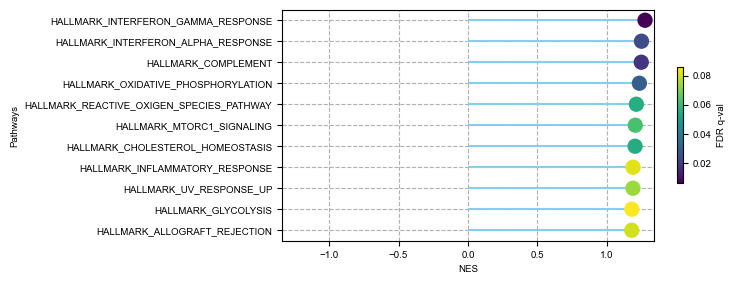

In [38]:
gsea_dotplot(ordered_df_hm, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/mono_2KO_top_pathway_hm.pdf') #


(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

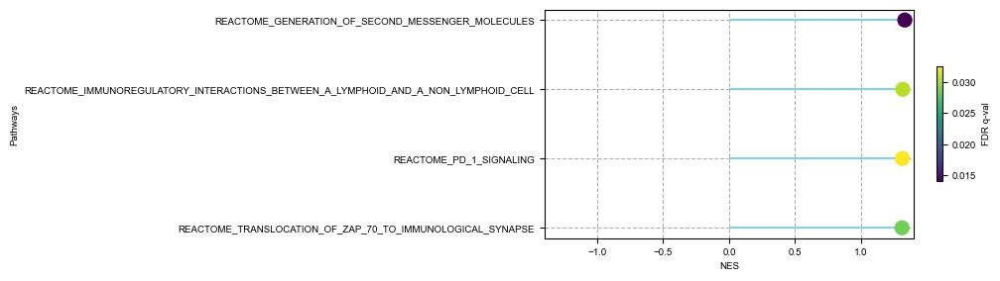

In [39]:
gsea_dotplot(ordered_df_cp_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/mono_2KO_top_pathway_cp_filtered.pdf') #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

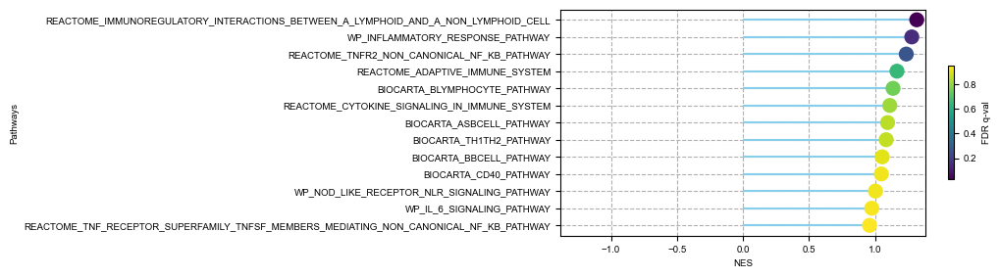

In [40]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7 
             ) #

#### enrichment score

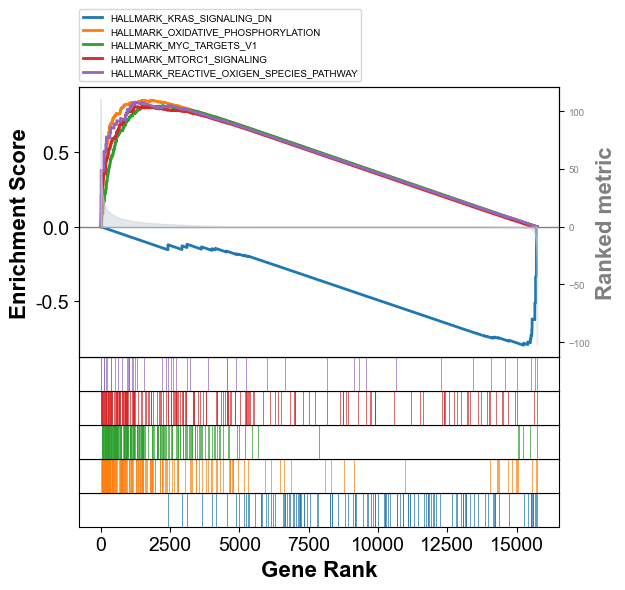

In [ ]:
axs = pre_res_hm.plot(terms=pre_res_hm.res2d.Term[0:5],                   
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )

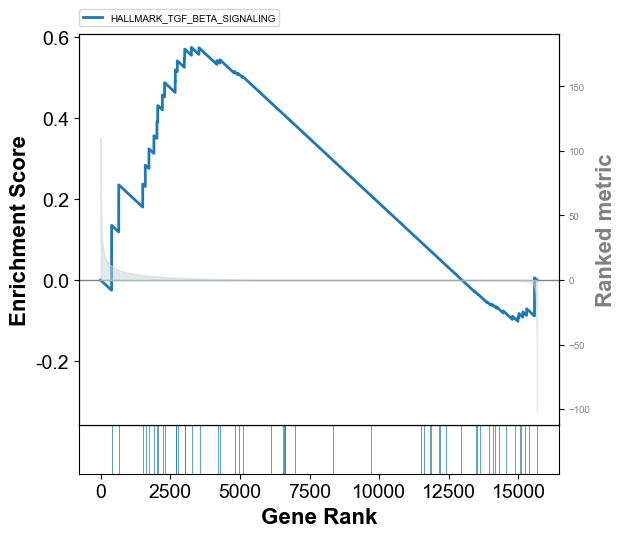

In [ ]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Ifn')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

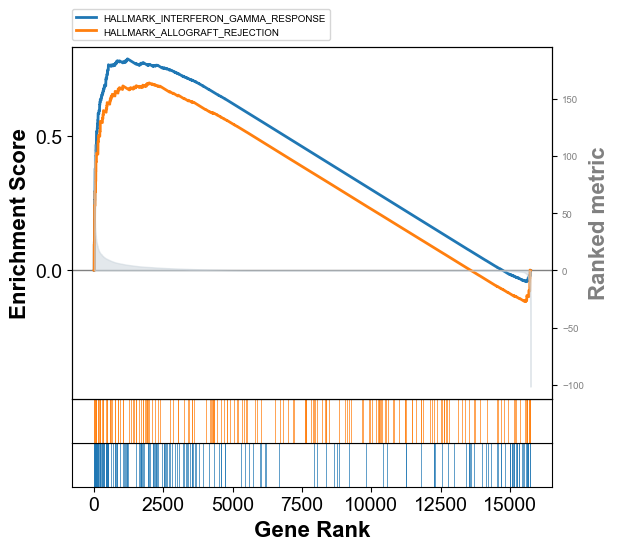

In [ ]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

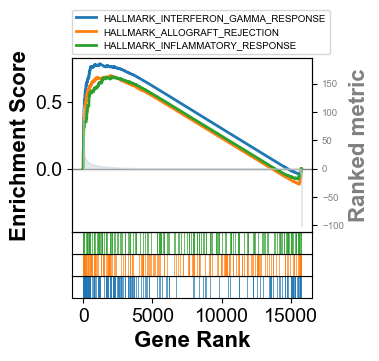

In [ ]:
terms = pre_res_hm.res2d.Term
indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
plt.savefig('figures/gsea_plot_cd40_hm.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

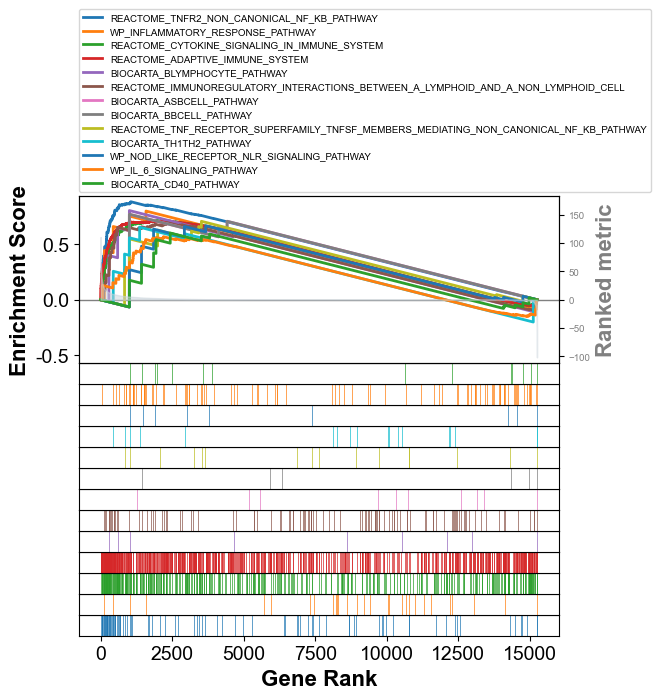

In [ ]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

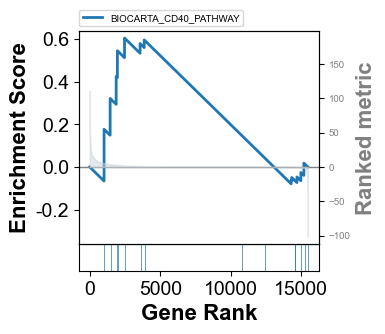

In [ ]:
terms = pre_res_bioc.res2d.Term
indices = terms[pre_res_bioc.res2d['Term'].str.contains('CD40')].index.tolist()
#print(cd40_indices)
plt.rcParams.update({'font.size': 7})

axs = pre_res_bioc.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
#plt.savefig('figures/gsea_plot_cd40.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

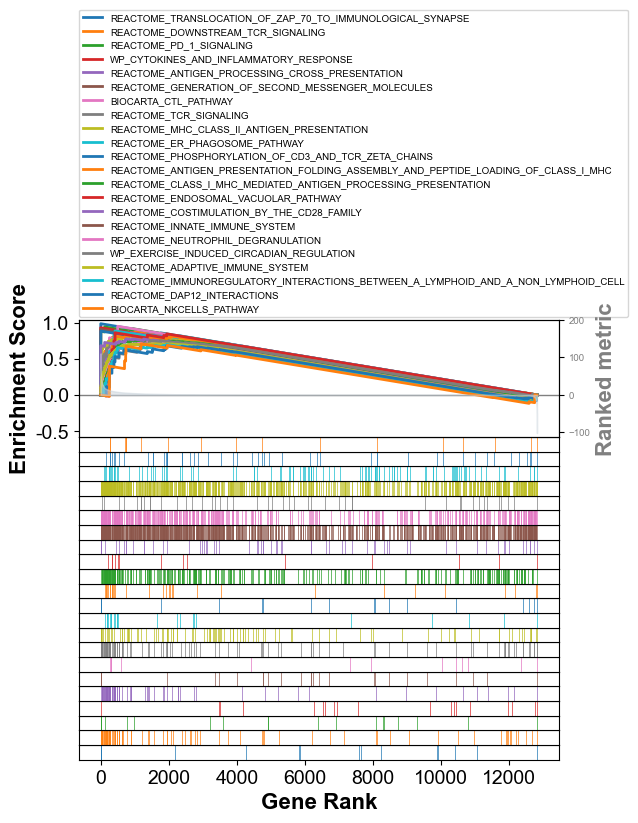

In [ ]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

## DEG 2KO kup vs mac_mono

In [62]:
adata_2KO= sc.read_h5ad('intermediate/12_anno_v2_2KO.h5ad')

In [64]:
adata_2KO.write_h5ad('intermediate/12_anno_v2_2KO.h5ad')

In [127]:
adata_2KO

AnnData object with n_obs × n_vars = 2325 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno', 'cell_subtype_v2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'

In [128]:
adata_2KO.obs['cell_subtype_v2'].unique()

['Mac_mono', 'DC2', 'Kupffer_cell', 'DC1', 'DC_ccr7']
Categories (5, object): ['DC1', 'DC2', 'DC_ccr7', 'Kupffer_cell', 'Mac_mono']

In [63]:
sc.tl.rank_genes_groups(adata_2KO, groupby = 'cell_subtype_v2', groups=['Mac_mono'], reference='Kupffer_cell', method='wilcoxon', key_added='mono_kup_wilcoxon')

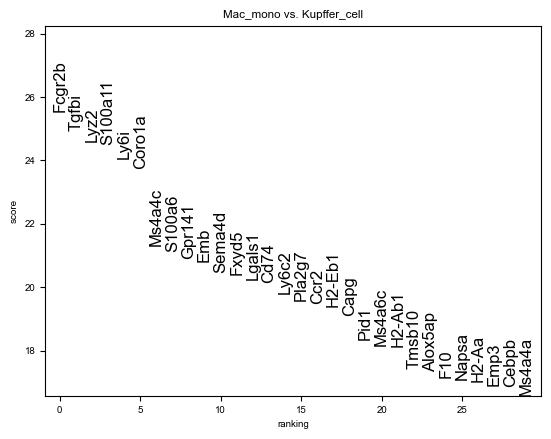

In [65]:
sc.pl.rank_genes_groups(adata_2KO, key='mono_kup_wilcoxon', n_genes=30, fontsize=12)

In [66]:
pval_threshold = 0.05

# Open an Excel writer
with pd.ExcelWriter('DEG/rank_genes_groups_mac_mono_kc.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_2KO.uns['mono_kup_wilcoxon']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_2KO.uns['mono_kup_wilcoxon'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [67]:
# Extract DEG results for '2KO' group
genes = adata_2KO.uns['mono_kup_wilcoxon']['names']['Mac_mono']
logfoldchanges = adata_2KO.uns['mono_kup_wilcoxon']['logfoldchanges']['Mac_mono']
pvals = adata_2KO.uns['mono_kup_wilcoxon']['pvals']['Mac_mono']
pvals_adj = adata_2KO.uns['mono_kup_wilcoxon']['pvals_adj']['Mac_mono']

# Create a DataFrame
DEG_2KO_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
})

# Display the DataFrame
DEG_2KO_df.head()

,genes,logfoldchanges,pvals,pvals_adj
0,Fcgr2b,5.747800,6.456906e-144,2.543214e-140
1,Tgfbi,3.182012,2.392302e-137,6.281785e-134
2,Lyz2,4.111101,2.353551e-133,4.120021e-130
3,S100a11,5.225951,1.600570e-132,2.521698e-129
4,Ly6i,6.713726,7.290826e-128,8.835921e-125


In [71]:
groups = ['Mac_mono']
de_results = {}
for group in groups:
    genes = adata_2KO.uns['mono_kup_wilcoxon']['names'][group]
    logfoldchanges = adata_2KO.uns['mono_kup_wilcoxon']['logfoldchanges'][group]
    pvals = adata_2KO.uns['mono_kup_wilcoxon']['pvals'][group]
    pvals_adj = adata_2KO.uns['mono_kup_wilcoxon']['pvals_adj'][group]
    de_results[group] = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
    })

# Now, de_results['condition_A'] contains the DEGs for condition_A
de_results['Mac_mono'].head()

,genes,logfoldchanges,pvals,pvals_adj
0,Fcgr2b,5.747800,6.456906e-144,2.543214e-140
1,Tgfbi,3.182012,2.392302e-137,6.281785e-134
2,Lyz2,4.111101,2.353551e-133,4.120021e-130
3,S100a11,5.225951,1.600570e-132,2.521698e-129
4,Ly6i,6.713726,7.290826e-128,8.835921e-125


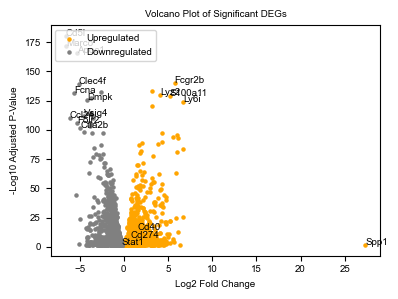

In [72]:
df_DEG = pd.DataFrame({
    'logfoldchanges':DEG_2KO_df['logfoldchanges'],
    'pvals_adj': DEG_2KO_df['pvals_adj']
})

df_DEG.index = DEG_2KO_df['genes']

# Extract logfoldchanges and adjusted p-values
logfoldchanges = df_DEG['logfoldchanges']
pvals_adj = df_DEG['pvals_adj']

# Calculate the negative logarithm for adjusted p-values
neg_log_pvals_adj = -np.log10(pvals_adj)

# Filter for significant genes (e.g., pvals_adj < 0.05)
significant_mask = (pvals_adj < 0.05)
significant_logfoldchanges = logfoldchanges[significant_mask]
significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

# Separate upregulated and downregulated genes
upregulated = significant_logfoldchanges > 0
downregulated = significant_logfoldchanges < 0

# Set global font settings
plt.rcParams['font.size'] = 7
plt.rcParams['font.family'] = 'Arial'

# Set up the figure and axis with the new figure size
fig, ax = plt.subplots(figsize=(4, 3))

# Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
# Scatter plot the genes based on their regulation direction
ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='orange', s=5, label='Upregulated')
ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='grey', s=5, label='Downregulated')

# Titles, labels, and other customizations with updated fontsize and font
ax.set_title("Volcano Plot of Significant DEGs", fontsize=7)
ax.set_xlabel("Log2 Fold Change", fontsize=7)
ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
ax.tick_params(axis='both', which='major', labelsize=7)
ax.grid(False)
ax.legend(loc='upper left', fontsize=7)

genes_to_label = significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 4) & 
     (significant_neg_log_pvals_adj > 100)) |
    (np.abs(significant_logfoldchanges) > 10)
].index.tolist()  # Convert the index to a list'''

# Add your genes of interest
genes_of_interest = ["Cd40", "Cd274", 'Stat1']
genes_to_label = genes_to_label + genes_of_interest
#genes_to_label = genes_of_interest

# Annotate specific genes with updated fontsize
for gene in genes_to_label:
    if gene in significant_logfoldchanges and gene in significant_neg_log_pvals_adj:
        x = significant_logfoldchanges[gene]
        y = significant_neg_log_pvals_adj[gene]
        ax.annotate(gene, (x, y), fontsize=7, arrowprops=None)


# Display the plot
plt.tight_layout()
plt.savefig("figures/2KO_mono_kup_DEG_volcano.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()


In [14]:
print(significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 4) & 
     (significant_neg_log_pvals_adj > 100)) |
    (np.abs(significant_logfoldchanges) > 10)
])

genes
Fcgr2b      5.747800
Lyz2        4.111101
S100a11     5.225951
Ly6i        6.713726
Spp1       27.348749
Ctla2b     -4.935458
Folr2      -5.310366
Ccl24      -6.098025
Vsig4      -4.453448
Dmpk       -4.176869
Fcna       -5.604746
Clec4f     -5.109387
Apoc1      -5.306190
Marco      -6.532465
Cd5l       -6.588857
Name: logfoldchanges, dtype: float32


### prepare gsea_df

In [15]:
input_df = DEG_2KO_df
# check that there are no NaN in log fold change:
np.sum(np.isnan(input_df['logfoldchanges']))

0

In [16]:
df_gsea = input_df[['genes', 'logfoldchanges', 'pvals_adj']]
# we change the 0 in pvals_adj to the minimum non-zero value
non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
# then multiply by the sign of the log fold change to get the 'score'
df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
# sort
df_gsea = df_gsea.sort_values(by='score', ascending=False)
df_gsea

,genes,logfoldchanges,pvals_adj,pvals_adj_updated,-log10(pvals_adj),score
0,Fcgr2b,5.747800,2.543214e-140,2.543214e-140,139.594617,139.594617
1,Tgfbi,3.182012,6.281785e-134,6.281785e-134,133.201917,133.201917
2,Lyz2,4.111101,4.120021e-130,4.120021e-130,129.385101,129.385101
3,S100a11,5.225951,2.521698e-129,2.521698e-129,128.598307,128.598307
4,Ly6i,6.713726,8.835921e-125,8.835921e-125,124.053748,124.053748
...,...,...,...,...,...,...
15750,Sdc3,-2.556448,9.085703e-133,9.085703e-133,132.041641,-132.041641
15751,Clec4f,-5.109387,1.204470e-139,1.204470e-139,138.919204,-138.919204
15752,Apoc1,-5.306190,3.730326e-166,3.730326e-166,165.428253,-165.428253
15753,Marco,-6.532465,3.237621e-172,3.237621e-172,171.489774,-171.489774


In [17]:
prerank_input = df_gsea.set_index('genes')['score'].to_frame()
prerank_input

,score
genes,
Fcgr2b,139.594617
Tgfbi,133.201917
Lyz2,129.385101
S100a11,128.598307
Ly6i,124.053748
...,...
Sdc3,-132.041641
Clec4f,-138.919204
Apoc1,-165.428253


### read in database

In [18]:
df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
df_set_hm

,1,2,3,4,5,6,7,8,9,10,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN
HALLMARK_APICAL_SURFACE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Adam10,Adipor2,Afap1l2,Akap7,App,Atp6v0a4,Atp8b1,B4galt1,Brca1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APOPTOSIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Add1,Aifm3,Ank,Anxa1,App,Atf3,Avpr1a,Bax,Bcap31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_BILE_ACID_METABOLISM,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abca2,Abca3,Abca4,Abca5,Abca6,Abca8b,Abca9,Abcd1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_CHOLESTEROL_HOMEOSTASIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca2,Acat2,Acss2,Actg1,Adh4,Alcam,Aldoc,Antxr2,Anxa5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
del df_set_hm[1]
df_set_hm.head()

,2,3,4,5,6,7,8,9,10,11,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,Adcy6,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,Bcl10,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,Ank,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,Jag1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,Adam15,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN


In [20]:
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [21]:
path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [22]:
path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

### run GSEA

In [23]:
pre_res_hm = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_hm,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 21:27:24,394 [WARNING] Duplicated values found in preranked stats: 63.69% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 21:27:24,395 [INFO] Parsing data files for GSEA.............................
2024-02-26 21:27:24,406 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 21:27:24,408 [INFO] 0050 gene_sets used for further statistical testing.....


2024-02-26 21:27:24,409 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 21:27:29,827 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 21:27:29,827 [INFO] Congratulations. GSEApy runs successfully................



In [24]:
pre_res_cp = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_cp,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_cp', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 21:27:29,852 [WARNING] Duplicated values found in preranked stats: 63.69% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 21:27:29,854 [INFO] Parsing data files for GSEA.............................
2024-02-26 21:27:29,887 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 21:27:29,892 [INFO] 1628 gene_sets used for further statistical testing.....


2024-02-26 21:27:29,894 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 21:29:26,120 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 21:29:26,121 [INFO] Congratulations. GSEApy runs successfully................



In [25]:
pre_res_bioc = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_bioc,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_bioc', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 21:29:26,177 [WARNING] Duplicated values found in preranked stats: 63.69% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 21:29:26,179 [INFO] Parsing data files for GSEA.............................
2024-02-26 21:29:26,191 [INFO] 0006 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 21:29:26,194 [INFO] 0246 gene_sets used for further statistical testing.....


2024-02-26 21:29:26,196 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 21:29:43,772 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 21:29:43,772 [INFO] Congratulations. GSEApy runs successfully................



In [26]:
pre_res_hm.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.703134,1.42722,0.006098,0.253206,0.217,44/179,5.05%,Fcgr2b;Cd74;Ccr2;Capg;H2-Aa;Ccl5;Srgn;Ctss;Ccr...
1,prerank,HALLMARK_ADIPOGENESIS,-0.78018,-1.421608,0.010324,0.269482,0.226,46/194,7.04%,Lpl;Itsn1;Acly;Atp1b3;Aldh2;Sod1;Gpx3;Uqcr11;A...
2,prerank,HALLMARK_MYC_TARGETS_V1,-0.772901,-1.418143,0.014286,0.149602,0.248,95/181,14.10%,Pabpc1;Eif2s2;Hsp90ab1;Gnl3;Cox5a;Hspd1;Prdx4;...
3,prerank,HALLMARK_BILE_ACID_METABOLISM,-0.785122,-1.347526,0.033708,0.384738,0.672,18/109,8.00%,Atxn1;Sod1;Rxra;Slc29a1;Abca1;Idh1;Scp2;Hsd17b...
4,prerank,HALLMARK_G2M_CHECKPOINT,-0.734633,-1.338081,0.035659,0.331651,0.729,67/188,13.22%,Marcks;Ccnd1;Ncl;Top1;Stmn1;Snrpd1;Ewsr1;Kpnb1...
5,prerank,HALLMARK_E2F_TARGETS,-0.714234,-1.320473,0.039634,0.342004,0.81,77/196,16.45%,Tfrc;Stmn1;Prdx4;Tk1;Pa2g4;Ube2s;Rfc1;Ranbp1;C...
6,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,-0.706006,-1.284243,0.064234,0.435431,0.917,74/193,11.50%,Uqcr11;Idh1;Atp6v1g1;Uqcrq;Slc25a4;Etfb;Cox6a1...
7,prerank,HALLMARK_TNFA_SIGNALING_VIA_NFKB,0.642367,1.278526,0.069767,0.801819,0.775,63/189,6.32%,Cebpb;Ccl5;Btg1;Sdc4;Fos;Junb;Plaur;Socs3;Ier5...
8,prerank,HALLMARK_MYC_TARGETS_V2,-0.786017,-1.258117,0.148208,0.488436,0.961,35/58,17.42%,Gnl3;Hspd1;Hk2;Ppan;Pa2g4;Hspe1;Mybbp1a;Nolc1;...
9,prerank,HALLMARK_ESTROGEN_RESPONSE_EARLY,-0.691705,-1.256856,0.095912,0.432459,0.965,15/180,4.55%,Blvrb;Tgm2;Ccnd1;Sh3bp5;Snx24;Cd44;Scarb1;Plaa...


In [27]:
pre_res_cp.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,WP_GPCRS_ODORANT,0.908197,1.575226,0.0,0.120027,0.087,4/59,4.87%,Gpr141;Gpr84;Gpr35;Cmklr1
1,prerank,WP_GPCRS_CLASS_A_RHODOPSIN_LIKE,0.842909,1.4933,0.008571,0.658026,0.56,17/79,6.14%,Ccr2;Ccr1;Ptafr;C5ar1;Htr7;Ccrl2;Cxcr4;Ltb4r1;...
2,prerank,REACTOME_THE_CITRIC_ACID_TCA_CYCLE_AND_RESPIRA...,-0.833228,-1.492331,0.0,0.154226,0.119,57/163,7.97%,mt-Co1;mt-Nd1;mt-Atp6;mt-Cytb;mt-Co2;mt-Nd4;Rx...
3,prerank,REACTOME_RESPIRATORY_ELECTRON_TRANSPORT,-0.874564,-1.473786,0.0,0.183143,0.234,37/95,7.97%,mt-Co1;mt-Nd1;mt-Cytb;mt-Co2;mt-Nd4;Uqcr11;mt-...
4,prerank,REACTOME_RESPIRATORY_ELECTRON_TRANSPORT_ATP_SY...,-0.84884,-1.467244,0.0,0.153904,0.275,43/117,7.38%,mt-Co1;mt-Nd1;mt-Atp6;mt-Cytb;mt-Co2;mt-Nd4;mt...
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,REACTOME_PRESYNAPTIC_DEPOLARIZATION_AND_CALCIU...,-0.21185,-0.27456,0.987402,0.99707,1.0,8/8,100.00%,Cacnb1;Cacnb2;Cacna2d2;Cacna1e;Cacnb3;Cacna1b;...
1624,prerank,REACTOME_PHASE_0_RAPID_DEPOLARISATION,-0.176392,-0.228298,0.981791,0.998806,1.0,6/6,100.00%,Cacnb1;Cacnb2;Cacna2d2;Cacng7;Cacng8;Cacna1c
1625,prerank,REACTOME_XENOBIOTICS,-0.154931,-0.215607,1.0,0.998677,1.0,19/19,100.00%,Arnt;Cyp2a5;Ahrr;Cyp3a11;Cyp2a12;Cyp3a59;Cyp2c...
1626,prerank,REACTOME_PHASE_1_INACTIVATION_OF_FAST_NA_CHANNELS,-0.158242,-0.200571,0.995461,0.998849,1.0,7/7,100.00%,Kcnip3;Kcnd1;Kcnd3;Kcnd2;Kcnip2;Kcnip4;Kcnip1


In [28]:
pre_res_bioc.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.962116,1.456288,0.005305,0.134627,0.085,1/22,0.16%,F10
1,prerank,BIOCARTA_KERATINOCYTE_PATHWAY,0.861346,1.430672,0.020672,0.139478,0.154,15/46,5.96%,Tnfrsf1b;Fos;Jun;Prkcd;Mapk3;Nfkbia;Prkch;Prkc...
2,prerank,BIOCARTA_NKT_PATHWAY,0.936014,1.401417,0.023747,0.264403,0.352,7/25,3.33%,Ccr2;Ccr1;Cxcr4;Ifngr2;Ccl4;Ifngr1;Ccl3
3,prerank,BIOCARTA_HIVNEF_PATHWAY,0.806846,1.360342,0.061995,0.563978,0.675,13/54,4.27%,Arhgdib;Gsn;Tnfrsf1b;Psen2;Prkcd;Traf1;Nfkbia;...
4,prerank,BIOCARTA_41BB_PATHWAY,0.932627,1.342235,0.057851,0.686719,0.799,7/18,5.40%,Jun;Nfkbia;Ikbkb;Nfkb1;Map3k5;Map3k1;Tnfsf9
...,...,...,...,...,...,...,...,...,...,...
241,prerank,BIOCARTA_GH_PATHWAY,0.408602,0.59669,0.978082,0.967826,1.0,5/24,7.34%,Mapk3;Socs1;Jak2;Map2k1;Pik3cg
242,prerank,BIOCARTA_AKT_PATHWAY,-0.427308,-0.591161,0.953226,0.971167,1.0,4/20,9.07%,Pik3r1;Ywhah;Akt1;Hsp90aa1
243,prerank,BIOCARTA_TEL_PATHWAY,-0.435768,-0.589832,0.965058,0.964615,1.0,7/17,16.24%,Prkca;Akt1;Hsp90aa1;Trp53;Myc;Bcl2;Xrcc6
244,prerank,BIOCARTA_MELANOCYTE_PATHWAY,0.388876,0.486,0.988636,0.996538,1.0,2/6,9.79%,Ep300;Mitf


In [38]:
df_bioc = pre_res_bioc.res2d[pre_res_bioc.res2d['FDR q-val'] <= 0.9]
ordered_df_bioc = df_bioc.sort_values(by='NES')
ordered_df_bioc

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
5,prerank,BIOCARTA_NUCLEARRS_PATHWAY,-0.92125,-1.339657,0.024752,0.666405,0.37,4/29,3.41%,Nr1h3;Abca1;Abcc3;Abcg1
198,prerank,BIOCARTA_VIP_PATHWAY,0.525277,0.804412,0.733681,0.897683,1.0,4/23,5.21%,Nfkbia;Nfkb1;Nfatc2;Map3k1
195,prerank,BIOCARTA_CERAMIDE_PATHWAY,0.561001,0.820259,0.742547,0.886796,1.0,5/22,6.49%,Mapk3;Nfkb1;Map3k1;Map2k1;Bad
192,prerank,BIOCARTA_GABA_PATHWAY,0.666322,0.825647,0.804154,0.889237,1.0,1/6,1.33%,Gabarap
182,prerank,BIOCARTA_PCAF_PATHWAY,0.647566,0.853758,0.708934,0.862678,1.0,2/9,3.31%,Jun;Nfkb1
...,...,...,...,...,...,...,...,...,...,...
4,prerank,BIOCARTA_41BB_PATHWAY,0.932627,1.342235,0.057851,0.686719,0.799,7/18,5.40%,Jun;Nfkbia;Ikbkb;Nfkb1;Map3k5;Map3k1;Tnfsf9
3,prerank,BIOCARTA_HIVNEF_PATHWAY,0.806846,1.360342,0.061995,0.563978,0.675,13/54,4.27%,Arhgdib;Gsn;Tnfrsf1b;Psen2;Prkcd;Traf1;Nfkbia;...
2,prerank,BIOCARTA_NKT_PATHWAY,0.936014,1.401417,0.023747,0.264403,0.352,7/25,3.33%,Ccr2;Ccr1;Cxcr4;Ifngr2;Ccl4;Ifngr1;Ccl3
1,prerank,BIOCARTA_KERATINOCYTE_PATHWAY,0.861346,1.430672,0.020672,0.139478,0.154,15/46,5.96%,Tnfrsf1b;Fos;Jun;Prkcd;Mapk3;Nfkbia;Prkch;Prkc...


In [45]:
df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.6]
ordered_df_cp = df_cp.sort_values(by='NES')
ordered_df_cp

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
2,prerank,REACTOME_THE_CITRIC_ACID_TCA_CYCLE_AND_RESPIRA...,-0.833228,-1.492331,0.0,0.154226,0.119,57/163,7.97%,mt-Co1;mt-Nd1;mt-Atp6;mt-Cytb;mt-Co2;mt-Nd4;Rx...
3,prerank,REACTOME_RESPIRATORY_ELECTRON_TRANSPORT,-0.874564,-1.473786,0.0,0.183143,0.234,37/95,7.97%,mt-Co1;mt-Nd1;mt-Cytb;mt-Co2;mt-Nd4;Uqcr11;mt-...
4,prerank,REACTOME_RESPIRATORY_ELECTRON_TRANSPORT_ATP_SY...,-0.84884,-1.467244,0.0,0.153904,0.275,43/117,7.38%,mt-Co1;mt-Nd1;mt-Atp6;mt-Cytb;mt-Co2;mt-Nd4;mt...
5,prerank,WP_ELECTRON_TRANSPORT_CHAIN,-0.869076,-1.463169,0.003096,0.136634,0.315,45/91,7.55%,mt-Co1;mt-Nd1;mt-Atp6;mt-Cytb;mt-Co2;Atpif1;mt...
13,prerank,REACTOME_MUSCLE_CONTRACTION,-0.814465,-1.419354,0.013783,0.439929,0.743,10/127,5.07%,Dmpk;Atp1b3;Aldh2;Kcnk13;Atp1a1;Tln1;Tpm3;Itpr...
0,prerank,WP_GPCRS_ODORANT,0.908197,1.575226,0.0,0.120027,0.087,4/59,4.87%,Gpr141;Gpr84;Gpr35;Cmklr1


In [40]:
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp']
mask2 = ordered_df_cp['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_cp_filtered = ordered_df_cp[mask2]
ordered_df_cp_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
24,prerank,REACTOME_RND2_GTPASE_CYCLE,-0.902887,-1.368425,0.011272,0.840434,0.99,7/41,4.75%,Dst;Pkp4;Tfrc;Pik3r1;Kidins220;Arhgap5;Tnfaip1
55,prerank,REACTOME_RND3_GTPASE_CYCLE,-0.890023,-1.334766,0.035088,0.808546,1.0,8/39,4.75%,Dst;Pkp4;Ckb;Pik3r1;Rasal2;Arhgap21;Arhgap5;Tn...
58,prerank,WP_MATRIX_METALLOPROTEINASES,0.899597,1.331403,0.076336,0.85757,1.0,2/22,4.27%,Mmp14;Tnf
53,prerank,WP_GPCRS_NON_ODORANT,0.688866,1.335622,0.063584,0.880104,1.0,19/138,6.14%,Ccr2;Ccr1;Gpr132;Ptafr;C5ar1;Htr7;Ccrl2;Cxcr4;...
11,prerank,BIOCARTA_KERATINOCYTE_PATHWAY,0.861346,1.430672,0.020672,0.690157,0.946,15/46,5.96%,Tnfrsf1b;Fos;Jun;Prkcd;Mapk3;Nfkbia;Prkch;Prkc...
9,prerank,WP_GPCRS_PEPTIDE,0.937457,1.436645,0.01061,0.817,0.918,5/29,1.90%,Ccr2;Ccr1;C5ar1;Cxcr4;C3ar1
8,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.947192,1.447825,0.008065,0.771999,0.881,6/29,4.80%,Il2rg;Tnfrsf1b;Cd40;Fn1;Thbs1;Il4ra
1,prerank,WP_GPCRS_CLASS_A_RHODOPSIN_LIKE,0.842909,1.4933,0.008571,0.658026,0.56,17/79,6.14%,Ccr2;Ccr1;Ptafr;C5ar1;Htr7;Ccrl2;Cxcr4;Ltb4r1;...


In [37]:
df_hm = pre_res_hm.res2d[pre_res_hm.res2d['FDR q-val'] <= 0.5]
ordered_df_hm = df_hm.sort_values(by='NES')
ordered_df_hm

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
1,prerank,HALLMARK_ADIPOGENESIS,-0.78018,-1.421608,0.010324,0.269482,0.226,46/194,7.04%,Lpl;Itsn1;Acly;Atp1b3;Aldh2;Sod1;Gpx3;Uqcr11;A...
2,prerank,HALLMARK_MYC_TARGETS_V1,-0.772901,-1.418143,0.014286,0.149602,0.248,95/181,14.10%,Pabpc1;Eif2s2;Hsp90ab1;Gnl3;Cox5a;Hspd1;Prdx4;...
3,prerank,HALLMARK_BILE_ACID_METABOLISM,-0.785122,-1.347526,0.033708,0.384738,0.672,18/109,8.00%,Atxn1;Sod1;Rxra;Slc29a1;Abca1;Idh1;Scp2;Hsd17b...
4,prerank,HALLMARK_G2M_CHECKPOINT,-0.734633,-1.338081,0.035659,0.331651,0.729,67/188,13.22%,Marcks;Ccnd1;Ncl;Top1;Stmn1;Snrpd1;Ewsr1;Kpnb1...
5,prerank,HALLMARK_E2F_TARGETS,-0.714234,-1.320473,0.039634,0.342004,0.81,77/196,16.45%,Tfrc;Stmn1;Prdx4;Tk1;Pa2g4;Ube2s;Rfc1;Ranbp1;C...
6,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,-0.706006,-1.284243,0.064234,0.435431,0.917,74/193,11.50%,Uqcr11;Idh1;Atp6v1g1;Uqcrq;Slc25a4;Etfb;Cox6a1...
8,prerank,HALLMARK_MYC_TARGETS_V2,-0.786017,-1.258117,0.148208,0.488436,0.961,35/58,17.42%,Gnl3;Hspd1;Hk2;Ppan;Pa2g4;Hspe1;Mybbp1a;Nolc1;...
9,prerank,HALLMARK_ESTROGEN_RESPONSE_EARLY,-0.691705,-1.256856,0.095912,0.432459,0.965,15/180,4.55%,Blvrb;Tgm2;Ccnd1;Sh3bp5;Snx24;Cd44;Scarb1;Plaa...
10,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.726202,-1.240021,0.109907,0.450017,0.982,9/120,7.62%,Selenop;Ptprj;Thrb;Camk1d;Cpeb3;Ccdc106;Lfng;S...
0,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.703134,1.42722,0.006098,0.253206,0.217,44/179,5.05%,Fcgr2b;Cd74;Ccr2;Capg;H2-Aa;Ccl5;Srgn;Ctss;Ccr...


In [32]:
pre_res_hm.res2d[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.703134,1.42722,0.006098,0.253206,0.217,44/179,5.05%,Fcgr2b;Cd74;Ccr2;Capg;H2-Aa;Ccl5;Srgn;Ctss;Ccr...
19,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.578689,1.139071,0.187117,0.585149,0.977,63/181,5.10%,Cd74;H2-Aa;Slamf7;Ccl5;Btg1;Ifitm3;Psmb8;Arid5...
29,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.530444,1.048018,0.359331,0.592663,0.998,50/176,5.46%,Sema4d;Emp3;Ccl5;Mmp14;Gpr132;Tnfrsf1b;Plaur;C...


In [33]:
pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
8,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.947192,1.447825,0.008065,0.771999,0.881,6/29,4.80%,Il2rg;Tnfrsf1b;Cd40;Fn1;Thbs1;Il4ra
32,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.750143,1.354623,0.047486,1.0,1.0,20/91,6.96%,Tnfrsf1b;Psmb8;Ubb;Psme2;Cd40;Tnfsf12;Birc3;Tr...
81,prerank,REACTOME_TNF_RECEPTOR_SUPERFAMILY_TNFSF_MEMBER...,0.916442,1.304502,0.112903,0.914762,1.0,6/16,6.80%,Cd40;Tnfsf12;Birc3;Traf3;Tnfsf13b;Map3k14
104,prerank,BIOCARTA_CD40_PATHWAY,0.929297,1.284708,0.094851,0.929415,1.0,10/14,6.80%,Cd40;Nfkbia;Tnfaip3;Traf3;Ikbkb;Dusp1;Nfkb1;Ma...
169,prerank,WP_IL_6_SIGNALING_PATHWAY,0.679234,1.245829,0.112903,0.97627,1.0,23/96,6.59%,Cebpb;Fos;Socs3;Jun;Cd40;Prkcd;Fgr;Tec;Mapk3;H...
177,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.665841,1.24262,0.093151,0.966061,1.0,18/108,2.15%,Fcgr2b;H2-K1;Slamf7;C3;H2-Q7;Itgb2;Ifitm3;H2-Q...
192,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.944372,1.236922,0.126801,0.91415,1.0,4/9,1.36%,Fcgr2b;Itgb2;Ptprc;Cd40
204,prerank,REACTOME_ADAPTIVE_IMMUNE_SYSTEM,0.53993,1.227405,0.02765,0.971421,1.0,76/652,5.05%,Fcgr2b;Cd74;H2-Eb1;H2-Ab1;H2-Aa;H2-K1;Slamf7;C...
255,prerank,WP_NOD_LIKE_RECEPTOR_NLR_SIGNALING_PATHWAY,0.937059,1.205235,0.182065,0.966375,1.0,2/9,2.64%,Cd40;Ikbkb
295,prerank,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,0.55302,1.193877,0.075188,0.926602,1.0,78/392,6.96%,Il2rg;Tnfrsf1b;Fos;Psmb8;N4bp1;Socs3;Jun;Ubb;I...


In [34]:
pre_res_bioc.res2d[pre_res_bioc.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
15,prerank,BIOCARTA_CD40_PATHWAY,0.929297,1.284708,0.094851,0.633273,0.979,10/14,6.80%,Cd40;Nfkbia;Tnfaip3;Traf3;Ikbkb;Dusp1;Nfkb1;Ma...
34,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.944372,1.236922,0.126801,0.651933,1.0,4/9,1.36%,Fcgr2b;Itgb2;Ptprc;Cd40
83,prerank,BIOCARTA_ASBCELL_PATHWAY,0.852413,1.148091,0.360902,0.759021,1.0,2/10,3.40%,Cd40;Fas
108,prerank,BIOCARTA_BBCELL_PATHWAY,0.878438,1.083635,0.528947,0.845914,1.0,2/6,3.40%,Cd40;Fas


#### plot top pathways

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

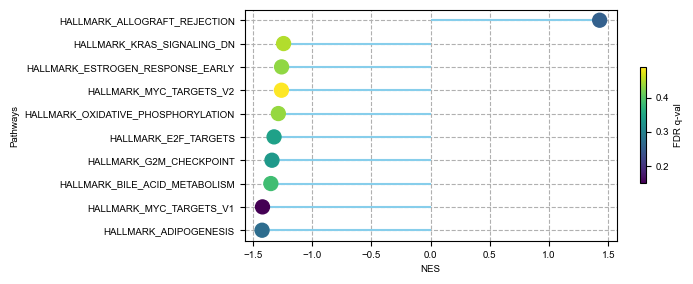

In [46]:
gsea_dotplot(ordered_df_hm, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/2KO_mono_vs_kup_top_pathway_hm.pdf') #


(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

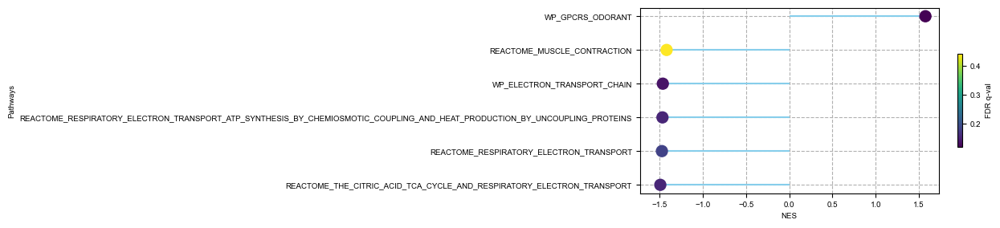

In [47]:
gsea_dotplot(ordered_df_cp, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/2KO_mono_vs_kup_top_pathway_cp.pdf') #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

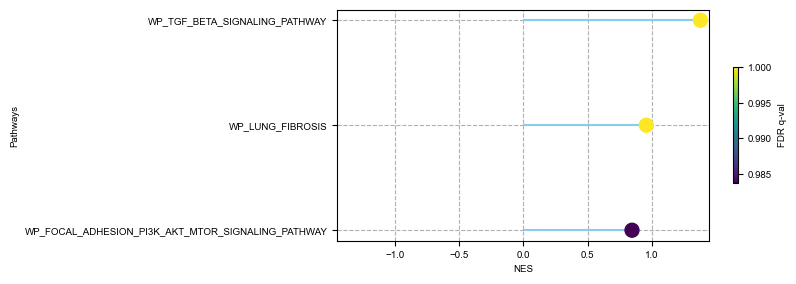

In [49]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Spp')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7 
             ) #

#### enrichment score

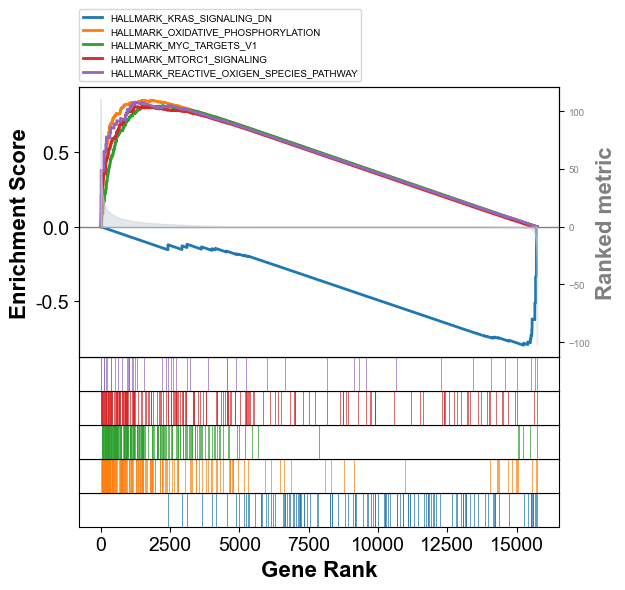

In [ ]:
axs = pre_res_hm.plot(terms=pre_res_hm.res2d.Term[0:5],                   
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )

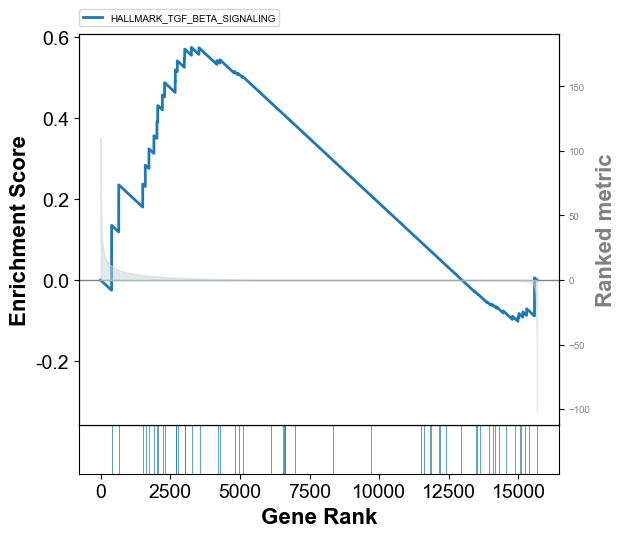

In [ ]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Ifn')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

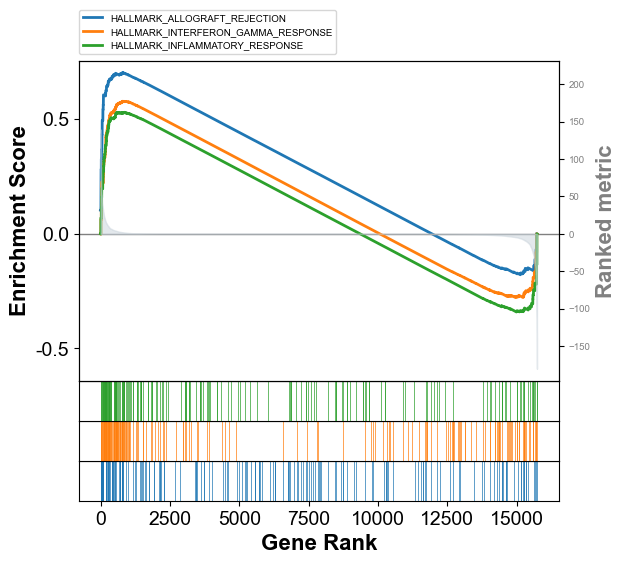

In [52]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

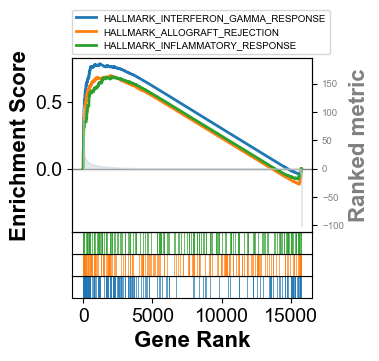

In [ ]:
terms = pre_res_hm.res2d.Term
indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
#plt.savefig('figures/gsea_plot_cd40_hm.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

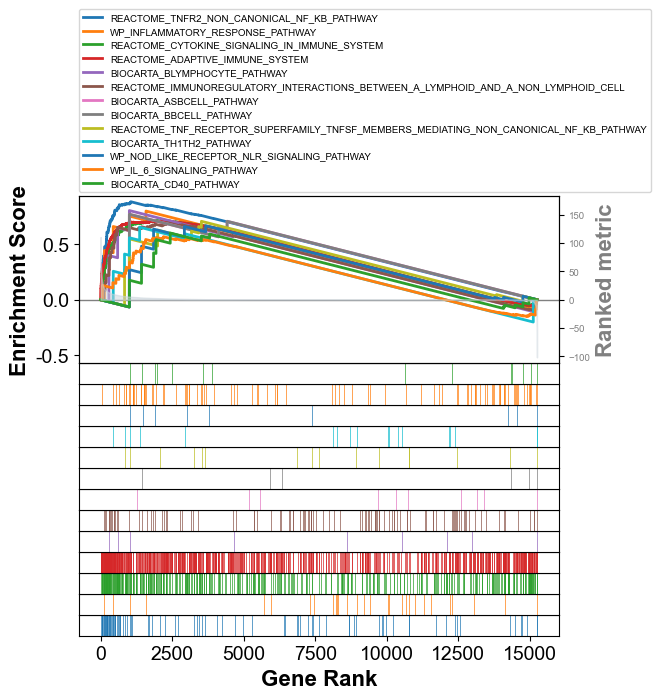

In [ ]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

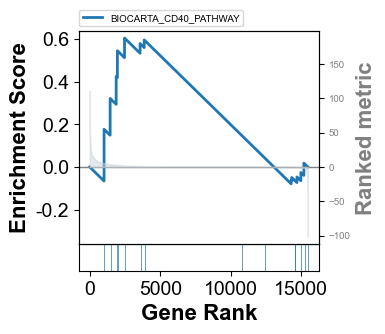

In [ ]:
terms = pre_res_bioc.res2d.Term
indices = terms[pre_res_bioc.res2d['Term'].str.contains('CD40')].index.tolist()
#print(cd40_indices)
plt.rcParams.update({'font.size': 7})

axs = pre_res_bioc.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
#plt.savefig('figures/gsea_plot_cd40.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

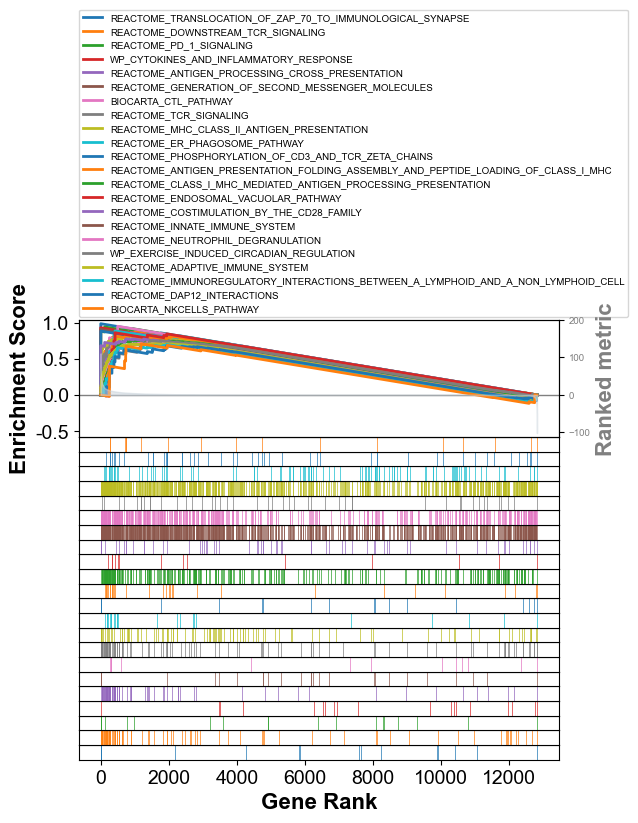

In [ ]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

## DEG all kup vs mac_mono

In [ ]:
adata= sc.read_h5ad('intermediate/12_anno_v2_2KO.h5ad')

In [54]:
adata

AnnData object with n_obs × n_vars = 7399 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno', 'cell_subtype_v2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: '2KO_wilcoxon', 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'

In [56]:
adata.obs['cell_subtype_v2'].unique()

['Mac_mono', 'Kupffer_cell', 'DC2', 'DC1', 'DC_ccr7']
Categories (5, object): ['DC1', 'DC2', 'DC_ccr7', 'Kupffer_cell', 'Mac_mono']

In [57]:
sc.tl.rank_genes_groups(adata, groupby = 'cell_subtype_v2', groups=['Mac_mono'], reference='Kupffer_cell', method='wilcoxon', key_added='mono_kup_wilcoxon')

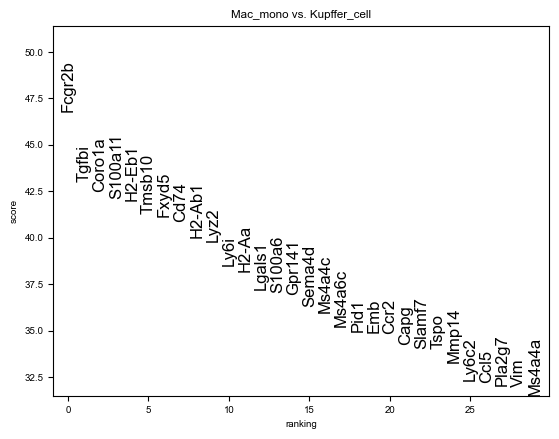

In [58]:
sc.pl.rank_genes_groups(adata, key='mono_kup_wilcoxon', n_genes=30, fontsize=12)

In [62]:
# Extract DEG results for '2KO' group
genes = adata.uns['mono_kup_wilcoxon']['names']['Mac_mono']
logfoldchanges = adata.uns['mono_kup_wilcoxon']['logfoldchanges']['Mac_mono']
pvals = adata.uns['mono_kup_wilcoxon']['pvals']['Mac_mono']
pvals_adj = adata.uns['mono_kup_wilcoxon']['pvals_adj']['Mac_mono']

# Create a DataFrame
DEG_2KO_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
})

# Display the DataFrame
DEG_2KO_df.head()

,genes,logfoldchanges,pvals,pvals_adj
0,Fcgr2b,6.294087,0.0,0.0
1,Tgfbi,3.530686,0.0,0.0
2,Coro1a,3.230942,0.0,0.0
3,S100a11,5.075197,0.0,0.0
4,H2-Eb1,3.394513,0.0,0.0


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


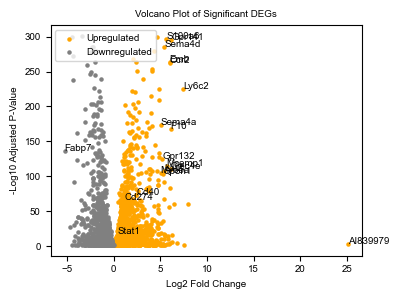

In [64]:
df_DEG = pd.DataFrame({
    'logfoldchanges':DEG_2KO_df['logfoldchanges'],
    'pvals_adj': DEG_2KO_df['pvals_adj']
})

df_DEG.index = DEG_2KO_df['genes']

# Extract logfoldchanges and adjusted p-values
logfoldchanges = df_DEG['logfoldchanges']
pvals_adj = df_DEG['pvals_adj']

# Calculate the negative logarithm for adjusted p-values
neg_log_pvals_adj = -np.log10(pvals_adj)

# Filter for significant genes (e.g., pvals_adj < 0.05)
significant_mask = (pvals_adj < 0.05)
significant_logfoldchanges = logfoldchanges[significant_mask]
significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

# Separate upregulated and downregulated genes
upregulated = significant_logfoldchanges > 0
downregulated = significant_logfoldchanges < 0

# Set global font settings
plt.rcParams['font.size'] = 7
plt.rcParams['font.family'] = 'Arial'

# Set up the figure and axis with the new figure size
fig, ax = plt.subplots(figsize=(4, 3))

# Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
# Scatter plot the genes based on their regulation direction
ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='orange', s=5, label='Upregulated')
ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='grey', s=5, label='Downregulated')

# Titles, labels, and other customizations with updated fontsize and font
ax.set_title("Volcano Plot of Significant DEGs", fontsize=7)
ax.set_xlabel("Log2 Fold Change", fontsize=7)
ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
ax.tick_params(axis='both', which='major', labelsize=7)
ax.grid(False)
ax.legend(loc='upper left', fontsize=7)

genes_to_label = significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 5) & 
     (significant_neg_log_pvals_adj > 100)) |
    (np.abs(significant_logfoldchanges) > 10)
].index.tolist()  # Convert the index to a list'''

# Add your genes of interest
genes_of_interest = ["Cd40", "Cd274", 'Stat1']
genes_to_label = genes_to_label + genes_of_interest
#genes_to_label = genes_of_interest

# Annotate specific genes with updated fontsize
for gene in genes_to_label:
    if gene in significant_logfoldchanges and gene in significant_neg_log_pvals_adj:
        x = significant_logfoldchanges[gene]
        y = significant_neg_log_pvals_adj[gene]
        ax.annotate(gene, (x, y), fontsize=7, arrowprops=None)


# Display the plot
plt.tight_layout()
#plt.savefig("figures/all_apc_mono_kup_DEG_volcano.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()


In [65]:
print(significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 4) & 
     (significant_neg_log_pvals_adj > 100)) |
    (np.abs(significant_logfoldchanges) > 10)
])

genes
Fcgr2b       6.294087
S100a11      5.075197
Ly6i         7.671909
Lgals1       4.590565
S100a6       5.623572
Gpr141       6.154770
Sema4d       5.396257
Ms4a4c       4.331362
Emb          6.000948
Ccr2         5.999590
Capg         4.089713
Slamf7       4.105930
Ly6c2        7.421662
Ccl5         4.824733
Ms4a4a       4.028046
Napsa        4.812937
Cyp4f18      4.036101
Sema4a       5.062809
Ahnak        4.106047
F10          6.105875
Slfn1        4.467711
Mcub         4.875854
Ccr1         4.848302
Atp8b4       4.090139
Gpr132       5.199095
Mcemp1       5.664071
Clec4e       6.107526
Itgax        4.083323
Sorl1        4.587834
Lat2         5.408349
Myo5a        5.020640
Spon1        5.325860
AI839979    25.100409
Fabp7       -5.264753
Cdh5        -4.325266
Clec1b      -4.359068
Ccl24       -4.498476
Folr2       -4.356550
Marco       -4.436523
Vsig4       -4.939704
Dmpk        -4.811408
Fcna        -5.995189
Slc40a1     -4.306747
Apoc1       -5.569144
Cd5l        -6.329526
Clec

### prepare gsea_df

In [66]:
input_df = DEG_2KO_df
# check that there are no NaN in log fold change:
np.sum(np.isnan(input_df['logfoldchanges']))

0

In [67]:
df_gsea = input_df[['genes', 'logfoldchanges', 'pvals_adj']]
# we change the 0 in pvals_adj to the minimum non-zero value
non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
# then multiply by the sign of the log fold change to get the 'score'
df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
# sort
df_gsea = df_gsea.sort_values(by='score', ascending=False)
df_gsea

,genes,logfoldchanges,pvals_adj,pvals_adj_updated,-log10(pvals_adj),score
0,Fcgr2b,6.294087,0.0,3.102674e-302,301.508264,301.508264
1,Tgfbi,3.530686,0.0,3.102674e-302,301.508264,301.508264
2,Coro1a,3.230942,0.0,3.102674e-302,301.508264,301.508264
3,S100a11,5.075197,0.0,3.102674e-302,301.508264,301.508264
4,H2-Eb1,3.394513,0.0,3.102674e-302,301.508264,301.508264
...,...,...,...,...,...,...
15740,Ptgs1,-3.586923,0.0,3.102674e-302,301.508264,-301.508264
15739,Folr2,-4.356550,0.0,3.102674e-302,301.508264,-301.508264
15738,Ptprm,-2.544709,0.0,3.102674e-302,301.508264,-301.508264
15737,St3gal5,-2.228770,0.0,3.102674e-302,301.508264,-301.508264


In [68]:
prerank_input = df_gsea.set_index('genes')['score'].to_frame()
prerank_input

,score
genes,
Fcgr2b,301.508264
Tgfbi,301.508264
Coro1a,301.508264
S100a11,301.508264
H2-Eb1,301.508264
...,...
Ptgs1,-301.508264
Folr2,-301.508264
Ptprm,-301.508264


### read in database

In [ ]:
df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
df_set_hm

,1,2,3,4,5,6,7,8,9,10,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN
HALLMARK_APICAL_SURFACE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Adam10,Adipor2,Afap1l2,Akap7,App,Atp6v0a4,Atp8b1,B4galt1,Brca1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APOPTOSIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Add1,Aifm3,Ank,Anxa1,App,Atf3,Avpr1a,Bax,Bcap31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_BILE_ACID_METABOLISM,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abca2,Abca3,Abca4,Abca5,Abca6,Abca8b,Abca9,Abcd1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_CHOLESTEROL_HOMEOSTASIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca2,Acat2,Acss2,Actg1,Adh4,Alcam,Aldoc,Antxr2,Anxa5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
del df_set_hm[1]
df_set_hm.head()

,2,3,4,5,6,7,8,9,10,11,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,Adcy6,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,Bcl10,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,Ank,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,Jag1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,Adam15,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN


In [ ]:
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [ ]:
path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [ ]:
path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

### run GSEA

In [69]:
pre_res_hm = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_hm,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 21:48:44,082 [WARNING] Duplicated values found in preranked stats: 52.25% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 21:48:44,083 [INFO] Parsing data files for GSEA.............................
2024-02-26 21:48:44,088 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 21:48:44,089 [INFO] 0050 gene_sets used for further statistical testing.....
2024-02-26 21:48:44,090 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 21:48:50,654 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 21:48:50,658 [INFO] Congratulations. GSEApy runs successfully................



In [70]:
pre_res_cp = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_cp,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_cp', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 21:48:50,690 [WARNING] Duplicated values found in preranked stats: 52.25% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 21:48:50,692 [INFO] Parsing data files for GSEA.............................
2024-02-26 21:48:50,719 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 21:48:50,721 [INFO] 1628 gene_sets used for further statistical testing.....
2024-02-26 21:48:50,722 [INFO] Start to run GSEA...Might take a while..................


2024-02-26 21:50:53,044 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 21:50:53,045 [INFO] Congratulations. GSEApy runs successfully................



In [71]:
pre_res_bioc = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_bioc,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_apc_2KO_gsea_bioc', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-02-26 21:50:53,396 [WARNING] Duplicated values found in preranked stats: 52.25% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-02-26 21:50:53,397 [INFO] Parsing data files for GSEA.............................
2024-02-26 21:50:53,401 [INFO] 0006 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-02-26 21:50:53,403 [INFO] 0246 gene_sets used for further statistical testing.....
2024-02-26 21:50:53,404 [INFO] Start to run GSEA...Might take a while..................
2024-02-26 21:51:09,254 [INFO] Start to generate gseapy reports, and produce figures...
2024-02-26 21:51:09,257 [INFO] Congratulations. GSEApy runs successfully................



In [72]:
pre_res_hm.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.804073,-1.517796,0.009091,0.054669,0.049,10/120,5.17%,Selenop;Ptprj;Thrb;Camk1d;Cpeb3;Prkn;Gprc5c;Cc...
1,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.741133,1.372336,0.026989,0.607447,0.463,83/193,14.09%,Atp6v0c;Mpc1;Gpi1;Alas1;Ldha;Cox6b1;Cox8a;Atp5...
2,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.737059,1.336797,0.041488,0.591202,0.696,49/179,6.66%,Fcgr2b;Cd74;H2-Aa;Ccr2;Capg;Ccl5;Srgn;Cxcl9;Il...
3,prerank,HALLMARK_DNA_REPAIR,0.753122,1.333407,0.038922,0.415794,0.715,40/146,14.02%,Pnp;Aprt;Nt5c;Taf10;Pold4;Hcls1;Vps28;Edf1;Sup...
4,prerank,HALLMARK_MYC_TARGETS_V1,0.72146,1.323758,0.041854,0.362302,0.771,56/181,13.40%,Ldha;Pgk1;Psma2;Psmd8;Ap3s1;Psmb3;Hnrnpa3;Pcbp...
5,prerank,HALLMARK_BILE_ACID_METABOLISM,-0.688547,-1.296435,0.07764,0.630757,0.697,16/109,5.59%,Atxn1;Rxra;Slc29a1;Abca1;Sod1;Idh1;Hsd17b4;Scp...
6,prerank,HALLMARK_HYPOXIA,0.69486,1.260184,0.097598,0.656475,0.962,34/184,3.95%,Tgfbi;Sdc4;Btg1;Plaur;Prdx5;Glrx;Tpi1;S100a4;F...
7,prerank,HALLMARK_APICAL_SURFACE,0.816675,1.239837,0.147059,0.668158,0.982,4/39,4.60%,Il2rg;Plaur;App;Sulf2
8,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.67652,1.221777,0.115274,0.675659,0.989,75/181,6.78%,Cd74;H2-Aa;Slamf7;Ccl5;Psmb8;Cfb;Cxcl9;Psme2;B...
9,prerank,HALLMARK_APICAL_JUNCTION,-0.599161,-1.219125,0.098413,0.762272,0.881,21/176,3.86%,Sdc3;Actn1;Itga9;Vcam1;Ctnnd1;Pecam1;Ptk2;Vav2...


In [73]:
pre_res_cp.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_MITOTIC_G2_G2_M_PHASES,0.816877,1.487261,0.001466,0.065377,0.056,52/174,12.07%,Psmb8;Psme2;Ubb;Psmb10;Cdkn1a;Psma2;Psmd8;Psmb...
1,prerank,REACTOME_METABOLISM_OF_RNA,0.737764,1.478027,0.0,0.052302,0.091,160/500,15.26%,Psmb8;Psme2;Ubb;Apobec1;Psmb10;Prkcd;Zfp36;Snr...
2,prerank,WP_RETINOL_METABOLISM,-0.932788,-1.470915,0.0,1.0,0.703,4/33,1.55%,Lpl;Rxra;Scarb1;Sult1a1
3,prerank,REACTOME_NEDDYLATION,0.796535,1.46746,0.0,0.054314,0.129,51/212,10.39%,Psmb8;Psme2;Ubb;Socs3;Fbxl5;Psmb10;Psma2;Psmd8...
4,prerank,WP_NUCLEAR_RECEPTORS_IN_LIPID_METABOLISM_AND_T...,-0.94043,-1.461395,0.008671,1.0,0.789,3/27,0.71%,Abcc3;Nr1h3;Abca1
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,REACTOME_PHOSPHOLIPASE_C_MEDIATED_CASCADE_FGFR4,-0.33581,-0.448349,0.987013,0.999267,1.0,8/8,100.00%,Fgfr4;Klb;Fgf23;Fgf20;Fgf9;Fgf2;Fgf1;Plcg1
1624,prerank,REACTOME_PHOSPHOLIPASE_C_MEDIATED_CASCADE_FGFR2,-0.335789,-0.44176,0.990446,0.998151,1.0,7/7,100.00%,Fgf23;Fgf7;Fgf20;Fgf9;Fgf2;Fgf1;Plcg1
1625,prerank,REACTOME_CDC6_ASSOCIATION_WITH_THE_ORC_ORIGIN_...,0.341297,0.438232,0.992837,0.999625,1.0,1/8,27.77%,Orc6
1626,prerank,REACTOME_PASSIVE_TRANSPORT_BY_AQUAPORINS,-0.336698,-0.426306,0.983914,0.997798,1.0,5/5,100.00%,Aqp1;Aqp11;Aqp3;Aqp8;Aqp9


In [74]:
pre_res_bioc.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_NUCLEARRS_PATHWAY,-0.93588,-1.442887,0.0059,0.323256,0.168,3/29,0.71%,Abcc3;Nr1h3;Abca1
1,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.985031,1.375613,0.0,0.064001,0.058,1/22,0.31%,F10
2,prerank,BIOCARTA_NKT_PATHWAY,0.932849,1.323776,0.007541,0.437499,0.418,7/25,5.45%,Ccr2;Ccr1;Cxcr4;Ifngr2;Il4ra;Ccl4;Ccl3
3,prerank,BIOCARTA_HIVNEF_PATHWAY,0.844051,1.306998,0.063235,0.594795,0.66,21/54,9.56%,Arhgdib;Gsn;Tnfrsf1b;Psen2;Prkcd;Actg1;Traf1;N...
4,prerank,BIOCARTA_CTLA4_PATHWAY,-0.913879,-1.289696,0.099042,1.0,0.988,3/16,3.80%,Pik3r1;Cd86;Icos
...,...,...,...,...,...,...,...,...,...,...
241,prerank,BIOCARTA_PARKIN_PATHWAY,0.468754,0.590515,0.976744,0.983203,1.0,1/6,4.23%,Sumo1
242,prerank,BIOCARTA_TEL_PATHWAY,0.396137,0.532198,0.98984,0.998534,1.0,4/17,12.07%,Rb1;Tnks;Igf1r;Ppp2ca
243,prerank,BIOCARTA_PTC1_PATHWAY,-0.391678,-0.521455,0.981818,0.980372,1.0,1/10,7.32%,Cdk1
244,prerank,BIOCARTA_ACE2_PATHWAY,0.363229,0.467274,0.989114,1.0,1.0,1/9,19.14%,Ace


In [75]:
df_bioc = pre_res_bioc.res2d[pre_res_bioc.res2d['FDR q-val'] <= 0.9]
ordered_df_bioc = df_bioc.sort_values(by='NES')
ordered_df_bioc

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_NUCLEARRS_PATHWAY,-0.93588,-1.442887,0.0059,0.323256,0.168,3/29,0.71%,Abcc3;Nr1h3;Abca1
205,prerank,BIOCARTA_G1_PATHWAY,-0.486333,-0.747471,0.835544,0.898456,1.0,2/25,2.60%,Ccnd1;Abl1
5,prerank,BIOCARTA_MAPK_PATHWAY,0.799,1.286488,0.086495,0.881924,0.867,20/68,10.76%,Fos;Map4k4;Jun;Tgfbr1;Ikbkb;Mapk3;Mapkapk2;Nfk...
3,prerank,BIOCARTA_HIVNEF_PATHWAY,0.844051,1.306998,0.063235,0.594795,0.66,21/54,9.56%,Arhgdib;Gsn;Tnfrsf1b;Psen2;Prkcd;Actg1;Traf1;N...
2,prerank,BIOCARTA_NKT_PATHWAY,0.932849,1.323776,0.007541,0.437499,0.418,7/25,5.45%,Ccr2;Ccr1;Cxcr4;Ifngr2;Il4ra;Ccl4;Ccl3
1,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.985031,1.375613,0.0,0.064001,0.058,1/22,0.31%,F10


In [86]:
df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.26]
ordered_df_cp = df_cp.sort_values(by='NES')
ordered_df_cp

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
84,prerank,REACTOME_ER_PHAGOSOME_PATHWAY,0.934545,1.326369,0.016418,0.257965,1.0,10/23,3.64%,H2-K1;H2-Q7;Tap1;H2-Q4;H2-Q6;H2-T22;B2m;Tap2;T...
83,prerank,REACTOME_AUF1_HNRNP_D0_BINDS_AND_DESTABILIZES_...,0.861382,1.326758,0.039062,0.2598,1.0,35/53,10.39%,Psmb8;Psme2;Ubb;Psmb10;Psma2;Psmd8;Psmb6;Psmb1...
81,prerank,REACTOME_PD_1_SIGNALING,0.969137,1.329034,0.00458,0.249764,0.999,4/19,1.17%,H2-Aa;H2-Ab1;H2-Eb1;Cd274
79,prerank,REACTOME_G1_S_TRANSITION,0.792332,1.330417,0.055637,0.245625,0.999,27/100,6.03%,Psmb8;Psme2;Ubb;Psmb10;Cdkn1a;Psma2;Psmd8;Psmb...
78,prerank,REACTOME_MITOTIC_G1_PHASE_AND_G1_S_TRANSITION,0.773085,1.330591,0.047128,0.248787,0.999,29/125,6.03%,Psmb8;Psme2;Ccnd3;Ubb;Psmb10;Cdkn1a;Psma2;Psmd...
77,prerank,WP_BLOOD_CLOTTING_CASCADE,0.945565,1.33117,0.015152,0.249871,0.999,1/20,0.31%,F10
76,prerank,REACTOME_TCR_SIGNALING,0.787378,1.332037,0.057522,0.248946,0.999,33/106,5.99%,H2-Aa;H2-Ab1;H2-Eb1;Psmb8;Psme2;Ubb;Malt1;Psmb...
75,prerank,REACTOME_M_PHASE,0.687135,1.332184,0.023224,0.252979,0.999,75/324,12.07%,Psmb8;Psme2;Ubb;Psmb10;Chmp4b;Psma2;Psmd8;Csnk...
74,prerank,WP_GPCRS_CLASS_A_RHODOPSIN_LIKE,0.809401,1.332785,0.039939,0.253862,0.999,17/79,7.40%,Ccr2;Ccr1;Ptafr;Cxcr4;Ccrl2;C5ar1;Htr7;Ltb4r1;...
73,prerank,REACTOME_PEPTIDE_LIGAND_BINDING_RECEPTORS,0.814962,1.333448,0.047976,0.254508,0.999,16/85,5.85%,Ccl5;C3;Cxcl9;Cxcl16;Psap;Cxcr4;Ccrl2;C5ar1;Cc...


In [87]:
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il']
mask2 = ordered_df_cp['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_cp_filtered = ordered_df_cp[mask2]
ordered_df_cp_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
84,prerank,REACTOME_ER_PHAGOSOME_PATHWAY,0.934545,1.326369,0.016418,0.257965,1.0,10/23,3.64%,H2-K1;H2-Q7;Tap1;H2-Q4;H2-Q6;H2-T22;B2m;Tap2;T...
81,prerank,REACTOME_PD_1_SIGNALING,0.969137,1.329034,0.00458,0.249764,0.999,4/19,1.17%,H2-Aa;H2-Ab1;H2-Eb1;Cd274
76,prerank,REACTOME_TCR_SIGNALING,0.787378,1.332037,0.057522,0.248946,0.999,33/106,5.99%,H2-Aa;H2-Ab1;H2-Eb1;Psmb8;Psme2;Ubb;Malt1;Psmb...
74,prerank,WP_GPCRS_CLASS_A_RHODOPSIN_LIKE,0.809401,1.332785,0.039939,0.253862,0.999,17/79,7.40%,Ccr2;Ccr1;Ptafr;Cxcr4;Ccrl2;C5ar1;Htr7;Ltb4r1;...
73,prerank,REACTOME_PEPTIDE_LIGAND_BINDING_RECEPTORS,0.814962,1.333448,0.047976,0.254508,0.999,16/85,5.85%,Ccl5;C3;Cxcl9;Cxcl16;Psap;Cxcr4;Ccrl2;C5ar1;Cc...
60,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.998121,1.345225,0.0,0.229698,0.996,3/15,0.08%,H2-Aa;H2-Ab1;H2-Eb1
57,prerank,REACTOME_SIGNALING_BY_INTERLEUKINS,0.723233,1.346992,0.032123,0.236314,0.995,75/232,9.78%,Psmb8;Il2rg;N4bp1;Psme2;Ubb;Socs3;Fos;Psmb10;I...
55,prerank,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,0.68747,1.349242,0.014589,0.234697,0.992,122/392,10.86%,Psmb8;Il2rg;N4bp1;Psme2;Ubb;Socs3;Fos;Tnfrsf1b...
49,prerank,REACTOME_CLASS_I_MHC_MEDIATED_ANTIGEN_PROCESSI...,0.706966,1.353997,0.01752,0.238376,0.991,77/325,10.47%,H2-K1;Psmb8;H2-Q7;Psme2;Cyba;Ubb;Ncf4;Socs3;Ta...
28,prerank,REACTOME_DOWNSTREAM_TCR_SIGNALING,0.846042,1.387272,0.013333,0.172999,0.849,31/88,5.99%,H2-Aa;H2-Ab1;H2-Eb1;Psmb8;Psme2;Ubb;Malt1;Psmb...


In [90]:
df_hm = pre_res_hm.res2d[pre_res_hm.res2d['FDR q-val'] <= 0.7]
ordered_df_hm = df_hm.sort_values(by='NES')
ordered_df_hm

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.804073,-1.517796,0.009091,0.054669,0.049,10/120,5.17%,Selenop;Ptprj;Thrb;Camk1d;Cpeb3;Prkn;Gprc5c;Cc...
5,prerank,HALLMARK_BILE_ACID_METABOLISM,-0.688547,-1.296435,0.07764,0.630757,0.697,16/109,5.59%,Atxn1;Rxra;Slc29a1;Abca1;Sod1;Idh1;Hsd17b4;Scp...
10,prerank,HALLMARK_ESTROGEN_RESPONSE_EARLY,-0.603591,-1.206218,0.116071,0.628178,0.898,12/180,3.01%,Sh3bp5;Snx24;Cd44;Blvrb;Dlc1;Ccnd1;Scarb1;Tgm2...
11,prerank,HALLMARK_ANDROGEN_RESPONSE,-0.656488,-1.204067,0.153179,0.508938,0.9,9/91,1.78%,Hpgd;Actn1;Mertk;Maf;Selenop;Ccnd1;Iqgap2;Sat1...
14,prerank,HALLMARK_UV_RESPONSE_DN,-0.611933,-1.18416,0.132022,0.478268,0.926,15/141,3.52%,Ptprm;Atxn1;Rxra;Dab2;Dlc1;Id1;Vav2;Pten;Prkca...
17,prerank,HALLMARK_MITOTIC_SPINDLE,-0.545988,-1.133189,0.180723,0.551258,0.974,22/198,3.85%,Marcks;Itsn1;Ssh2;Cd2ap;Arhgef12;Dst;Dock4;Ctt...
20,prerank,HALLMARK_G2M_CHECKPOINT,-0.547736,-1.110682,0.210031,0.544627,0.983,22/188,6.73%,Marcks;Top1;Ccnd1;Foxn3;Rasal2;Abl1;Kif23;Ncl;...
29,prerank,HALLMARK_ADIPOGENESIS,-0.519823,-1.065627,0.280936,0.612706,0.991,25/194,4.67%,Lpl;Itsn1;Aldh2;Abca1;Sod1;Idh1;Scarb1;Gpx3;Ap...
31,prerank,HALLMARK_NOTCH_SIGNALING,-0.678071,-1.05006,0.429348,0.598265,0.994,5/31,2.09%,Tcf7l2;Ccnd1;Prkca;Hes1;Maml2
33,prerank,HALLMARK_XENOBIOTIC_METABOLISM,-0.499154,-1.016052,0.389728,0.636899,0.996,15/188,3.34%,Igf1;Abcc3;Aldh2;Hmox1;Blvrb;Idh1;Apoe;Ephx1;J...


In [91]:
mask = ordered_df_hm['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_hm_filtered = ordered_df_hm[mask]
ordered_df_hm_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
32,prerank,HALLMARK_COMPLEMENT,0.567308,1.027697,0.429185,0.627094,1.0,34/181,4.82%,Mmp14;Ccl5;Pla2g7;C3;Cfb;F10;Ctss;Itgam;Plaur;...
28,prerank,HALLMARK_IL2_STAT5_SIGNALING,0.586327,1.07047,0.357664,0.578099,1.0,47/190,9.43%,Capg;Ahnak;Ccnd3;Pnp;Anxa4;Syngr2;Tnfrsf1b;Nfi...
27,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.597566,1.070508,0.349432,0.606807,1.0,46/176,6.02%,Sema4d;Mmp14;Ccl5;Emp3;Cxcl9;Plaur;Gpr132;Ptaf...
23,prerank,HALLMARK_PI3K_AKT_MTOR_SIGNALING,0.659662,1.095164,0.367925,0.67827,1.0,19/97,7.11%,Il2rg;Vav3;Ppp1ca;Cxcr4;Slc2a1;Cdkn1a;Csnk2b;A...
8,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.67652,1.221777,0.115274,0.675659,0.989,75/181,6.78%,Cd74;H2-Aa;Slamf7;Ccl5;Psmb8;Cfb;Cxcl9;Psme2;B...
7,prerank,HALLMARK_APICAL_SURFACE,0.816675,1.239837,0.147059,0.668158,0.982,4/39,4.60%,Il2rg;Plaur;App;Sulf2
6,prerank,HALLMARK_HYPOXIA,0.69486,1.260184,0.097598,0.656475,0.962,34/184,3.95%,Tgfbi;Sdc4;Btg1;Plaur;Prdx5;Glrx;Tpi1;S100a4;F...
2,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.737059,1.336797,0.041488,0.591202,0.696,49/179,6.66%,Fcgr2b;Cd74;H2-Aa;Ccr2;Capg;Ccl5;Srgn;Cxcl9;Il...


In [78]:
pre_res_hm.res2d[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
2,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.737059,1.336797,0.041488,0.591202,0.696,49/179,6.66%,Fcgr2b;Cd74;H2-Aa;Ccr2;Capg;Ccl5;Srgn;Cxcl9;Il...
8,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.67652,1.221777,0.115274,0.675659,0.989,75/181,6.78%,Cd74;H2-Aa;Slamf7;Ccl5;Psmb8;Cfb;Cxcl9;Psme2;B...
27,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.597566,1.070508,0.349432,0.606807,1.0,46/176,6.02%,Sema4d;Mmp14;Ccl5;Emp3;Cxcl9;Plaur;Gpr132;Ptaf...


In [79]:
pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
12,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.869961,1.435815,0.001502,0.081614,0.355,44/91,10.39%,Psmb8;Psme2;Ubb;Tnfrsf1b;Cd40;Psmb10;Psma2;Psm...
55,prerank,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,0.68747,1.349242,0.014589,0.234697,0.992,122/392,10.86%,Psmb8;Il2rg;N4bp1;Psme2;Ubb;Socs3;Fos;Tnfrsf1b...
142,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.890053,1.278051,0.059451,0.495651,1.0,6/29,7.34%,Il2rg;Tnfrsf1b;Cd40;Il4ra;Fn1;Thbs1
146,prerank,REACTOME_ADAPTIVE_IMMUNE_SYSTEM,0.625116,1.274768,0.0246,0.509538,1.0,129/652,8.67%,Fcgr2b;Cd74;H2-Aa;H2-Ab1;H2-Eb1;Slamf7;H2-K1;C...
350,prerank,BIOCARTA_CD40_PATHWAY,0.896357,1.202872,0.150888,0.738244,1.0,10/14,9.46%,Cd40;Ikbkb;Traf3;Tnfaip3;Nfkbia;Map3k1;Nfkb1;T...
367,prerank,BIOCARTA_ASBCELL_PATHWAY,0.922894,1.198874,0.108793,0.741379,1.0,2/10,4.49%,Cd40;Fas
372,prerank,BIOCARTA_BBCELL_PATHWAY,0.946143,1.196403,0.085496,0.750264,1.0,2/6,4.49%,Cd40;Fas
418,prerank,REACTOME_TNF_RECEPTOR_SUPERFAMILY_TNFSF_MEMBER...,0.869881,1.179486,0.203488,0.790441,1.0,4/16,3.18%,Cd40;Birc3;Traf3;Tnfsf12
432,prerank,WP_IL_6_SIGNALING_PATHWAY,0.70755,1.17643,0.215859,0.777794,1.0,34/96,12.07%,Cebpb;Socs3;Fos;Cd40;Prkcd;Jun;Eif4ebp1;Fgr;Te...
435,prerank,WP_NOD_LIKE_RECEPTOR_NLR_SIGNALING_PATHWAY,0.906121,1.175321,0.194074,0.780894,1.0,2/9,2.42%,Cd40;Ikbkb


In [80]:
pre_res_bioc.res2d[pre_res_bioc.res2d['Lead_genes'].str.contains('Cd40')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
37,prerank,BIOCARTA_CD40_PATHWAY,0.896357,1.202872,0.150888,1.0,0.999,10/14,9.46%,Cd40;Ikbkb;Traf3;Tnfaip3;Nfkbia;Map3k1;Nfkb1;T...
40,prerank,BIOCARTA_ASBCELL_PATHWAY,0.922894,1.198874,0.108793,1.0,1.0,2/10,4.49%,Cd40;Fas
41,prerank,BIOCARTA_BBCELL_PATHWAY,0.946143,1.196403,0.085496,1.0,1.0,2/6,4.49%,Cd40;Fas
52,prerank,BIOCARTA_BLYMPHOCYTE_PATHWAY,0.901848,1.1717,0.185801,1.0,1.0,4/9,1.59%,Fcgr2b;Itgb2;Cd40;Ptprc
168,prerank,BIOCARTA_TH1TH2_PATHWAY,0.627836,0.86369,0.752266,1.0,1.0,3/18,2.85%,Cd40;Ifngr2;Il4ra


#### plot top pathways

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

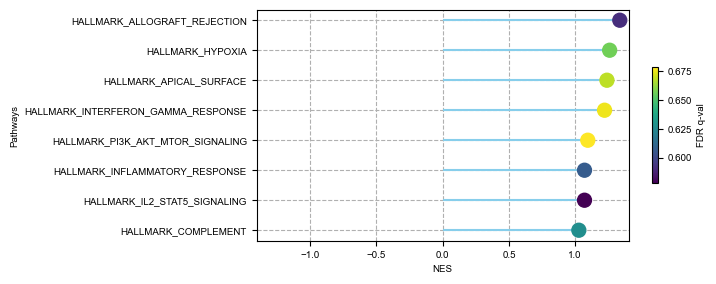

In [92]:
gsea_dotplot(ordered_df_hm_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/all_apc__mono_vs_kup_top_pathway_hm_filtered.pdf') #


(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

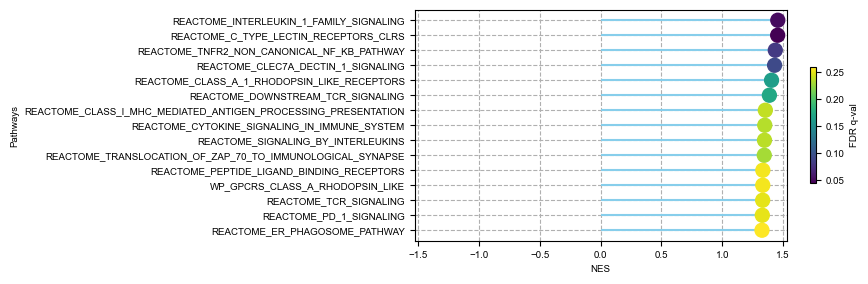

In [93]:
gsea_dotplot(ordered_df_cp_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/all_apc_mono_vs_kup_top_pathway_cp_filtered.pdf') #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

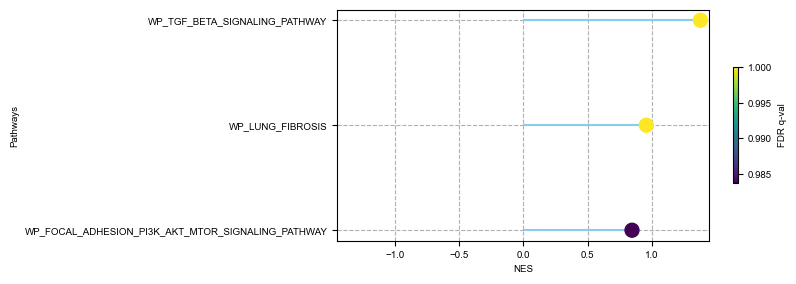

In [ ]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Spp')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7 
             ) #

#### enrichment score

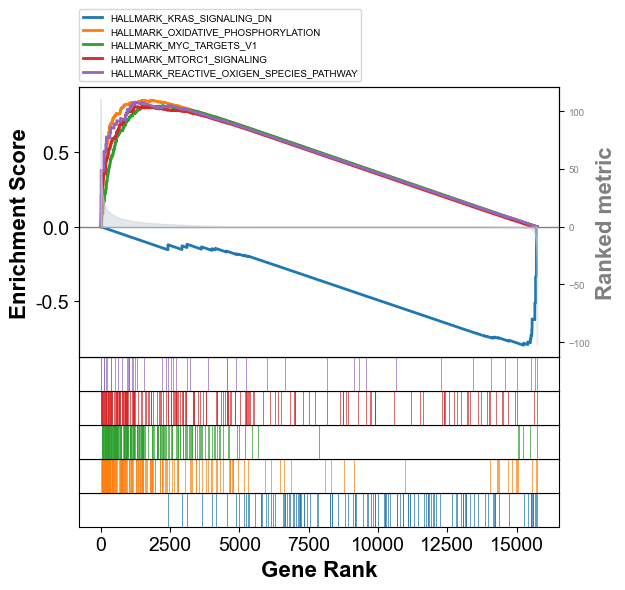

In [ ]:
axs = pre_res_hm.plot(terms=pre_res_hm.res2d.Term[0:5],                   
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )

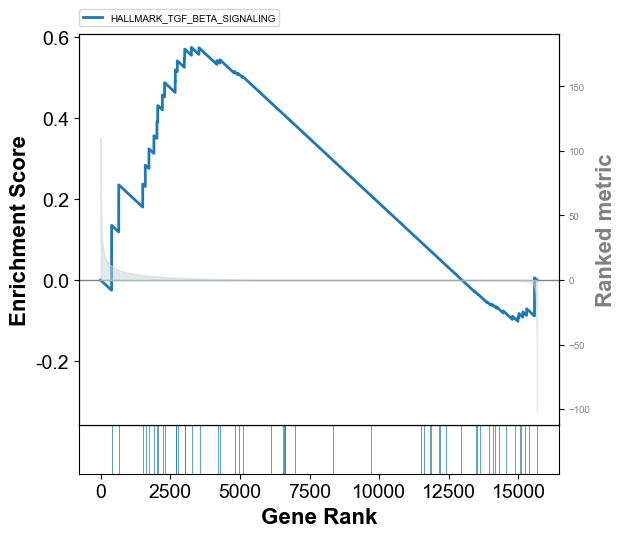

In [ ]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Ifn')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

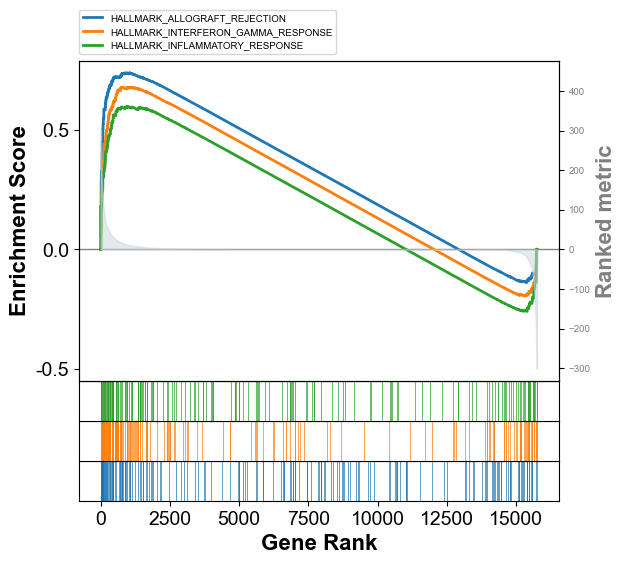

In [94]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

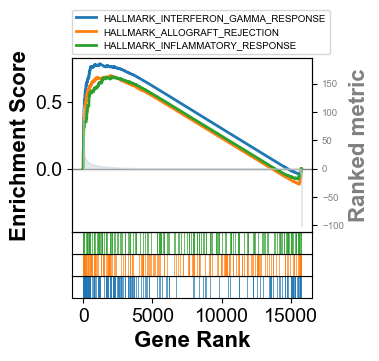

In [ ]:
terms = pre_res_hm.res2d.Term
indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
#plt.savefig('figures/gsea_plot_cd40_hm.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

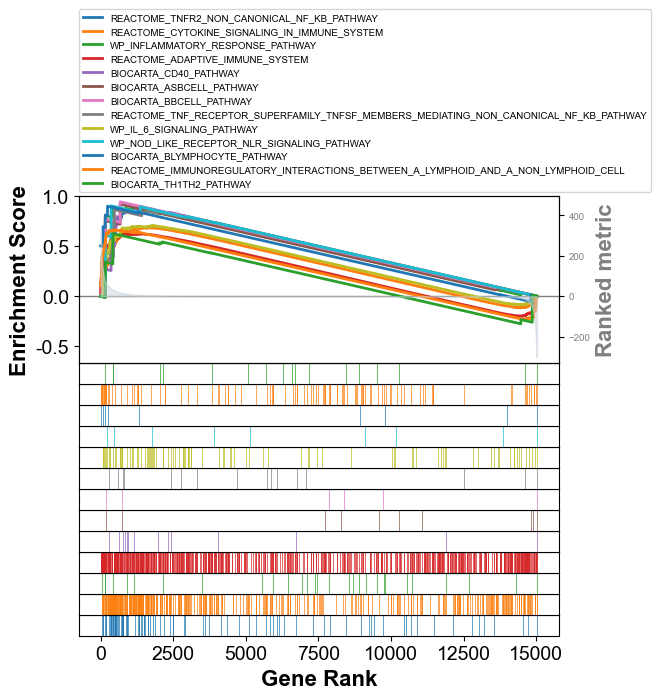

In [95]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

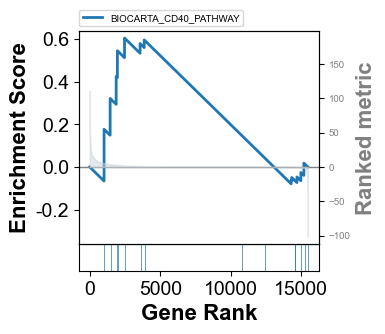

In [ ]:
terms = pre_res_bioc.res2d.Term
indices = terms[pre_res_bioc.res2d['Term'].str.contains('CD40')].index.tolist()
#print(cd40_indices)
plt.rcParams.update({'font.size': 7})

axs = pre_res_bioc.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
#plt.savefig('figures/gsea_plot_cd40.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

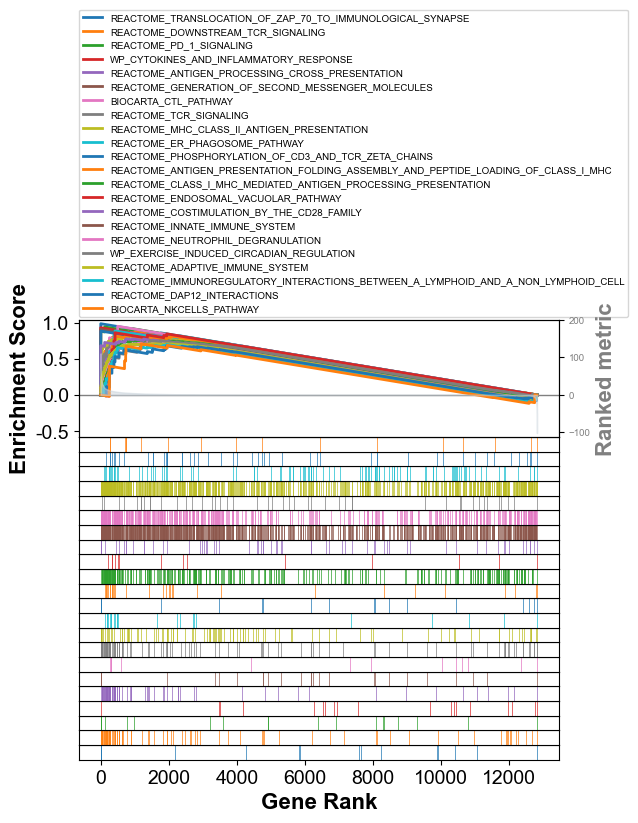

In [ ]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

## DEG all mac

In [ ]:
adata = sc.read_h5ad('intermediate/12_anno_v2_adata_mac.h5ad')

### 2KO vs rest

In [14]:
sc.tl.rank_genes_groups(adata, groupby = 'genotype', groups=['2KO'], reference='rest', method='wilcoxon', key_added='2KO_wilcoxon')

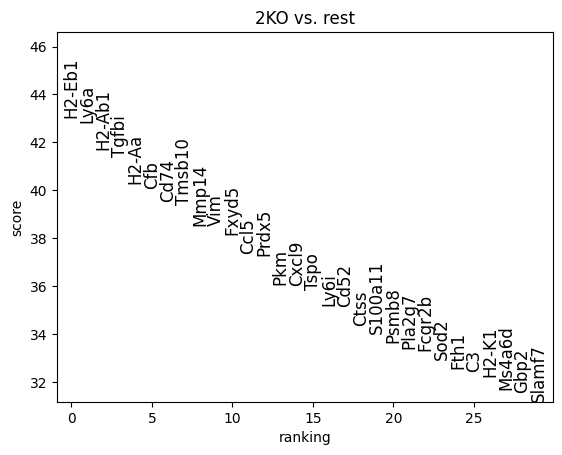

In [15]:
sc.pl.rank_genes_groups(adata, key='2KO_wilcoxon', n_genes=30, fontsize=12)

#### save DEG 

In [16]:
pval_threshold = 0.05

# Open an Excel writer
with pd.ExcelWriter('DEG/rank_genes_groups_mac_2KO_rest.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata.uns['2KO_wilcoxon']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata.uns['2KO_wilcoxon'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

#### volcano

In [17]:
# Extract DEG results for '2KO' group
genes = adata.uns['2KO_wilcoxon']['names']['2KO']
logfoldchanges = adata.uns['2KO_wilcoxon']['logfoldchanges']['2KO']
pvals = adata.uns['2KO_wilcoxon']['pvals']['2KO']
pvals_adj = adata.uns['2KO_wilcoxon']['pvals_adj']['2KO']

# Create a DataFrame
DEG_2KO_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
})

# Display the DataFrame
DEG_2KO_df.head()

,genes,logfoldchanges,pvals,pvals_adj
0,H2-Eb1,3.547386,0.0,0.0
1,Ly6a,3.703930,0.0,0.0
2,H2-Ab1,3.226042,0.0,0.0
3,Tgfbi,3.265362,0.0,0.0
4,H2-Aa,3.133663,0.0,0.0


In [24]:
groups = ['2KO']
de_results = {}
for group in groups:
    genes = adata.uns['2KO_wilcoxon']['names'][group]
    logfoldchanges = adata.uns['2KO_wilcoxon']['logfoldchanges'][group]
    pvals = adata.uns['2KO_wilcoxon']['pvals'][group]
    pvals_adj = adata.uns['2KO_wilcoxon']['pvals_adj'][group]
    de_results[group] = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
    })

# Now, de_results['condition_A'] contains the DEGs for condition_A
de_results['2KO'].head()

,genes,logfoldchanges,pvals,pvals_adj
0,H2-Eb1,3.547386,0.0,0.0
1,Ly6a,3.703930,0.0,0.0
2,H2-Ab1,3.226042,0.0,0.0
3,Tgfbi,3.265362,0.0,0.0
4,H2-Aa,3.133663,0.0,0.0


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


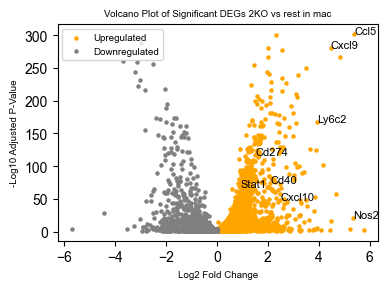

In [29]:
df_DEG = pd.DataFrame({
    'logfoldchanges':DEG_2KO_df['logfoldchanges'],
    'pvals_adj': DEG_2KO_df['pvals_adj']
})

df_DEG.index = de_results['2KO']['genes']

# Extract logfoldchanges and adjusted p-values
logfoldchanges = df_DEG['logfoldchanges']
pvals_adj = df_DEG['pvals_adj']

# Calculate the negative logarithm for adjusted p-values
neg_log_pvals_adj = -np.log10(pvals_adj)

# Filter for significant genes (e.g., pvals_adj < 0.05)
significant_mask = (pvals_adj < 0.05)
significant_logfoldchanges = logfoldchanges[significant_mask]
significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

# Separate upregulated and downregulated genes
upregulated = significant_logfoldchanges > 0
downregulated = significant_logfoldchanges < 0

# Set global font settings
plt.rcParams['font.size'] = 10
plt.rcParams['font.family'] = 'Arial'

# Set up the figure and axis with the new figure size
fig, ax = plt.subplots(figsize=(4, 3))

# Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
# Scatter plot the genes based on their regulation direction
ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='orange', s=5, label='Upregulated')
ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='grey', s=5, label='Downregulated')

# Titles, labels, and other customizations with updated fontsize and font
ax.set_title("Volcano Plot of Significant DEGs 2KO vs rest in mac", fontsize=7)
ax.set_xlabel("Log2 Fold Change", fontsize=7)
ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
ax.tick_params(axis='both', which='major', labelsize=10)
ax.grid(False)
ax.legend(loc='upper left', fontsize=7)

'''genes_to_label = significant_logfoldchanges[
    ((np.abs(significant_logfoldchanges) > 2) & 
     (significant_neg_log_pvals_adj > 150)) |
    (np.abs(significant_logfoldchanges) > 4)
].index.tolist()  # Convert the index to a list'''

# Add your genes of interest
genes_of_interest = ['Cxcl9', 'Cxcl10', 'Ccl5', 'Nos2', 'Ly6c2', 'H2-Ab1', 'Cd74', 'Cd40', 'Cd274', 'Stat1']
#genes_to_label = genes_to_label + genes_of_interest
genes_to_label = genes_of_interest

# Annotate specific genes with updated fontsize
for gene in genes_to_label:
    if gene in significant_logfoldchanges and gene in significant_neg_log_pvals_adj:
        x = significant_logfoldchanges[gene]
        y = significant_neg_log_pvals_adj[gene]
        ax.annotate(gene, (x, y), fontsize=8, arrowprops=None)


# Display the plot
plt.tight_layout()
plt.savefig("figures/mac_2KO_DEG_volcano.pdf", dpi=150, format='pdf', bbox_inches='tight')
plt.show()

### prepare gsea_df

In [47]:
input_df = pd.read_csv("features/mac_2KO_DEG.csv")
df_gsea = input_df[['genes', 'logfoldchanges', 'pvals_adj']]
# we change the 0 in pvals_adj to the minimum non-zero value
non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
# then multiply by the sign of the log fold change to get the 'score'
df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
# sort
df_gsea = df_gsea.sort_values(by='score', ascending=False)
df_gsea

,genes,logfoldchanges,pvals_adj,pvals_adj_updated,-log10(pvals_adj),score
0,H2-Eb1,3.585922,0.000000e+00,1.079217e-301,300.966891,300.966891
1,Ly6a,3.721405,0.000000e+00,1.079217e-301,300.966891,300.966891
2,H2-Ab1,3.264471,0.000000e+00,1.079217e-301,300.966891,300.966891
3,Tgfbi,3.277110,0.000000e+00,1.079217e-301,300.966891,300.966891
4,H2-Aa,3.166995,0.000000e+00,1.079217e-301,300.966891,300.966891
...,...,...,...,...,...,...
15750,Mrc1,-2.541641,4.114767e-257,4.114767e-257,256.385655,-256.385655
15751,Fcna,-3.686709,5.869149e-258,5.869149e-258,257.231425,-257.231425
15752,Hpgd,-3.161262,2.644320e-258,2.644320e-258,257.577686,-257.577686
15753,Slc40a1,-2.997635,3.138186e-287,3.138186e-287,286.503321,-286.503321


In [48]:
prerank_input = df_gsea.set_index('genes')['score'].to_frame()
prerank_input

,score
genes,
H2-Eb1,300.966891
Ly6a,300.966891
H2-Ab1,300.966891
Tgfbi,300.966891
H2-Aa,300.966891
...,...
Mrc1,-256.385655
Fcna,-257.231425
Hpgd,-257.577686


### read in database

In [79]:
df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
df_set_hm

,1,2,3,4,5,6,7,8,9,10,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN
HALLMARK_APICAL_SURFACE,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Adam10,Adipor2,Afap1l2,Akap7,App,Atp6v0a4,Atp8b1,B4galt1,Brca1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APOPTOSIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Add1,Aifm3,Ank,Anxa1,App,Atf3,Avpr1a,Bax,Bcap31,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_BILE_ACID_METABOLISM,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca1,Abca2,Abca3,Abca4,Abca5,Abca6,Abca8b,Abca9,Abcd1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_CHOLESTEROL_HOMEOSTASIS,https://www.gsea-msigdb.org/gsea/msigdb/mouse/...,Abca2,Acat2,Acss2,Actg1,Adh4,Alcam,Aldoc,Antxr2,Anxa5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [50]:
del df_set_hm[1]
df_set_hm.head()

,2,3,4,5,6,7,8,9,10,11,...,192,193,194,195,196,197,198,199,200,201
0,,,,,,,,,,,,,,,,,,,,,
HALLMARK_ADIPOGENESIS,Abca1,Abcb8,Acaa2,Acadl,Acadm,Acads,Acly,Aco2,Acox1,Adcy6,...,Ubc,Ubqln1,Uck1,Ucp2,Uqcr10,Uqcr11,Uqcrc1,Uqcrq,Vegfb,Ywhag
HALLMARK_ALLOGRAFT_REJECTION,Aars,Abce1,Abi1,Ache,Acvr2a,Akt1,Apbb1,B2m,Bcat1,Bcl10,...,Was,Zap70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANDROGEN_RESPONSE,Abcc4,Abhd2,Acsl3,Actn1,Adamts1,Adrm1,Akap12,Akt1,Aldh1a3,Ank,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_ANGIOGENESIS,Apoh,App,Ccnd2,Col3a1,Col5a2,Cxcl5,Fgfr1,Fstl1,Itgav,Jag1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HALLMARK_APICAL_JUNCTION,Acta1,Actb,Actc1,Actg1,Actg2,Actn1,Actn2,Actn3,Actn4,Adam15,...,Vav2,Vcam1,Vcan,Vcl,Vwf,Wasl,Wnk4,Ywhah,Zyx,NaN


In [51]:
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [59]:
path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp


{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [61]:
path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

### run GSEA

In [54]:
pre_res_hm = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_hm,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_mac_2KO_gsea_hm', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-04-18 18:32:37,243 [WARNING] Duplicated values found in preranked stats: 46.93% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-18 18:32:37,248 [INFO] Parsing data files for GSEA.............................
2024-04-18 18:32:37,256 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-18 18:32:37,265 [INFO] 0050 gene_sets used for further statistical testing.....


2024-04-18 18:32:37,267 [INFO] Start to run GSEA...Might take a while..................
2024-04-18 18:33:18,805 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-18 18:33:18,806 [INFO] Congratulations. GSEApy runs successfully................



In [55]:
pre_res_cp = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_cp,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_mac_2KO_gsea_cp', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-04-18 18:33:18,865 [WARNING] Duplicated values found in preranked stats: 46.93% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-18 18:33:18,866 [INFO] Parsing data files for GSEA.............................
2024-04-18 18:33:18,907 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-18 18:33:18,910 [INFO] 1628 gene_sets used for further statistical testing.....


2024-04-18 18:33:18,912 [INFO] Start to run GSEA...Might take a while..................
2024-04-18 18:35:26,399 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-18 18:35:26,400 [INFO] Congratulations. GSEApy runs successfully................



In [56]:
pre_res_bioc = gseapy.prerank(rnk=prerank_input,
                     gene_sets=df_set_dict_bioc,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='features/all_mac_2KO_gsea_bioc', 
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )

2024-04-18 18:35:27,211 [WARNING] Duplicated values found in preranked stats: 46.93% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-18 18:35:27,212 [INFO] Parsing data files for GSEA.............................
2024-04-18 18:35:27,218 [INFO] 0006 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-18 18:35:27,219 [INFO] 0246 gene_sets used for further statistical testing.....


2024-04-18 18:35:27,220 [INFO] Start to run GSEA...Might take a while..................
2024-04-18 18:35:47,835 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-18 18:35:47,835 [INFO] Congratulations. GSEApy runs successfully................



In [103]:
pre_res_hm.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.797348,-1.760604,0.0,0.0,0.0,8/120,2.55%,Selenop;Ptprj;Thrb;Camk1d;Cpeb3;Prkn;Gprc5c;Sl...
1,prerank,HALLMARK_OXIDATIVE_PHOSPHORYLATION,0.828319,1.38257,0.0,0.002766,0.003,96/193,9.74%,Atp6v0c;Ldha;Cox8a;Cox6b1;Cox5b;Gpi1;Sdhb;Cox4...
2,prerank,HALLMARK_INTERFERON_GAMMA_RESPONSE,0.821584,1.362209,0.0,0.011985,0.025,84/181,7.47%,Cd74;Cfb;H2-Aa;Ccl5;Cxcl9;Psmb8;Sod2;Slamf7;Ps...
3,prerank,HALLMARK_UV_RESPONSE_DN,-0.582605,-1.34774,0.015385,0.158428,0.142857,18/141,3.36%,Ptprm;Dab2;Atxn1;Dlc1;Rxra;Runx1;Vav2;Pten;Prk...
4,prerank,HALLMARK_MYC_TARGETS_V1,0.793666,1.309847,0.006192,0.070988,0.197,83/181,13.68%,Ldha;Pgk1;Psmb3;Psmb2;Psma2;Psmd8;Ppia;Psma4;P...
5,prerank,HALLMARK_MTORC1_SIGNALING,0.782497,1.304367,0.004158,0.065917,0.239,67/192,11.03%,Aldoa;Coro1a;Tpi1;Ifi30;Ldha;Pnp;Pgk1;Itgb2;Gl...
6,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.78839,1.303074,0.005203,0.055499,0.25,44/179,6.16%,Cd74;H2-Aa;Ccl5;Cxcl9;Ctss;Fcgr2b;Capg;Il2rg;H...
7,prerank,HALLMARK_HYPOXIA,0.773173,1.278944,0.011411,0.109247,0.491,40/184,7.95%,Tgfbi;Prdx5;Aldoa;Tpi1;Mif;Sdc4;Ldha;Pgk1;Glrx...
8,prerank,HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY,0.845119,1.270386,0.021226,0.124327,0.593,17/48,6.38%,Sod2;Glrx;Atox1;Txn1;Pfkp;Lsp1;Junb;Prdx6;Prdx...
9,prerank,HALLMARK_DNA_REPAIR,0.771918,1.260491,0.024262,0.1467,0.713,50/146,15.44%,Pnp;Aprt;Taf10;Nt5c;Edf1;Pold4;Hcls1;Vps28;Aly...


In [104]:
pre_res_cp.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,WP_RETINOL_METABOLISM,-0.907493,-1.646194,0.006944,0.080431,0.061,7/33,4.42%,Lpl;Rxra;Sult1a1;Scarb1;Dhrs3;Adh1;Rara
1,prerank,WP_GPCRS_CLASS_B_SECRETIN_LIKE,-0.989964,-1.559042,0.005618,0.409842,0.408,3/17,0.48%,Adgrl3;Adgre5;Adgre1
2,prerank,REACTOME_PREDNISONE_ADME,-0.942703,-1.543113,0.013245,0.387566,0.519,1/16,1.26%,Alb
3,prerank,REACTOME_RECYCLING_OF_BILE_ACIDS_AND_SALTS,-0.965591,-1.540248,0.018405,0.313739,0.537,3/15,1.26%,Abcc3;Rxra;Alb
4,prerank,BIOCARTA_NUCLEARRS_PATHWAY,-0.862286,-1.534703,0.013333,0.281035,0.571,3/29,2.09%,Abca1;Abcc3;Nr1h3
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,BIOCARTA_TEL_PATHWAY,0.340441,0.473908,0.992849,0.998013,1.0,5/17,19.90%,Ppp2ca;Tnks;Rb1;Trp53;Akt1
1624,prerank,REACTOME_YAP1_AND_WWTR1_TAZ_STIMULATED_GENE_EX...,-0.342329,-0.470974,0.968468,0.994717,1.0,7/7,100.00%,Tead4;Wwtr1;Yap1;Tead1;Tead2;Tead3;Kat2b
1625,prerank,REACTOME_TRANSPORT_OF_NUCLEOTIDE_SUGARS,0.339839,0.450595,0.997506,0.998794,1.0,2/9,24.85%,Slc35c1;Slc35b3
1626,prerank,WP_NON_HOMOLOGOUS_END_JOINING,-0.294046,-0.410357,1.0,0.99887,1.0,1/7,8.73%,Rad50


In [105]:
pre_res_bioc.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_NUCLEARRS_PATHWAY,-0.862286,-1.534703,0.013333,0.228414,0.137,3/29,2.09%,Abca1;Abcc3;Nr1h3
1,prerank,BIOCARTA_INTRINSIC_PATHWAY,0.985569,1.376398,0.0,0.008583,0.009,1/22,0.57%,F10
2,prerank,BIOCARTA_CTLA4_PATHWAY,-0.863272,-1.369305,0.08284,1.0,0.852,3/16,3.25%,Pik3r1;Cd86;Icos
3,prerank,BIOCARTA_SRCRPTP_PATHWAY,-0.923251,-1.36468,0.080808,1.0,0.872,2/10,1.52%,Prkcb;Prkca
4,prerank,BIOCARTA_BARRESTIN_PATHWAY,-0.918775,-1.35184,0.121693,1.0,0.897,3/10,1.83%,Gnas;Kcna2;Grk2
...,...,...,...,...,...,...,...,...,...,...
241,prerank,BIOCARTA_MCM_PATHWAY,0.377148,0.515884,0.987775,1.0,1.0,4/13,27.08%,Cdkn1b;Orc2;Orc6;Mcm4
242,prerank,BIOCARTA_AKAP95_PATHWAY,0.3789,0.504181,0.986198,1.0,1.0,2/10,20.22%,Ppp2ca;Akap8
243,prerank,BIOCARTA_ERBB3_PATHWAY,0.373057,0.487947,0.98929,1.0,1.0,1/6,20.65%,Nrg1
244,prerank,BIOCARTA_PRC2_PATHWAY,0.35211,0.475744,0.99388,1.0,1.0,2/10,16.93%,Rbbp7;Yy1


In [41]:
df_bioc = pre_res_bioc.res2d[pre_res_bioc.res2d['FDR q-val'] <= 0.9]
ordered_df_bioc = df_bioc.sort_values(by='NES')
ordered_df_bioc
# not so useful

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,BIOCARTA_NUCLEARRS_PATHWAY,-0.862286,-1.534703,0.013333,0.228414,0.137,3/29,2.09%,Abca1;Abcc3;Nr1h3
6,prerank,BIOCARTA_ERYTH_PATHWAY,-0.928011,-1.339921,0.069892,0.861085,0.919,2/11,2.16%,Igf1;Il1a
7,prerank,BIOCARTA_EEA1_PATHWAY,-0.967448,-1.332653,0.048387,0.800226,0.939,2/6,1.54%,Trf;Tfrc
8,prerank,BIOCARTA_AMAN_PATHWAY,-0.936772,-1.323716,0.126761,0.773164,0.951,2/8,1.05%,St3gal4;Man2b1
21,prerank,BIOCARTA_CBL_PATHWAY,-0.840232,-1.231544,0.227979,0.887846,0.996,4/11,2.55%,Csf1r;Prkcb;Prkca;Sh3glb1
25,prerank,BIOCARTA_IL17_PATHWAY,-0.850746,-1.221652,0.276382,0.875225,0.998,3/10,14.94%,Il6;Cd4;Kitl
30,prerank,BIOCARTA_ACETAMINOPHEN_PATHWAY,-0.866177,-1.203638,0.284404,0.899985,0.999,1/6,0.23%,Ptgs1
33,prerank,BIOCARTA_STEM_PATHWAY,-0.852026,-1.198831,0.307692,0.869794,0.999,2/9,14.81%,Il6;Cd4
34,prerank,BIOCARTA_VOBESITY_PATHWAY,-0.850268,-1.198807,0.295455,0.821673,0.999,3/7,3.29%,Lpl;Rxra;Nr3c1
40,prerank,BIOCARTA_AGPCR_PATHWAY,-0.824487,-1.181409,0.325581,0.851067,0.999,3/10,1.52%,Gnas;Prkcb;Prkca


In [54]:
df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.1]
ordered_df_cp = df_cp.sort_values(by='NES')
ordered_df_cp

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,WP_RETINOL_METABOLISM,-0.907493,-1.646194,0.006944,0.080431,0.061,7/33,4.42%,Lpl;Rxra;Sult1a1;Scarb1;Dhrs3;Adh1;Rara
138,prerank,REACTOME_CLASS_I_MHC_MEDIATED_ANTIGEN_PROCESSI...,0.76983,1.30631,0.003033,0.096777,0.991,82/325,8.84%,Psmb8;H2-K1;Cyba;Psme2;H2-Q7;Ubb;Tap1;B2m;Psmb...
136,prerank,REACTOME_MHC_CLASS_II_ANTIGEN_PRESENTATION,0.82489,1.308071,0.006424,0.09054,0.989,28/105,8.89%,H2-Eb1;Cd74;H2-Aa;H2-Ab1;Ctss;H2-DMb1;Ifi30;H2...
135,prerank,REACTOME_ANTIGEN_PROCESSING_CROSS_PRESENTATION,0.840454,1.310901,0.005656,0.080974,0.982,49/78,7.09%,Psmb8;H2-K1;Cyba;Psme2;H2-Q7;Tap1;B2m;Psmb10;N...
134,prerank,WP_TYPE_II_INTERFERON_SIGNALING_IFNG,0.910213,1.316138,0.001192,0.064495,0.965,17/30,5.95%,Cxcl9;Tap1;Isg15;Socs3;Cybb;Psmb9;Ciita;Stat1;...
...,...,...,...,...,...,...,...,...,...,...
22,prerank,REACTOME_HEDGEHOG_ON_STATE,0.878596,1.396932,0.0,0.005208,0.025,35/76,7.09%,Psmb8;Psme2;Ubb;Psmb10;Psmb6;Psmb3;Psme1;Psmb2...
21,prerank,REACTOME_TRANSCRIPTIONAL_REGULATION_BY_RUNX1,0.855341,1.397962,0.0,0.006028,0.023,42/125,7.18%,Psmb8;Psme2;Ubb;Psmb10;H3f3a;Psmb6;H3f3b;Psmb3...
19,prerank,REACTOME_G2_M_CHECKPOINTS,0.860113,1.401441,0.0,0.006752,0.02,36/128,7.09%,Psmb8;Psme2;Ubb;Psmb10;Psmb6;Psmb3;Psme1;Psmb2...
16,prerank,REACTOME_TNFR2_NON_CANONICAL_NF_KB_PATHWAY,0.883104,1.408304,0.0,0.003376,0.007,47/91,8.84%,Psmb8;Psme2;Ubb;Psmb10;Psmb6;Psmb3;Psme1;Psmb2...


In [55]:
# df_cp = pre_res_cp.res2d[pre_res_cp.res2d['FDR q-val'] <= 0.1]
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp']
mask2 = ordered_df_cp['Lead_genes'].str.contains('|'.join(keywords)) 
ordered_df_cp_filtered = ordered_df_cp[mask2]
ordered_df_cp_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
138,prerank,REACTOME_CLASS_I_MHC_MEDIATED_ANTIGEN_PROCESSI...,0.76983,1.30631,0.003033,0.096777,0.991,82/325,8.84%,Psmb8;H2-K1;Cyba;Psme2;H2-Q7;Ubb;Tap1;B2m;Psmb...
136,prerank,REACTOME_MHC_CLASS_II_ANTIGEN_PRESENTATION,0.82489,1.308071,0.006424,0.09054,0.989,28/105,8.89%,H2-Eb1;Cd74;H2-Aa;H2-Ab1;Ctss;H2-DMb1;Ifi30;H2...
135,prerank,REACTOME_ANTIGEN_PROCESSING_CROSS_PRESENTATION,0.840454,1.310901,0.005656,0.080974,0.982,49/78,7.09%,Psmb8;H2-K1;Cyba;Psme2;H2-Q7;Tap1;B2m;Psmb10;N...
134,prerank,WP_TYPE_II_INTERFERON_SIGNALING_IFNG,0.910213,1.316138,0.001192,0.064495,0.965,17/30,5.95%,Cxcl9;Tap1;Isg15;Socs3;Cybb;Psmb9;Ciita;Stat1;...
128,prerank,REACTOME_PD_1_SIGNALING,0.950719,1.322415,0.003676,0.050204,0.937,5/19,3.49%,H2-Eb1;H2-Aa;H2-Ab1;Cd274;Ptpn6
118,prerank,REACTOME_TCR_SIGNALING,0.827625,1.328334,0.003233,0.038516,0.869,42/106,7.09%,H2-Eb1;H2-Aa;H2-Ab1;Psmb8;Psme2;Ubb;Psmb10;Psm...
106,prerank,REACTOME_SIGNALING_BY_INTERLEUKINS,0.798668,1.337093,0.001022,0.025413,0.743,71/232,7.29%,Psmb8;Psme2;Il2rg;Ubb;N4bp1;Psmb10;Psmb6;Socs3...
98,prerank,REACTOME_CLASS_A_1_RHODOPSIN_LIKE_RECEPTORS,0.81277,1.339951,0.003115,0.023684,0.692,23/156,8.98%,Ccl5;Cxcl9;C3;Psap;Cxcl16;Ptafr;Gpr132;C5ar1;C...
90,prerank,REACTOME_PEPTIDE_LIGAND_BINDING_RECEPTORS,0.854592,1.346925,0.001091,0.017632,0.554,10/85,2.95%,Ccl5;Cxcl9;C3;Psap;Cxcl16;C5ar1;Cxcl10;Fpr2;Cc...
74,prerank,REACTOME_G_ALPHA_I_SIGNALLING_EVENTS,0.818662,1.353281,0.002055,0.014488,0.428,29/175,8.98%,Ccl5;Cxcl9;C3;Psap;Cxcl16;Ccr1;Gng12;Ppp1ca;C5...


In [56]:
df_hm = pre_res_hm.res2d[pre_res_hm.res2d['FDR q-val'] <= 0.2]
ordered_df_hm = df_hm.sort_values(by='NES') # need to use ascending for later plot gsea function
ordered_df_hm

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,HALLMARK_KRAS_SIGNALING_DN,-0.797348,-1.760604,0.0,0.0,0.0,8/120,2.55%,Selenop;Ptprj;Thrb;Camk1d;Cpeb3;Prkn;Gprc5c;Sl...
3,prerank,HALLMARK_UV_RESPONSE_DN,-0.582605,-1.34774,0.015385,0.158428,0.142857,18/141,3.36%,Ptprm;Dab2;Atxn1;Dlc1;Rxra;Runx1;Vav2;Pten;Prk...
16,prerank,HALLMARK_INFLAMMATORY_RESPONSE,0.7455,1.223169,0.056075,0.193602,0.946,49/176,8.11%,Mmp14;Ccl5;Cxcl9;Sema4d;Emp3;Plaur;Cybb;Tapbp;...
15,prerank,HALLMARK_IL6_JAK_STAT3_SIGNALING,0.781686,1.225713,0.079121,0.197027,0.939,33/80,8.59%,Cxcl9;Il2rg;Socs3;Ccr1;Stat1;Crlf2;Tnfrsf1b;Il...
13,prerank,HALLMARK_UV_RESPONSE_UP,0.761137,1.23685,0.043057,0.180849,0.888,34/141,7.65%,Mmp14;Sod2;Aldoa;Tap1;Btg1;Ppt1;Grina;Alas1;Se...
12,prerank,HALLMARK_INTERFERON_ALPHA_RESPONSE,0.801967,1.255328,0.028322,0.122615,0.751,33/88,6.93%,Cd74;Psmb8;Psme2;Ifi30;Tap1;B2m;Isg15;Psme1;Ps...
11,prerank,HALLMARK_CHOLESTEROL_HOMEOSTASIS,0.814642,1.258564,0.023411,0.123629,0.729,20/70,8.06%,S100a11;Lgals3;Cxcl16;Plaur;Anxa5;Actg1;Fabp5;...
10,prerank,HALLMARK_COMPLEMENT,0.758836,1.258816,0.022798,0.136034,0.728,39/181,6.63%,Mmp14;Cfb;Ccl5;Ctss;Pla2g7;C3;Lgals3;Fcer1g;Ms...
9,prerank,HALLMARK_DNA_REPAIR,0.771918,1.260491,0.024262,0.1467,0.713,50/146,15.44%,Pnp;Aprt;Taf10;Nt5c;Edf1;Pold4;Hcls1;Vps28;Aly...
8,prerank,HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY,0.845119,1.270386,0.021226,0.124327,0.593,17/48,6.38%,Sod2;Glrx;Atox1;Txn1;Pfkp;Lsp1;Junb;Prdx6;Prdx...


In [120]:
pre_res_hm.res2d[pre_res_hm.res2d['Lead_genes'].str.contains('Nos')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
6,prerank,HALLMARK_ALLOGRAFT_REJECTION,0.78839,1.303074,0.005203,0.055499,0.25,44/179,6.16%,Cd74;H2-Aa;Ccl5;Cxcl9;Ctss;Fcgr2b;Capg;Il2rg;H...


In [121]:
pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Nos')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
134,prerank,WP_TYPE_II_INTERFERON_SIGNALING_IFNG,0.910213,1.316138,0.001192,0.064495,0.965,17/30,5.95%,Cxcl9;Tap1;Isg15;Socs3;Cybb;Psmb9;Ciita;Stat1;...
167,prerank,REACTOME_INNATE_IMMUNE_SYSTEM,0.747042,1.275901,0.0,0.244865,1.0,220/836,7.09%,Cfb;Pkm;Ctss;S100a11;Psmb8;Fcgr2b;Fth1;C3;H2-K...
186,prerank,WP_FIBRIN_COMPLEMENT_RECEPTOR_3_SIGNALING_PATHWAY,0.84987,1.266217,0.043981,0.294303,1.0,15/42,10.78%,Fcer1g;Itgb2;Itgam;Myd88;Cxcl10;Ikbkb;Tyrobp;C...
254,prerank,REACTOME_ROS_AND_RNS_PRODUCTION_IN_PHAGOCYTES,0.843963,1.228596,0.059929,0.527894,1.0,15/31,11.27%,Cyba;Atp6v0c;Ncf4;Cybb;Atp6v1g1;Atp6v0e;Hvcn1;...
288,prerank,WP_SPINAL_CORD_INJURY,0.781003,1.214887,0.08296,0.586794,1.0,14/82,6.65%,Vim;Fcgr2b;Ccr2;Pirb;Cxcl10;Fkbp1a;Xylt1;Icam1...
404,prerank,BIOCARTA_NO2IL12_PATHWAY,0.857567,1.175077,0.154217,0.711614,1.0,4/15,10.79%,Jak2;Nos2;Ccr5;Il12rb1
565,prerank,REACTOME_PLATELET_HOMEOSTASIS,0.730902,1.130145,0.283582,0.759048,1.0,12/67,7.79%,Gng12;Sri;Fgr;Calm1;Calm3;Ptpn6;Ppp2r1a;Gng10;...
616,prerank,REACTOME_PROTEIN_LOCALIZATION,0.703369,1.114168,0.308628,0.790304,1.0,26/97,17.19%,Ubb;Fis1;Sec61g;Atp5b;Uba52;Ndufb8;Ube2d3;App;...
649,prerank,REACTOME_NITRIC_OXIDE_STIMULATES_GUANYLATE_CYC...,0.810119,1.104436,0.317536,0.80277,1.0,2/12,18.27%,Nos2;Itpr1
720,prerank,REACTOME_METABOLISM_OF_NITRIC_OXIDE_NOS3_ACTIV...,0.780158,1.08184,0.386667,0.841759,1.0,8/15,19.90%,Calm1;Calm3;Calm2;Zdhhc21;Lypla1;Nosip;Spr;Akt1


In [122]:
pre_res_bioc.res2d[pre_res_bioc.res2d['Lead_genes'].str.contains('Nos')]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
44,prerank,BIOCARTA_NO2IL12_PATHWAY,0.857567,1.175077,0.154217,1.0,1.0,4/15,10.79%,Jak2;Nos2;Ccr5;Il12rb1


#### plot top pathways

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

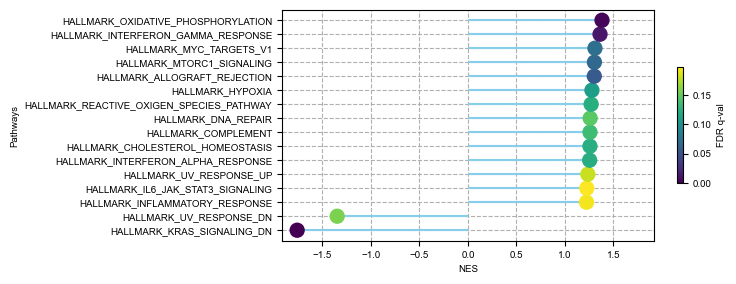

In [57]:
gsea_dotplot(ordered_df_hm, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/mac_2KO_top_pathway_hm.pdf') #


(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

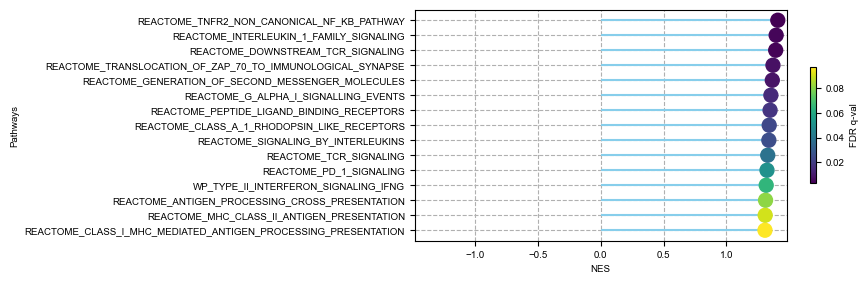

In [58]:
gsea_dotplot(ordered_df_cp_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/mac_2KO_top_pathway_cp_filtered.pdf') #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

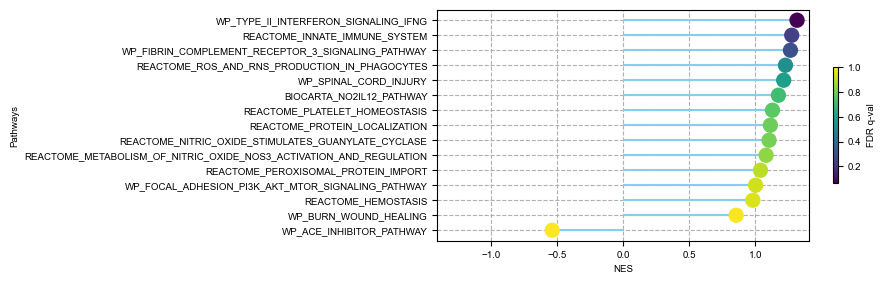

In [59]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Nos')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/mac_2KO_top_pathway_cp_filtered_Nos.pdf'
             ) #

(<Figure size 600x300 with 2 Axes>, <Axes: xlabel='NES', ylabel='Pathways'>)

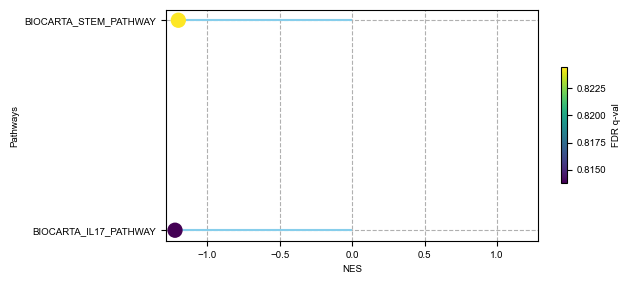

In [137]:
cd40_df = pre_res_cp.res2d[pre_res_cp.res2d['Lead_genes'].str.contains('Il6')].sort_values(by='NES')
gsea_dotplot(cd40_df, 
             xlab = 'NES', 
             ylab = 'Term', 
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7 
             ) #

#### enrichment score

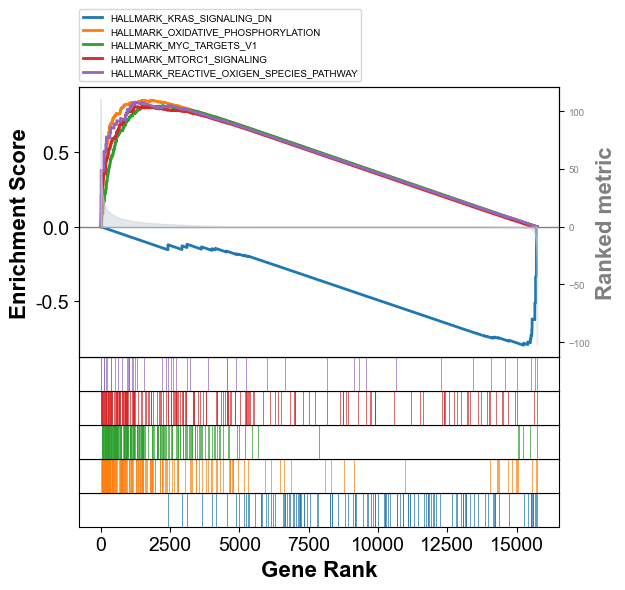

In [ ]:
axs = pre_res_hm.plot(terms=pre_res_hm.res2d.Term[0:5],                   
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )

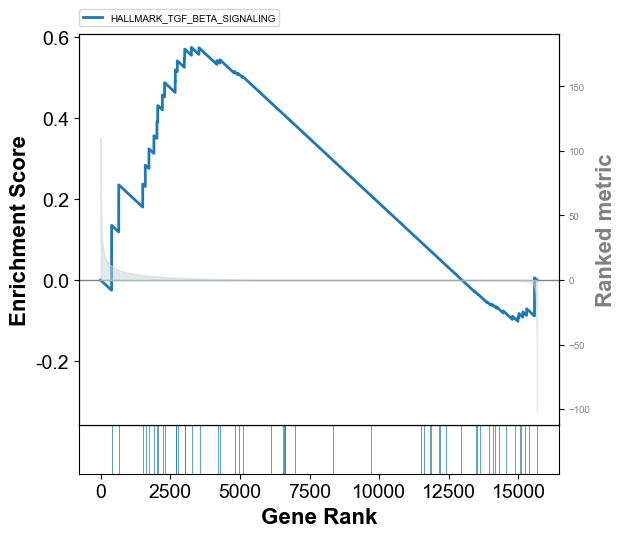

In [ ]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Ifn')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

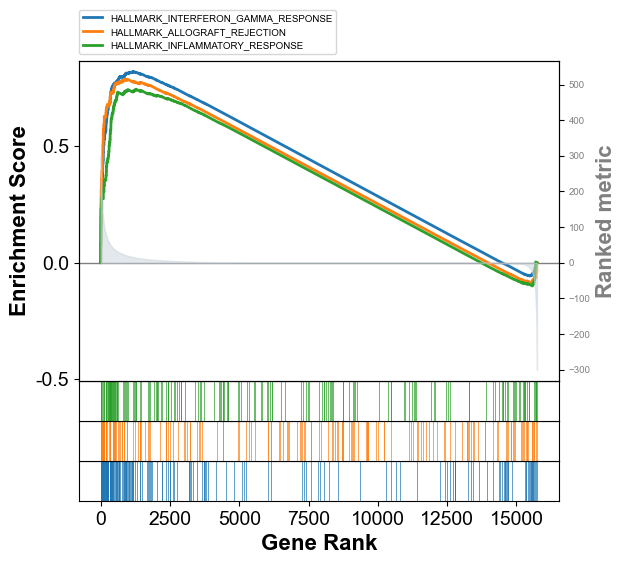

In [131]:
terms = pre_res_hm.res2d.Term
IFN_indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[IFN_indices])

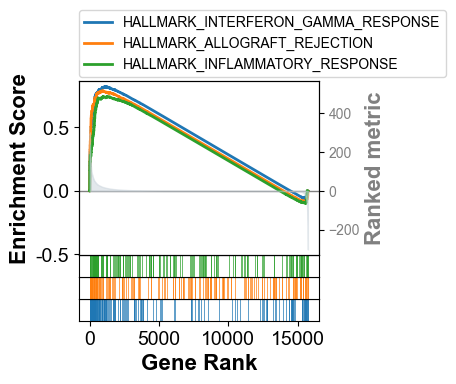

In [60]:
terms = pre_res_hm.res2d.Term
indices = terms[pre_res_hm.res2d['Lead_genes'].str.contains('Cd40')].index.tolist()
#print(cd40_indices)
axs = pre_res_hm.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
plt.savefig('figures/mac_2KO_gsea_plot_cd40_hm.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

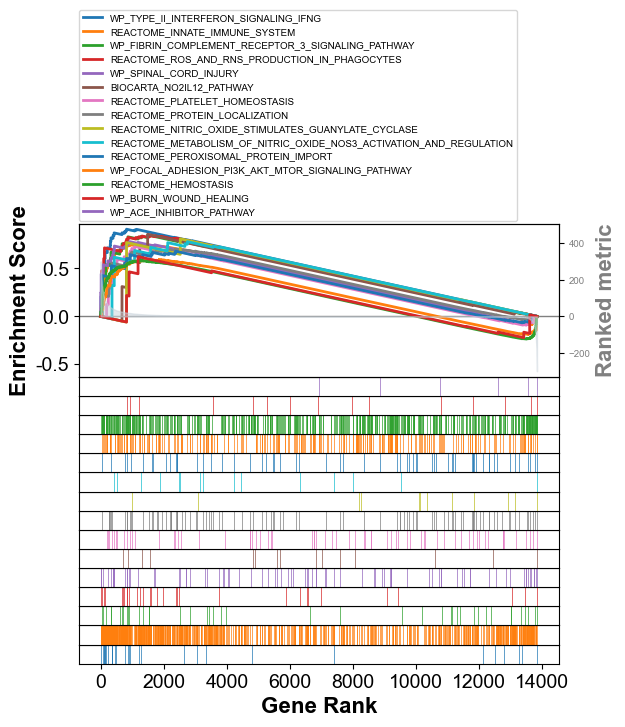

In [134]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('Nos')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

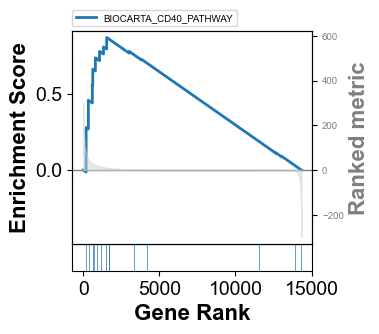

In [61]:
terms = pre_res_bioc.res2d.Term
indices = terms[pre_res_bioc.res2d['Term'].str.contains('CD40')].index.tolist()
#print(cd40_indices)
plt.rcParams.update({'font.size': 7})

axs = pre_res_bioc.plot(terms=terms[indices])

# Adjust figure size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(3, 3)  # Set figure size

# Save the plot
plt.savefig('figures/mac_2KO_gsea_plot_cd40_bioc.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()
plt.close(fig)

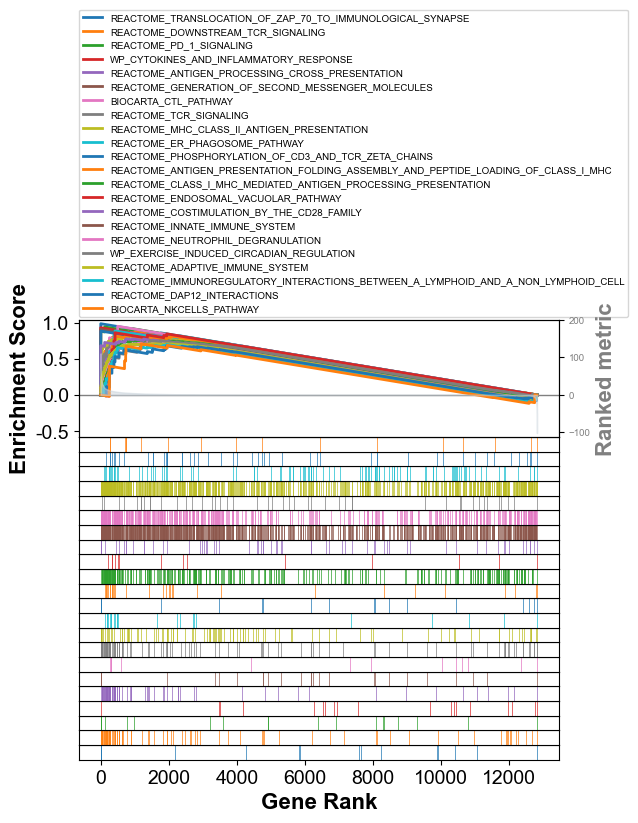

In [ ]:
terms = pre_res_cp.res2d.Term
indices = terms[pre_res_cp.res2d['Lead_genes'].str.contains('H2')].index.tolist()
#print(cd40_indices)
axs = pre_res_cp.plot(terms=terms[indices])

# (final) DEG each cluster across genotype

for each cell_type in adata.obs['cell_type'], and all_mac, and all apc
- do DGE on (2KO vs rest, RII vs WT, PD1 vs WT, 2KO vs RII, 3KO vs 2KO), 
- save as .csv, save sig .xlsx and all .xlsx

pathway analysis
- read in each database, cp, hm
- read in the csv file, prepare the df
- run gsea and save
- save the df that can be used for filtering and plot in csv and xlsx

In [5]:
adata = sc.read_h5ad('intermediate/12_anno_v2_DEG.h5ad')

In [6]:
adata.obs['cell_subtype_v2']. unique()

['Mac_mono', 'Kupffer_cell', 'DC2', 'DC1', 'DC_ccr7']
Categories (5, object): ['DC1', 'DC2', 'DC_ccr7', 'Kupffer_cell', 'Mac_mono']

In [7]:
adata.obs['cell']. unique()

['Mac_mono', 'KC', 'DC']
Categories (3, object): ['DC', 'KC', 'Mac_mono']

### customized functions

In [49]:
wilcoxon_keys = [('2KO', 'rest'), ('RII', 'WT'), ('PD1', 'WT'), ('2KO', 'RII'), ('3KO', '2KO')]
wilcoxon_keys[0][1]
'wilcoxon_' + wilcoxon_keys[0][0] + '_'+ wilcoxon_keys[0][1]

'wilcoxon_2KO_rest'

In [50]:
def export_significant_genes(bdata, filename, pval_threshold, DEG_key):
    """
    Exports significant upregulated and downregulated genes for each group in an analysis to an Excel file.

    Parameters:
    - adata_01_LN: AnnData object containing Wilcoxon test results and other data
    - filename: String, name of the Excel file to save results
    - pval_threshold: Float, p-value threshold to determine significance

    The function assumes 'wilcoxon_01_RII_WT' results are stored in adata_01_LN.uns and structured with keys ['names', 'logfoldchanges', 'pvals_adj'].
    """
    
    # Open an Excel writer
    with pd.ExcelWriter(f'DEG/{filename}.xlsx') as writer:
        # Iterate through each group in the results
        for group in bdata.uns[DEG_key]['names'].dtype.names:
            # For each group, create a DataFrame of results
            data = {key: bdata.uns[DEG_key][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
            df = pd.DataFrame(data)
            
            # Filter genes based on significance
            df_significant = df[df['pvals_adj'] <= pval_threshold]
            
            # Sort by the absolute value of log fold change
            df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
            
            # Split into upregulated and downregulated based on log fold change
            df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
            df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
            
            # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
            df_up = df_up.drop(columns=['abs_logfoldchanges'])
            df_down = df_down.drop(columns=['abs_logfoldchanges'])
            
            # Write to different sheets within the same Excel file
            df_up.to_excel(writer, sheet_name=f'{group}_upregulated_sig', index=False)
            df_down.to_excel(writer, sheet_name=f'{group}_downregulated_sig', index=False)

            # Filter genes based on significance
            df_significant = df[df['pvals_adj'] <= 0.9999]
            
            # Sort by the absolute value of log fold change
            df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
            
            # Split into upregulated and downregulated based on log fold change
            df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
            df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
            
            # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
            df_up = df_up.drop(columns=['abs_logfoldchanges'])
            df_down = df_down.drop(columns=['abs_logfoldchanges'])
            
            # Write to different sheets within the same Excel file
            df_up.to_excel(writer, sheet_name=f'{group}_upregulated_all', index=False)
            df_down.to_excel(writer, sheet_name=f'{group}_downregulated_all', index=False)



In [94]:
def export_pathways (df, filename, threshold, group):
        with pd.ExcelWriter(f'DEG/{filename}_GSEA.xlsx') as writer:
            # Filter genes based on significance
            df_significant = df[df['FDR q-val'] <= threshold]
            
            # Sort by the absolute value of log fold change
            df_significant_sorted = df_significant.assign(abs_NES=abs(df_significant['NES'])).sort_values(by='abs_NES', ascending=False)
            
            # Split into upregulated and downregulated based on log fold change
            df_up = df_significant_sorted[df_significant_sorted['NES'] > 0]
            df_down = df_significant_sorted[df_significant_sorted['NES'] < 0]
            
            # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
            df_up = df_up.drop(columns=['abs_NES'])
            df_down = df_down.drop(columns=['abs_NES'])
            
            # Write to different sheets within the same Excel file
            df_up.to_excel(writer, sheet_name=f'{group}_upregulated_sig{threshold}', index=False)
            df_down.to_excel(writer, sheet_name=f'{group}_downregulated_sig{threshold}', index=False)

            # Filter genes based on significance
            df_significant = df[df['FDR q-val'] <= 1]
            
            # Sort by the absolute value of log fold change
            df_significant_sorted = df_significant.assign(abs_NES=abs(df_significant['NES'])).sort_values(by='abs_NES', ascending=False)
            
            # Split into upregulated and downregulated based on log fold change
            df_up = df_significant_sorted[df_significant_sorted['NES'] > 0]
            df_down = df_significant_sorted[df_significant_sorted['NES'] < 0]
            
            # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
            df_up = df_up.drop(columns=['abs_NES'])
            df_down = df_down.drop(columns=['abs_NES'])
            
            # Write to different sheets within the same Excel file
            df_up.to_excel(writer, sheet_name=f'{group}_upregulated_all', index=False)
            df_down.to_excel(writer, sheet_name=f'{group}_downregulated_all', index=False)

### read in database

In [ ]:
## Hallmark

df_set_hm = pd.read_csv('features/mh.all.v2023.2.Mm.symbols.gmt', 
                     sep = '\t', 
                     header = None, 
                     index_col = 0)
del df_set_hm[1]
# convert into dictionary
df_set_dict_hm = {}
for label in df_set_hm.index:
    df_set_dict_hm[label] = list(df_set_hm.loc[label].values)

In [ ]:
## canonical pathways

path = 'features/m2.cp.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_cp = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_cp[set_name] = genes
df_set_dict_cp

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

In [ ]:
## biocarta

path = 'features/m2.cp.biocarta.v2023.2.Mm.symbols.gmt'
with open(path, 'r') as file:
    lines = file.readlines()

# Parsing each line into a dictionary: {set_name: [genes]}
df_set_dict_bioc = {}
for line in lines:
    parts = line.strip().split('\t')  # Split by tab
    set_name = parts[0]
    genes = parts[2:]  # Assuming the 3rd part onwards are the genes
    df_set_dict_bioc[set_name] = genes
df_set_dict_bioc

{'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACE2_PATHWAY': ['Ace',
  'Ace2',
  'Agt',
  'Agtr2',
  'Agtrap',
  'Cma1',
  'Col4a1',
  'Col4a2',
  'Col4a3',
  'Col4a4',
  'Col4a5',
  'Col4a6',
  'Ren1'],
 'BIOCARTA_ACETAMINOPHEN_PATHWAY': ['Cyp1a2',
  'Cyp2e1',
  'Cyp3a11',
  'Nr1i3',
  'Ptgs1',
  'Ptgs2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_ACTINY_PATHWAY': ['Abi2',
  'Acta1',
  'Nck1',
  'Nckap1',
  'Ntrk1',
  'Psma7',
  'Wasf1',
  'Wasf2',
  'Wasf3',
  'Wasl'],
 'BIOCARTA_AGPCR_PATHWAY': ['Arrb1',
  'Gnas',
  'Grk4',
  'Prkacb',
  'Prkar1a',
  'Prkar1b',
  'Prkar2a',
  'Prkar2b',
  'Prkca',
  'Prkcb'],
 'BIOCARTA_AGR_PATHWAY': ['Acta1',
  'Agrn',
  

## run and export GSEA
Export DEG and run GSEA on Hallmakr and Canonical Pathways

### each cell type
kuppfer, mac_mono, DC1, DC2, DC_Ccr7

In [ ]:
## each cell type
for cell_type in adata.obs['cell_subtype_v2'].unique():
    adata_sub = adata[adata.obs['cell_subtype_v2'] == cell_type]
    for comparison in wilcoxon_keys:
        key = 'wilcoxon_' + cell_type + '_' + comparison[0] + '_'+ comparison[1]
        sc.tl.rank_genes_groups(adata_sub, groupby = 'genotype', groups=[comparison[0]], reference=comparison[1], method='wilcoxon', key_added=key)
        print(key) 
        # Assign the results back to the original AnnData object
        adata.uns[key] = adata_sub.uns[key]

        # Extract DEG results
        genes = adata.uns[key]['names'][comparison[0]]
        logfoldchanges = adata.uns[key]['logfoldchanges'][comparison[0]]
        pvals = adata.uns[key]['pvals'][comparison[0]]
        pvals_adj = adata.uns[key]['pvals_adj'][comparison[0]]

        # Create a DataFrame
        DEG_df = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
        }) 

        #DEG_2KO_df.head()
        # save
        filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
        DEG_df.to_csv(f"features/{filename}.csv", index=False) 

        # save to excel
        export_significant_genes(adata, filename, pval_threshold, key)

        # run gsea
        # assume gsea db has been loaded
        # input_df = pd.read_csv("features/mac_2KO_DEG.csv")
        df_gsea = DEG_df[['genes', 'logfoldchanges', 'pvals_adj']]
        # we change the 0 in pvals_adj to the minimum non-zero value
        non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
        df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
        df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
        # then multiply by the sign of the log fold change to get the 'score'
        df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
        # sort
        df_gsea = df_gsea.sort_values(by='score', ascending=False)
        prerank_input = df_gsea.set_index('genes')['score'].to_frame()

        ## Hallmark
        try:
            pre_res_hm = gseapy.prerank(
                rnk=prerank_input,
                gene_sets=df_set_dict_hm,
                threads=4,
                min_size=5,
                max_size=1000,
                permutation_num=1000,
                outdir=f'features/gsea/{filename}_hm',
                seed=6,
                verbose=True
            )
            ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
            ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)
            export_pathways (pre_res_hm.res2d,f'{filename}_hm', 0.05, comparison[0])
        except BaseException as e:
            print(f"An error occurred: {e}")

        ## Canonical Pathway
        try:
            pre_res_cp = gseapy.prerank(rnk=prerank_input,
                                gene_sets=df_set_dict_cp,
                                threads=4,
                                min_size=5,
                                max_size=1000,
                                permutation_num=1000, # reduce number to speed up testing
                                outdir=f'features/gsea/{filename}_cp', 
                                seed=6,
                                verbose=True, # see what's going on behind the scenes
                                )
            ordered_df_cp = pre_res_cp.res2d.sort_values(by='NES')
            ordered_df_cp.to_csv(f"features/gsea/{filename}_gsea_cp.csv", index=False)
            export_pathways (pre_res_cp.res2d, f'{filename}_cp', 0.05, comparison[0])
        except BaseException as e:
            print(f"An error occurred: {e}")
                

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


wilcoxon_Mac_mono_2KO_rest


2024-04-19 22:53:49,496 [WARNING] Duplicated values found in preranked stats: 62.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 22:53:49,497 [INFO] Parsing data files for GSEA.............................
2024-04-19 22:53:49,501 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 22:53:49,503 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 22:53:49,504 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 22:54:13,274 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 22:54:13,275 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 22:54:13,351 [WARNING] Duplicated values found in preranked stats: 62.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 22:54:13,352 [INFO] Parsing data files for GSEA.............................
2024-04-19 22:5

wilcoxon_Mac_mono_RII_WT
An error occurred: called `Option::unwrap()` on a `None` value


thread '<unnamed>' panicked at 'called `Option::unwrap()` on a `None` value', src/stats.rs:302:55
2024-04-19 22:56:12,145 [WARNING] Duplicated values found in preranked stats: 99.98% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 22:56:12,146 [INFO] Parsing data files for GSEA.............................
2024-04-19 22:56:12,179 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 22:56:12,182 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 22:56:12,183 [INFO] Start to run GSEA...Might take a while..................
thread '<unnamed>' panicked at 'called `Option::unwrap()` on a `None` value', src/stats.rs:302:55


An error occurred: called `Option::unwrap()` on a `None` value


2024-04-19 22:57:49,091 [WARNING] Duplicated values found in preranked stats: 99.94% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 22:57:49,092 [INFO] Parsing data files for GSEA.............................
2024-04-19 22:57:49,096 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 22:57:49,098 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 22:57:49,099 [INFO] Start to run GSEA...Might take a while..................


wilcoxon_Mac_mono_PD1_WT


2024-04-19 22:57:54,348 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 22:57:54,349 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 22:57:54,429 [WARNING] Duplicated values found in preranked stats: 99.94% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 22:57:54,429 [INFO] Parsing data files for GSEA.............................
2024-04-19 22:57:54,450 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 22:57:54,452 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 22:57:54,453 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 22:59:35,175 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 22:59:35,176 [INFO] Congratulations. GSEApy runs successfully................



wilcoxon_Mac_mono_2KO_RII


2024-04-19 22:59:40,557 [WARNING] Duplicated values found in preranked stats: 74.26% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 22:59:40,557 [INFO] Parsing data files for GSEA.............................
2024-04-19 22:59:40,562 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 22:59:40,563 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 22:59:40,566 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:00:05,213 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:00:05,214 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:00:05,287 [WARNING] Duplicated values found in preranked stats: 74.26% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:00:05,288 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:0

wilcoxon_Mac_mono_3KO_2KO


2024-04-19 23:01:55,899 [WARNING] Duplicated values found in preranked stats: 83.57% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:01:55,900 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:01:55,907 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:01:55,908 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:01:55,909 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:02:05,372 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:02:05,372 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:02:05,441 [WARNING] Duplicated values found in preranked stats: 83.57% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:02:05,442 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:0

wilcoxon_Kupffer_cell_2KO_rest


2024-04-19 23:04:08,597 [WARNING] Duplicated values found in preranked stats: 53.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:04:08,598 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:04:08,602 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:04:08,603 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:04:08,604 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:04:28,355 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:04:28,357 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:04:28,634 [WARNING] Duplicated values found in preranked stats: 53.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:04:28,636 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:0

wilcoxon_Kupffer_cell_RII_WT


2024-04-19 23:06:31,799 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:06:31,800 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:06:31,864 [WARNING] Duplicated values found in preranked stats: 98.30% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:06:31,865 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:06:31,888 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:06:31,889 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:06:31,890 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:08:19,785 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:08:19,786 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:08:24,446 [WARNING] Duplicated values found in preranked stats: 96.92% of genes
The ord

wilcoxon_Kupffer_cell_PD1_WT


2024-04-19 23:08:30,491 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:08:30,494 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:08:30,590 [WARNING] Duplicated values found in preranked stats: 96.92% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:08:30,592 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:08:30,617 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:08:30,619 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:08:30,620 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:10:36,855 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:10:36,860 [INFO] Congratulations. GSEApy runs successfully................



wilcoxon_Kupffer_cell_2KO_RII


2024-04-19 23:10:43,218 [WARNING] Duplicated values found in preranked stats: 54.80% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:10:43,219 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:10:43,226 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:10:43,228 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:10:43,229 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:11:06,021 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:11:06,022 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:11:06,083 [WARNING] Duplicated values found in preranked stats: 54.80% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:11:06,084 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:1

wilcoxon_Kupffer_cell_3KO_2KO


2024-04-19 23:13:04,596 [WARNING] Duplicated values found in preranked stats: 74.24% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:13:04,597 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:13:04,604 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:13:04,607 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:13:04,608 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:13:17,971 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:13:17,972 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:13:18,046 [WARNING] Duplicated values found in preranked stats: 74.24% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:13:18,047 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:1

wilcoxon_DC2_2KO_rest


2024-04-19 23:15:33,687 [WARNING] Duplicated values found in preranked stats: 88.10% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:15:33,688 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:15:33,702 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:15:33,704 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:15:33,707 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:15:42,077 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:15:42,078 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:15:42,149 [WARNING] Duplicated values found in preranked stats: 88.10% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:15:42,150 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:1

wilcoxon_DC2_RII_WT


2024-04-19 23:17:39,483 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:17:39,484 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:17:39,563 [WARNING] Duplicated values found in preranked stats: 99.96% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:17:39,564 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:17:39,590 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:17:39,594 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:17:39,596 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:19:42,513 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:19:42,517 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:19:43,913 [WARNING] Duplicated values found in preranked stats: 99.64% of genes
The ord

wilcoxon_DC2_PD1_WT


2024-04-19 23:19:49,172 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:19:49,173 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:19:49,339 [WARNING] Duplicated values found in preranked stats: 99.64% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:19:49,341 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:19:49,376 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:19:49,378 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:19:49,379 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:21:53,860 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:21:53,861 [INFO] Congratulations. GSEApy runs successfully................



wilcoxon_DC2_2KO_RII


2024-04-19 23:21:55,217 [WARNING] Duplicated values found in preranked stats: 92.85% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:21:55,218 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:21:55,224 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:21:55,225 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:21:55,227 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:22:05,340 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:22:05,341 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:22:05,399 [WARNING] Duplicated values found in preranked stats: 92.85% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:22:05,400 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:2

wilcoxon_DC2_3KO_2KO


2024-04-19 23:24:02,128 [WARNING] Duplicated values found in preranked stats: 93.51% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:24:02,132 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:24:02,142 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:24:02,144 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:24:02,148 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:24:08,485 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:24:08,486 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:24:08,573 [WARNING] Duplicated values found in preranked stats: 93.51% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:24:08,574 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:2

wilcoxon_DC1_2KO_rest


2024-04-19 23:26:11,602 [WARNING] Duplicated values found in preranked stats: 71.58% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:26:11,603 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:26:11,609 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:26:11,611 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:26:11,612 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:26:30,215 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:26:30,216 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:26:30,313 [WARNING] Duplicated values found in preranked stats: 71.58% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:26:30,314 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:2

wilcoxon_DC1_RII_WT


2024-04-19 23:28:46,652 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:28:46,653 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:28:46,778 [WARNING] Duplicated values found in preranked stats: 99.47% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:28:46,780 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:28:46,821 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:28:46,839 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:28:46,845 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:30:59,270 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:30:59,270 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:31:02,447 [WARNING] Duplicated values found in preranked stats: 97.60% of genes
The ord

wilcoxon_DC1_PD1_WT


2024-04-19 23:31:02,454 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:31:02,456 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:31:02,458 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:31:09,368 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:31:09,369 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:31:09,443 [WARNING] Duplicated values found in preranked stats: 97.60% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:31:09,444 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:31:09,467 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:31:09,468 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:31:09,469 [INFO] Start to run GSEA...Might take a while..................


wilcoxon_DC1_2KO_RII


2024-04-19 23:33:32,728 [WARNING] Duplicated values found in preranked stats: 74.24% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:33:32,730 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:33:32,735 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:33:32,736 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:33:32,737 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:33:54,444 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:33:54,449 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:33:54,585 [WARNING] Duplicated values found in preranked stats: 74.24% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:33:54,587 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:3

wilcoxon_DC1_3KO_2KO


2024-04-19 23:36:18,024 [WARNING] Duplicated values found in preranked stats: 77.87% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:36:18,025 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:36:18,031 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:36:18,033 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:36:18,034 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:36:31,911 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:36:31,912 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:36:31,978 [WARNING] Duplicated values found in preranked stats: 77.87% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:36:31,979 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:3

wilcoxon_DC_ccr7_2KO_rest


2024-04-19 23:38:49,506 [WARNING] Duplicated values found in preranked stats: 99.42% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:38:49,507 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:38:49,511 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:38:49,512 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:38:49,513 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:38:55,004 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:38:55,005 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:38:55,072 [WARNING] Duplicated values found in preranked stats: 99.42% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:38:55,073 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:3

wilcoxon_DC_ccr7_RII_WT
An error occurred: called `Option::unwrap()` on a `None` value


thread '<unnamed>' panicked at 'called `Option::unwrap()` on a `None` value', src/stats.rs:302:55
2024-04-19 23:41:03,998 [WARNING] Duplicated values found in preranked stats: 99.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:41:04,000 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:41:04,037 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:41:04,038 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:41:04,040 [INFO] Start to run GSEA...Might take a while..................
thread '<unnamed>' panicked at 'called `Option::unwrap()` on a `None` value', src/stats.rs:302:55
2024-04-19 23:43:00,240 [WARNING] Duplicated values found in preranked stats: 99.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:43:00,241 [INFO] Parsing data files for GSEA...........................

An error occurred: called `Option::unwrap()` on a `None` value
wilcoxon_DC_ccr7_PD1_WT


thread '<unnamed>' panicked at 'called `Option::unwrap()` on a `None` value', src/stats.rs:302:55
2024-04-19 23:43:05,871 [WARNING] Duplicated values found in preranked stats: 99.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:43:05,872 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:43:05,895 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:43:05,897 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:43:05,898 [INFO] Start to run GSEA...Might take a while..................
thread '<unnamed>' panicked at 'called `Option::unwrap()` on a `None` value', src/stats.rs:302:55


An error occurred: called `Option::unwrap()` on a `None` value
An error occurred: called `Option::unwrap()` on a `None` value
wilcoxon_DC_ccr7_2KO_RII


2024-04-19 23:45:22,138 [WARNING] Duplicated values found in preranked stats: 99.95% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:45:22,141 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:45:22,160 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:45:22,161 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:45:22,163 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:45:40,816 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:45:40,820 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:45:40,959 [WARNING] Duplicated values found in preranked stats: 99.95% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:45:40,960 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:4

wilcoxon_DC_ccr7_3KO_2KO


2024-04-19 23:48:12,801 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:48:12,802 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:48:12,944 [WARNING] Duplicated values found in preranked stats: 99.89% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:48:12,954 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:48:13,095 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:48:13,097 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:48:13,099 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:51:18,255 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:51:18,256 [INFO] Congratulations. GSEApy runs successfully................



### all mac

In [104]:
cell_type = 'all_mac'
adata_sub = adata[adata.obs['cell_subtype_v2'].isin(['Mac_mono', 'Kupffer_cell']) ]
for comparison in wilcoxon_keys:
    key = 'wilcoxon_' + cell_type + '_' + comparison[0] + '_'+ comparison[1]
    sc.tl.rank_genes_groups(adata_sub, groupby = 'genotype', groups=[comparison[0]], reference=comparison[1], method='wilcoxon', key_added=key)
    print(key) 
    # Assign the results back to the original AnnData object
    adata.uns[key] = adata_sub.uns[key]

    # Extract DEG results
    genes = adata.uns[key]['names'][comparison[0]]
    logfoldchanges = adata.uns[key]['logfoldchanges'][comparison[0]]
    pvals = adata.uns[key]['pvals'][comparison[0]]
    pvals_adj = adata.uns[key]['pvals_adj'][comparison[0]]

    # Create a DataFrame
    DEG_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
    }) 

    #DEG_2KO_df.head()
    # save
    filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    DEG_df.to_csv(f"features/{filename}.csv", index=False) 

    # save to excel
    export_significant_genes(adata, filename, pval_threshold, key)

    # run gsea
    # assume gsea db has been loaded
    # input_df = pd.read_csv("features/mac_2KO_DEG.csv")
    df_gsea = DEG_df[['genes', 'logfoldchanges', 'pvals_adj']]
    # we change the 0 in pvals_adj to the minimum non-zero value
    non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
    df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
    df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
    # then multiply by the sign of the log fold change to get the 'score'
    df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
    # sort
    df_gsea = df_gsea.sort_values(by='score', ascending=False)
    prerank_input = df_gsea.set_index('genes')['score'].to_frame()

    try:
        pre_res_hm = gseapy.prerank(
            rnk=prerank_input,
            gene_sets=df_set_dict_hm,
            threads=4,
            min_size=5,
            max_size=1000,
            permutation_num=1000,
            outdir=f'features/gsea/{filename}_hm',
            seed=6,
            verbose=True
        )
        ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
        ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)
        export_pathways (pre_res_hm.res2d,f'{filename}_hm', 0.05, comparison[0])
    except BaseException as e:
        print(f"An error occurred: {e}")

    try:
        pre_res_cp = gseapy.prerank(rnk=prerank_input,
                            gene_sets=df_set_dict_cp,
                            threads=4,
                            min_size=5,
                            max_size=1000,
                            permutation_num=1000, # reduce number to speed up testing
                            outdir=f'features/gsea/{filename}_cp', 
                            seed=6,
                            verbose=True, # see what's going on behind the scenes
                            )
        ordered_df_cp = pre_res_cp.res2d.sort_values(by='NES')
        ordered_df_cp.to_csv(f"features/gsea/{filename}_gsea_cp.csv", index=False)
        export_pathways (pre_res_cp.res2d, f'{filename}_cp', 0.05, comparison[0])
    except BaseException as e:
        print(f"An error occurred: {e}")

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


wilcoxon_all_mac_2KO_rest


2024-04-19 23:52:44,244 [WARNING] Duplicated values found in preranked stats: 46.80% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:52:44,245 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:52:44,254 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:52:44,256 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:52:44,259 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:52:51,028 [WARNING] Duplicated values found in preranked stats: 46.80% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:52:51,029 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:52:51,063 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:52:51,065 [INFO] 1628 gene_sets used for further statistical testing.....
20

An error occurred: 


2024-04-19 23:54:51,152 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:54:51,153 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:54:58,346 [WARNING] Duplicated values found in preranked stats: 97.82% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:54:58,347 [INFO] Parsing data files for GSEA.............................


wilcoxon_all_mac_RII_WT


2024-04-19 23:54:58,354 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:54:58,355 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:54:58,357 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:55:04,260 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:55:04,261 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:55:04,352 [WARNING] Duplicated values found in preranked stats: 97.82% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:55:04,353 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:55:04,379 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:55:04,381 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:55:04,384 [INFO] Start to run GSEA...Might take a while..................


wilcoxon_all_mac_PD1_WT


2024-04-19 23:56:58,002 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:56:58,004 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:56:58,005 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:57:03,253 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:57:03,254 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:57:03,345 [WARNING] Duplicated values found in preranked stats: 97.49% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:57:03,347 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:57:03,375 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:57:03,377 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-19 23:57:03,378 [INFO] Start to run GSEA...Might take a while..................


wilcoxon_all_mac_2KO_RII


2024-04-19 23:58:54,496 [WARNING] Duplicated values found in preranked stats: 53.20% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:58:54,497 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:58:54,504 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-19 23:58:54,506 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-19 23:58:54,507 [INFO] Start to run GSEA...Might take a while..................
2024-04-19 23:59:19,768 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-19 23:59:19,769 [INFO] Congratulations. GSEApy runs successfully................

2024-04-19 23:59:19,863 [WARNING] Duplicated values found in preranked stats: 53.20% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-19 23:59:19,864 [INFO] Parsing data files for GSEA.............................
2024-04-19 23:5

wilcoxon_all_mac_3KO_2KO


2024-04-20 00:01:32,736 [WARNING] Duplicated values found in preranked stats: 63.78% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:01:32,737 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:01:32,745 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-20 00:01:32,748 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-20 00:01:32,749 [INFO] Start to run GSEA...Might take a while..................
2024-04-20 00:01:43,551 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:01:43,551 [INFO] Congratulations. GSEApy runs successfully................

2024-04-20 00:01:43,660 [WARNING] Duplicated values found in preranked stats: 63.78% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:01:43,661 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:0

### all APC
whole adata

In [107]:
cell_type = 'all_apc'
adata_sub = adata
for comparison in wilcoxon_keys:
    key = 'wilcoxon_' + cell_type + '_' + comparison[0] + '_'+ comparison[1]
    sc.tl.rank_genes_groups(adata_sub, groupby = 'genotype', groups=[comparison[0]], reference=comparison[1], method='wilcoxon', key_added=key)
    print(key) 
    # Assign the results back to the original AnnData object
    adata.uns[key] = adata_sub.uns[key]

    # Extract DEG results
    genes = adata.uns[key]['names'][comparison[0]]
    logfoldchanges = adata.uns[key]['logfoldchanges'][comparison[0]]
    pvals = adata.uns[key]['pvals'][comparison[0]]
    pvals_adj = adata.uns[key]['pvals_adj'][comparison[0]]

    # Create a DataFrame
    DEG_df = pd.DataFrame({
    'genes': genes,
    'logfoldchanges': logfoldchanges,
    'pvals': pvals,
    'pvals_adj': pvals_adj,
    }) 

    #DEG_2KO_df.head()
    # save
    filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    DEG_df.to_csv(f"features/{filename}.csv", index=False) 

    # save to excel
    export_significant_genes(adata, filename, pval_threshold, key)

    # run gsea
    # assume gsea db has been loaded
    # input_df = pd.read_csv("features/mac_2KO_DEG.csv")
    df_gsea = DEG_df[['genes', 'logfoldchanges', 'pvals_adj']]
    # we change the 0 in pvals_adj to the minimum non-zero value
    non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
    df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
    df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
    # then multiply by the sign of the log fold change to get the 'score'
    df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
    # sort
    df_gsea = df_gsea.sort_values(by='score', ascending=False)
    prerank_input = df_gsea.set_index('genes')['score'].to_frame()

    try:
        pre_res_hm = gseapy.prerank(
            rnk=prerank_input,
            gene_sets=df_set_dict_hm,
            threads=4,
            min_size=5,
            max_size=1000,
            permutation_num=1000,
            outdir=f'features/gsea/{filename}_hm',
            seed=6,
            verbose=True
        )
        ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
        ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)
        export_pathways (pre_res_hm.res2d,f'{filename}_hm', 0.05, comparison[0])
    except BaseException as e:
        print(f"An error occurred: {e}")

    try:
        pre_res_cp = gseapy.prerank(rnk=prerank_input,
                            gene_sets=df_set_dict_cp,
                            threads=4,
                            min_size=5,
                            max_size=1000,
                            permutation_num=1000, # reduce number to speed up testing
                            outdir=f'features/gsea/{filename}_cp', 
                            seed=6,
                            verbose=True, # see what's going on behind the scenes
                            )
        ordered_df_cp = pre_res_cp.res2d.sort_values(by='NES')
        ordered_df_cp.to_csv(f"features/gsea/{filename}_gsea_cp.csv", index=False)
        export_pathways (pre_res_cp.res2d, f'{filename}_cp', 0.05, comparison[0])
    except BaseException as e:
        print(f"An error occurred: {e}")

wilcoxon_all_apc_2KO_rest


2024-04-20 00:20:29,980 [WARNING] Duplicated values found in preranked stats: 51.55% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:20:29,981 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:20:29,986 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-20 00:20:29,987 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-20 00:20:29,988 [INFO] Start to run GSEA...Might take a while..................
2024-04-20 00:20:53,056 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:20:53,057 [INFO] Congratulations. GSEApy runs successfully................

2024-04-20 00:20:53,136 [WARNING] Duplicated values found in preranked stats: 51.55% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:20:53,137 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:2

wilcoxon_all_apc_RII_WT


2024-04-20 00:22:46,229 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:22:46,229 [INFO] Congratulations. GSEApy runs successfully................

2024-04-20 00:22:46,295 [WARNING] Duplicated values found in preranked stats: 98.02% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:22:46,295 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:22:46,327 [INFO] 0073 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-20 00:22:46,329 [INFO] 1628 gene_sets used for further statistical testing.....
2024-04-20 00:22:46,330 [INFO] Start to run GSEA...Might take a while..................
2024-04-20 00:24:26,796 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:24:26,799 [INFO] Congratulations. GSEApy runs successfully................



wilcoxon_all_apc_PD1_WT


2024-04-20 00:24:34,302 [WARNING] Duplicated values found in preranked stats: 93.21% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:24:34,302 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:24:34,308 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-20 00:24:34,309 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-20 00:24:34,310 [INFO] Start to run GSEA...Might take a while..................
2024-04-20 00:24:42,398 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:24:42,399 [INFO] Congratulations. GSEApy runs successfully................

2024-04-20 00:24:42,468 [WARNING] Duplicated values found in preranked stats: 93.21% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:24:42,469 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:2

wilcoxon_all_apc_2KO_RII


2024-04-20 00:26:29,368 [WARNING] Duplicated values found in preranked stats: 57.47% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:26:29,370 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:26:29,376 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-20 00:26:29,377 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-20 00:26:29,378 [INFO] Start to run GSEA...Might take a while..................
2024-04-20 00:26:53,752 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:26:53,753 [INFO] Congratulations. GSEApy runs successfully................

2024-04-20 00:26:53,813 [WARNING] Duplicated values found in preranked stats: 57.47% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:26:53,814 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:2

wilcoxon_all_apc_3KO_2KO


2024-04-20 00:28:48,031 [WARNING] Duplicated values found in preranked stats: 65.41% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:28:48,032 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:28:48,036 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-04-20 00:28:48,039 [INFO] 0050 gene_sets used for further statistical testing.....
2024-04-20 00:28:48,040 [INFO] Start to run GSEA...Might take a while..................
2024-04-20 00:29:03,820 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-20 00:29:03,820 [INFO] Congratulations. GSEApy runs successfully................

2024-04-20 00:29:03,888 [WARNING] Duplicated values found in preranked stats: 65.41% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-20 00:29:03,889 [INFO] Parsing data files for GSEA.............................
2024-04-20 00:2

### re-write with a different sig cut

In [95]:
# re-write the gsea_xlsx file so the sig cut is 0.1 instead of 0.05
for cell_type in adata.obs['cell_subtype_v2'].unique():
    for comparison in wilcoxon_keys_test:
        filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
        ordered_df_hm= pd.read_csv(f"features/gsea/{filename}_gsea_hm.csv")
        export_pathways (ordered_df_hm,f'{filename}_hm', 0.1, comparison[0])
        ordered_df_hm= pd.read_csv(f"features/gsea/{filename}_gsea_cp.csv")
        export_pathways (ordered_df_hm,f'{filename}_cp', 0.1, comparison[0])



In [110]:
adata

AnnData object with n_obs × n_vars = 7399 × 15755
    obs: 'hash', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'cell_subtype_v1', 'cell', 'cell_subtype_pheno', 'cell_subtype_v2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: '2KO_wilcoxon', 'genotype_colors', 'hvg', 'id_hvg', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'wilcoxon_DC1_RII_WT', 'wilcoxon_DC2_RII_WT', 'wilcoxon_Mac_mono_2KO_rest', 'wilcoxon_Mac_mono_RII_WT', 'wilcoxon_Mac_mono_PD1_WT', 'wilcoxon_Mac_mono_2KO_RII', 'wilcoxon_Mac_mono_3KO_2KO', 'wilcoxon_Kupffer_cell_2KO_rest', 

## self-defined signatures
Using CD40 signature in DC1 published in https://www.nature.com/articles/s41590-022-01324-w

### exam the signature 

In [124]:
# then run for all macs, all apcs
# then save adata, save printout

# examine and plot the DEG and differential pathways
# also plot dotplot in each cell type across genotype, for mye_goi and CD40_targets
mye_goi = ['Cd40', 'Cd74', 'H2-Ab1','Socs3', 'Socs1', 'Nos2', 'Spp1', 'Ly6a', 'Ccl5', 'Cxcl9', 'Cxcl10', 'Cd80', 'Cd86' ]
cd40_targets = ['Tnfsf9', 'Cd82', 'Ptgs2', 'Jag1', 'Hspa2', 'Arg2', 'Bcl2l1', 'Traf7', 'Ebi3'] 
# cd40_targets = ['Cd70', 'Tnfsf9', 'Cd82', 'Ptgs2', 'Jag1', 'Mki67', 'Hspa2', 'Cd81','Arg2', 'Bcl2l1', 'Traf7', 'Csf1', 'Spred2', 'Csrp2', 'Gli1', 'Ebi3'] 
#Could not find keys '['Cdh7', 'Slc10a4', 'Snord60']'
#low expression 'Cd70', 'Gli1'
#not down in CD40KO 'Cd81', 'Spred2', 'Csf1', 'Csrp2', 'Mki67'

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


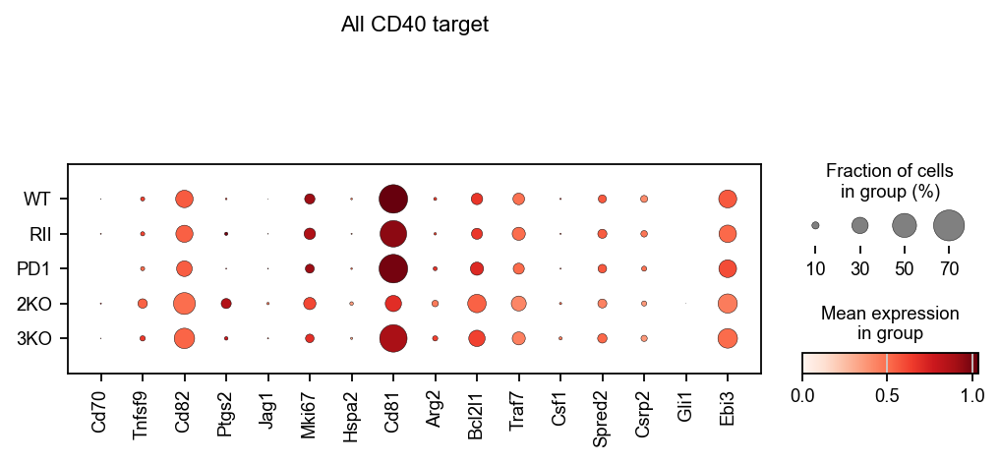

In [100]:
ac = sc.pl.dotplot(dataset, cd40_targets, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= 'All CD40 target', )

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


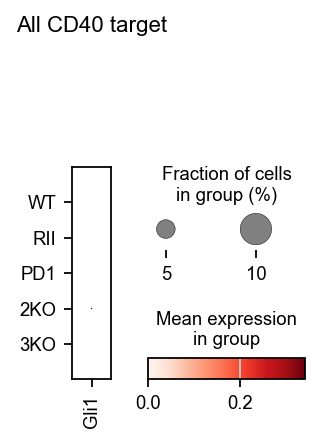

In [102]:
ac = sc.pl.dotplot(dataset, ['Gli1'], groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= 'All CD40 target', )

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


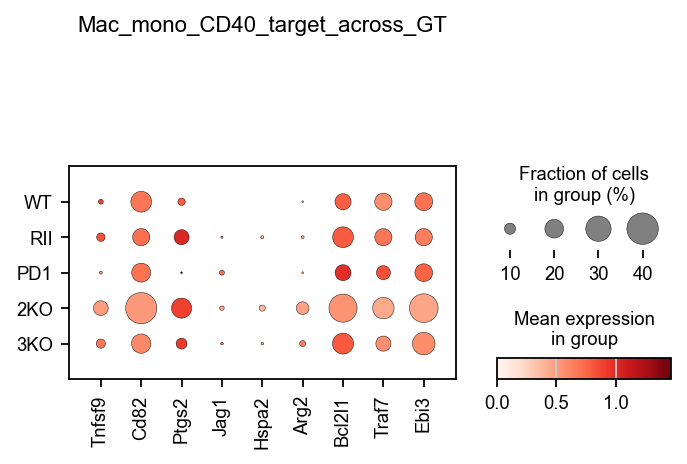

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


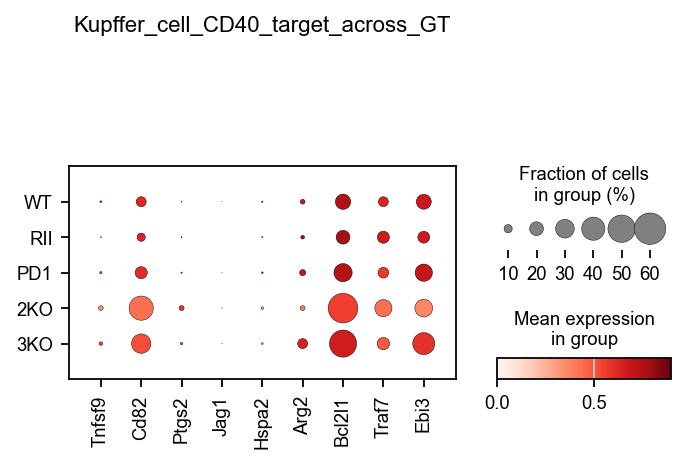

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


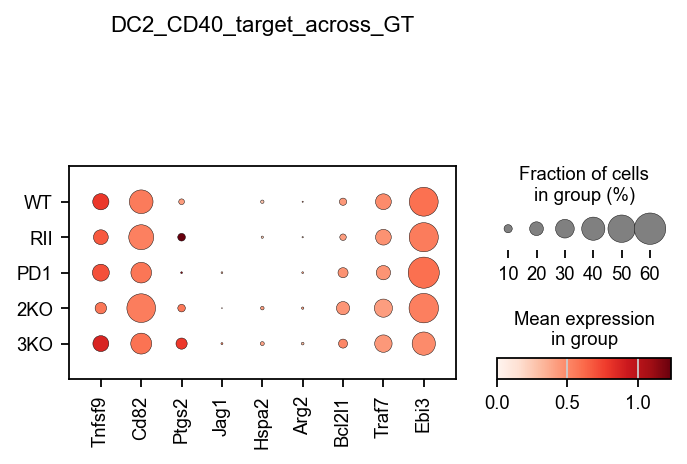

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


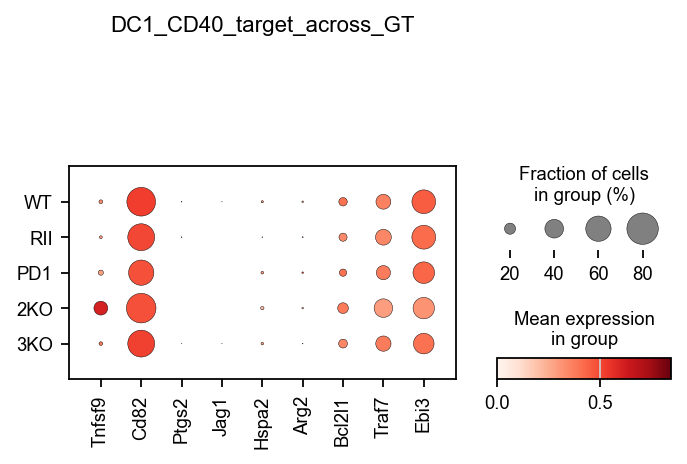

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


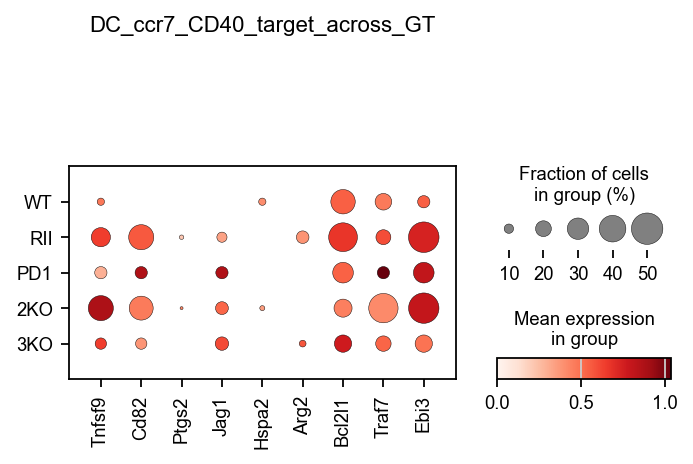

In [125]:
# batch
dataset = adata
for cluster in adata.obs['cell_subtype_v2'].unique():
    title = cluster + '_CD40_target_across_GT'
    ac = sc.pl.dotplot(dataset[dataset.obs['cell_subtype_v2'] == cluster], cd40_targets, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)


In [65]:
df_set_dict_bioc['BIOCARTA_CD40_PATHWAY']

['Cd40',
 'Cd40lg',
 'Chuk',
 'Dusp1',
 'Ikbkb',
 'Ikbkg',
 'Map3k1',
 'Map3k14',
 'Nfkb1',
 'Nfkbia',
 'Rela',
 'Tnfaip3',
 'Traf3',
 'Traf6']

In [126]:
CD40_gene_set_dict = {}
CD40_gene_set_dict['CD40_TARGET_PATHWAY'] = cd40_targets
#CD40_gene_set_dict['MYELOID_GOI'] = mye_goi
#CD40_gene_set_dict['CD40'] =['Cd40']
CD40_gene_set_dict['BIOCARTA_CD40_PATHWAY'] = ['Cd40',
 'Cd40lg',
 'Chuk',
 'Dusp1',
 'Ikbkb',
 'Ikbkg',
 'Map3k1',
 'Map3k14',
 'Nfkb1',
 'Nfkbia',
 'Rela',
 'Tnfaip3',
 'Traf3',
 'Traf6']
CD40_gene_set_dict

{'CD40_TARGET_PATHWAY': ['Tnfsf9',
  'Cd82',
  'Ptgs2',
  'Jag1',
  'Hspa2',
  'Arg2',
  'Bcl2l1',
  'Traf7',
  'Ebi3'],
 'BIOCARTA_CD40_PATHWAY': ['Cd40',
  'Cd40lg',
  'Chuk',
  'Dusp1',
  'Ikbkb',
  'Ikbkg',
  'Map3k1',
  'Map3k14',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfaip3',
  'Traf3',
  'Traf6']}

In [73]:
# Keyword to look for
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp', 'Tap', 'Cd8', 'Cd7']
# Iterate over the original dictionary to find and add the matching entries
for key, genes in df_set_dict_bioc.items():
    if any(keyword in gene for keyword in keywords for gene in genes):
        CD40_gene_set_dict[key] = genes

CD40_gene_set_dict

{'CD40_TARGET_PATHWAY': ['Cd70',
  'Tnfsf9',
  'Cd82',
  'Ptgs2',
  'Jag1',
  'Hspa2',
  'Cd81',
  'Bcl2l1',
  'Traf7',
  'Csrp2'],
 'MYELOID_GOI': ['Cd40',
  'Cd74',
  'H2-Ab1',
  'Socs3',
  'Socs1',
  'Nos2',
  'Spp1',
  'Ly6a',
  'Ccl5',
  'Cxcl9',
  'Cxcl10',
  'Cd80',
  'Cd86'],
 'CD40': ['Cd40'],
 'BIOCARTA_41BB_PATHWAY': ['Atf2',
  'Chuk',
  'Ifng',
  'Ikbkb',
  'Il2',
  'Il4',
  'Jun',
  'Map3k1',
  'Map3k5',
  'Map4k5',
  'Mapk14',
  'Mapk8',
  'Nfkb1',
  'Nfkbia',
  'Rela',
  'Tnfrsf9',
  'Tnfsf9',
  'Traf2'],
 'BIOCARTA_ACH_PATHWAY': ['Akt1',
  'Bad',
  'Chrnb1',
  'Chrng',
  'Fasl',
  'Foxo3',
  'Musk',
  'Pik3ca',
  'Pik3cg',
  'Pik3r1',
  'Ptk2b',
  'Rapsn',
  'Tert',
  'Ywhah'],
 'BIOCARTA_AKT_PATHWAY': ['Akt1',
  'Bad',
  'Casp9',
  'Chuk',
  'Fasl',
  'Foxo1',
  'Foxo3',
  'Foxo4',
  'Gh',
  'Ghr',
  'Hsp90aa1',
  'Ikbkb',
  'Ikbkg',
  'Nfkb1',
  'Nfkbia',
  'Pdpk1',
  'Pik3ca',
  'Pik3r1',
  'Ppp2ca',
  'Rela',
  'Ywhah'],
 'BIOCARTA_ASBCELL_PATHWAY': ['Cd28',
  'Cd4'

### run and export

In [28]:
wilcoxon_keys_test = [('2KO', 'rest')]

2024-04-21 13:54:29,020 [WARNING] Duplicated values found in preranked stats: 62.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:29,021 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:29,024 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:29,027 [INFO] 0002 gene_sets used for further statistical testing.....


2024-04-21 13:54:29,028 [INFO] Start to run GSEA...Might take a while..................


Mac_mono_DEG_2KO_vs_rest


2024-04-21 13:54:30,963 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:30,964 [INFO] Congratulations. GSEApy runs successfully................

2024-04-21 13:54:31,480 [WARNING] Duplicated values found in preranked stats: 53.99% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:31,483 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:31,488 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:31,491 [INFO] 0002 gene_sets used for further statistical testing.....
2024-04-21 13:54:31,492 [INFO] Start to run GSEA...Might take a while..................


Kupffer_cell_DEG_2KO_vs_rest


2024-04-21 13:54:33,127 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:33,128 [INFO] Congratulations. GSEApy runs successfully................

2024-04-21 13:54:33,361 [WARNING] Duplicated values found in preranked stats: 88.10% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:33,362 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:33,365 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:33,366 [INFO] 0002 gene_sets used for further statistical testing.....
2024-04-21 13:54:33,367 [INFO] Start to run GSEA...Might take a while..................


DC2_DEG_2KO_vs_rest


2024-04-21 13:54:35,324 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:35,325 [INFO] Congratulations. GSEApy runs successfully................

2024-04-21 13:54:35,913 [WARNING] Duplicated values found in preranked stats: 71.58% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:35,915 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:35,921 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:35,943 [INFO] 0002 gene_sets used for further statistical testing.....
2024-04-21 13:54:35,944 [INFO] Start to run GSEA...Might take a while..................


DC1_DEG_2KO_vs_rest


2024-04-21 13:54:37,659 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:37,660 [INFO] Congratulations. GSEApy runs successfully................

2024-04-21 13:54:38,074 [WARNING] Duplicated values found in preranked stats: 99.42% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:38,075 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:38,080 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:38,084 [INFO] 0002 gene_sets used for further statistical testing.....
2024-04-21 13:54:38,086 [INFO] Start to run GSEA...Might take a while..................


DC_ccr7_DEG_2KO_vs_rest


2024-04-21 13:54:39,693 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:39,693 [INFO] Congratulations. GSEApy runs successfully................

2024-04-21 13:54:40,773 [WARNING] Duplicated values found in preranked stats: 46.80% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:40,774 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:40,777 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:40,778 [INFO] 0002 gene_sets used for further statistical testing.....
2024-04-21 13:54:40,779 [INFO] Start to run GSEA...Might take a while..................


all_mac_DEG_2KO_vs_rest


2024-04-21 13:54:42,085 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:42,086 [INFO] Congratulations. GSEApy runs successfully................

2024-04-21 13:54:42,813 [WARNING] Duplicated values found in preranked stats: 51.55% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2024-04-21 13:54:42,818 [INFO] Parsing data files for GSEA.............................
2024-04-21 13:54:42,823 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=0
2024-04-21 13:54:42,825 [INFO] 0002 gene_sets used for further statistical testing.....
2024-04-21 13:54:42,828 [INFO] Start to run GSEA...Might take a while..................


all_apc_DEG_2KO_vs_rest


2024-04-21 13:54:46,077 [INFO] Start to generate gseapy reports, and produce figures...
2024-04-21 13:54:46,078 [INFO] Congratulations. GSEApy runs successfully................



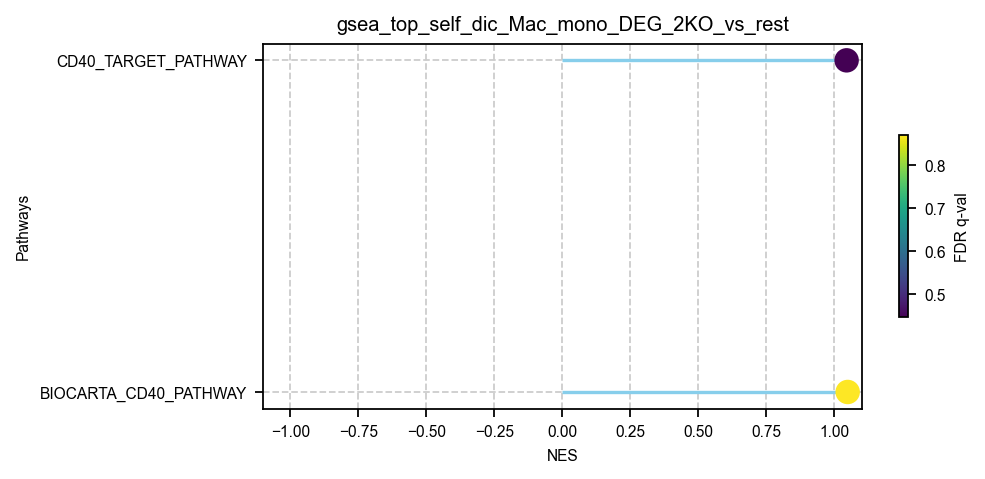

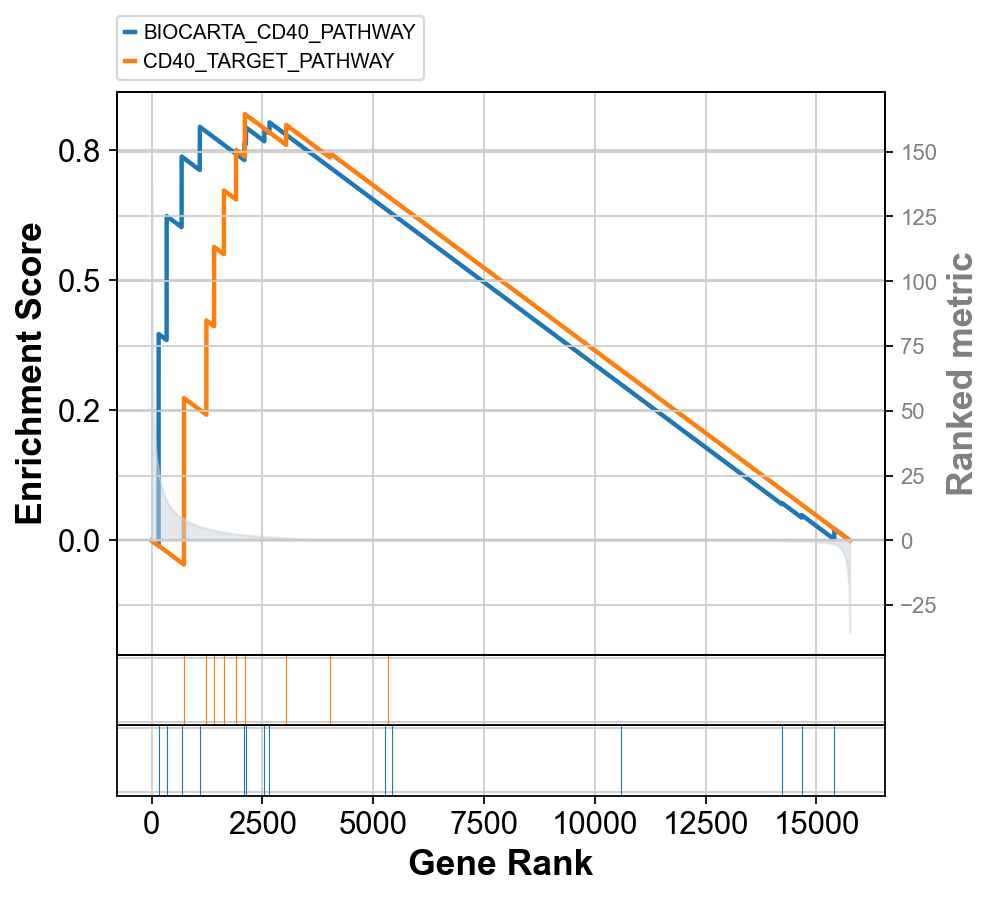

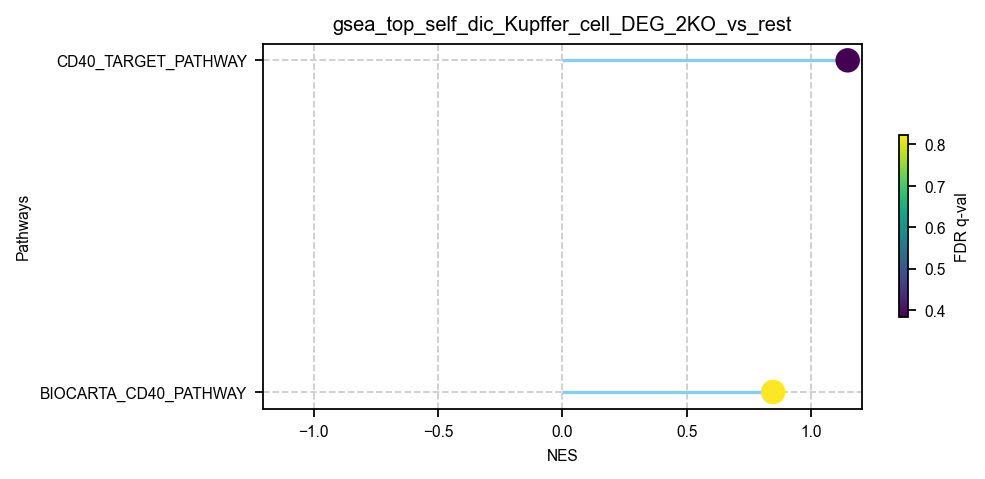

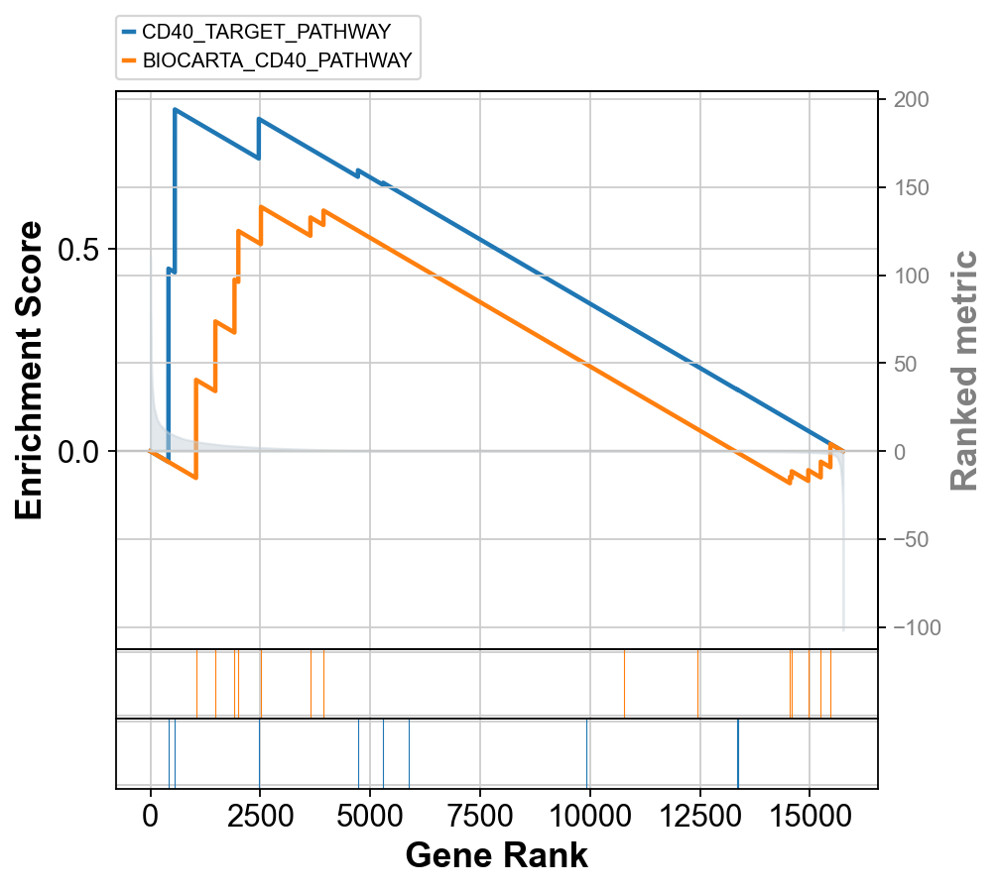

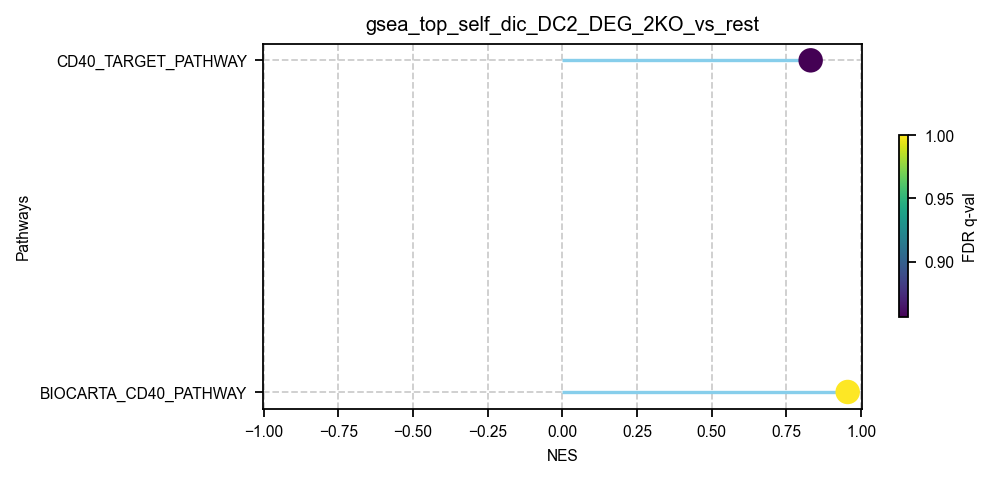

...

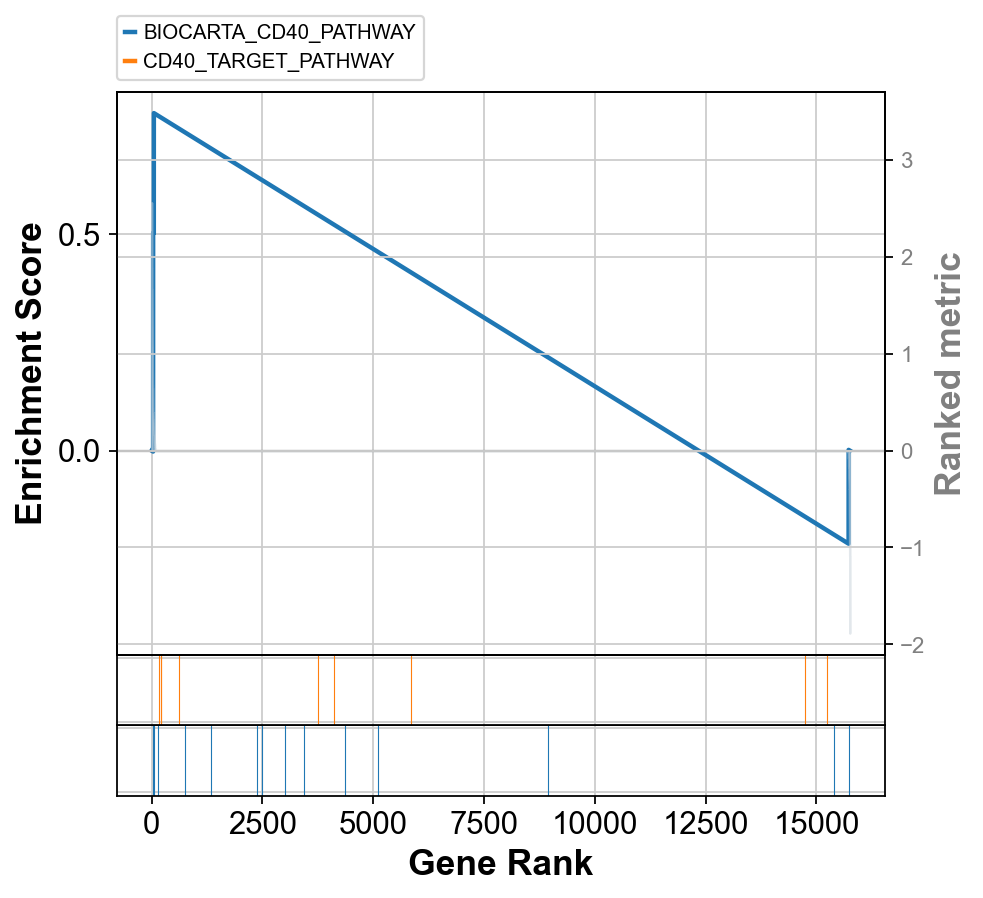

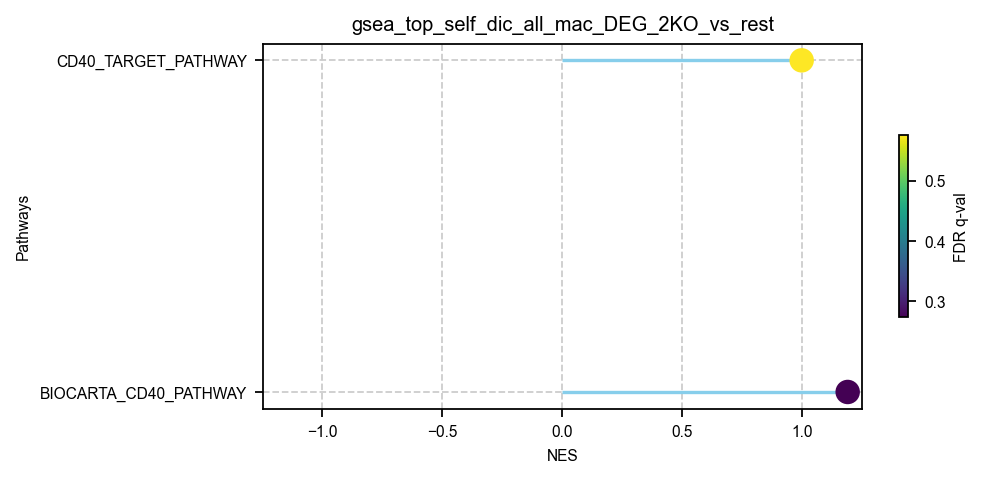

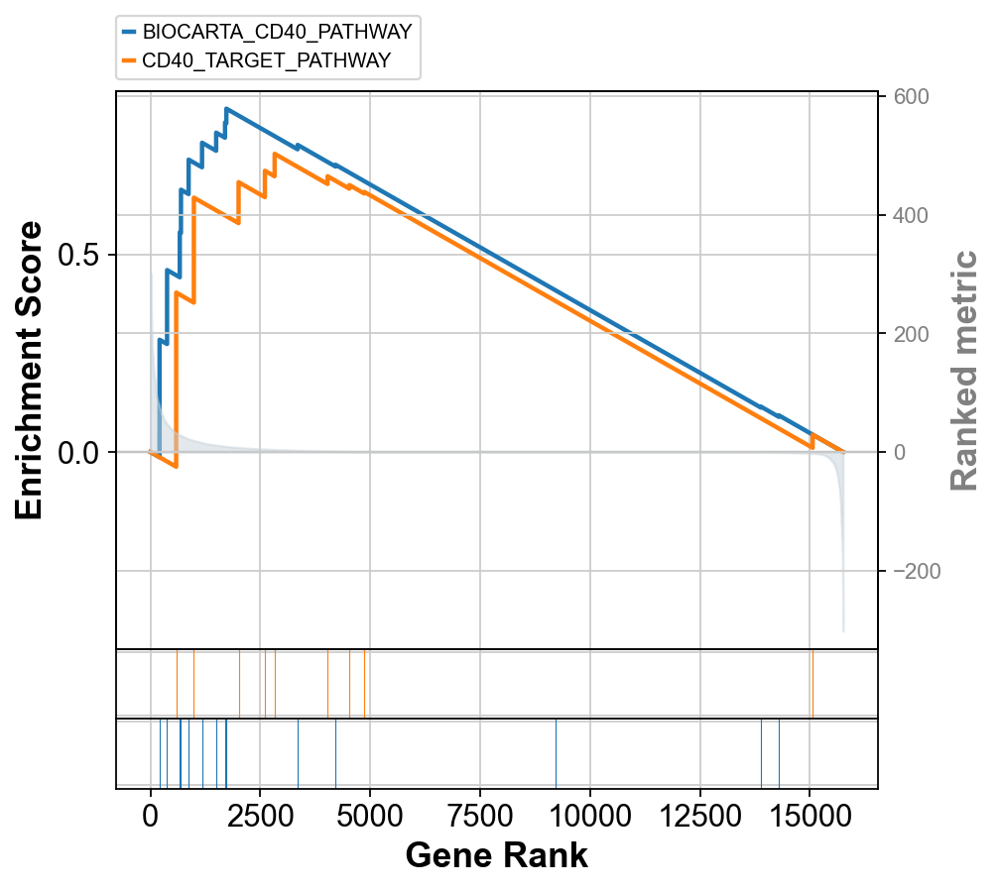

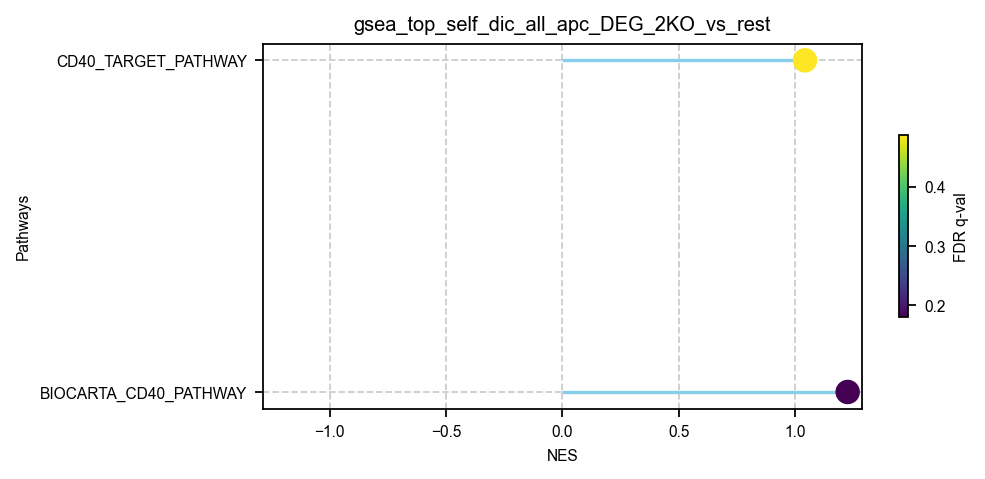

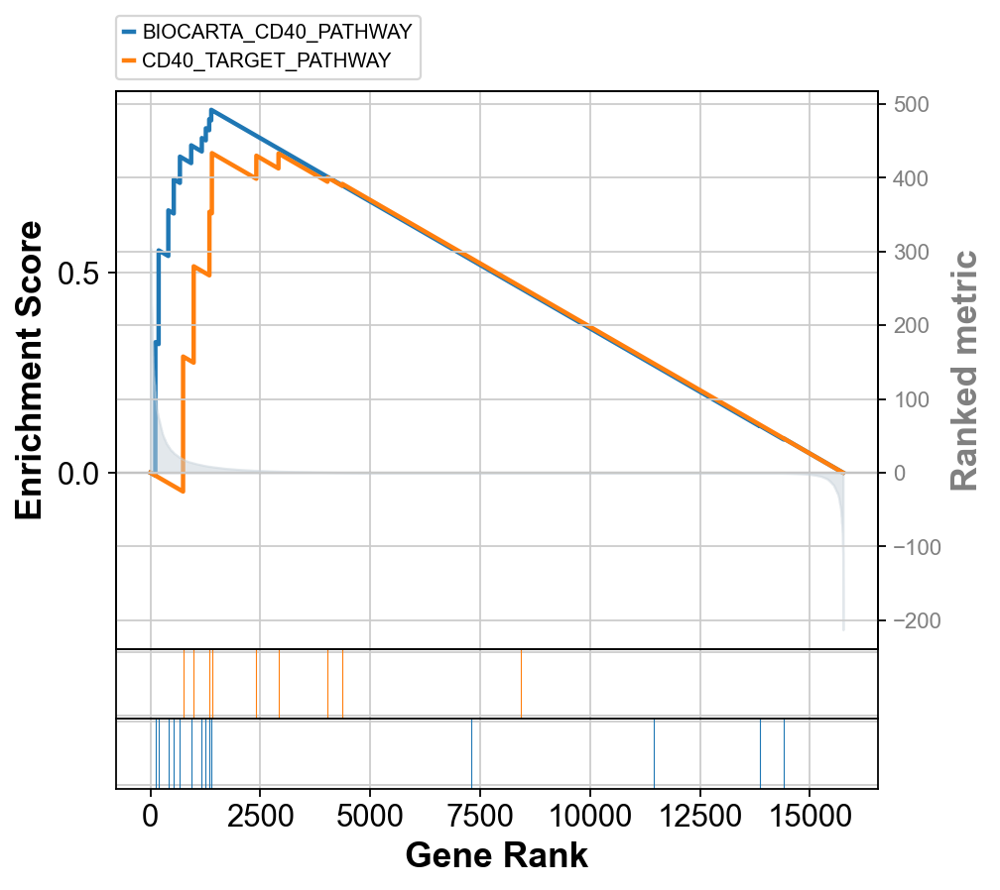

In [127]:
for cell_type in ((adata.obs['cell_subtype_v2'].unique()).tolist() + ['all_mac', 'all_apc']):
    for comparison in wilcoxon_keys_test:
        filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
        # run gsea
        # assume gsea db has been loaded
        DEG_df = pd.read_csv(f"features/{filename}.csv")
        df_gsea = DEG_df[['genes', 'logfoldchanges', 'pvals_adj']]
        # we change the 0 in pvals_adj to the minimum non-zero value
        non_zero_min = np.min(df_gsea['pvals_adj'][df_gsea['pvals_adj'] != 0])
        df_gsea['pvals_adj_updated'] = [j if j != 0 else non_zero_min/2 for j in df_gsea['pvals_adj']]
        df_gsea['-log10(pvals_adj)'] = [-1*np.log10(j) for j in df_gsea['pvals_adj_updated']]
        # then multiply by the sign of the log fold change to get the 'score'
        df_gsea['score'] = df_gsea['-log10(pvals_adj)'] * np.sign(df_gsea['logfoldchanges'])
        # sort
        df_gsea = df_gsea.sort_values(by='score', ascending=False)
        prerank_input = df_gsea.set_index('genes')['score'].to_frame()
        
        print(filename)
        try:
            pre_res_self = gseapy.prerank(
                rnk=prerank_input,
                gene_sets=CD40_gene_set_dict,
                threads=4,
                min_size=0,
                max_size=1000,
                permutation_num=1000,
                outdir=f'features/gsea/{filename}_self',
                seed=6,
                verbose=True
            )
            # Saving the object
            with open(f'features/gsea/{filename}_self.pkl', 'wb') as f:
                pickle.dump(pre_res_self, f)

            gsea_dotplot(pre_res_self.res2d.sort_values(by='Term'), 
                        xlab = 'NES', 
                        ylab = 'Term', 
                        title = f'gsea_top_self_dic_{filename}',
                        hue = 'FDR q-val', 
                        log10_pvalue = False, 
                        colorbar = True, 
                        tick_fontsize = 7, 
                        label_fontsize = 7,
                        ) #savefig='figures/gsea_top_sig{threshold}_cp_{filename}.pdf'
            #ordered_df_hm = pre_res_self.res2d.sort_values(by='NES')
            #ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)
            #export_pathways (pre_res_hm.res2d,f'{filename}_hm', 0.05, comparison[0])
            axs = pre_res_self.plot(terms=pre_res_self.res2d.Term[0:5],                   
                    show_ranking=True, # whether to show the second yaxis
                    figsize=(3,4)
                    )

        
        except BaseException as e:
            print(f"An error occurred: {e}")

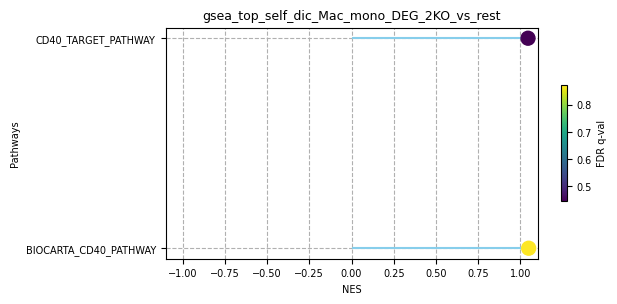

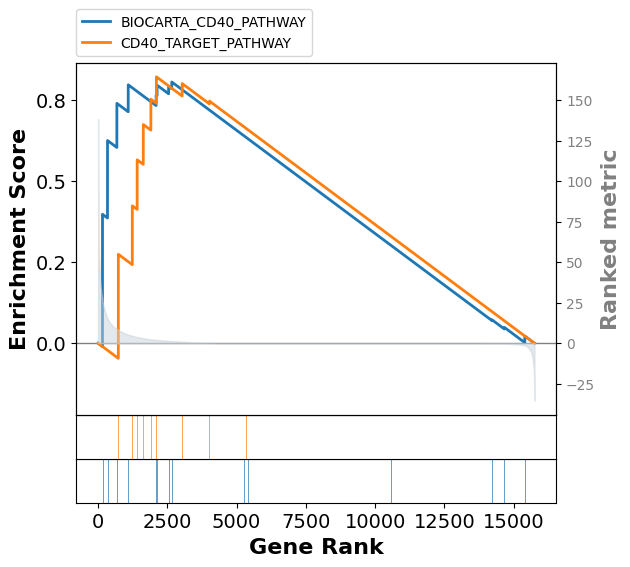

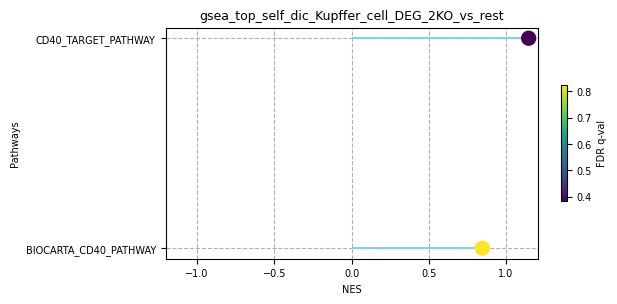

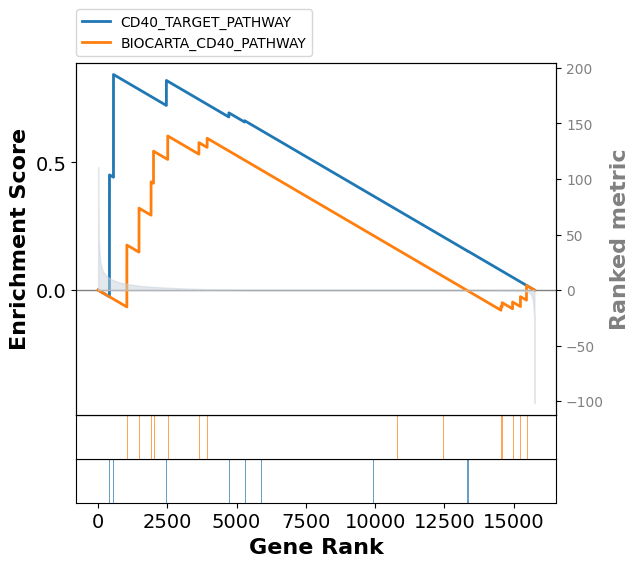

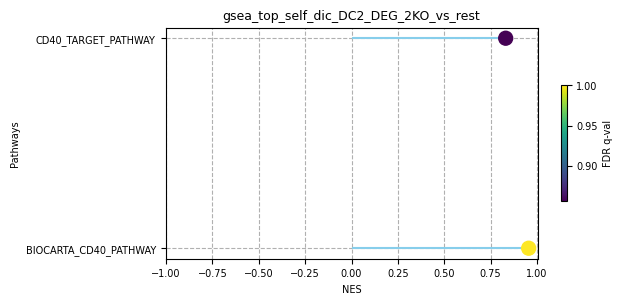

...

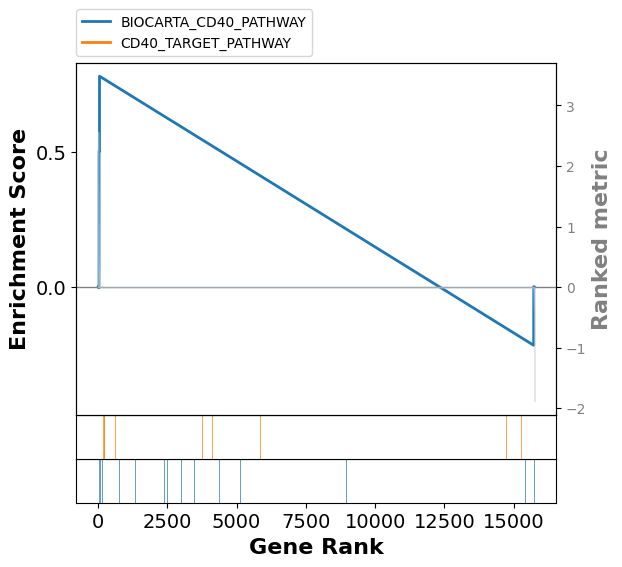

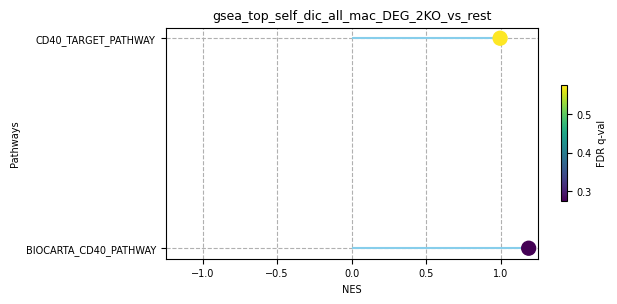

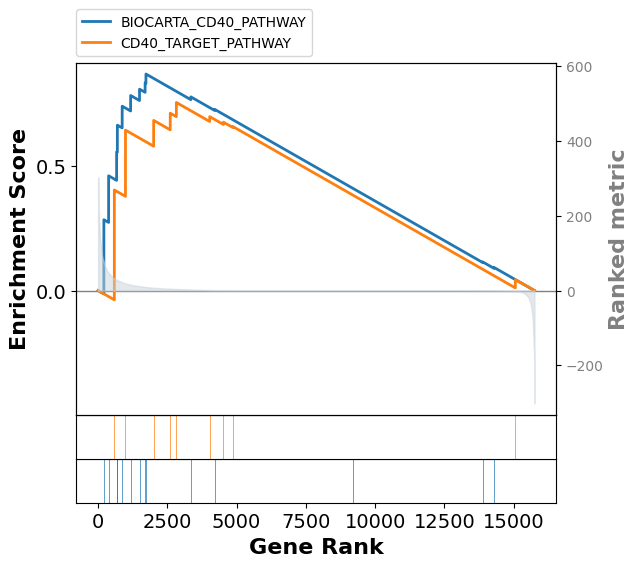

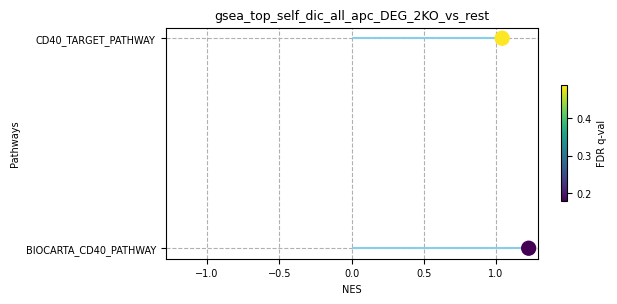

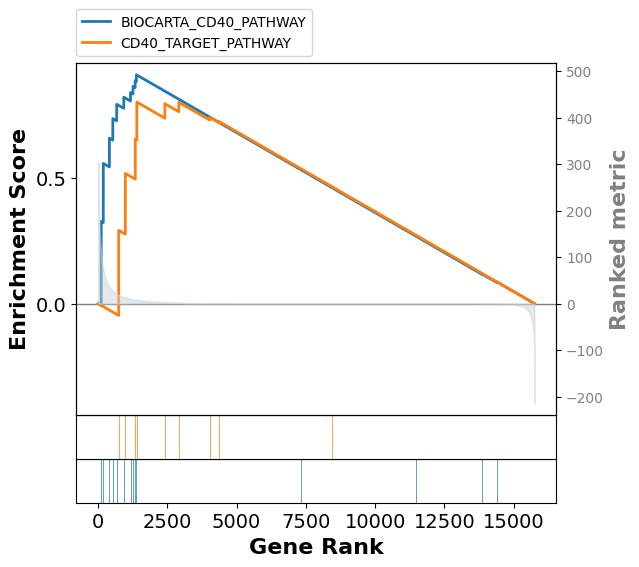

In [35]:
# just plotting
for cell_type in ((adata.obs['cell_subtype_v2'].unique()).tolist() + ['all_mac', 'all_apc']):
    for comparison in wilcoxon_keys_test:
        filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    
        with open(f'features/gsea/{filename}_self.pkl', 'rb') as f:
            pre_res_self = pickle.load(f)

        gsea_dotplot(pre_res_self.res2d.sort_values(by='Term'), 
                    xlab = 'NES', 
                    ylab = 'Term', 
                    title = f'gsea_top_self_dic_{filename}',
                    hue = 'FDR q-val', 
                    log10_pvalue = False, 
                    colorbar = True, 
                    tick_fontsize = 7, 
                    label_fontsize = 7,
                    ) #savefig='figures/gsea_top_sig{threshold}_cp_{filename}.pdf'
        #ordered_df_hm = pre_res_self.res2d.sort_values(by='NES')
        #ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)
        #export_pathways (pre_res_hm.res2d,f'{filename}_hm', 0.05, comparison[0])
        axs = pre_res_self.plot(terms=pre_res_self.res2d.Term[0:5],                   
                show_ranking=True, # whether to show the second yaxis
                figsize=(3,4)
                )
        # Adjust figure size
        fig = plt.gcf()  # Get the current figure
        #fig.set_size_inches(3, 3)  # Set figure size

        # Save the plot
        plt.savefig(f'figures/gsea_CD40_enrichment_score_{filename}.pdf', format='pdf', dpi=150, bbox_inches='tight')
        plt.show()
        plt.close(fig)

In [ ]:
# Saving the object
with open('gsea_result.pkl', 'wb') as f:
    pickle.dump(pre_res_hm, f)

# Loading the object
with open('gsea_result.pkl', 'rb') as f:
    loaded_pre_res_hm = pickle.load(f)

# Publication plots

In [8]:
adata.obs['cell_subtype_v2'].unique()

['Mac_mono', 'Kupffer_cell', 'DC2', 'DC1', 'DC_ccr7']
Categories (5, object): ['DC1', 'DC2', 'DC_ccr7', 'Kupffer_cell', 'Mac_mono']

#### volcano

In [50]:
wilcoxon_keys_test2 = [('3KO', '2KO')]

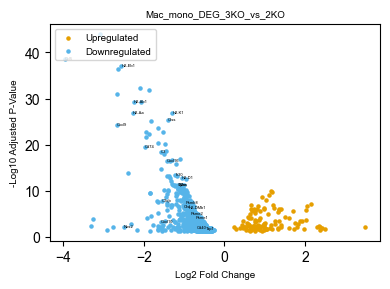

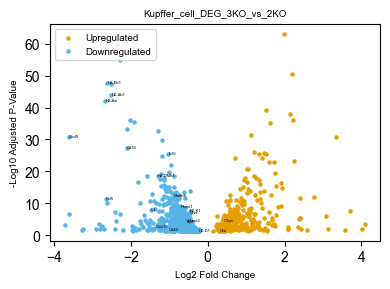

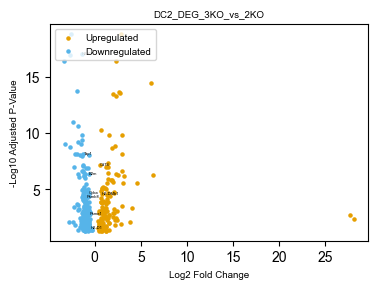

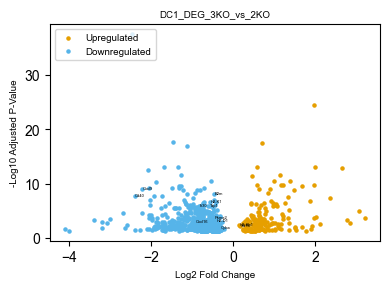

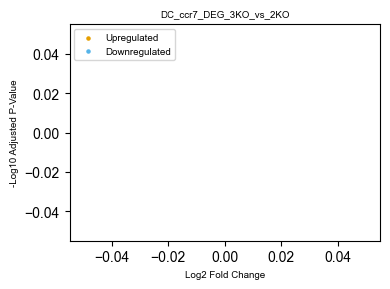

In [70]:
for cell_type in adata.obs['cell_subtype_v2'].unique():
    
    for comparison in wilcoxon_keys_test2:
        key = 'wilcoxon_' + cell_type + '_' + comparison[0] + '_'+ comparison[1]

        # Extract DEG results
        genes = adata.uns[key]['names'][comparison[0]]
        logfoldchanges = adata.uns[key]['logfoldchanges'][comparison[0]]
        pvals = adata.uns[key]['pvals'][comparison[0]]
        pvals_adj = adata.uns[key]['pvals_adj'][comparison[0]]

        # Create a DataFrame
        DEG_df = pd.DataFrame({
        'genes': genes,
        'logfoldchanges': logfoldchanges,
        'pvals': pvals,
        'pvals_adj': pvals_adj,
        }) 

        filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"

        # Create the DataFrame
        df_DEG = pd.DataFrame({
            'logfoldchanges': DEG_df['logfoldchanges'],
            'pvals_adj': DEG_df['pvals_adj']
        })
        df_DEG.index = genes
        # Extract logfoldchanges and adjusted p-values
        logfoldchanges = df_DEG['logfoldchanges']
        pvals_adj = df_DEG['pvals_adj']

        # Calculate the negative logarithm for adjusted p-values
        neg_log_pvals_adj = -np.log10(pvals_adj)

        # Filter for significant genes (e.g., pvals_adj < 0.05)
        significant_mask = (pvals_adj < 0.05)
        significant_logfoldchanges = logfoldchanges[significant_mask]
        significant_neg_log_pvals_adj = neg_log_pvals_adj[significant_mask]

        # Separate upregulated and downregulated genes
        upregulated = significant_logfoldchanges > 0
        downregulated = significant_logfoldchanges < 0

        # Set global font settings
        plt.rcParams['font.size'] = 10
        plt.rcParams['font.family'] = 'Arial'

        # Set up the figure and axis with the new figure size
        fig, ax = plt.subplots(figsize=(4, 3))

        # Assuming significant_logfoldchanges and significant_neg_log_pvals_adj are defined as before
        # Scatter plot the genes based on their regulation direction
        ax.scatter(significant_logfoldchanges[upregulated], significant_neg_log_pvals_adj[upregulated], color='#E69F00', s=5, label='Upregulated')
        ax.scatter(significant_logfoldchanges[downregulated], significant_neg_log_pvals_adj[downregulated], color='#56B4E9', s=5, label='Downregulated')
        # 'orange': '#E69F00', 'blue': '#56B4E9'
        # Titles, labels, and other customizations with updated fontsize and font
        ax.set_title(filename, fontsize=7)
        ax.set_xlabel("Log2 Fold Change", fontsize=7)
        ax.set_ylabel("-Log10 Adjusted P-Value", fontsize=7)
        ax.tick_params(axis='both', which='major', labelsize=10)
        ax.grid(False)
        ax.legend(loc='upper left', fontsize=7)

        genes_to_label = significant_logfoldchanges[
            ((np.abs(significant_logfoldchanges) > 2) & 
            (significant_neg_log_pvals_adj > 80)) |
            (np.abs(significant_logfoldchanges) > 10)
        ].index.tolist()  # Convert the index to a list'''

        # Add your genes of interest
        #genes_of_interest = ['Cxcl9', 'Cxcl10', 'Ccl5', 'Nos2', 'Ly6c2', 'H2-Ab1', 'Cd74', 'Cd40', 'Cd274', 'Stat1']
        #genes_to_label = genes_to_label + genes_of_interest
        genes_to_label = AP_genes + effector_genes

        # Annotate specific genes with updated fontsize
        for gene in genes_to_label:
            if (gene in significant_logfoldchanges) and (gene in significant_neg_log_pvals_adj):
                x = significant_logfoldchanges[gene]
                y = significant_neg_log_pvals_adj[gene]
                ax.annotate(gene, (x, y), fontsize=3, arrowprops=None)

        # Display and save the plot
        plt.tight_layout()
        plt.savefig(f"figures/volcano_{filename}_new.pdf", dpi=150, format='pdf', bbox_inches='tight')
        plt.show()

        

#### dotplot

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


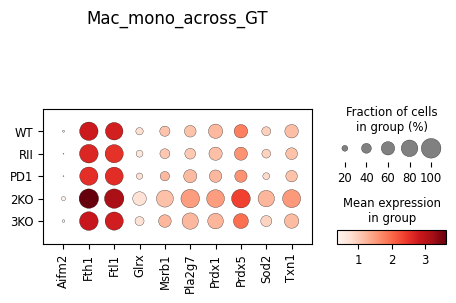

In [23]:
# single plot
dataset = adata
cluster = 'Mac_mono'
title = cluster + '_across_GT'
ac = sc.pl.dotplot(dataset[dataset.obs['cell_subtype_v2'] == cluster], protective_genes, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


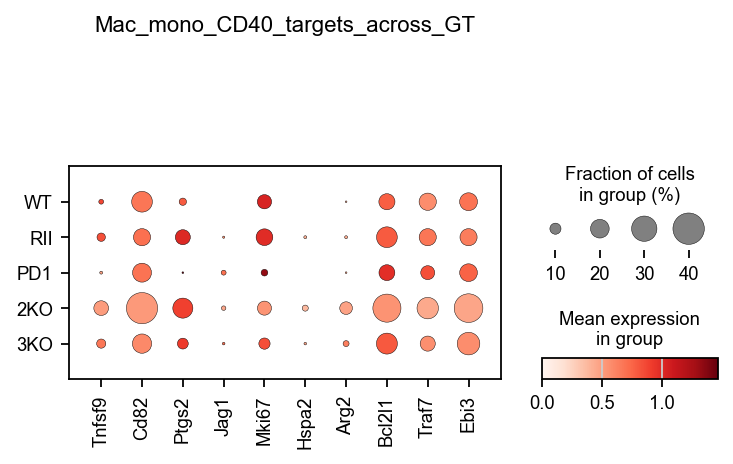

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


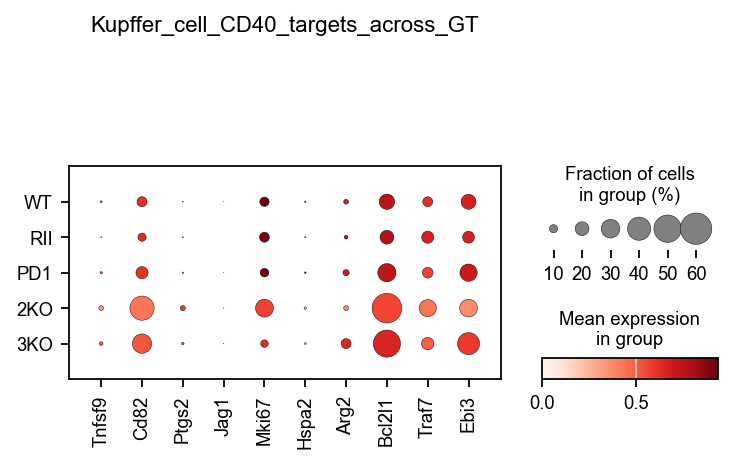

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


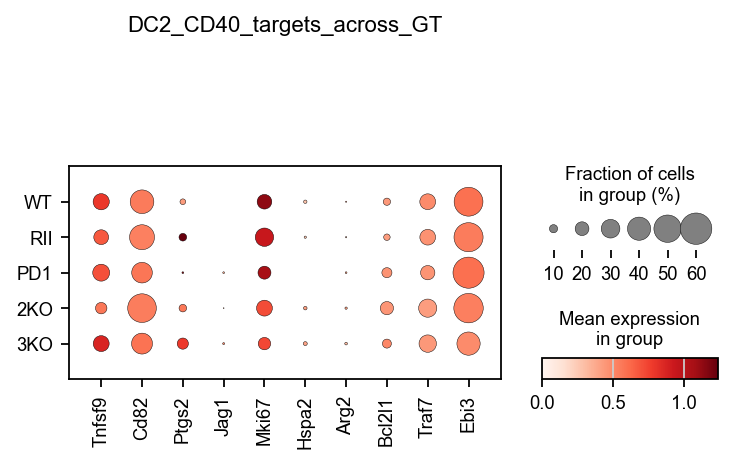

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


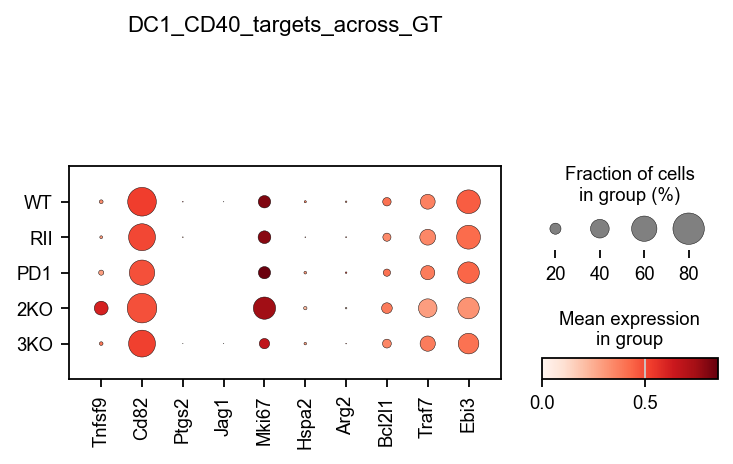

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


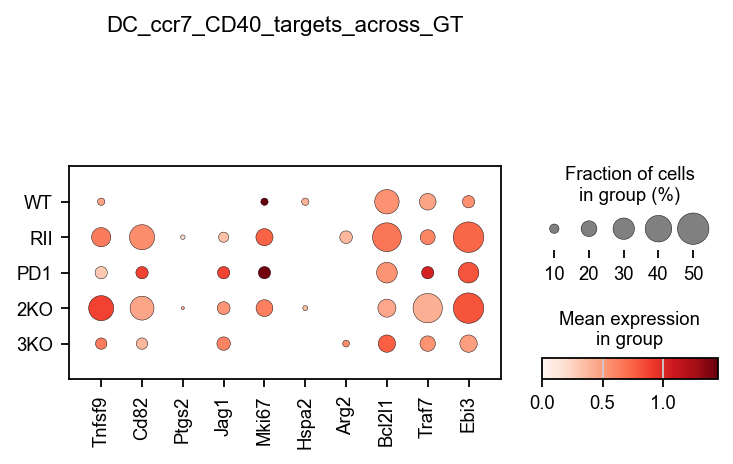

In [107]:
# batch
dataset = adata
for cluster in adata.obs['cell_subtype_v2'].unique():
    title = cluster + '_CD40_targets_across_GT'
    ac = sc.pl.dotplot(dataset[dataset.obs['cell_subtype_v2'] == cluster], cd40_targets, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

In [113]:
pathways_goi = {'antigen presentation': ['H2-Ab1', 'H2-Aa', 'H2-Eb1', 'H2-K1', 'B2m', 'Tap1', 'Slamf7','Lair1','Icam1','Slamf6','Itgb7'],
                'CD40': ['Cd40'],
                'CD40 targets': ['Tnfsf9', 'Cd82', 'Ptgs2', 'Jag1', 'Mki67', 'Hspa2', 'Arg2', 'Bcl2l1', 'Traf7', 'Ebi3'],
                'effector':['Nos2','Ccl5','Cxcl9','C3','Cxcl16','Cxcl10','Ccrl2'],
                'cytokine signaling':['Stat1','Stat3', 'Jak2', 'Socs3', 'Il12rb1'],
               }

In [115]:
pathways_goi2 = {'AP': ['H2-Ab1', 'H2-Aa', 'H2-Eb1', 'H2-K1', 'B2m', 'Tap1', 'Slamf7','Lair1','Icam1','Slamf6','Itgb7',],
                'effector':['Cd40','Nos2','Ccl5','Cxcl9','C3','Cxcl16','Cxcl10','Ccrl2'],
                'cytokine':['Stat1','Stat3', 'Jak2', 'Socs3', 'Il12rb1'],
               }

In [61]:
AP_genes = sorted(['H2-Ab1', 'H2-Aa', 'H2-Eb1', 'Ctss', 'Cd74', 'Ifi30', 'Psmb8', 'B2m', 'H2-D1','Tap1', 'H2-DMb1','Psme2','Psme1', 'Ctsl','H2-K1'])
effector_genes = sorted(['Ccl5', 'Nos2', 'Cxcl9', 'Cxcl10', 'Cxcl16', 'Cyba', 'C3', 'C1qb', 'Cd40',])
protective_genes = sorted(['Prdx5', 'Sod2', 'Fth1', 'Ftl1', 'Txn1', 'Msrb1', 'Pla2g7', 'Aifm2', 'Prdx1', 'Glrx'])

In [62]:
pathways_goi3 = {'AP': AP_genes,
                'effector':effector_genes,
               }

In [66]:
dataset = adata[~adata.obs['genotype'].isin(['3KO'])]


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


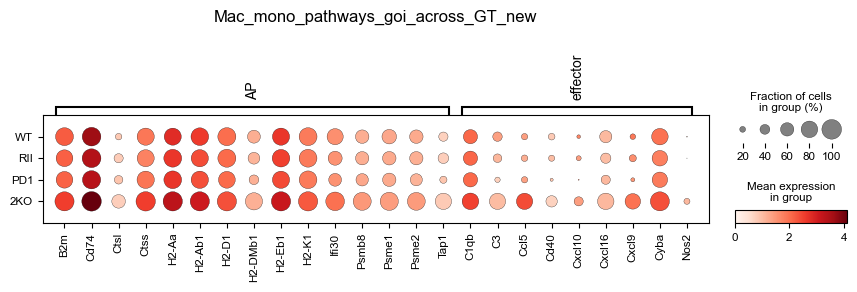

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


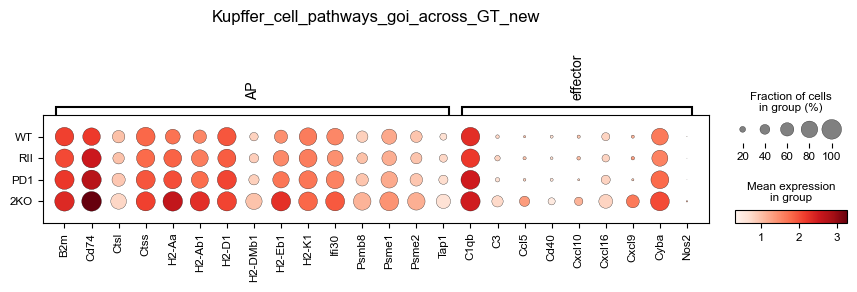

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


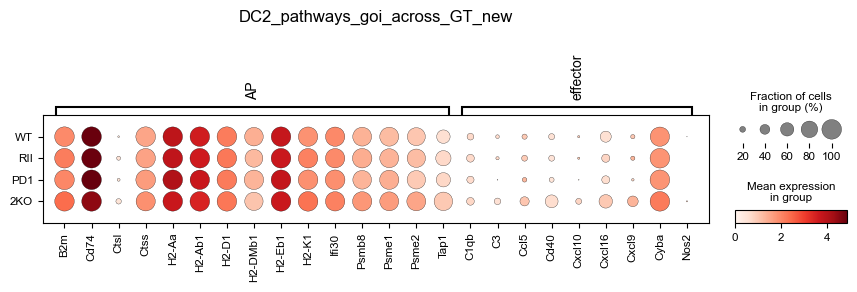

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


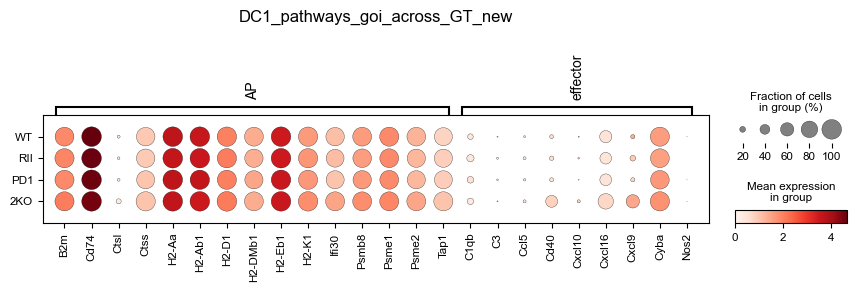

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


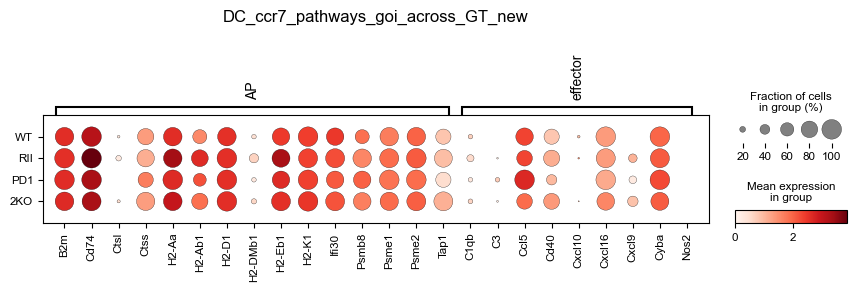

In [69]:
# batch
dataset = adata[~adata.obs['genotype'].isin(['3KO'])]
for cluster in adata.obs['cell_subtype_v2'].unique():
    title = cluster + '_pathways_goi_across_GT_new'
    ac = sc.pl.dotplot(dataset[dataset.obs['cell_subtype_v2'] == cluster], pathways_goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)


#### plot top pathways

##### cp

In [23]:
threshold = 0.05
cell_type = 'Mac_mono'
comparison = ('2KO', 'rest')
filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
input_df = pd.read_csv(f"features/gsea/{filename}_gsea_cp.csv")
input_df

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,REACTOME_COLLAGEN_CHAIN_TRIMERIZATION,-0.894613,-1.720411,0.000000,0.050446,0.040,2/32,10.54%,Col27a1;Col3a1
1,prerank,REACTOME_XENOBIOTICS,-0.982079,-1.684586,0.000000,0.054137,0.079,1/19,1.80%,Ahr
2,prerank,REACTOME_RHOJ_GTPASE_CYCLE,-0.942684,-1.564291,0.009615,0.303086,0.448,6/16,4.88%,Dock8;Arhgap26;Prex1;Ophn1;Trio;Arhgap1
3,prerank,WP_GPCRS_CLASS_B_SECRETIN_LIKE,-0.948203,-1.541093,0.009615,0.327283,0.575,3/17,2.34%,Adgrl3;Adgre5;Adgre1
4,prerank,BIOCARTA_TOB1_PATHWAY,-0.906393,-1.516053,0.052632,0.374284,0.711,5/19,9.39%,Tgfbr2;Tob2;Tgfbr1;Smad3;Smad4
...,...,...,...,...,...,...,...,...,...,...
1623,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.914399,1.316790,0.000000,0.030539,0.128,24/108,4.64%,Fcgr4;H2-K1;C3;B2m;H2-Q7;Ifitm2;Itgb2;Slamf7;I...
1624,prerank,REACTOME_METABOLISM_OF_FAT_SOLUBLE_VITAMINS,0.940891,1.320229,0.000000,0.027232,0.095,6/44,3.75%,Apoc2;Sdc4;Lrp10;Apoe;Sdc3;Lrp1
1625,prerank,REACTOME_COLLAGEN_DEGRADATION,0.950731,1.326854,0.000000,0.016858,0.046,5/44,4.80%,Mmp14;Ctsd;Ctsl;Ctsb;Furin
1626,prerank,REACTOME_GENERATION_OF_SECOND_MESSENGER_MOLECULES,0.984202,1.332496,0.000000,0.014102,0.026,3/26,0.21%,H2-Eb1;H2-Ab1;H2-Aa


In [31]:
# filter on goi and significance
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp', 'Tap', 'Cd8', 'Cd7']
mask2 = input_df['Lead_genes'].str.contains('|'.join(keywords)) 
input_df_filtered = input_df[mask2]
input_df_sig = input_df[input_df['FDR q-val'] <= threshold] 
input_df_filtered

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
101,prerank,BIOCARTA_INFLAM_PATHWAY,-0.627144,-1.006941,0.443182,1.000000,1.000,2/16,4.82%,Il15;Cd4
160,prerank,REACTOME_PHENYLALANINE_AND_TYROSINE_METABOLISM,-0.476799,-0.727857,0.769737,1.000000,1.000,1/11,3.99%,Il4i1
162,prerank,REACTOME_PHENYLALANINE_METABOLISM,-0.518579,-0.708924,0.743363,1.000000,1.000,1/6,3.99%,Il4i1
186,prerank,BIOCARTA_CYTOKINE_PATHWAY,-0.416788,-0.592685,0.919118,1.000000,1.000,1/11,0.83%,Il15
191,prerank,REACTOME_MAPK3_ERK1_ACTIVATION,-0.406836,-0.570112,0.960265,1.000000,1.000,2/9,3.55%,Il6ra;Tyk2
...,...,...,...,...,...,...,...,...,...,...
1611,prerank,WP_INFLAMMATORY_RESPONSE_PATHWAY,0.932296,1.279142,0.004269,0.147776,0.837,5/29,5.79%,Il2rg;Cd40;Tnfrsf1b;Il4ra;Tnfrsf1a
1620,prerank,REACTOME_TRANSLOCATION_OF_ZAP_70_TO_IMMUNOLOGI...,0.992390,1.311279,0.000000,0.028448,0.179,3/15,0.21%,H2-Eb1;H2-Ab1;H2-Aa
1622,prerank,REACTOME_PD_1_SIGNALING,0.980913,1.313594,0.000000,0.032420,0.157,5/19,1.28%,H2-Eb1;H2-Ab1;H2-Aa;Cd274;Ptpn6
1623,prerank,REACTOME_IMMUNOREGULATORY_INTERACTIONS_BETWEEN...,0.914399,1.316790,0.000000,0.030539,0.128,24/108,4.64%,Fcgr4;H2-K1;C3;B2m;H2-Q7;Ifitm2;Itgb2;Slamf7;I...


/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/3000119499.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]


(<Figure size 600x300 with 2 Axes>,
 <Axes: title={'center': 'gsea_top_filtered_sig0.5_cp_Mac_mono_DEG_2KO_vs_rest'}, xlabel='NES', ylabel='Pathways'>)

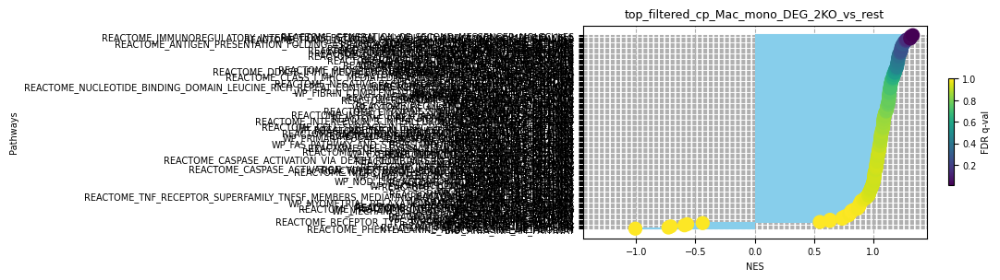

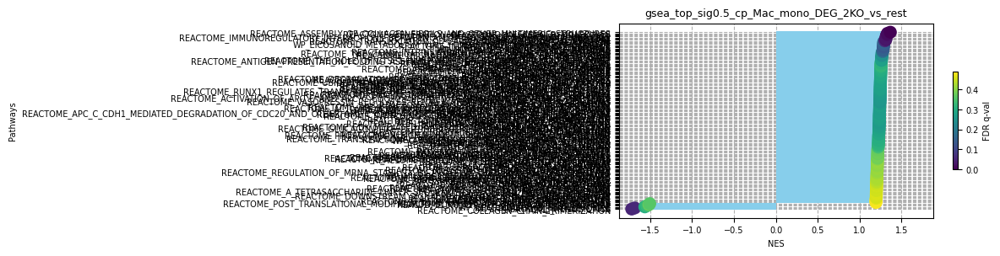

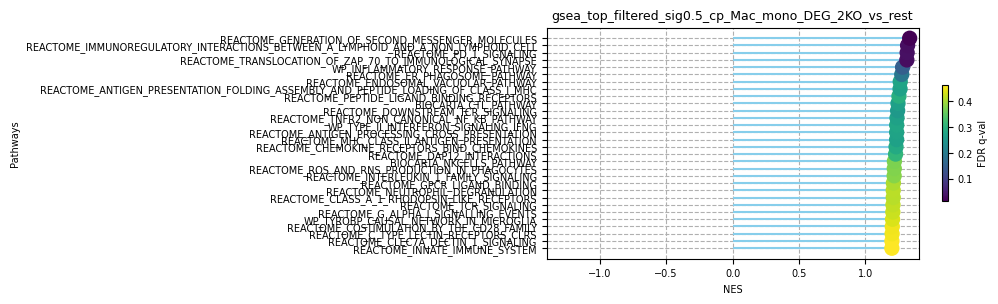

In [42]:
threshold = 0.5
cell_type = 'Mac_mono'
comparison = ('2KO', 'rest')
filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
input_df = pd.read_csv(f"features/gsea/{filename}_gsea_cp.csv")
# how it was saved
# filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
# ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
# ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)

# filter on goi and significance
keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp', 'Tap', 'Cd8', 'Cd7']
mask2 = input_df['Lead_genes'].str.contains('|'.join(keywords)) 
input_df_filtered = input_df[mask2]
input_df_sig = input_df[input_df['FDR q-val'] <= threshold] 
input_df_filtered_sig = input_df_sig[mask2]

# plot
gsea_dotplot(input_df_filtered, 
             xlab = 'NES', 
             ylab = 'Term', 
             title = f'top_filtered_cp_{filename}',
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/gsea_top_filtered_cp_{filename}.pdf') 

gsea_dotplot(input_df_sig, 
             xlab = 'NES', 
             ylab = 'Term', 
             title = f'gsea_top_sig{threshold}_cp_{filename}',
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/gsea_top_sig{threshold}_cp_{filename}.pdf') 

# plot
gsea_dotplot(input_df_filtered_sig, 
             xlab = 'NES', 
             ylab = 'Term', 
             title = f'gsea_top_filtered_sig{threshold}_cp_{filename}',
             hue = 'FDR q-val', 
             log10_pvalue = False, 
             colorbar = True, 
             tick_fontsize = 7, 
             label_fontsize = 7,
             savefig='figures/gsea_top_filtered_sig{threshold}_cp_{filename}.pdf') 


/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/1936602738.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/1936602738.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/1936602738.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/1936602738.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/1936602738.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = 

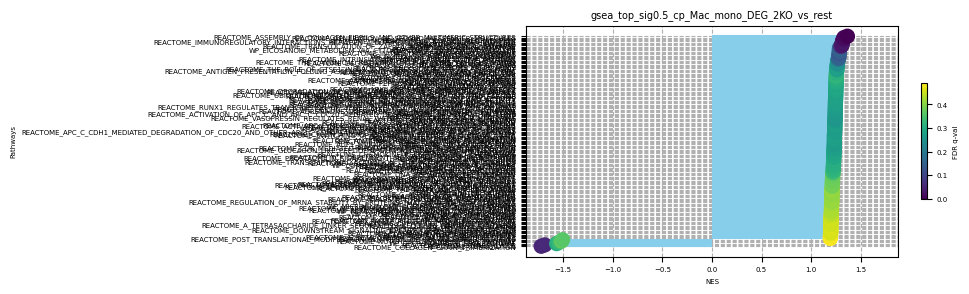

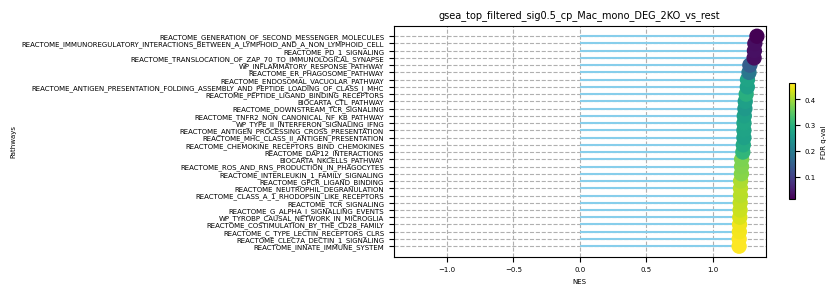

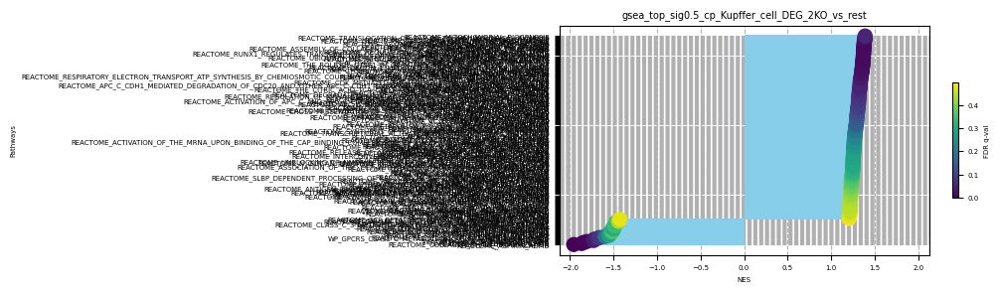

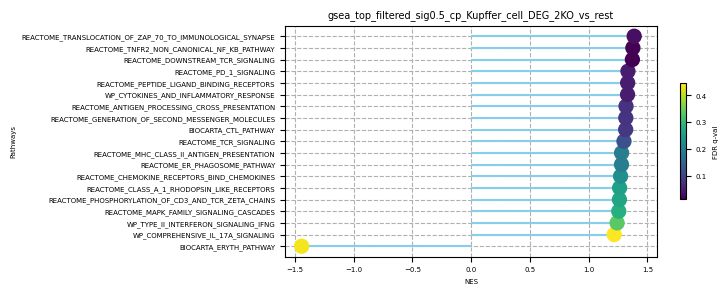

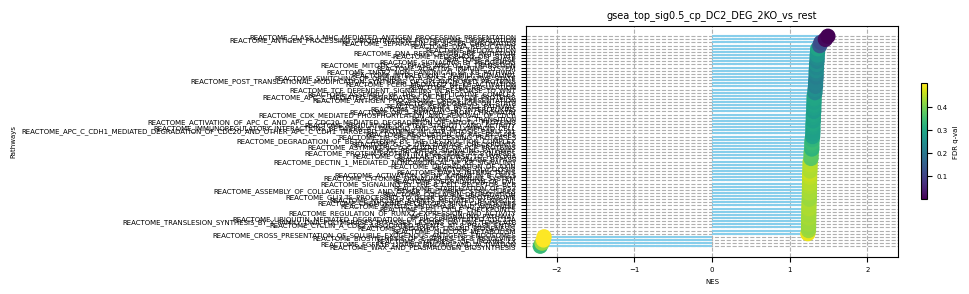

...

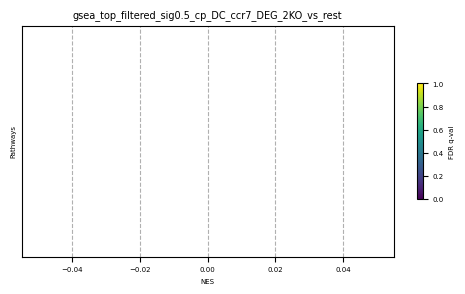

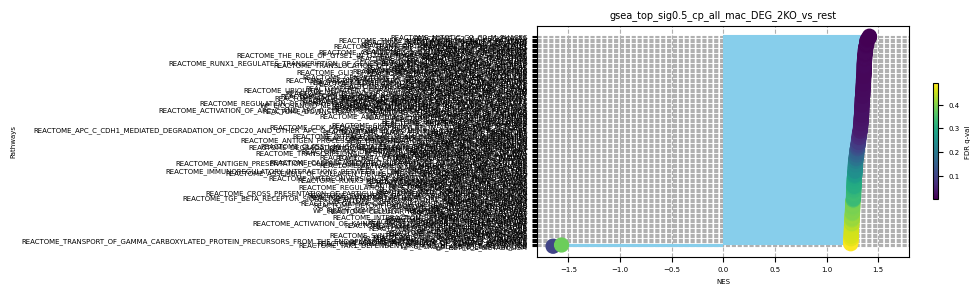

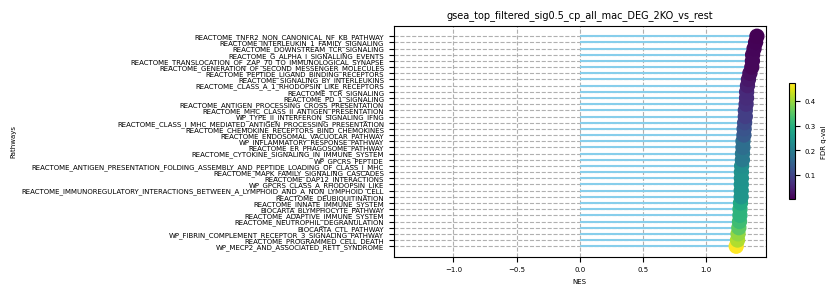

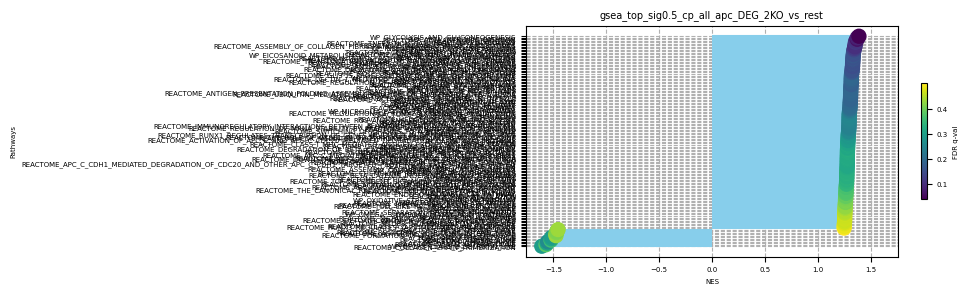

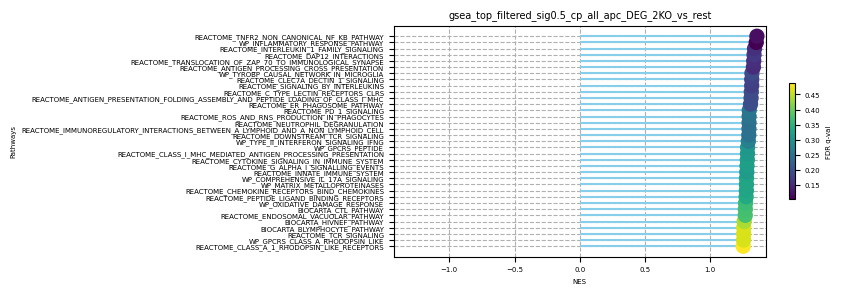

In [46]:
# take a look 
threshold = 0.5
comparison = ('2KO', 'rest')

for cell_type in ((adata.obs['cell_subtype_v2'].unique()).tolist() + ['all_mac', 'all_apc']):
    filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    input_df = pd.read_csv(f"features/gsea/{filename}_gsea_cp.csv")
    # how it was saved
    # filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    # ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
    # ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)

    # filter on goi and significance
    keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp', 'Tap', 'Cd8', 'Cd7']
    mask2 = input_df['Lead_genes'].str.contains('|'.join(keywords)) 
    input_df_filtered = input_df[mask2]
    input_df_sig = input_df[input_df['FDR q-val'] <= threshold] 
    input_df_filtered_sig = input_df_sig[mask2]

    # plot
    '''gsea_dotplot(input_df_filtered, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'top_filtered_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 7, 
                label_fontsize = 7,
                savefig='figures/gsea_top_filtered_cp_{filename}.pdf') '''

    gsea_dotplot(input_df_sig, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'gsea_top_sig{threshold}_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 5, 
                label_fontsize = 5,
                savefig='figures/gsea_top_sig{threshold}_cp_{filename}.pdf') 

    # plot
    gsea_dotplot(input_df_filtered_sig, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'gsea_top_filtered_sig{threshold}_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 5, 
                label_fontsize = 5,
                savefig='figures/gsea_top_filtered_sig{threshold}_cp_{filename}.pdf') 

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/833758631.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/833758631.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/833758631.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/833758631.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/833758631.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input

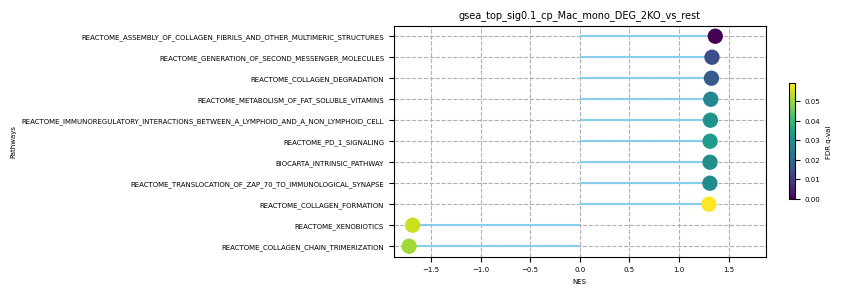

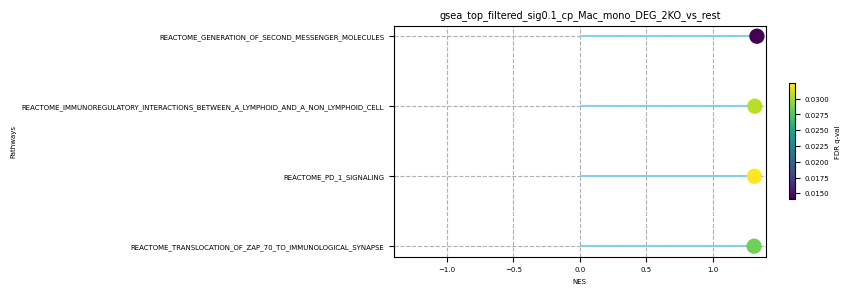

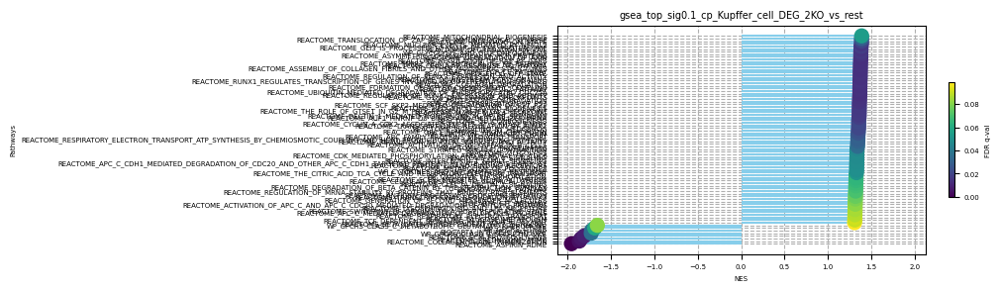

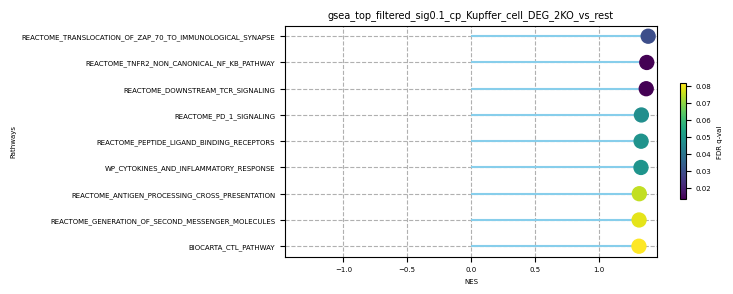

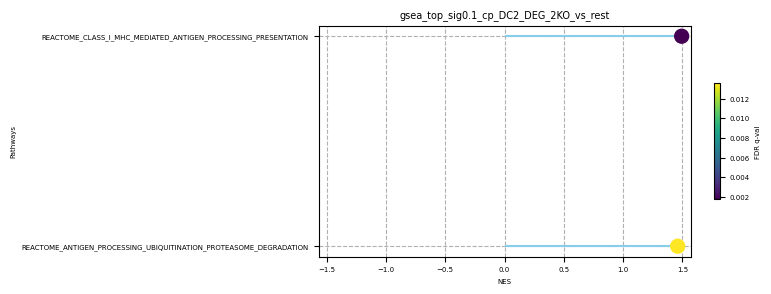

...

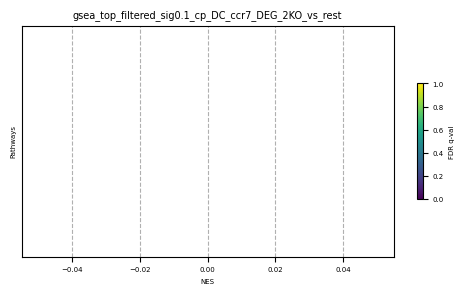

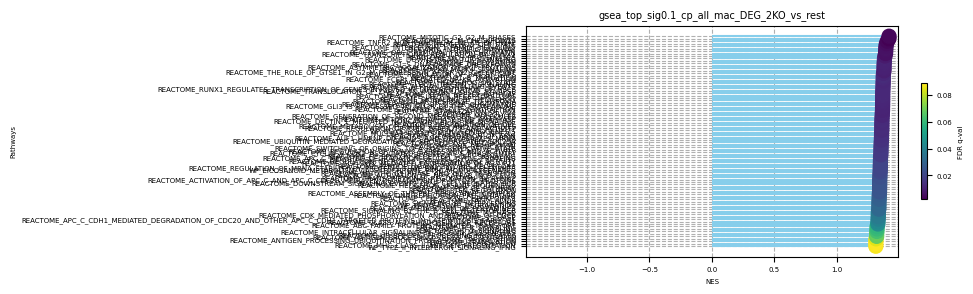

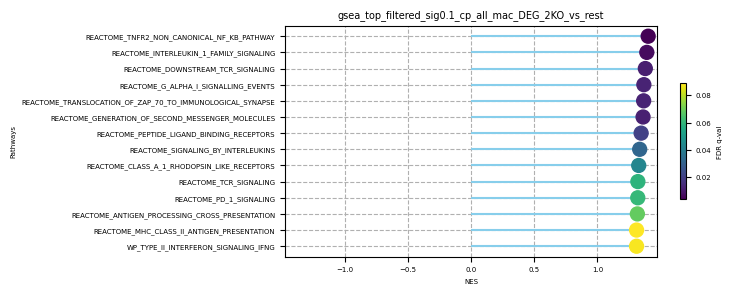

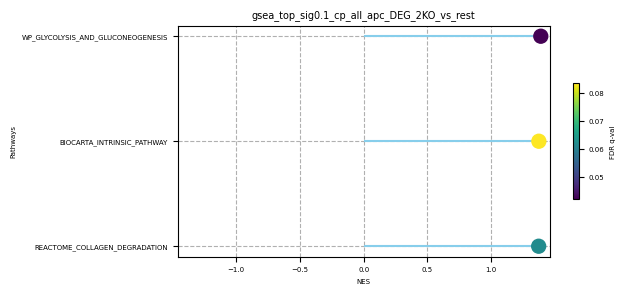

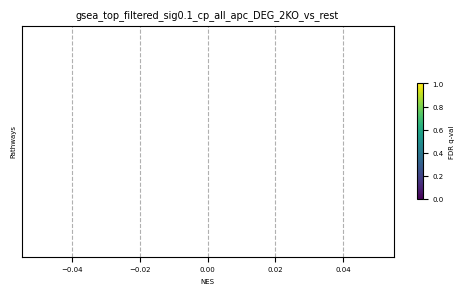

In [47]:
# take a look 
threshold = 0.1
comparison = ('2KO', 'rest')

for cell_type in ((adata.obs['cell_subtype_v2'].unique()).tolist() + ['all_mac', 'all_apc']):
    filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    input_df = pd.read_csv(f"features/gsea/{filename}_gsea_cp.csv")
    # how it was saved
    # filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    # ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
    # ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)

    # filter on goi and significance
    keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp', 'Tap', 'Cd8', 'Cd7']
    mask2 = input_df['Lead_genes'].str.contains('|'.join(keywords)) 
    input_df_filtered = input_df[mask2]
    input_df_sig = input_df[input_df['FDR q-val'] <= threshold] 
    input_df_filtered_sig = input_df_sig[mask2]

    # plot
    '''gsea_dotplot(input_df_filtered, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'top_filtered_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 7, 
                label_fontsize = 7,
                savefig='figures/gsea_top_filtered_cp_{filename}.pdf') '''

    gsea_dotplot(input_df_sig, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'gsea_top_sig{threshold}_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 5, 
                label_fontsize = 5,
                savefig='figures/gsea_top_sig{threshold}_cp_{filename}.pdf') 

    # plot
    gsea_dotplot(input_df_filtered_sig, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'gsea_top_filtered_sig{threshold}_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 5, 
                label_fontsize = 5,
                savefig='figures/gsea_top_filtered_sig{threshold}_cp_{filename}.pdf') 

##### hm

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/3324783598.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/3324783598.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/3324783598.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/3324783598.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = input_df_sig[mask2]
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1491/3324783598.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  input_df_filtered_sig = 

FileNotFoundError: [Errno 2] No such file or directory: 'features/gsea/all_mac_DEG_2KO_vs_rest_gsea_hm.csv'

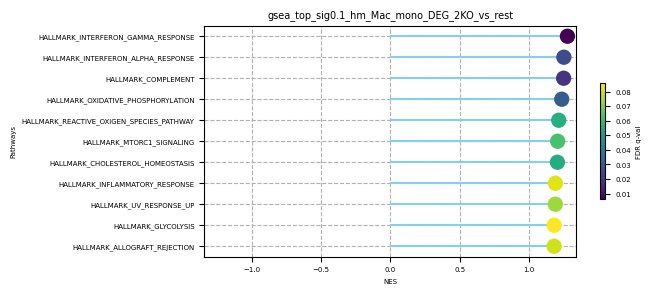

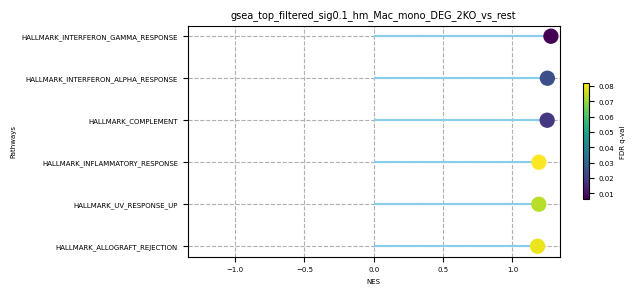

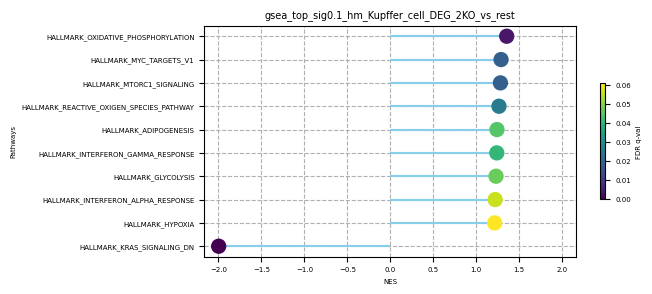

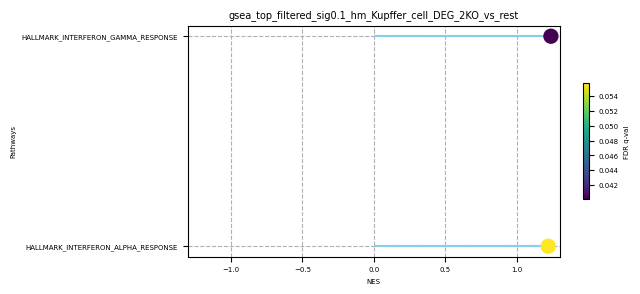

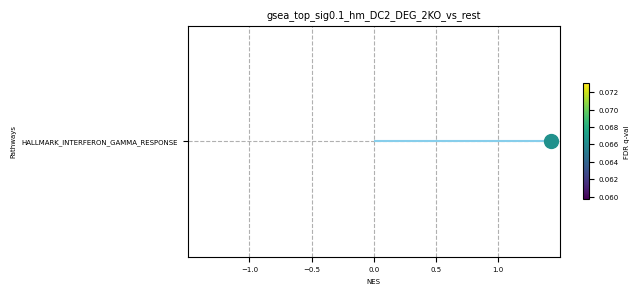

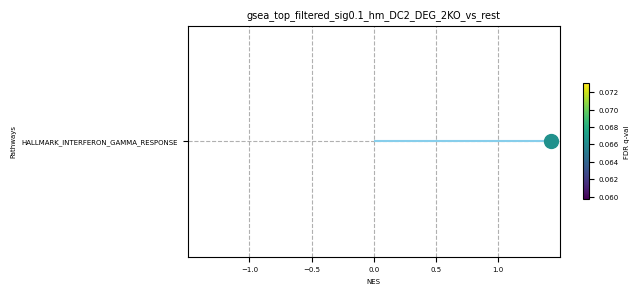

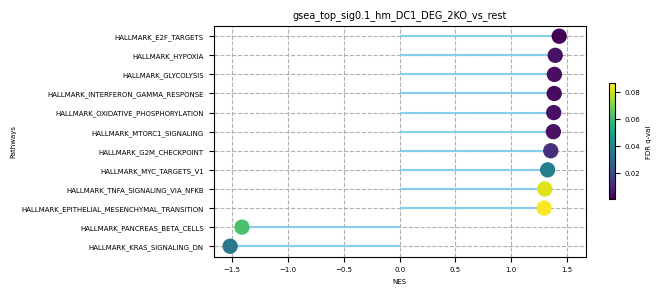

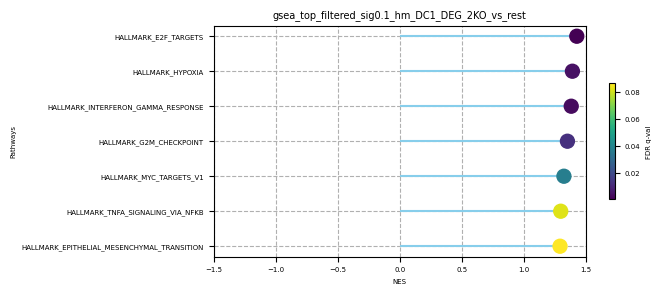

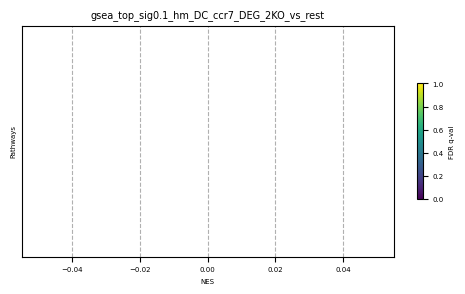

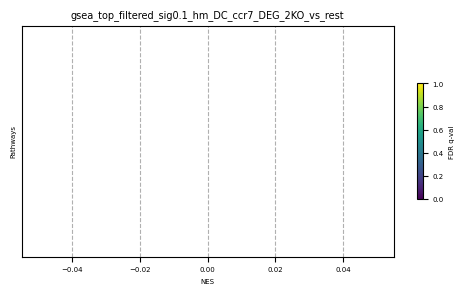

In [48]:
# take a look 
threshold = 0.1
comparison = ('2KO', 'rest')

for cell_type in ((adata.obs['cell_subtype_v2'].unique()).tolist() + ['all_mac', 'all_apc']):
    filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    input_df = pd.read_csv(f"features/gsea/{filename}_gsea_hm.csv")
    # how it was saved
    # filename = f"{cell_type}_DEG_{comparison[0]}_vs_{comparison[1]}"
    # ordered_df_hm = pre_res_hm.res2d.sort_values(by='NES')
    # ordered_df_hm.to_csv(f"features/gsea/{filename}_gsea_hm.csv", index=False)

    # filter on goi and significance
    keywords = ['Cd40', 'H2', 'Nos2', 'Fas', 'Ifn', 'Tnf', 'Ccl', 'Ccr', 'Il', 'Spp', 'Tap', 'Cd8', 'Cd7']
    mask2 = input_df['Lead_genes'].str.contains('|'.join(keywords)) 
    input_df_filtered = input_df[mask2]
    input_df_sig = input_df[input_df['FDR q-val'] <= threshold] 
    input_df_filtered_sig = input_df_sig[mask2]

    # plot
    '''gsea_dotplot(input_df_filtered, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'top_filtered_cp_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 7, 
                label_fontsize = 7,
                savefig='figures/gsea_top_filtered_cp_{filename}.pdf') '''

    gsea_dotplot(input_df_sig, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'gsea_top_sig{threshold}_hm_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 5, 
                label_fontsize = 5,
                savefig='figures/gsea_top_sig{threshold}_hm_{filename}.pdf') 

    # plot
    gsea_dotplot(input_df_filtered_sig, 
                xlab = 'NES', 
                ylab = 'Term', 
                title = f'gsea_top_filtered_sig{threshold}_hm_{filename}',
                hue = 'FDR q-val', 
                log10_pvalue = False, 
                colorbar = True, 
                tick_fontsize = 5, 
                label_fontsize = 5,
                savefig='figures/gsea_top_filtered_sig{threshold}_hm_{filename}.pdf') 

## END